# Penalaan Parameter PID Menggunakan Deep Learning pada Kit iTCLab dan Pemantauannya Menggunakan Internet of Things (IoT)

![Deep-PID-iTCLab-IoT](DL07.jpg)
Proses penalaan nilai Kc, τI dan τD pada
pengendali PID menggunakan Deep Learning pada Kit iTCLab dan Pemantauannya Menggunakan Internet of Things (IoT)

In [1]:
import itclab
import numpy as np
import time
import matplotlib.pyplot as plt
from scipy.integrate import odeint
import random
from paho.mqtt import client as mqtt_client

In [2]:
# Machine Learning - Building Datasets and Model
# Impor `Sequential` dari` keras.models`
from keras.models import Sequential

# Impor `Dense` dari` keras.layers`
from keras.layers import Dense

# Inisialisasi konstruktor
model = Sequential()

# Tambahkan lapisan masukan 
model.add(Dense(2, activation='sigmoid', input_shape=(2,)))

# Tambahkan satu lapisan tersembunyi
model.add(Dense(3, activation='sigmoid'))

# Tambahkan lapisan keluaran
model.add(Dense(3, activation='sigmoid'))

# Data Latih.
X = np.array([
    [1, 1],
    [0.4, 1.2],
    [1.2, 0.1],
    [1, 0.1]
])

# Label untuk Data Latih.
y = np.array([
    [0.25, 4.31, 0.20],
    [0.2, 4.1, 0.1],
    [0.1, 4.0, 0],
    [0.1, 4.0, 0]
])

# Bentuk keluaran model
model.output_shape

# Ringkasan model
model.summary()

# Konfigurasi model
model.get_config()

# Buat daftar semua tensor bobot 
model.get_weights()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2)                 6         
_________________________________________________________________
dense_1 (Dense)              (None, 3)                 9         
_________________________________________________________________
dense_2 (Dense)              (None, 3)                 12        
Total params: 27
Trainable params: 27
Non-trainable params: 0
_________________________________________________________________


[array([[-1.047825 , -1.111195 ],
        [-0.5602793, -1.0093   ]], dtype=float32),
 array([0., 0.], dtype=float32),
 array([[ 0.49625528, -1.045764  ,  0.7800678 ],
        [ 0.49991798, -0.22290719, -0.15202206]], dtype=float32),
 array([0., 0., 0.], dtype=float32),
 array([[-0.34835267, -0.97555804, -0.24375486],
        [-0.35620403,  0.97434473,  0.93942237],
        [-0.23832917, -0.05082703,  0.06857944]], dtype=float32),
 array([0., 0., 0.], dtype=float32)]

In [3]:
model.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])
                   
model.fit(X, y,epochs=100, batch_size=1, verbose=1)

Epoch 1/100
4/4 [==============================] - 1s 2ms/step - loss: 0.8583 - accuracy: 0.0000e+00
Epoch 2/100
4/4 [==============================] - 0s 2ms/step - loss: 0.8399 - accuracy: 0.0000e+00
Epoch 3/100
4/4 [==============================] - 0s 2ms/step - loss: 0.8215 - accuracy: 0.0000e+00
Epoch 4/100
4/4 [==============================] - 0s 2ms/step - loss: 0.8032 - accuracy: 0.0000e+00
Epoch 5/100
4/4 [==============================] - 0s 3ms/step - loss: 0.7849 - accuracy: 0.0000e+00
Epoch 6/100
4/4 [==============================] - 0s 3ms/step - loss: 0.7668 - accuracy: 0.0000e+00
Epoch 7/100
4/4 [==============================] - 0s 2ms/step - loss: 0.7487 - accuracy: 0.0000e+00
Epoch 8/100
4/4 [==============================] - 0s 4ms/step - loss: 0.7306 - accuracy: 0.0000e+00
Epoch 9/100
4/4 [==============================] - 0s 4ms/step - loss: 0.7127 - accuracy: 0.0000e+00
Epoch 10/100
4/4 [==============================] - 0s 3ms/step - loss: 0.6948 - accuracy: 

4/4 [==============================] - 0s 3ms/step - loss: -0.5433 - accuracy: 1.0000
Epoch 84/100
4/4 [==============================] - 0s 2ms/step - loss: -0.5597 - accuracy: 1.0000
Epoch 85/100
4/4 [==============================] - 0s 2ms/step - loss: -0.5761 - accuracy: 1.0000
Epoch 86/100
4/4 [==============================] - 0s 3ms/step - loss: -0.5925 - accuracy: 1.0000
Epoch 87/100
4/4 [==============================] - 0s 3ms/step - loss: -0.6089 - accuracy: 1.0000
Epoch 88/100
4/4 [==============================] - 0s 3ms/step - loss: -0.6252 - accuracy: 1.0000
Epoch 89/100
4/4 [==============================] - 0s 3ms/step - loss: -0.6416 - accuracy: 1.0000
Epoch 90/100
4/4 [==============================] - 0s 3ms/step - loss: -0.6580 - accuracy: 1.0000
Epoch 91/100
4/4 [==============================] - 0s 3ms/step - loss: -0.6743 - accuracy: 1.0000
Epoch 92/100
4/4 [==============================] - 0s 2ms/step - loss: -0.6907 - accuracy: 1.0000
Epoch 93/100
4/4 [=====

In [4]:
######################################################
# Use this script for evaluating model predictions   #
# and PID controller performance for the TCLab       #
# Adjust only PID and model sections                 #
######################################################

######################################################
# PID Controller                                     #
######################################################
# inputs -----------------------------------
# sp = setpoint
# pv = current temperature
# pv_last = prior temperature
# ierr = integral error
# dt = time increment between measurements
# outputs ----------------------------------
# op = output of the PID controller
# P = proportional contribution
# I = integral contribution
# D = derivative contribution
def pid(sp,pv,pv_last,ierr,dt):
    Kc   = 10.0 # K/%Heater
    tauI = 50.0 # sec
    tauD = 1.0  # sec
    # Parameters in terms of PID coefficients
    KP = Kc
    KI = Kc/tauI
    KD = Kc*tauD
    # ubias for controller (initial heater)
    op0 = 0 
    # upper and lower bounds on heater level
    ophi = 100
    oplo = 0
    # calculate the error
    error = sp-pv
    # calculate the integral error
    ierr = ierr + KI * error * dt
    # calculate the measurement derivative
    dpv = (pv - pv_last) / dt
    # calculate the PID output
    P = KP * error
    I = ierr
    D = -KD * dpv
    op = op0 + P + I + D
    # implement anti-reset windup
    if op < oplo or op > ophi:
        I = I - KI * error * dt
        # clip output
        op = max(oplo,min(ophi,op))
    # return the controller output and PID terms
    return [op,P,I,D]

In [5]:
######################################################
# PID Controller using Deep Learning                 #
######################################################
# inputs -----------------------------------
# sp = setpoint
# pv = current temperature
# pv_last = prior temperature
# ierr = integral error
# dt = time increment between measurements
# outputs ----------------------------------
# op = output of the PID controller
# P = proportional contribution
# I = integral contribution
# D = derivative contribution

def pid_dl(sp,pv,pv_last,ierr,dt):

    # calculate the error
    error = sp-pv
    d_error = sp-pv_last
    delta_error = (error - d_error)
    
    outDL = model.predict(np.array([[error,delta_error]]))
    
    Kc = outDL[0,0]
    tauI = outDL[0,1]
    tauD = outDL[0,2]
    
    # Parameters in terms of PID coefficients
    KP = Kc
    KI = Kc/tauI
    KD = Kc*tauD
    # ubias for controller (initial heater)
    op0 = 0 
    # upper and lower bounds on heater level
    ophi = 100
    oplo = 0

    # calculate the integral error
    ierr = ierr + KI * error * dt
    # calculate the measurement derivative
    dpv = (pv - pv_last) / dt
    # calculate the PID output
    P = KP * error
    I = ierr
    D = -KD * dpv
    op = op0 + P + I + D
    # implement anti-reset windup
    if op < oplo or op > ophi:
        I = I - KI * error * dt
        # clip output
        op = max(oplo,min(ophi,op))
    # return the controller output and PID terms
    return [op,P,I,D]

In [6]:
######################################################
# FOPDT model                                        #
######################################################
Kp = 0.5      # degC/%
tauP = 120.0  # seconds
thetaP = 10   # seconds (integer)
Tss = 23      # degC (ambient temperature)
Qss = 0       # % heater

######################################################
# Energy balance model                               #
######################################################
def heat(x,t,Q):
    # Parameters
    Ta = 23 + 273.15   # K
    U = 10.0           # W/m^2-K
    m = 4.0/1000.0     # kg
    Cp = 0.5 * 1000.0  # J/kg-K    
    A = 12.0 / 100.0**2 # Area in m^2
    alpha = 0.01       # W / % heater
    eps = 0.9          # Emissivity
    sigma = 5.67e-8    # Stefan-Boltzman

    # Temperature State 
    T = x[0]

    # Nonlinear Energy Balance
    dTdt = (1.0/(m*Cp))*(U*A*(Ta-T) \
            + eps * sigma * A * (Ta**4 - T**4) \
            + alpha*Q)
    return dTdt

In [7]:
# Connect to MQTT Broker for Monitoring
broker = 'broker.hivemq.com'
port = 1883
client_id = f'python-mqtt-{random.randint(0, 1000)}'

def connect_mqtt():
    def on_connect(client, userdata, flags, rc):
        if rc == 0:
            print("Connected to MQTT Broker!")
        else:
            print("Failed to connect, return code %d\n", rc)

    client = mqtt_client.Client(client_id)
    client.on_connect = on_connect
    client.connect(broker, port)
    return client

client = connect_mqtt()
client.loop_start()

Connected to MQTT Broker!


Opening connection
iTCLab connected via Arduino on port COM3
LED On
Running Main Loop. Ctrl-C to end.
  Time     SP     PV     Q1   =  P   +  I  +   D
   0.0  25.00  28.07   0.00   0.00   0.00   0.00


<Figure size 720x504 with 0 Axes>

   1.0  25.00  27.90   0.00  -0.59   0.00   0.01


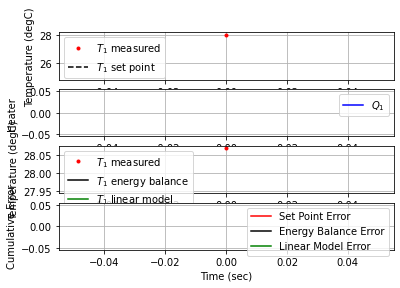

   3.1  25.00  27.93   0.00  -0.59   0.00  -0.00


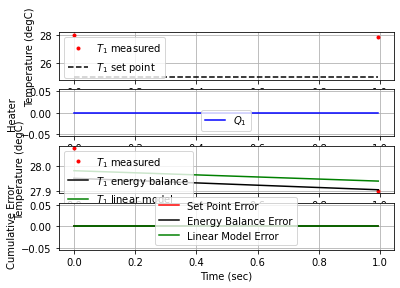

   4.5  25.00  27.85   0.00  -0.58   0.00   0.00


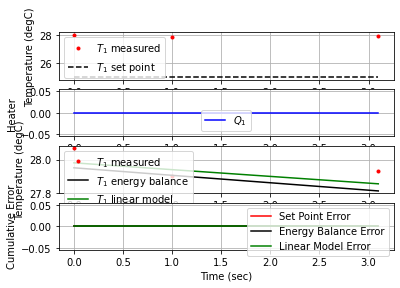

   5.8  25.00  28.06   0.00  -0.62   0.00  -0.01


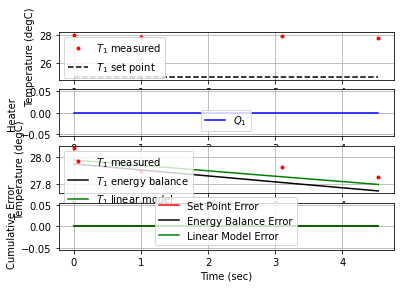

   7.0  25.00  27.96   0.00  -0.60   0.00   0.01


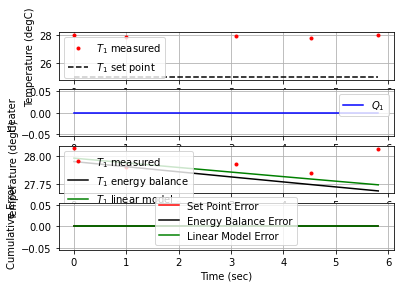

   8.3  25.00  28.00   0.00  -0.61   0.00  -0.00


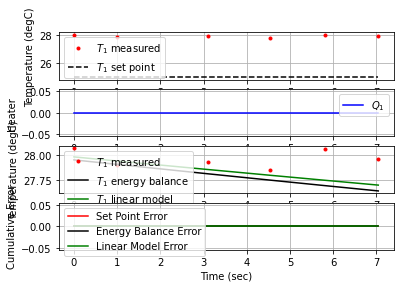

   9.7  25.00  27.96   0.00  -0.60   0.00   0.00


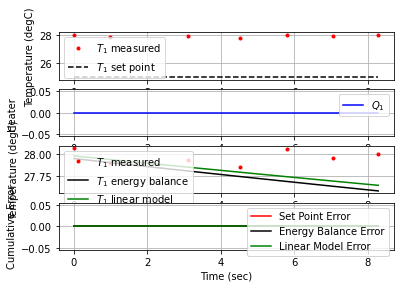

  11.1  25.00  27.97   0.00  -0.60   0.00  -0.00


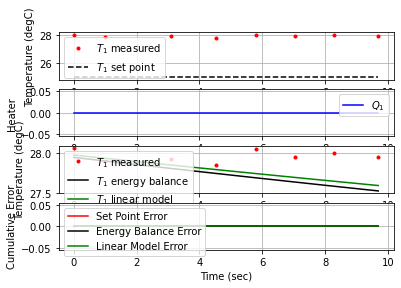

  12.4  25.00  27.85   0.00  -0.58   0.00   0.01


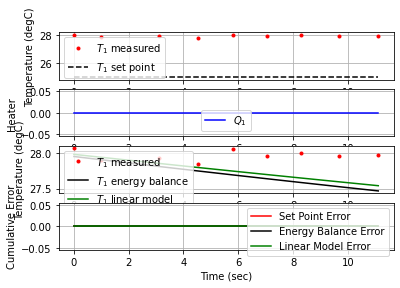

  13.8  25.00  27.89   0.00  -0.58   0.00  -0.00


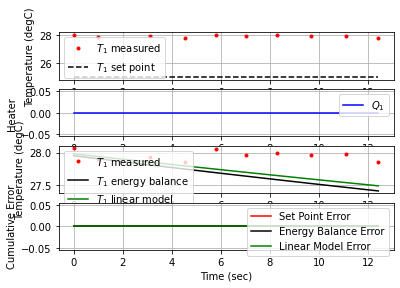

  15.3  25.00  28.09   0.00  -0.62   0.00  -0.01


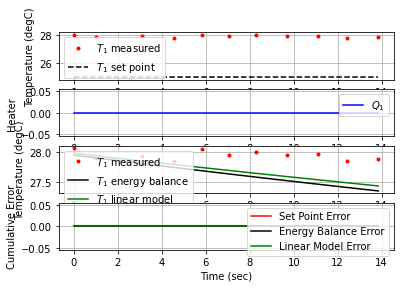

  16.8  25.00  27.95   0.00  -0.60   0.00   0.01


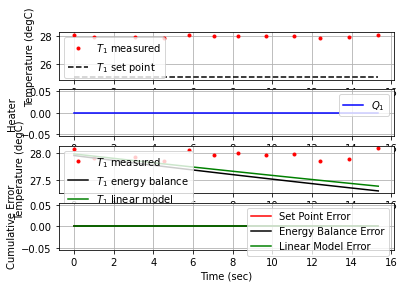

  18.4  25.00  28.09   0.00  -0.62   0.00  -0.01


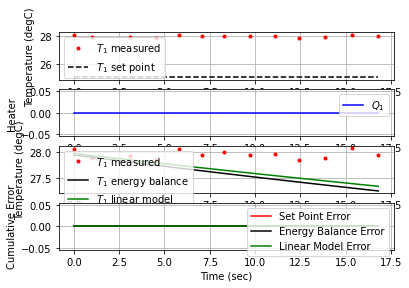

  19.8  25.00  28.10   0.00  -0.63   0.00  -0.00


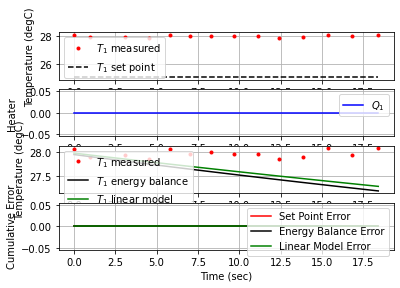

  21.2  25.00  27.98   0.00  -0.60   0.00   0.01


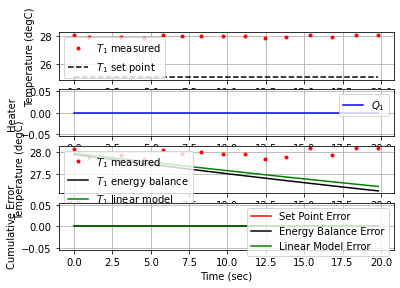

  22.7  25.00  28.07   0.00  -0.62   0.00  -0.00


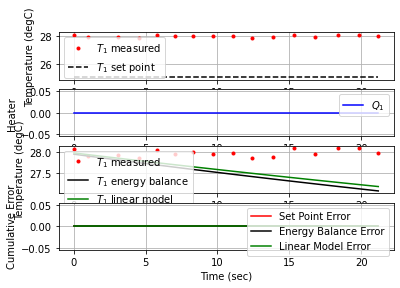

  23.9  25.00  28.04   0.00  -0.61   0.00   0.00


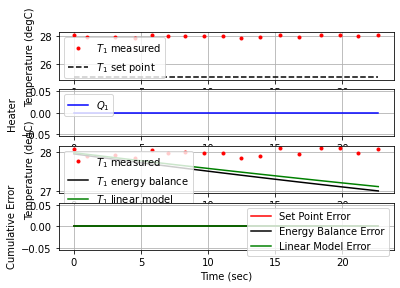

  25.2  25.00  27.90   0.00  -0.59   0.00   0.01


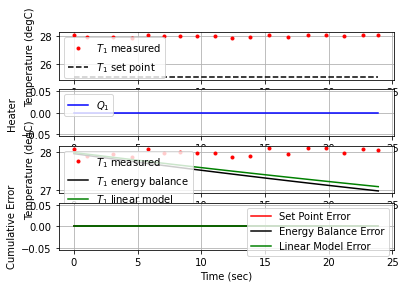

  26.5  25.00  27.99   0.00  -0.60   0.00  -0.01


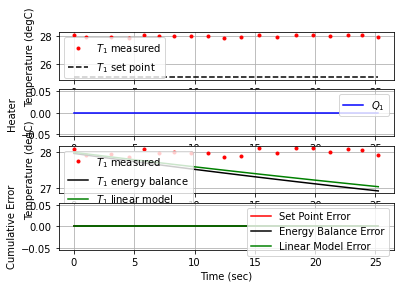

  27.7  25.00  28.02   0.00  -0.61   0.00  -0.00


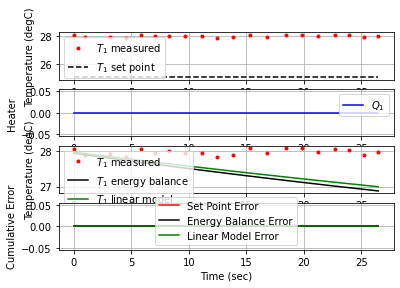

  28.9  25.00  27.94   0.00  -0.59   0.00   0.00


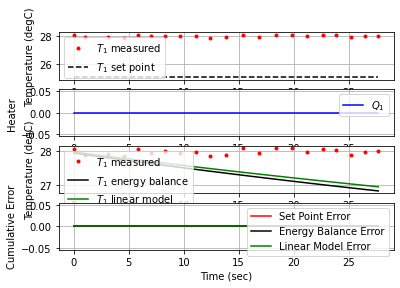

  30.2  25.00  27.82   0.00  -0.57   0.00   0.01


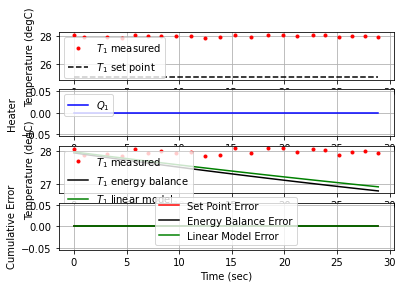

  31.6  25.00  27.97   0.00  -0.60   0.00  -0.01


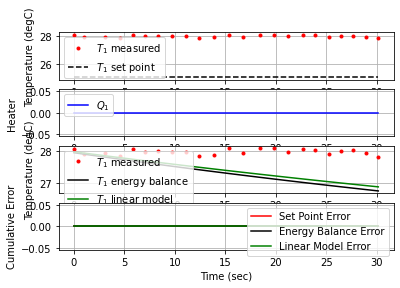

  32.8  25.00  27.95   0.00  -0.60   0.00   0.00


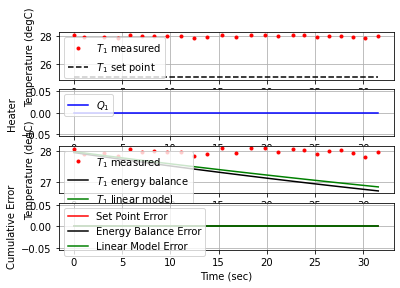

  34.0  25.00  27.99   0.00  -0.60   0.00  -0.00


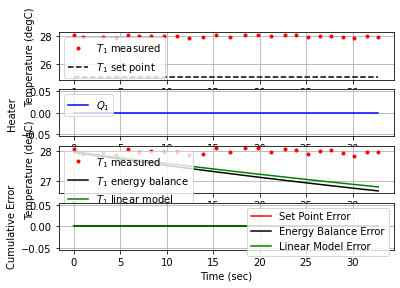

  35.3  25.00  27.93   0.00  -0.59   0.00   0.00


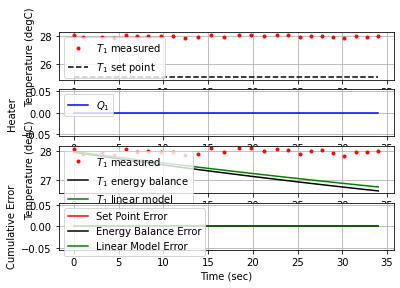

  36.5  25.00  27.90   0.00  -0.59   0.00   0.00


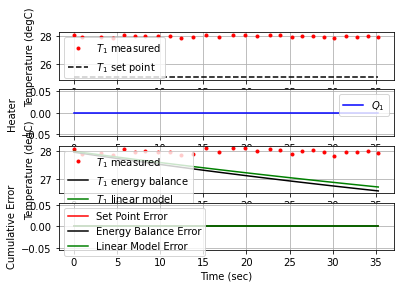

  37.9  25.00  28.09   0.00  -0.62   0.00  -0.01


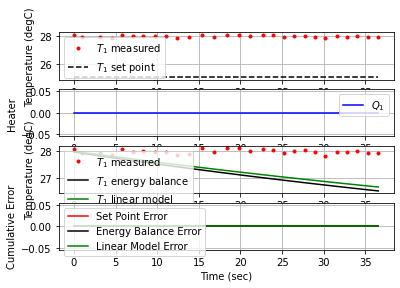

  39.2  25.00  28.10   0.00  -0.63   0.00  -0.00


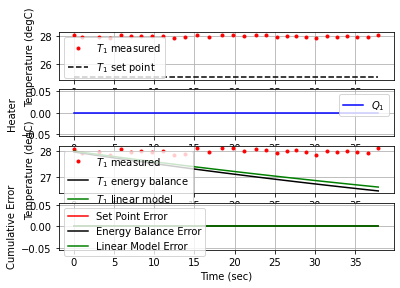

  40.4  25.00  28.12   0.00  -0.63   0.00  -0.00


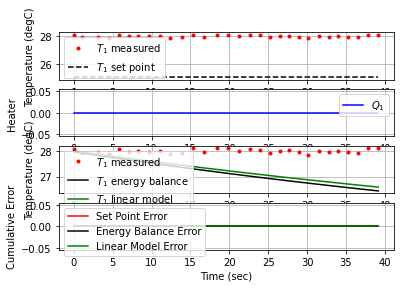

  41.7  25.00  27.88   0.00  -0.58   0.00   0.01


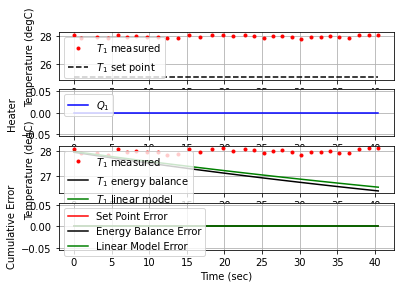

  43.1  25.00  28.22   0.00  -0.65   0.00  -0.02


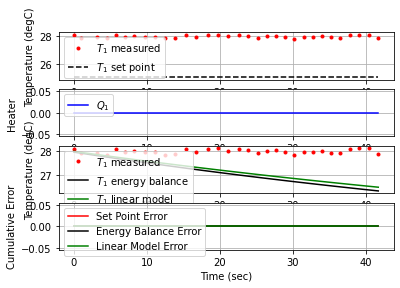

  44.4  25.00  27.97   0.00  -0.60   0.00   0.01


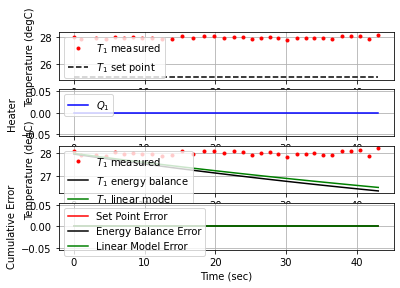

  45.5  25.00  27.90   0.00  -0.59   0.00   0.00


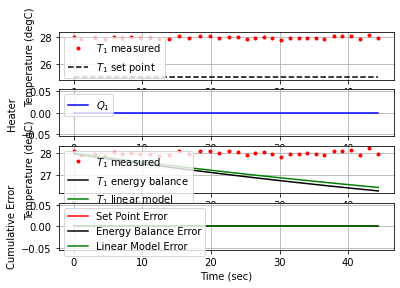

  46.7  25.00  28.05   0.00  -0.62   0.00  -0.01


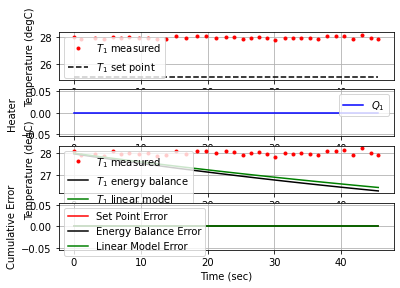

  47.9  25.00  27.95   0.00  -0.60   0.00   0.01


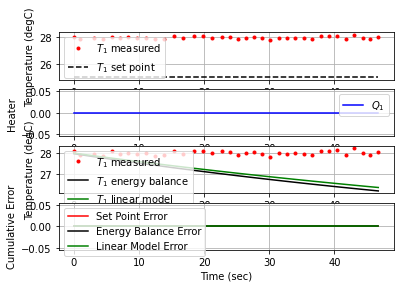

  49.0  25.00  27.84   0.00  -0.57   0.00   0.01


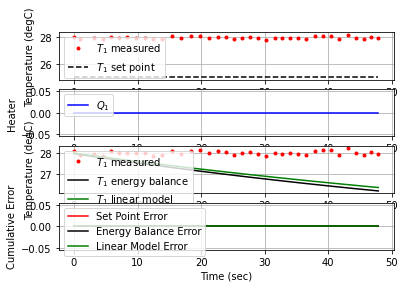

  50.4  25.00  27.90   0.00  -0.59   0.00  -0.00


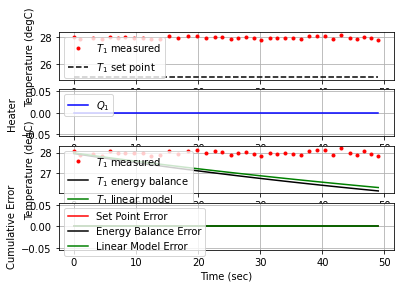

  51.7  25.00  28.01   0.00  -0.61   0.00  -0.01


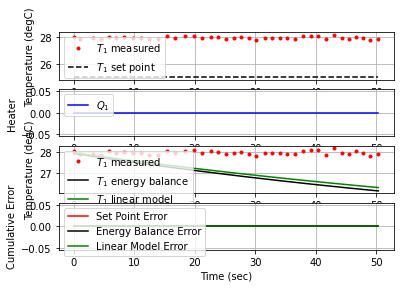

  53.0  25.00  28.04   0.00  -0.61   0.00  -0.00


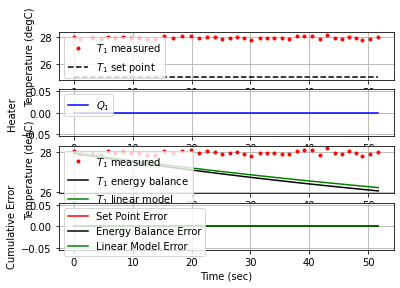

  54.2  25.00  28.01   0.00  -0.61   0.00   0.00


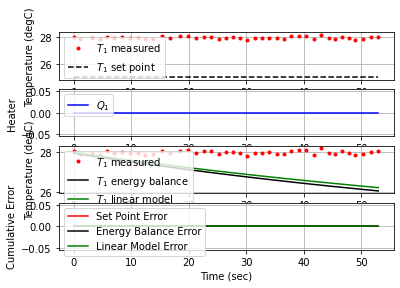

  55.4  25.00  28.03   0.00  -0.61   0.00  -0.00


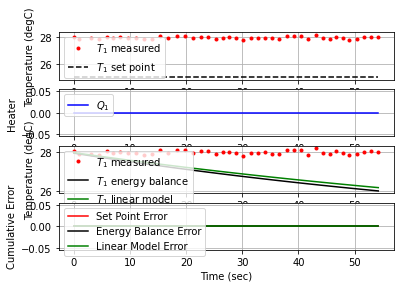

  56.6  25.00  27.90   0.00  -0.59   0.00   0.01


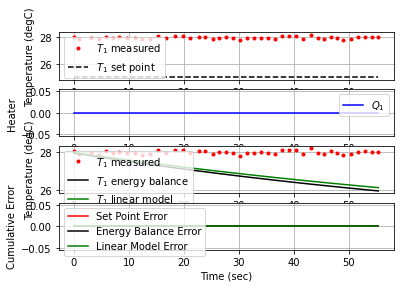

  58.0  25.00  28.08   0.00  -0.62   0.00  -0.01


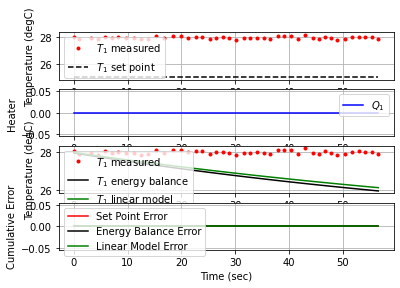

  59.1  25.00  28.29   0.00  -0.66   0.00  -0.01


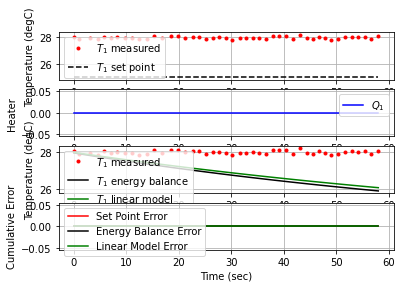

  60.5  25.00  28.19   0.00  -0.64   0.00   0.01


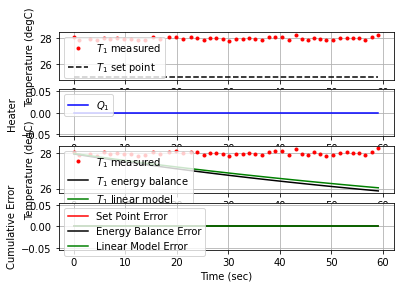

  61.7  25.00  27.89   0.00  -0.58   0.00   0.02


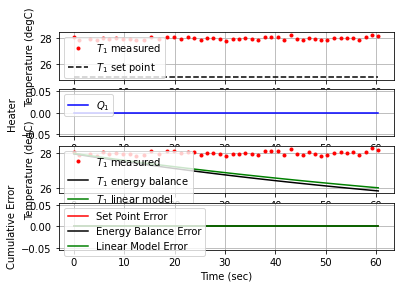

  62.9  25.00  27.95   0.00  -0.60   0.00  -0.00


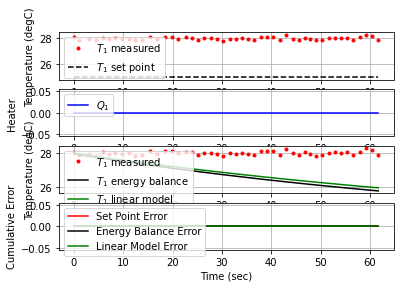

  64.3  25.00  28.10   0.00  -0.63   0.00  -0.01


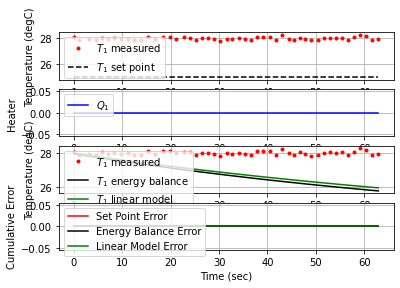

  65.6  25.00  28.09   0.00  -0.62   0.00   0.00


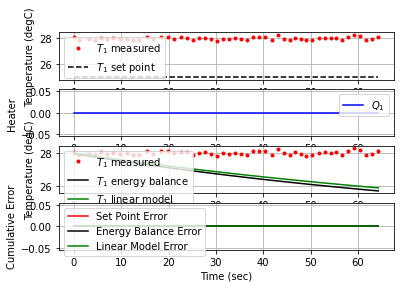

  66.9  25.00  27.94   0.00  -0.59   0.00   0.01


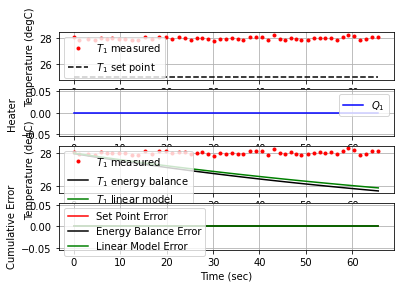

  68.2  25.00  27.92   0.00  -0.59   0.00   0.00


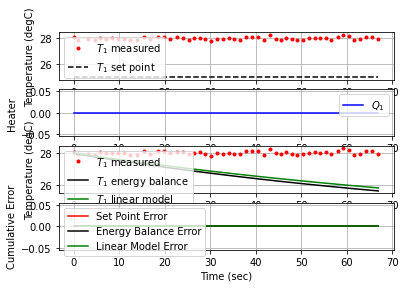

  69.5  25.00  27.84   0.00  -0.57   0.00   0.00


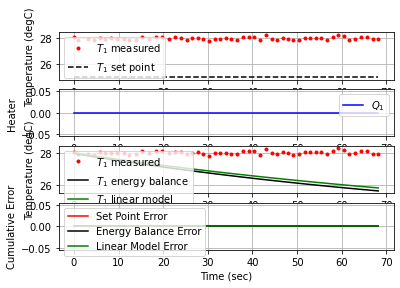

  70.7  25.00  27.98   0.00  -0.60   0.00  -0.01


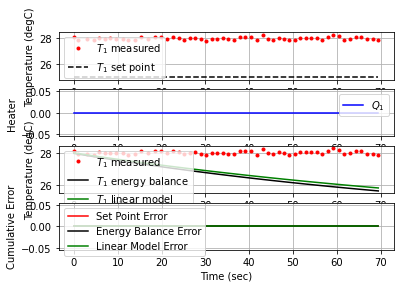

  72.1  25.00  27.95   0.00  -0.60   0.00   0.00


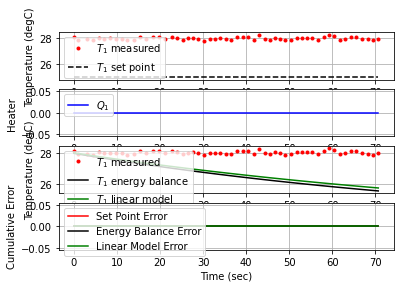

  73.4  25.00  28.14   0.00  -0.63   0.00  -0.01


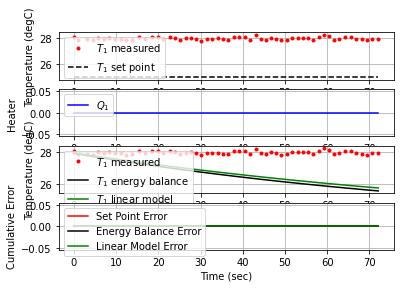

  74.7  25.00  28.06   0.00  -0.62   0.00   0.00


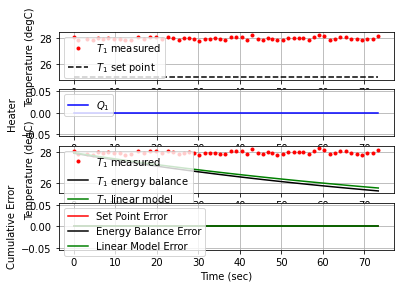

  76.1  25.00  28.08   0.00  -0.62   0.00  -0.00


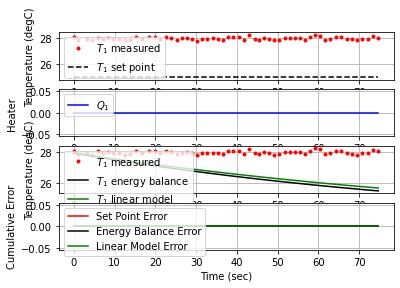

  77.7  25.00  27.99   0.00  -0.60   0.00   0.00


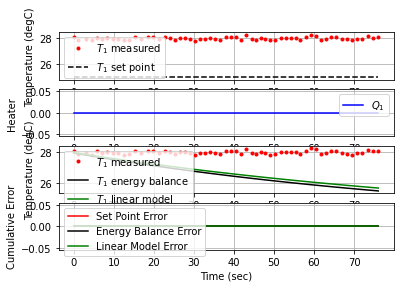

  79.0  45.00  28.10  10.11   3.74   6.37  -0.01


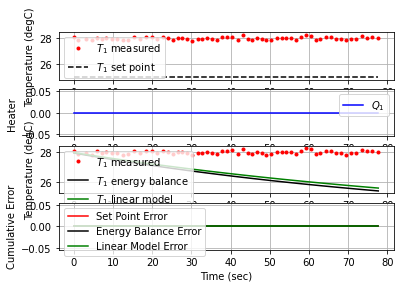

  80.5  45.00  27.95  17.41   3.78  13.62   0.01


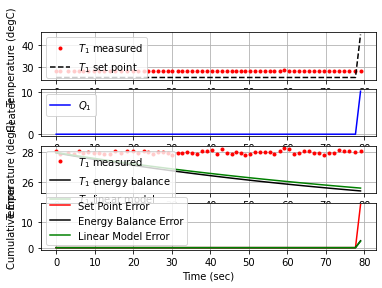

  81.7  45.00  27.97  23.42   3.77  19.65  -0.00


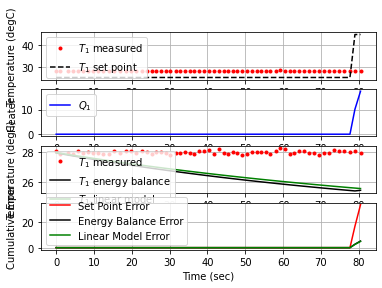

  83.1  45.00  28.08  30.07   3.75  26.33  -0.01


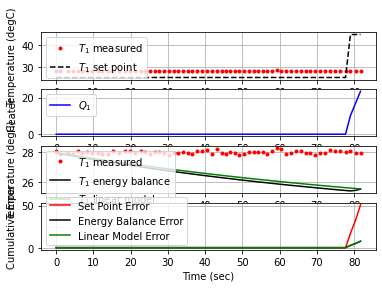

  84.7  45.00  28.05  37.93   3.75  34.17   0.00


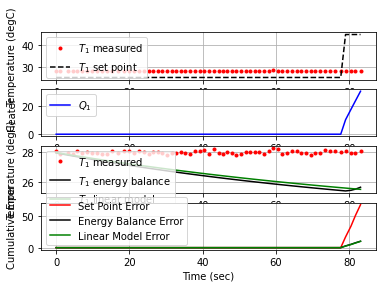

  85.9  45.00  28.16  43.63   3.73  39.91  -0.01


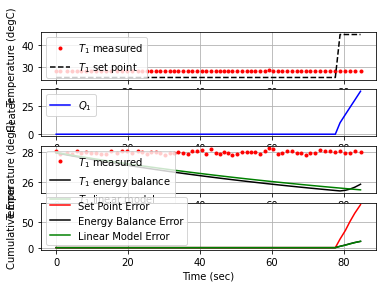

  87.1  45.00  28.10  49.65   3.74  45.91   0.00


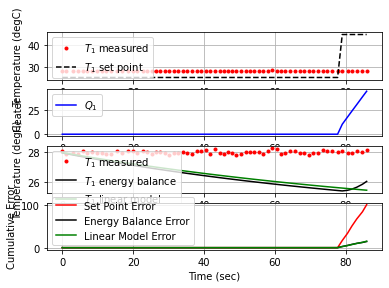

  88.4  45.00  28.07  55.95   3.75  52.20   0.00


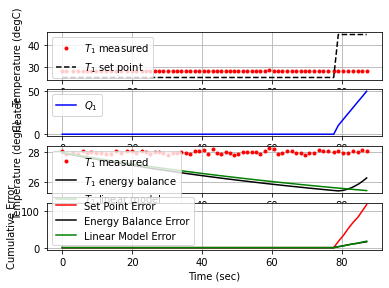

  89.8  45.00  28.22  62.84   3.72  59.13  -0.01


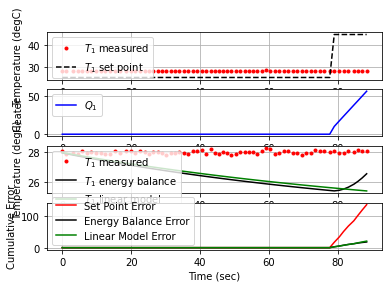

  91.3  45.00  28.15  69.81   3.73  66.08   0.00


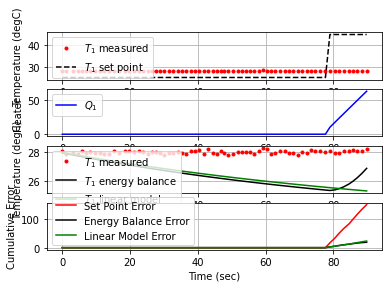

  92.5  45.00  28.28  75.91   3.70  72.22  -0.01


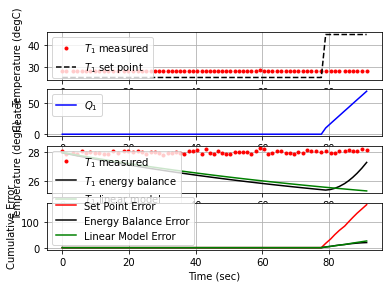

  93.7  45.00  28.33  81.42   3.69  77.73  -0.00


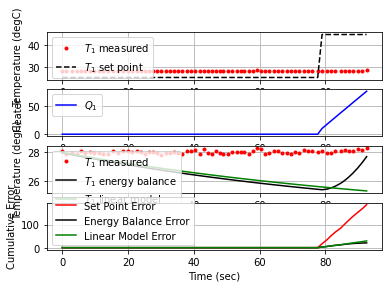

  94.9  45.00  28.40  86.98   3.68  83.31  -0.01


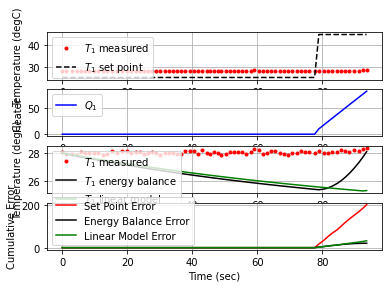

  96.0  45.00  28.39  92.57   3.68  88.89   0.00


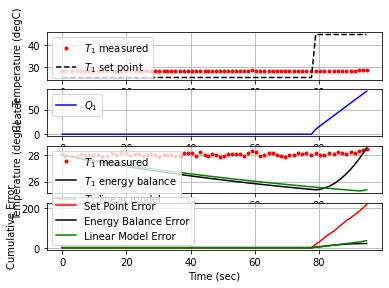

  97.2  45.00  28.57  98.26   3.64  94.63  -0.01


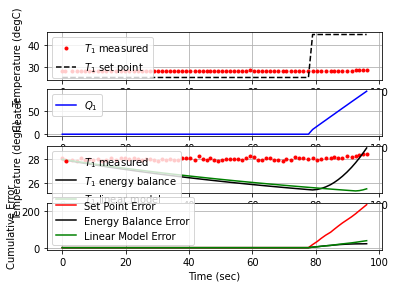

  98.7  45.00  28.55 100.00   3.64  94.63   0.00


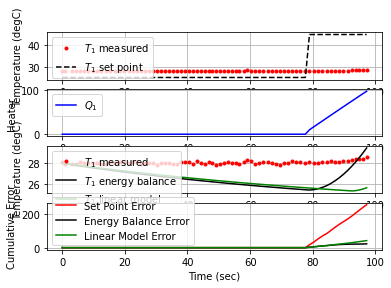

  99.9  45.00  28.44 100.00   3.67  94.63   0.01


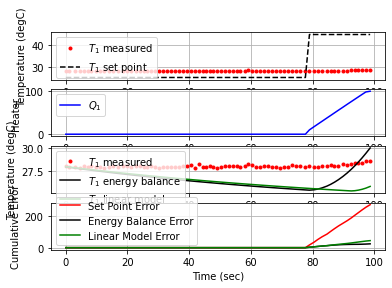

 101.1  45.00  28.73 100.00   3.60  94.63  -0.02


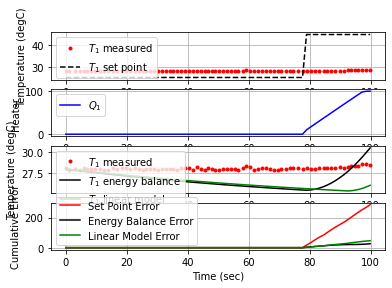

 102.4  45.00  28.92 100.00   3.56  94.63  -0.01


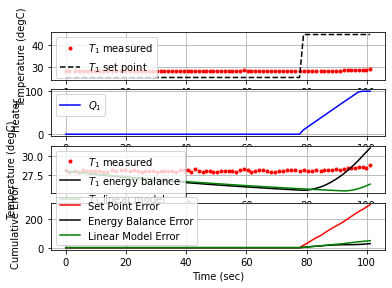

 103.6  45.00  28.98 100.00   3.55  94.63  -0.00


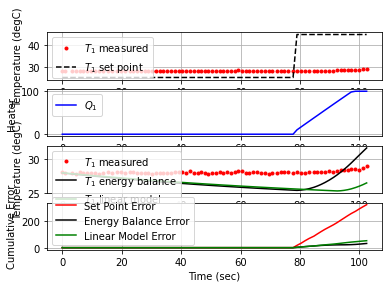

 105.0  45.00  28.94 100.00   3.56  94.63   0.00


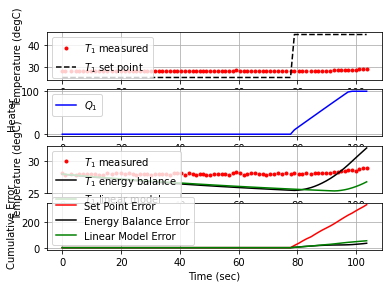

 106.2  45.00  29.12 100.00   3.52  94.63  -0.01


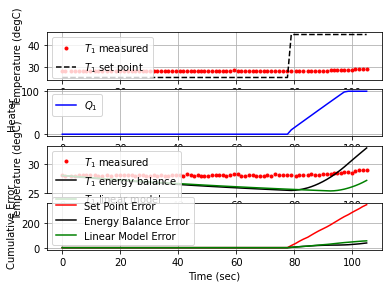

 107.5  45.00  29.14 100.00   3.51  94.63  -0.00


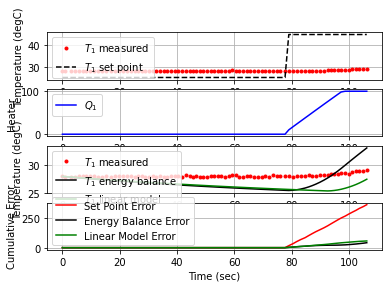

 108.6  45.00  29.26 100.00   3.49  94.63  -0.01


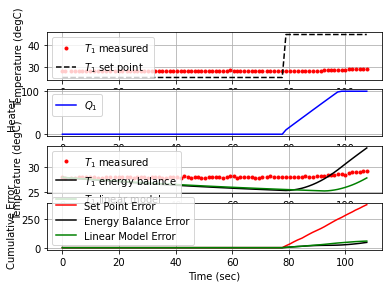

 109.8  45.00  29.36 100.00   3.46  94.63  -0.01


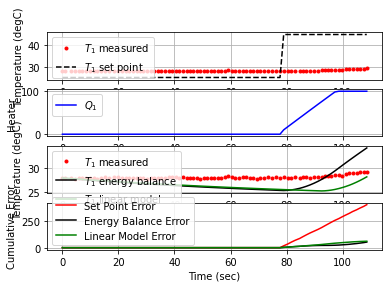

 110.9  45.00  29.50 100.00   3.43  94.63  -0.01


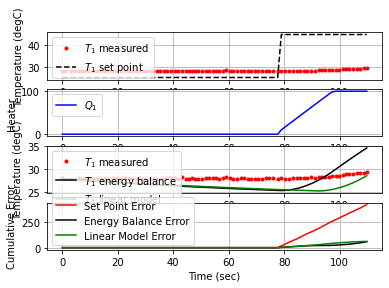

 112.4  45.00  29.69 100.00   3.39  94.63  -0.01


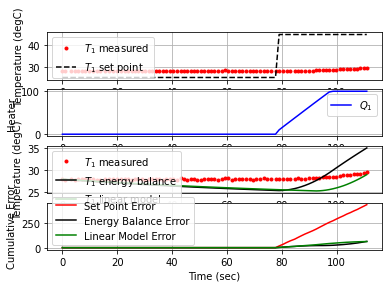

 113.7  45.00  29.59 100.00   3.41  94.63   0.01


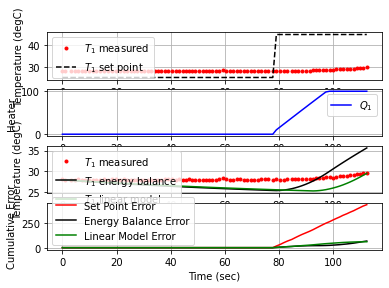

 114.9  45.00  29.79 100.00   3.37  94.63  -0.01


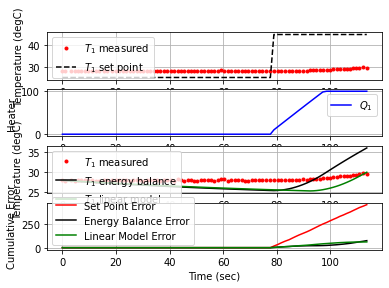

 116.1  45.00  29.85 100.00   3.36  94.63  -0.00


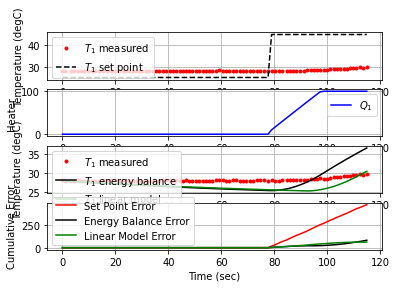

 117.3  45.00  29.77 100.00   3.37  94.63   0.01


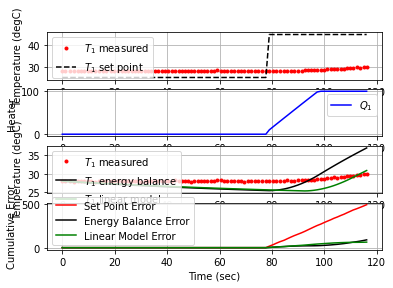

 118.6  45.00  30.13 100.00   3.29  94.63  -0.02


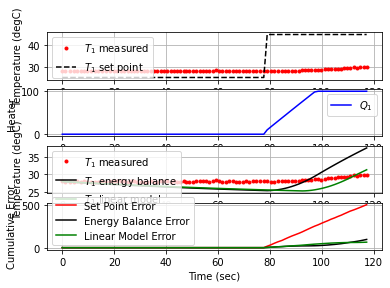

 119.8  45.00  30.44 100.00   3.22  94.63  -0.02


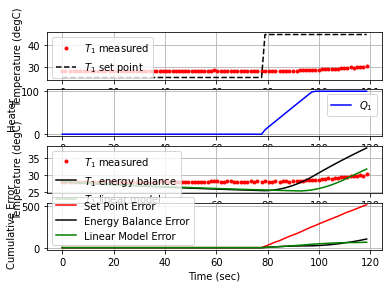

 121.0  45.00  30.42 100.00   3.23  94.63   0.00


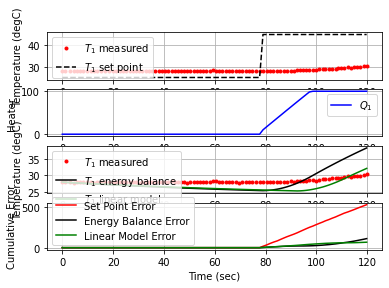

 122.1  45.00  30.43 100.00   3.23  94.63  -0.00


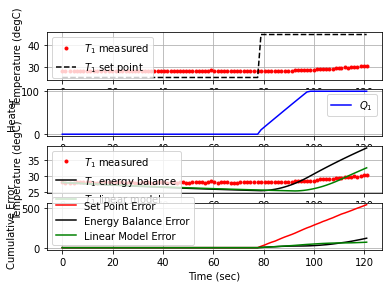

 123.4  45.00  30.79 100.00   3.15  94.63  -0.02


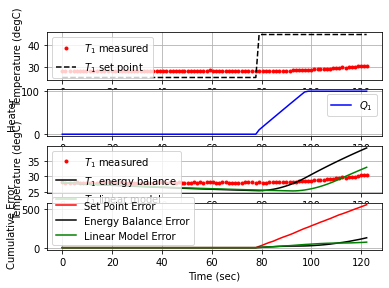

 124.6  45.00  30.88 100.00   3.13  94.63  -0.01


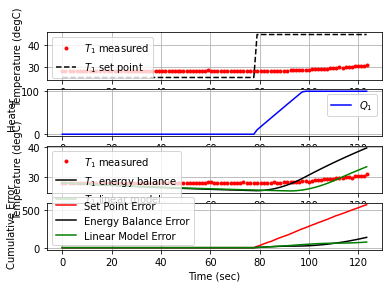

 126.0  45.00  30.84 100.00   3.14  94.63   0.00


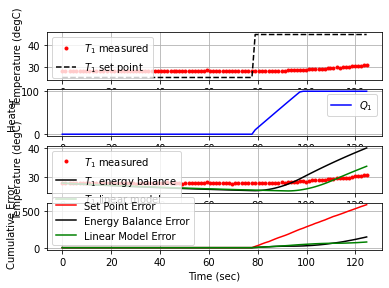

 127.2  45.00  31.03 100.00   3.09  94.63  -0.01


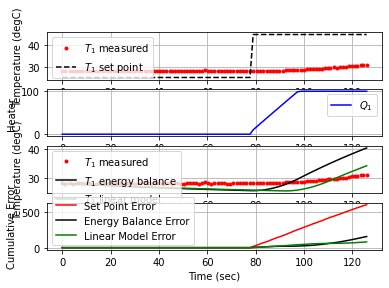

 128.5  45.00  31.10 100.00   3.08  94.63  -0.00


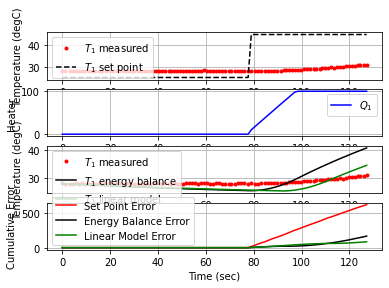

 129.6  45.00  31.30 100.00   3.03  94.63  -0.01


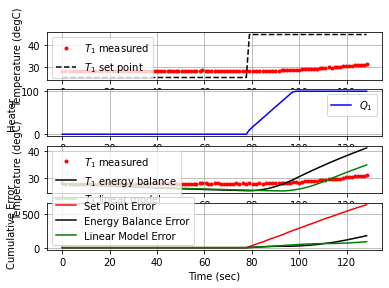

 130.8  45.00  31.36 100.00   3.02  94.63  -0.00


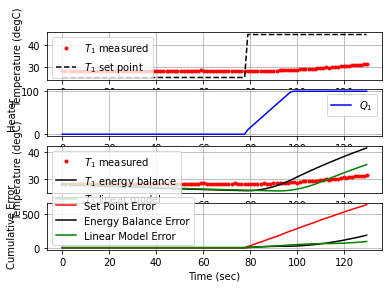

 132.1  45.00  31.61 100.00   2.97  94.63  -0.02


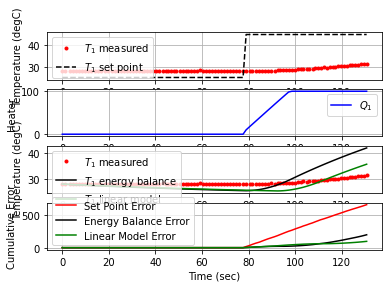

 133.4  45.00  31.70 100.00   2.95  94.63  -0.01


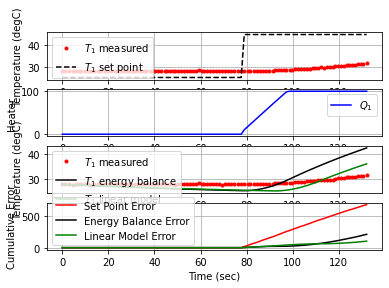

 134.6  45.00  31.88 100.00   2.91  94.63  -0.01


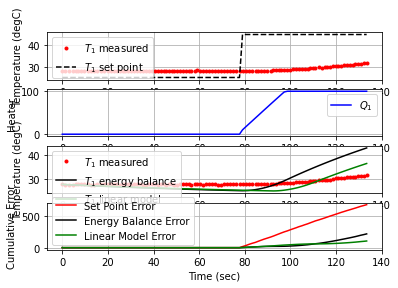

 135.7  45.00  31.96 100.00   2.89  94.63  -0.01


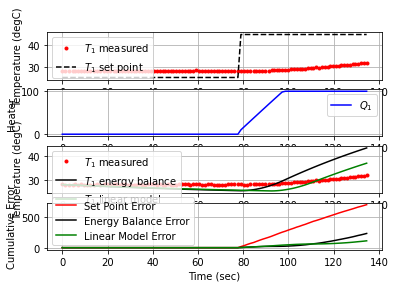

 137.0  45.00  32.13 100.00   2.85  94.63  -0.01


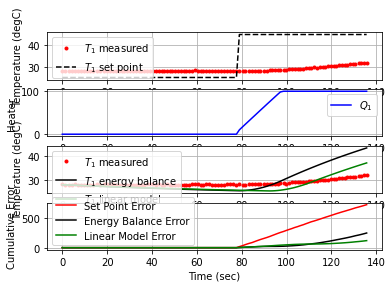

 138.3  45.00  32.05 100.00   2.87  94.63   0.01


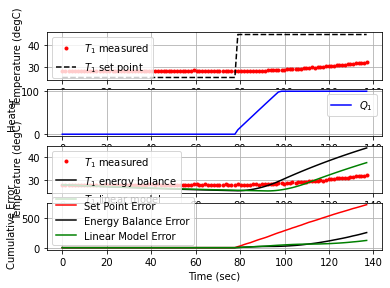

 139.5  45.00  32.44 100.00   2.78  94.63  -0.03


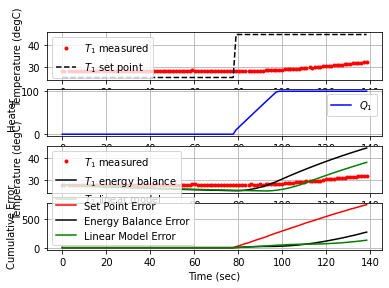

 140.8  45.00  32.57 100.00   2.75  94.63  -0.01


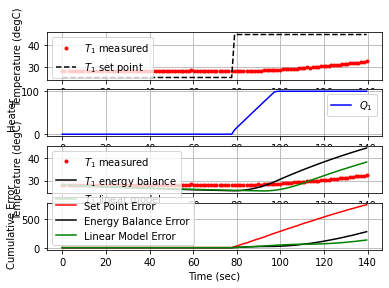

 141.9  45.00  32.69 100.00   2.73  94.63  -0.01


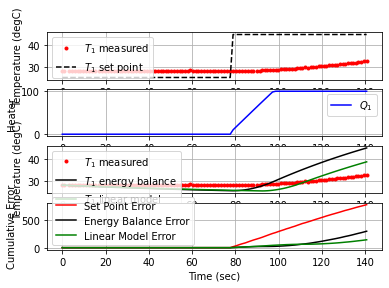

 143.1  45.00  32.95 100.00   2.67  94.63  -0.02


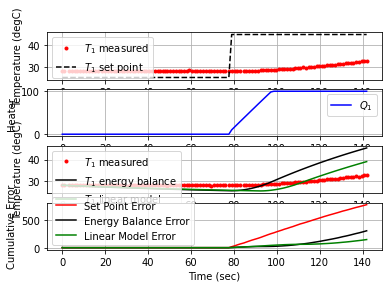

 144.4  45.00  32.92 100.00   2.68  94.63   0.00


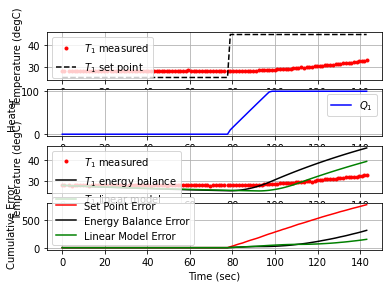

 145.6  45.00  33.17 100.00   2.62  94.63  -0.02


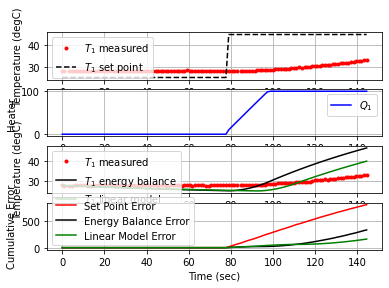

 146.8  45.00  33.23 100.00   2.61  94.63  -0.00


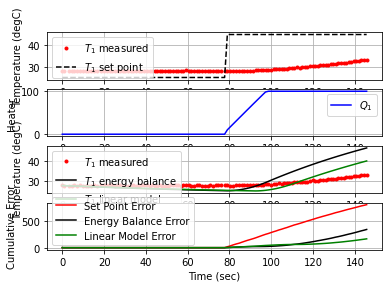

 148.0  45.00  33.30 100.00   2.59  94.63  -0.00


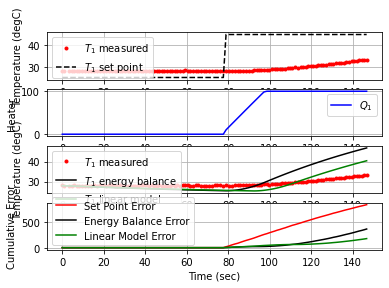

 149.2  45.00  33.54 100.00   2.54  94.63  -0.02


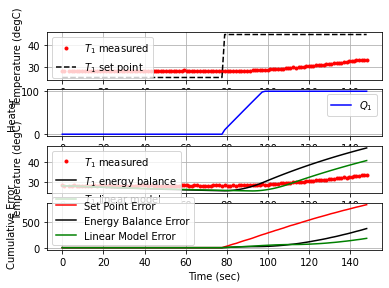

 150.4  45.00  33.62 100.00   2.52  94.63  -0.01


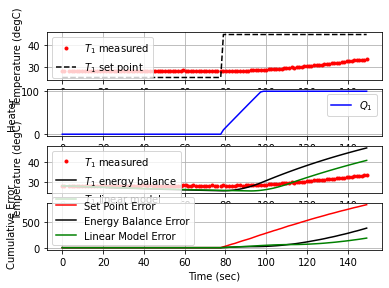

 151.7  45.00  33.70 100.00   2.50  94.63  -0.01


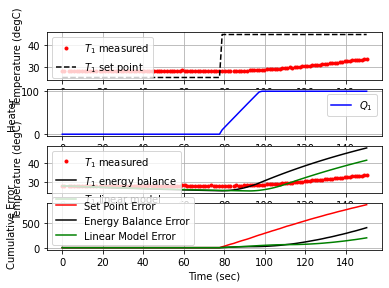

 152.9  45.00  34.00 100.00   2.44  94.63  -0.02


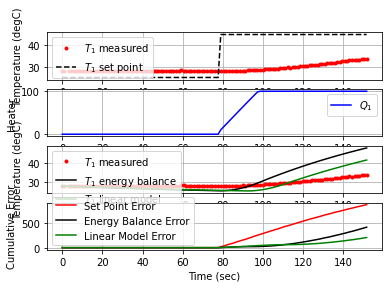

 154.1  45.00  34.20 100.00   2.39  94.63  -0.01


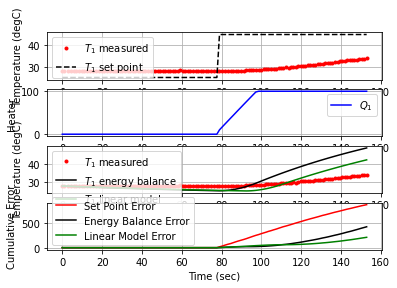

 155.3  45.00  34.15 100.00   2.40  94.63   0.00


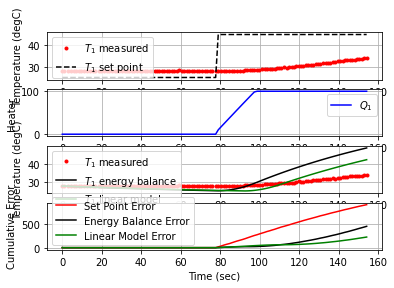

 156.7  45.00  34.45 100.00   2.34  94.63  -0.02


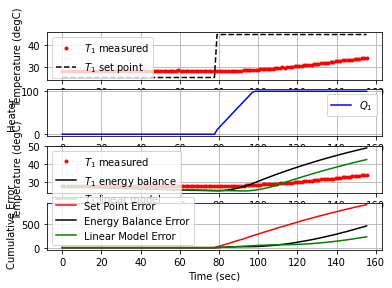

 158.0  45.00  34.43 100.00   2.34  94.63   0.00


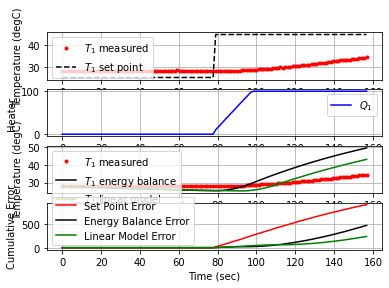

 159.2  45.00  34.70 100.00   2.28  94.63  -0.02


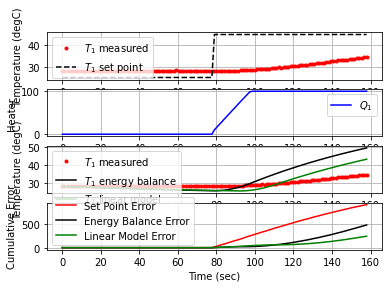

 160.5  45.00  35.09 100.00   2.19  94.63  -0.03


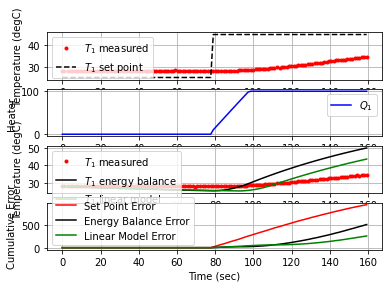

 161.7  45.00  34.85 100.00   2.25  94.63   0.02


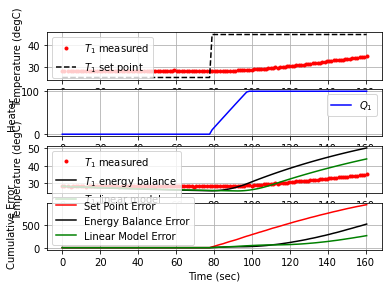

 163.1  45.00  35.07 100.00   2.20  94.63  -0.01


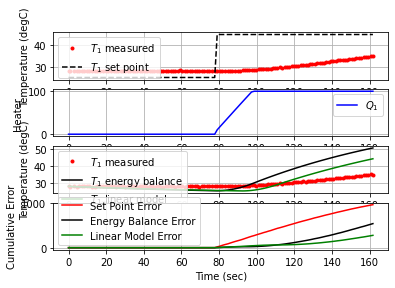

 164.3  45.00  35.17 100.00   2.18  94.63  -0.01


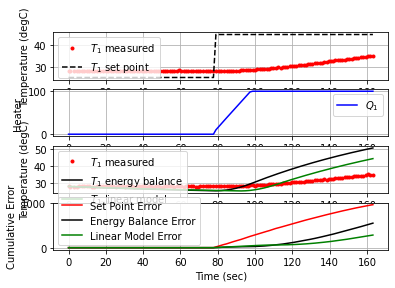

 165.6  45.00  35.37 100.00   2.13  94.63  -0.01


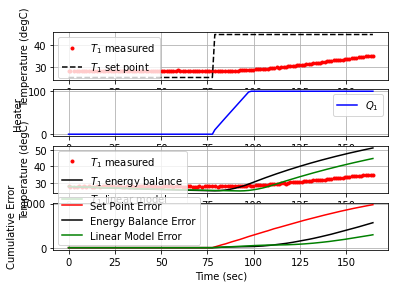

 166.8  45.00  35.48 100.00   2.11  94.63  -0.01


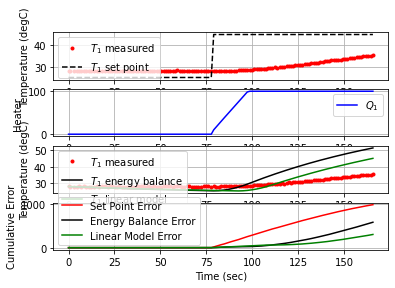

 168.0  45.00  35.75  99.69   2.05  97.66  -0.02


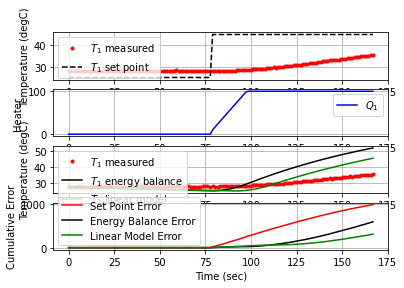

 169.4  45.00  35.78 100.00   2.04  97.66  -0.00


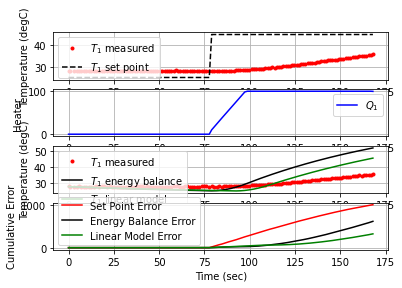

 170.5  45.00  35.85 100.00   2.03  97.66  -0.01


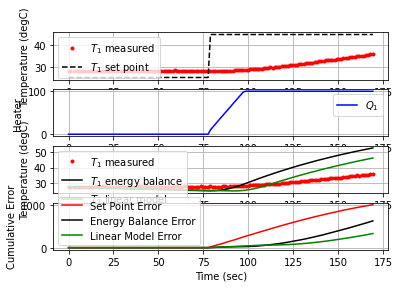

 171.7  45.00  35.96 100.00   2.00  97.66  -0.01


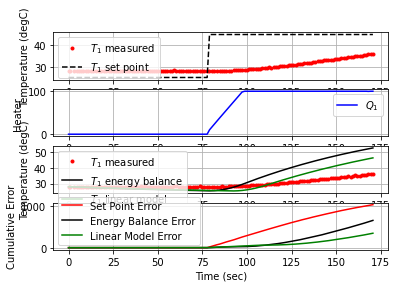

 173.0  45.00  36.17 100.00   1.96  97.66  -0.01


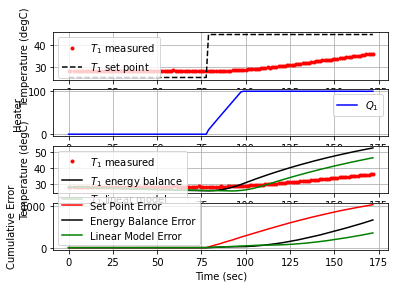

 174.3  45.00  36.23 100.00   1.94  97.66  -0.00


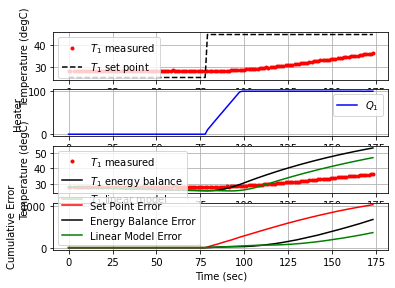

 175.6  45.00  36.51 100.00   1.88  97.66  -0.02


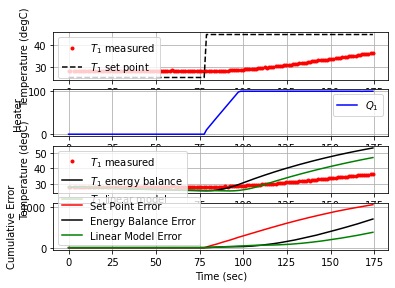

 176.9  45.00  36.57 100.00   1.87  97.66  -0.00


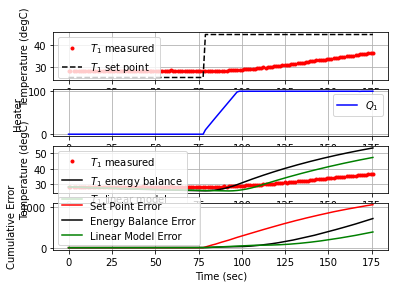

 178.1  45.00  36.78 100.00   1.82  97.66  -0.01


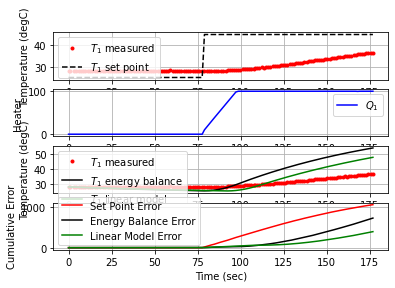

 179.3  45.00  36.77 100.00   1.82  97.66   0.00


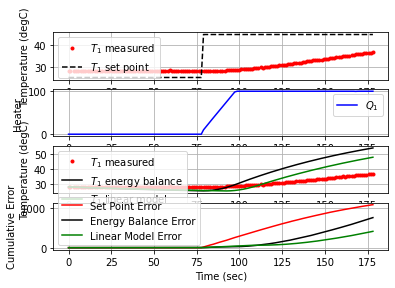

 180.7  45.00  36.85 100.00   1.81  97.66  -0.01


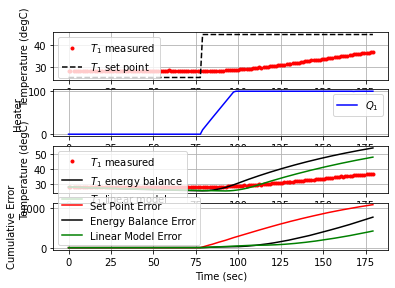

 182.3  45.00  37.21 100.00   1.73  97.66  -0.02


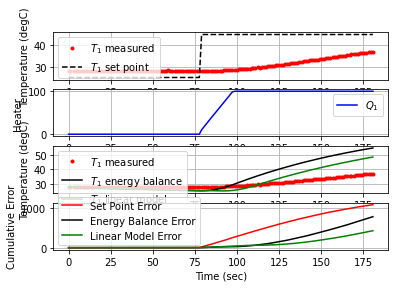

 183.6  45.00  37.24 100.00   1.72  97.66  -0.00


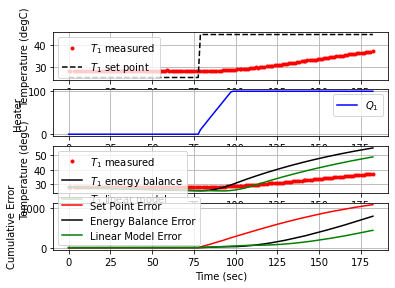

 185.2  45.00  37.72 100.00   1.61  97.66  -0.03


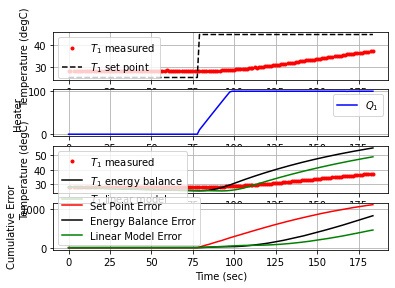

 186.5  45.00  37.58 100.00   1.64  97.66   0.01


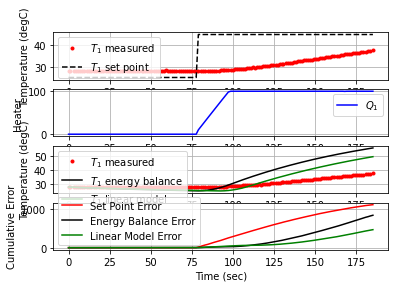

 187.8  45.00  37.89 100.00   1.57  97.66  -0.02


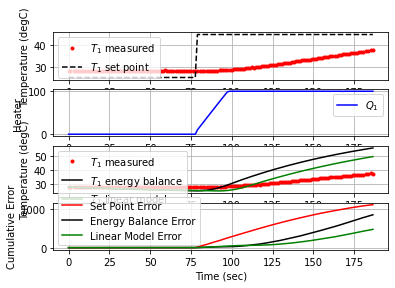

 189.2  45.00  38.12 100.00   1.52  97.66  -0.01


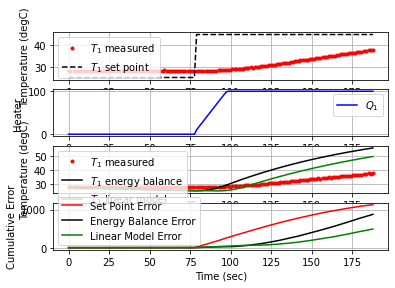

 190.4  45.00  38.08 100.00   1.53  97.66   0.00


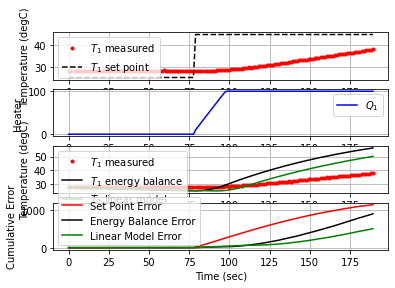

 191.7  45.00  38.25 100.00   1.49  97.66  -0.01


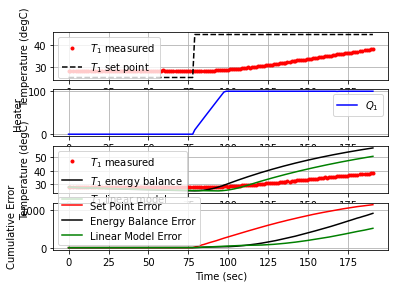

 193.0  45.00  38.38 100.00   1.47  97.66  -0.01


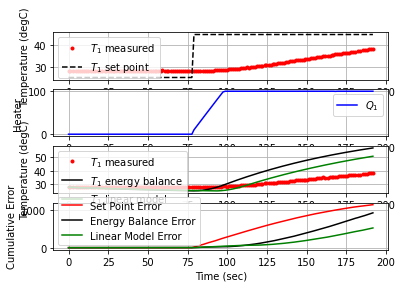

 194.4  45.00  38.57 100.00   1.42  97.66  -0.01


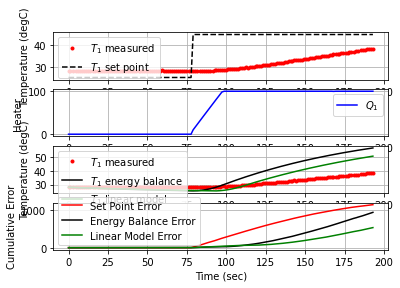

 195.6  45.00  38.59 100.00   1.42  97.66  -0.00


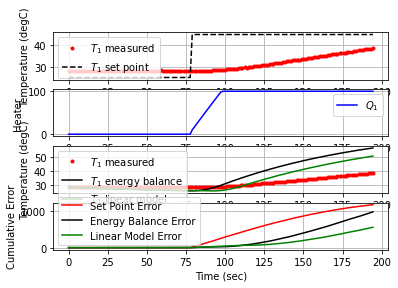

 196.8  45.00  38.75 100.00   1.38  97.66  -0.01


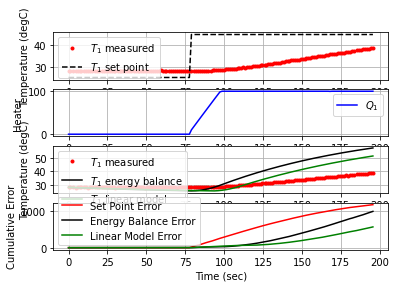

 198.1  45.00  38.87 100.00   1.36  97.66  -0.01


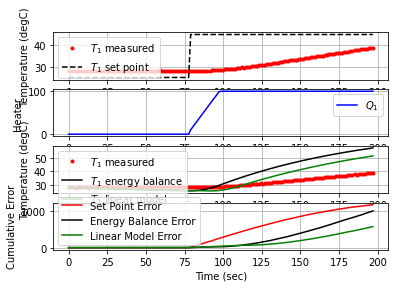

 199.3  45.00  39.16 100.00   1.29  97.66  -0.02


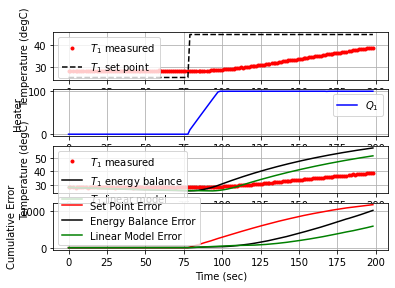

 200.7  45.00  39.12 100.00   1.30  97.66   0.00


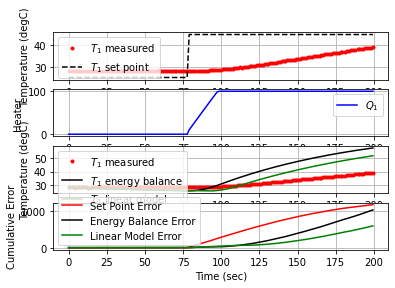

 202.0  45.00  39.28 100.00   1.27  97.66  -0.01


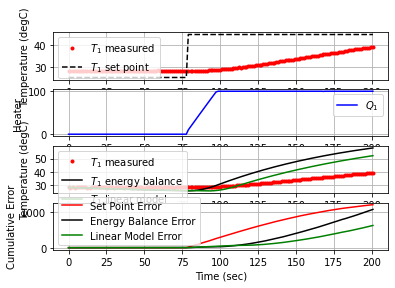

 203.3  45.00  39.29 100.00   1.26  97.66  -0.00


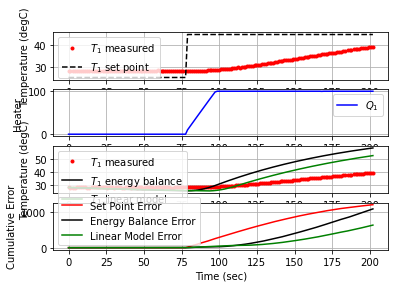

 204.8  45.00  39.69 100.00   1.18  97.66  -0.02


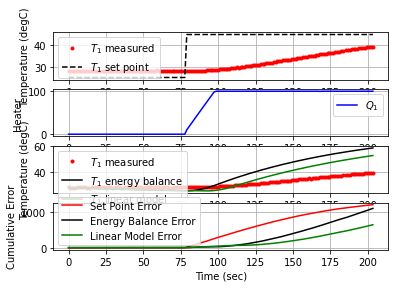

 206.1  45.00  39.67 100.00   1.18  97.66   0.00


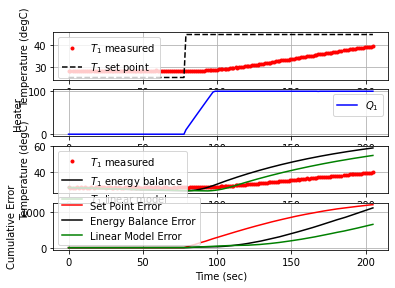

 207.3  45.00  39.77 100.00   1.16  97.66  -0.01


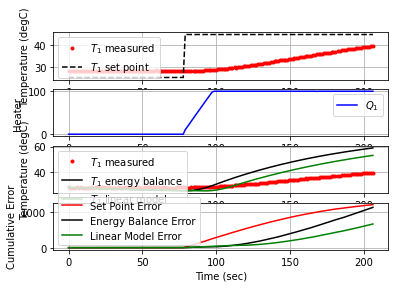

 208.5  45.00  40.04 100.00   1.10  97.66  -0.02


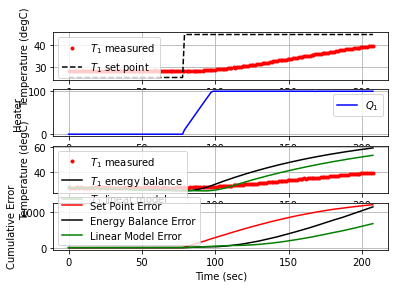

 209.7  45.00  40.10 100.00   1.09  97.66  -0.00


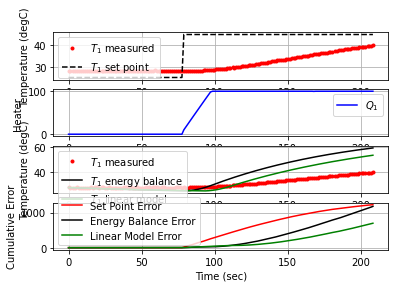

 210.9  45.00  40.17 100.00   1.07  97.66  -0.00


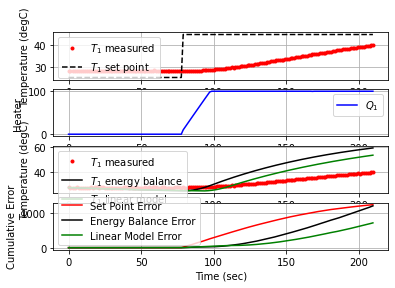

 212.1  45.00  40.36 100.00   1.03  97.66  -0.01


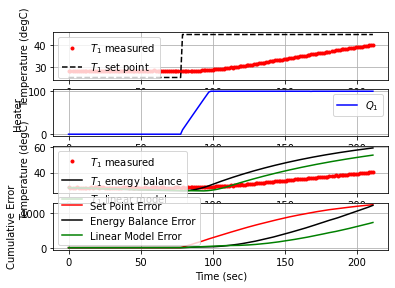

 213.4  45.00  40.44 100.00   1.01  97.66  -0.01


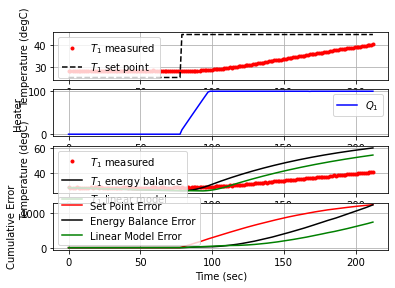

 214.6  45.00  40.67 100.00   0.96  97.66  -0.02


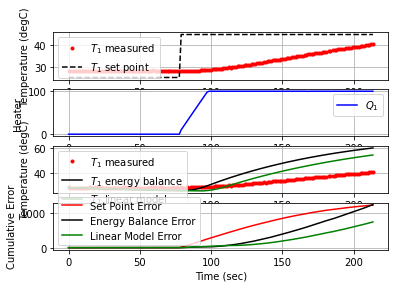

 215.7  45.00  40.59 100.00   0.98  97.66   0.01


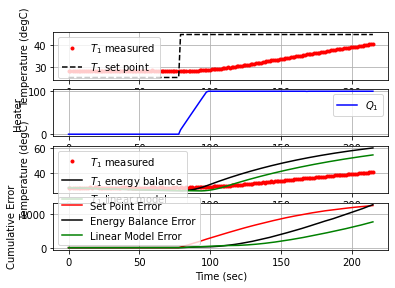

 216.9  45.00  40.75 100.00   0.94  97.66  -0.01


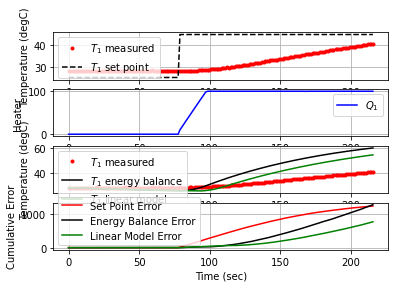

 218.0  45.00  40.77  99.94   0.94  99.01  -0.00


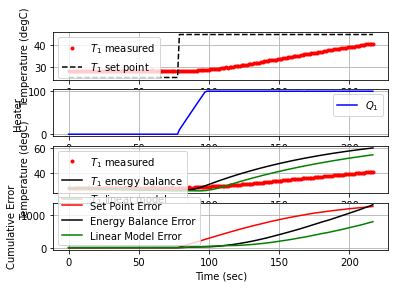

 219.2  45.00  41.12 100.00   0.86  99.01  -0.02


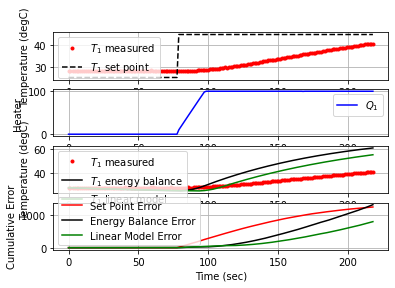

 220.3  45.00  41.15 100.00   0.85  99.01  -0.00


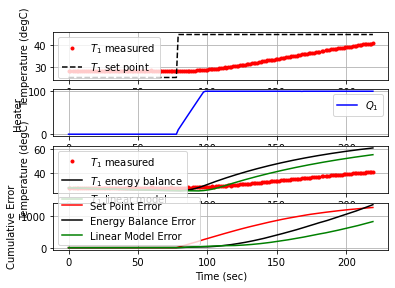

 221.5  45.00  41.14 100.00   0.85  99.01   0.00


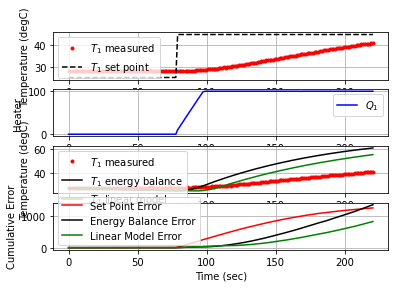

 222.7  45.00  41.36 100.00   0.81  99.01  -0.02


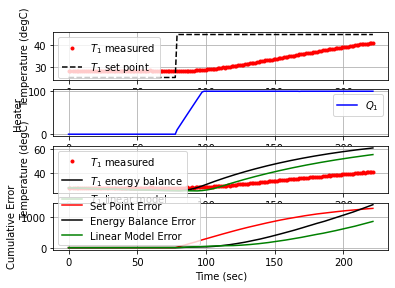

 223.8  45.00  41.55 100.00   0.76  99.01  -0.01


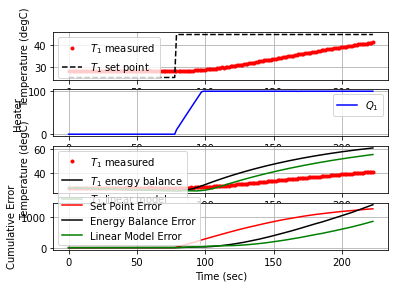

 225.0  45.00  41.61 100.00   0.75  99.01  -0.00


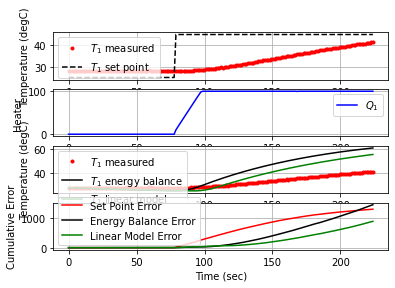

 226.3  45.00  41.56 100.00   0.76  99.01   0.00


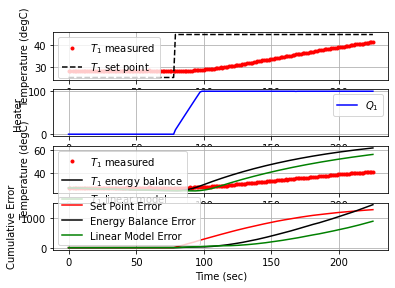

 227.5  45.00  41.91 100.00   0.68  99.01  -0.03


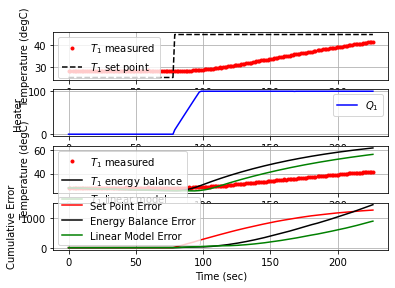

 228.7  45.00  41.78 100.00   0.71  99.01   0.01


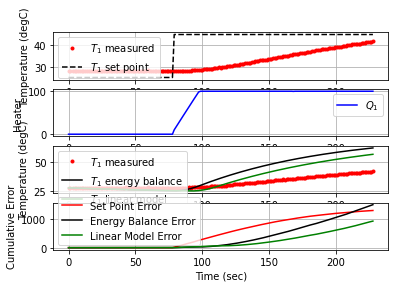

 229.9  45.00  41.80 100.00   0.71  99.01  -0.00


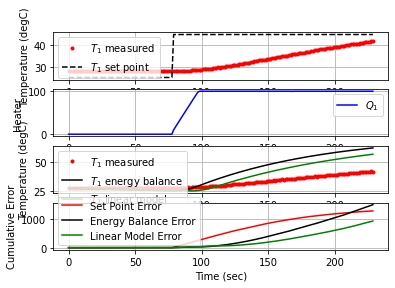

 231.2  45.00  42.23 100.00   0.61  99.01  -0.03


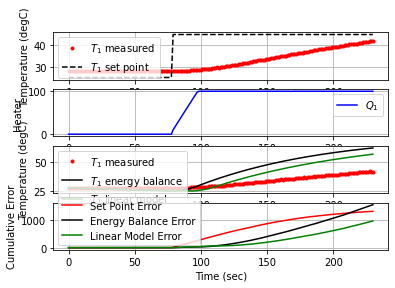

 232.6  45.00  41.92 100.00   0.68  99.01   0.02


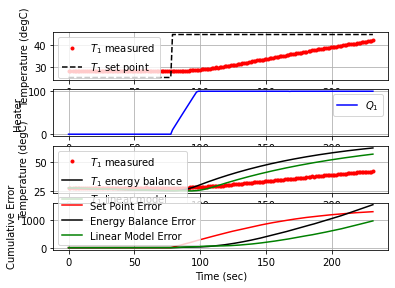

 233.7  45.00  42.17 100.00   0.62  99.01  -0.02


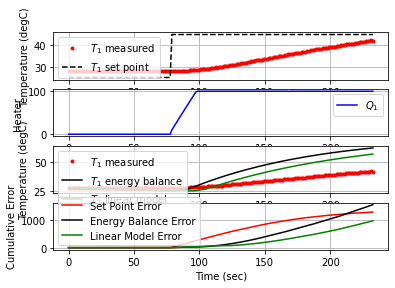

 234.8  45.00  42.33 100.00   0.59  99.01  -0.01


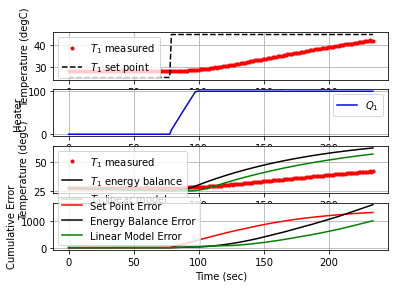

 235.9  45.00  42.49 100.00   0.55  99.01  -0.01


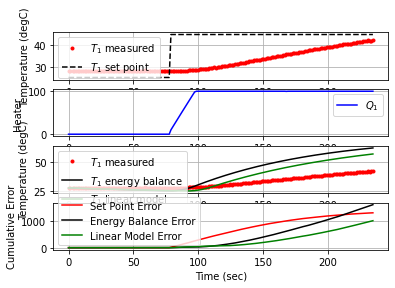

 237.1  45.00  42.39 100.00   0.58  99.01   0.01


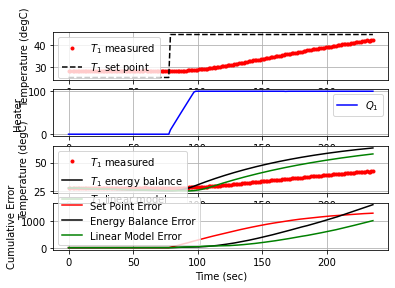

 238.2  45.00  42.46 100.00   0.56  99.01  -0.01


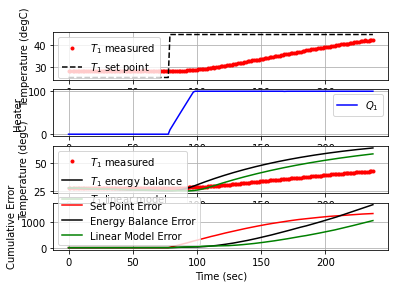

 239.5  45.00  42.73 100.00   0.50  99.01  -0.02


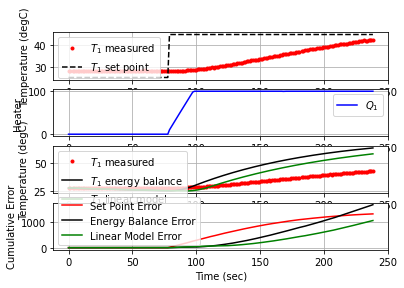

 240.6  45.00  42.85 100.00   0.47  99.01  -0.01


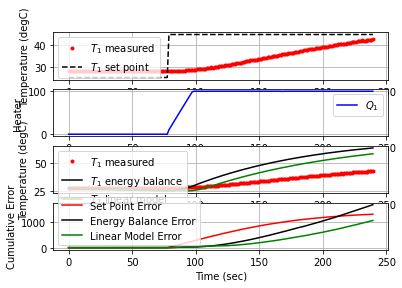

 241.8  45.00  42.93 100.00   0.46  99.01  -0.01


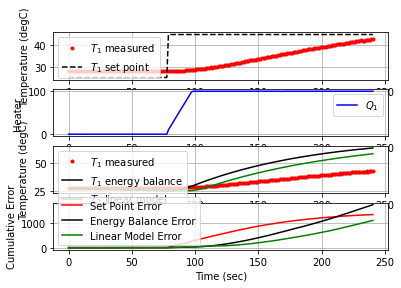

 243.0  45.00  42.97 100.00   0.45  99.01  -0.00


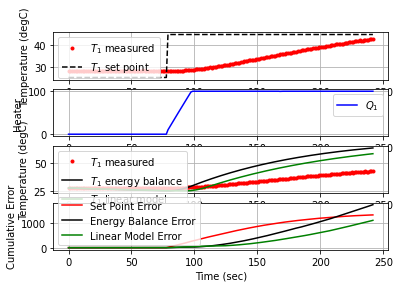

 244.2  45.00  43.01 100.00   0.44  99.01  -0.00


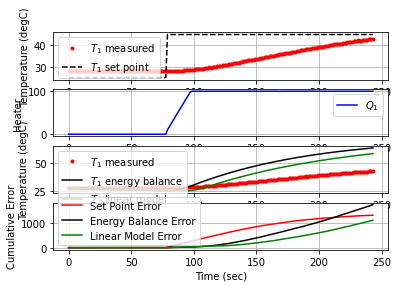

 245.5  45.00  43.30 100.00   0.37  99.64  -0.02


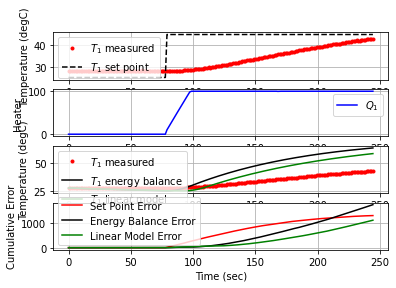

 246.8  45.00  43.41 100.00   0.35  99.64  -0.01


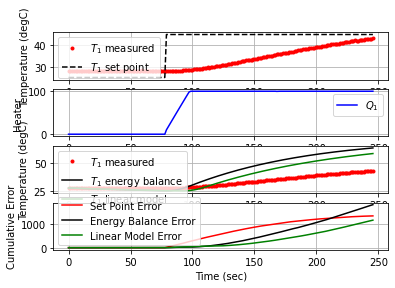

 248.1  45.00  43.53 100.00   0.32  99.64  -0.01


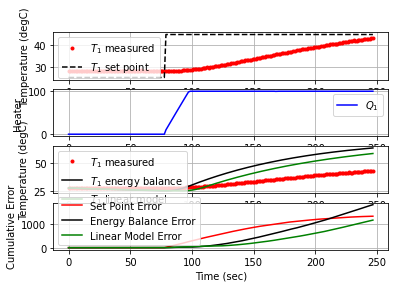

 249.3  45.00  43.51 100.00   0.33  99.64   0.00


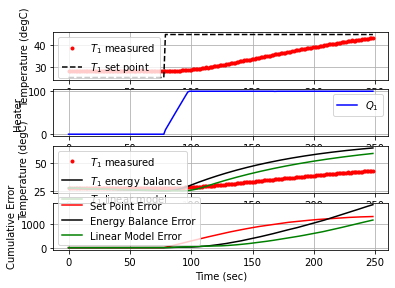

 250.5  45.00  43.66 100.00   0.29  99.64  -0.01


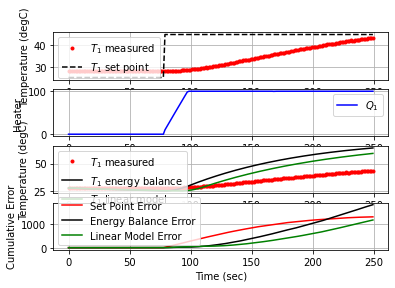

 251.7  45.00  43.69 100.00   0.29  99.64  -0.00


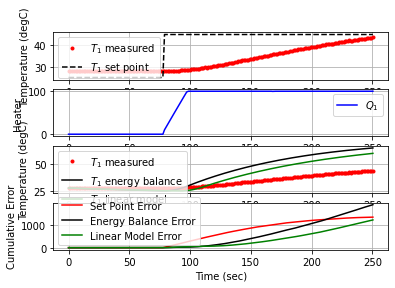

 253.1  45.00  44.03 100.00   0.21  99.64  -0.02


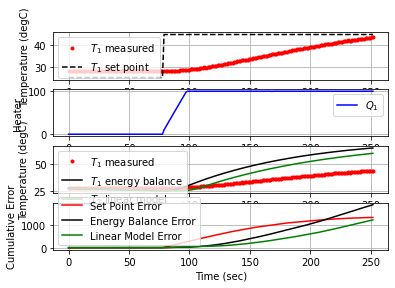

 254.3  45.00  43.91 100.00   0.24  99.64   0.01


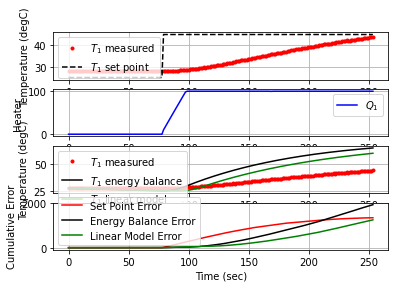

 255.5  45.00  44.03 100.00   0.21  99.64  -0.01


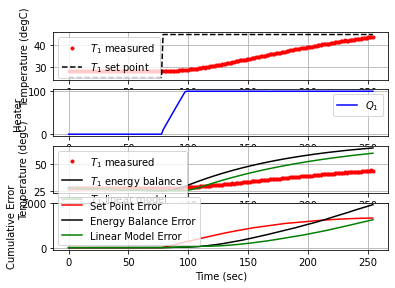

 256.7  45.00  44.37  99.96   0.13  99.85  -0.02


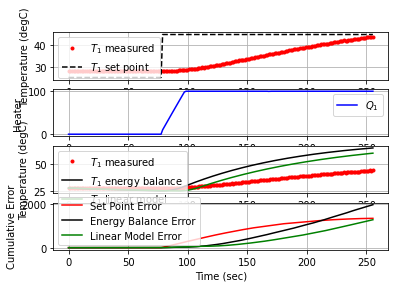

 258.0  45.00  44.35 100.00   0.14  99.85   0.00


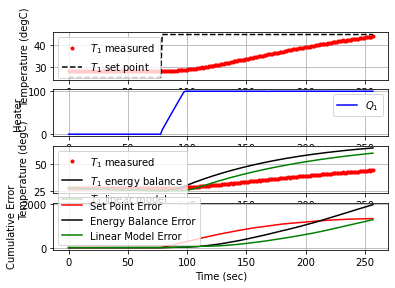

 259.2  45.00  44.48 100.00   0.11  99.85  -0.01


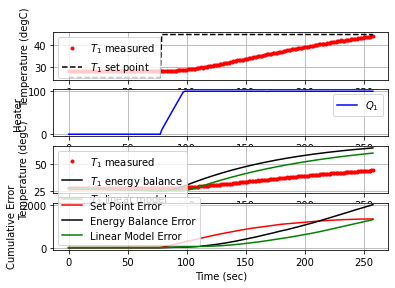

 260.4  45.00  44.56 100.00   0.09  99.85  -0.01


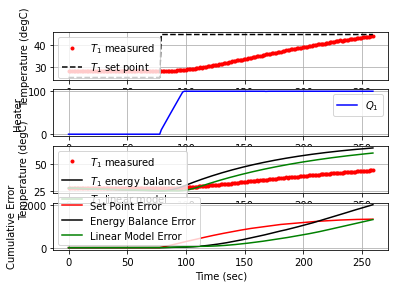

 261.6  45.00  44.72  99.99   0.06  99.94  -0.01


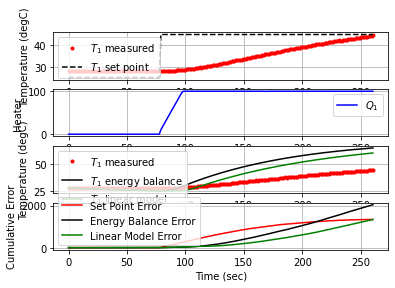

 262.9  45.00  44.75 100.00   0.05  99.94  -0.00


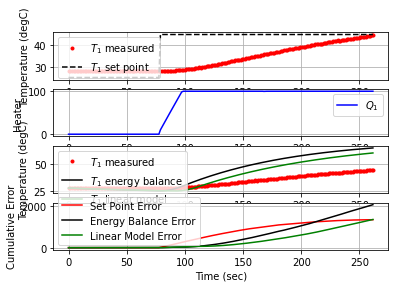

 264.1  45.00  44.84 100.00   0.03  99.94  -0.01


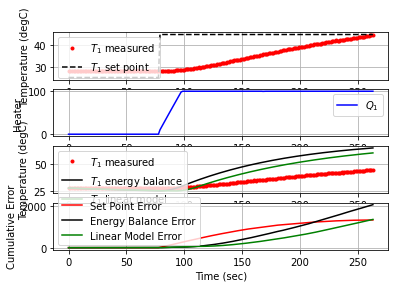

 265.3  45.00  45.05  99.90  -0.01  99.93  -0.01


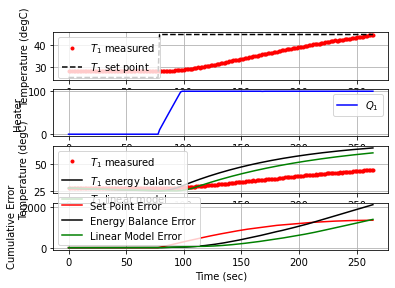

 266.6  45.00  45.10  99.87  -0.02  99.89  -0.00


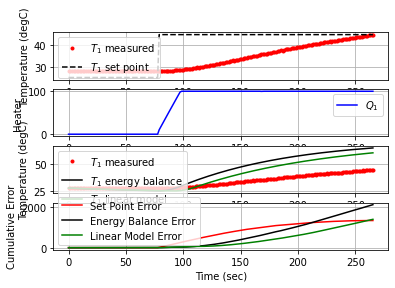

 267.8  45.00  45.12  99.83  -0.03  99.85  -0.00


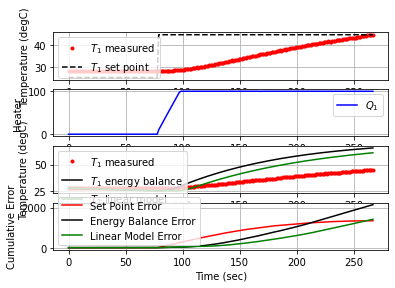

 269.0  45.00  45.27  99.70  -0.06  99.76  -0.01


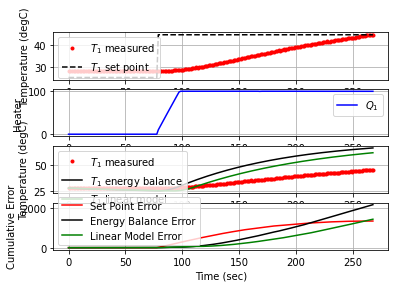

 270.2  45.00  45.40  99.55  -0.08  99.64  -0.01


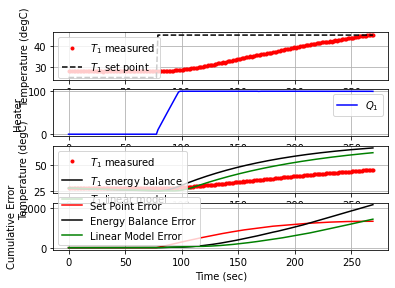

 271.4  45.00  45.60  99.30  -0.12  99.44  -0.01


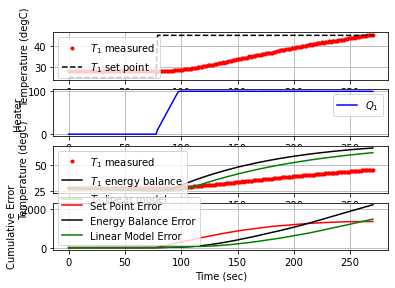

 272.8  45.00  45.59  99.09  -0.12  99.21   0.00


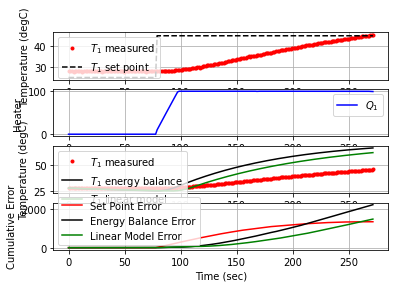

 274.1  45.00  45.56  98.90  -0.12  99.02   0.00


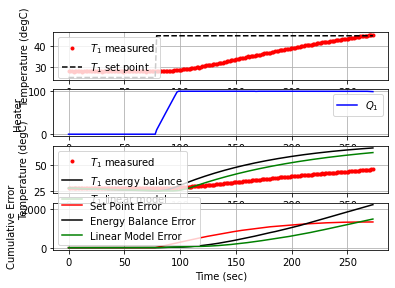

 275.3  45.00  45.68  98.65  -0.14  98.79  -0.01


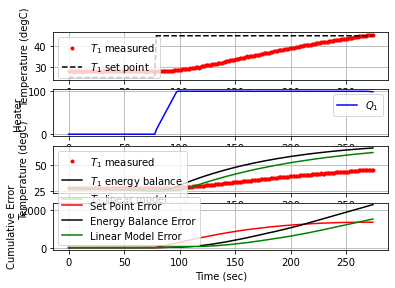

 276.5  45.00  45.77  98.38  -0.16  98.54  -0.01


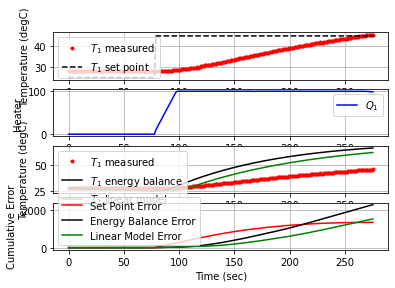

 277.6  45.00  45.76  98.15  -0.16  98.31   0.00


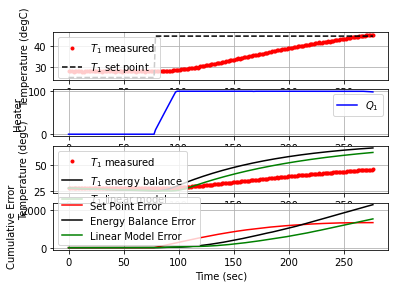

 278.8  45.00  45.89  97.84  -0.18  98.03  -0.01


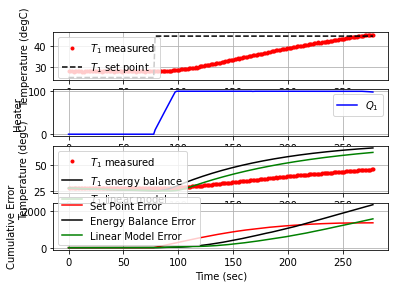

 280.1  45.00  46.00  97.46  -0.20  97.67  -0.01


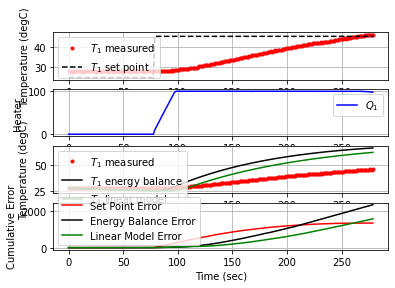

 281.4  45.00  46.19  97.01  -0.24  97.26  -0.01


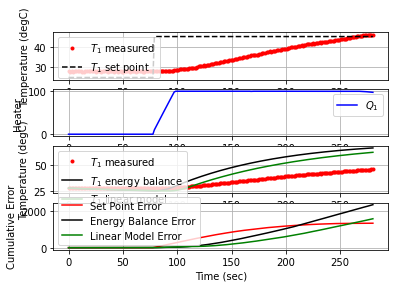

 282.6  45.00  46.33  96.53  -0.27  96.81  -0.01


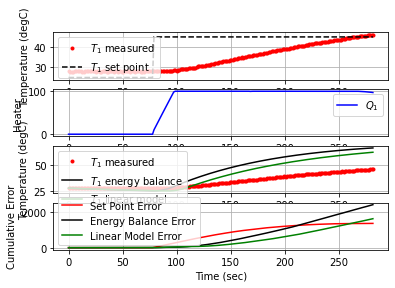

 283.8  45.00  46.49  96.04  -0.30  96.35  -0.01


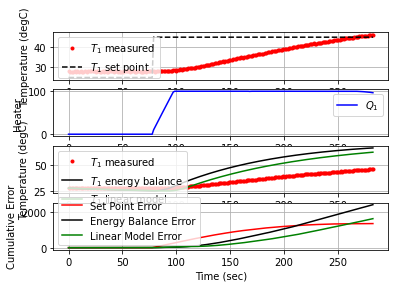

 285.0  45.00  46.44  95.60  -0.29  95.89   0.00


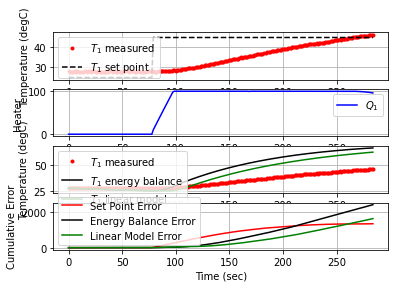

 286.3  45.00  46.64  94.95  -0.33  95.30  -0.01


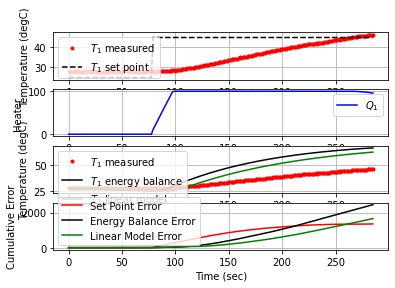

 287.4  45.00  46.73  94.40  -0.35  94.76  -0.01


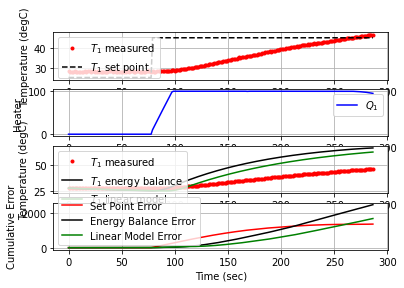

 288.6  45.00  46.94  93.74  -0.39  94.14  -0.01


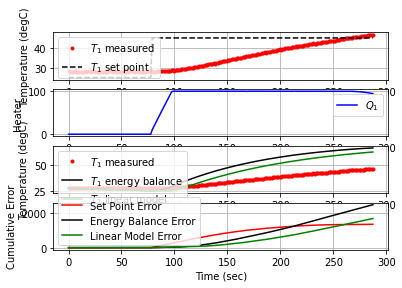

 289.8  45.00  46.93  93.14  -0.39  93.53   0.00


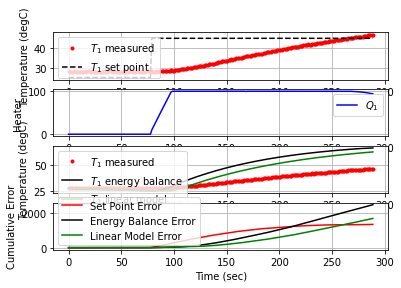

 291.0  45.00  46.95  92.49  -0.40  92.88  -0.00


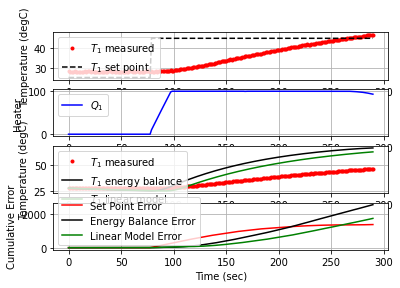

 292.3  45.00  47.19  91.68  -0.44  92.14  -0.01


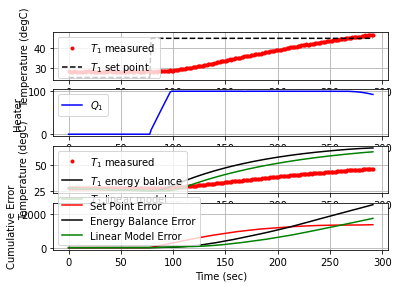

 293.7  45.00  46.97  91.00  -0.40  91.38   0.01


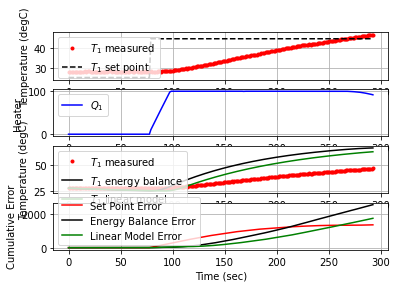

 294.8  45.00  47.13  90.27  -0.43  90.71  -0.01


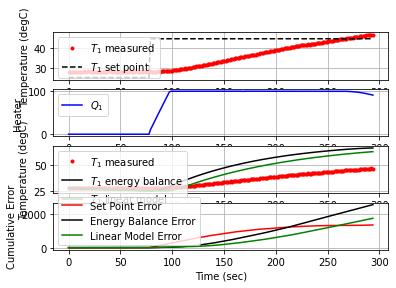

 296.0  45.00  47.20  89.56  -0.45  90.01  -0.00


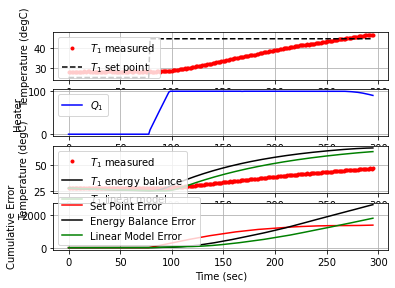

 297.2  45.00  47.21  88.83  -0.45  89.27  -0.00


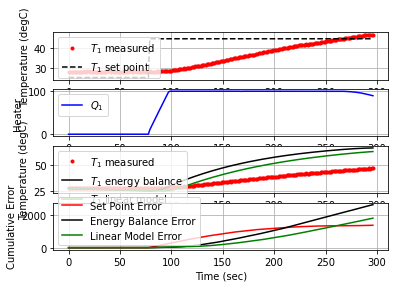

 298.4  45.00  47.33  88.06  -0.47  88.54  -0.01


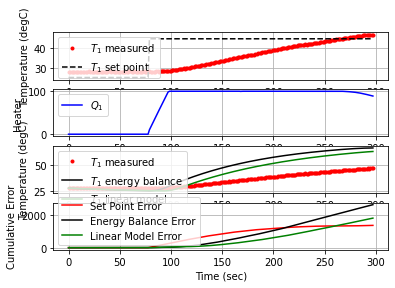

 299.8  45.00  47.40  87.17  -0.49  87.65  -0.00


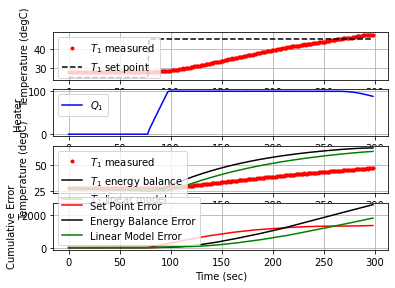

 301.0  45.00  47.60  86.27  -0.53  86.81  -0.01


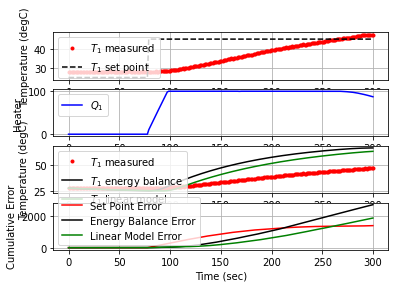

 302.5  45.00  47.79  85.07  -0.56  85.64  -0.01


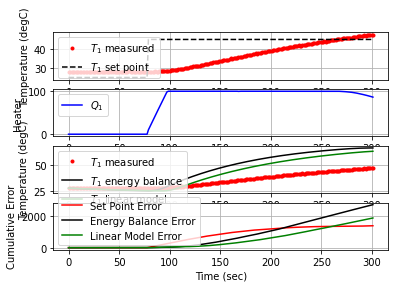

 303.9  45.00  47.79  84.06  -0.56  84.63  -0.00


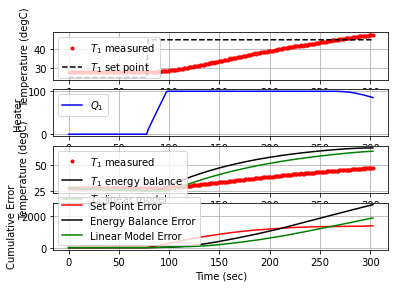

 305.0  45.00  47.69  83.24  -0.54  83.78   0.01


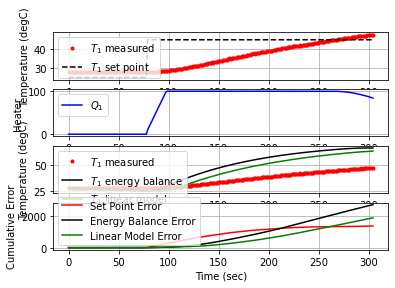

 306.3  45.00  47.77  82.24  -0.56  82.81  -0.00


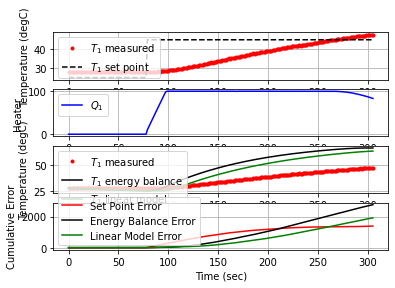

 307.7  45.00  47.73  81.28  -0.55  81.83   0.00


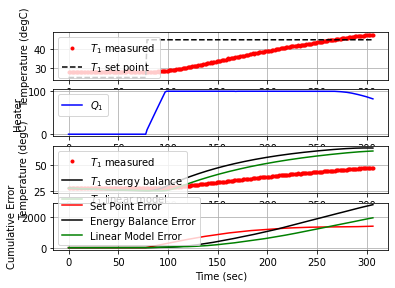

 308.9  45.00  47.72  80.37  -0.55  80.92   0.00


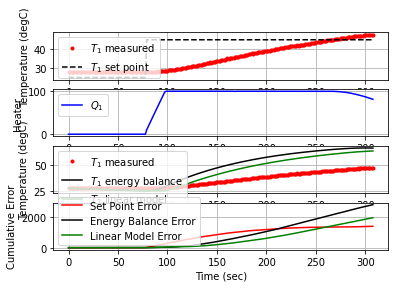

 310.2  45.00  47.82  79.36  -0.57  79.93  -0.01


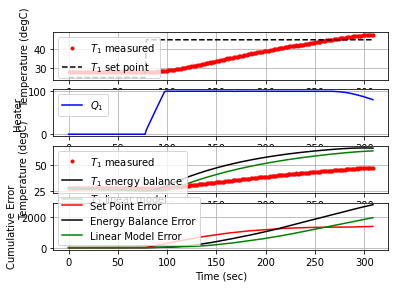

 311.4  45.00  48.04  78.28  -0.61  78.91  -0.01


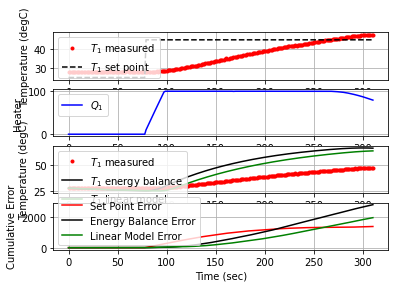

 312.8  45.00  48.13  77.08  -0.63  77.72  -0.00


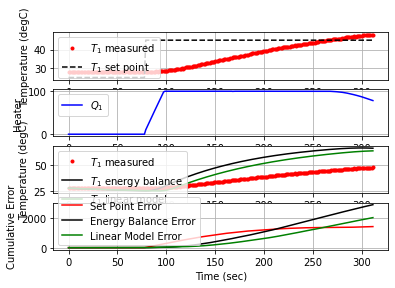

 314.7  45.00  48.29  75.41  -0.66  76.08  -0.01


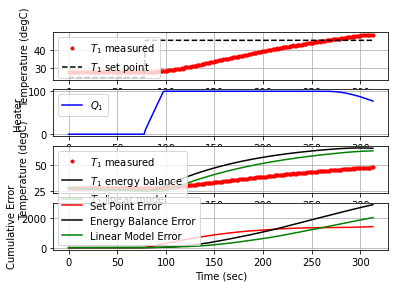

 316.2  45.00  48.32  74.02  -0.67  74.69  -0.00


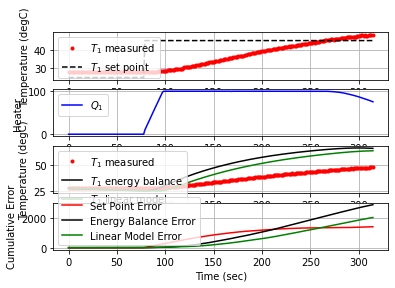

 317.7  45.00  48.19  72.76  -0.64  73.40   0.01


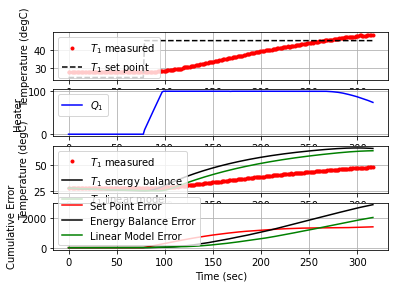

 319.1  45.00  48.43  71.45  -0.69  72.15  -0.01


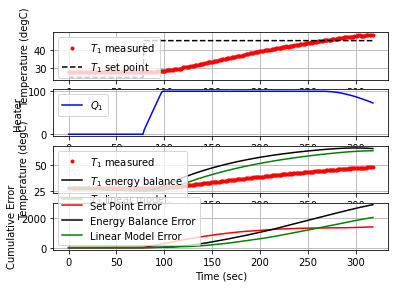

 320.5  45.00  48.41  70.15  -0.69  70.84   0.00


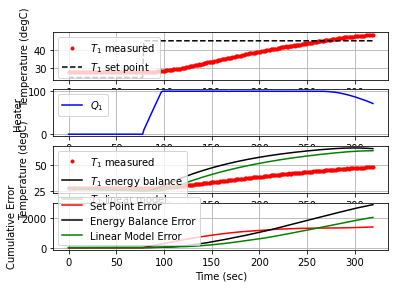

 321.9  45.00  48.63  68.72  -0.73  69.46  -0.01


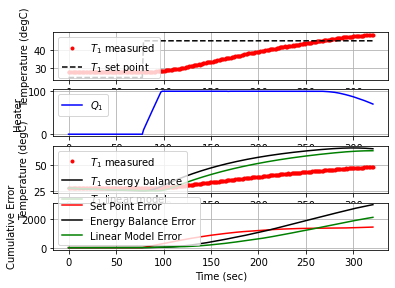

 323.3  45.00  48.74  67.25  -0.76  68.01  -0.01


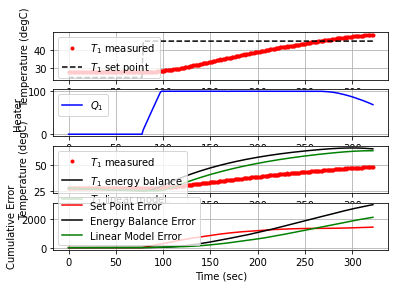

 324.6  45.00  48.80  65.96  -0.77  66.73  -0.00


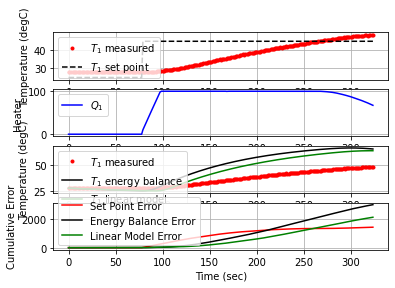

 325.8  45.00  48.76  64.72  -0.76  65.48   0.00


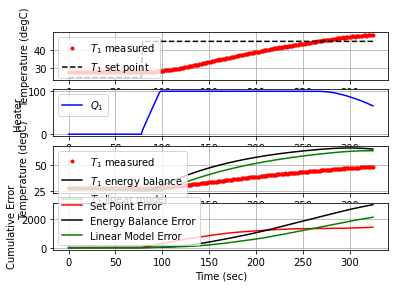

 327.0  45.00  48.95  63.35  -0.80  64.16  -0.01


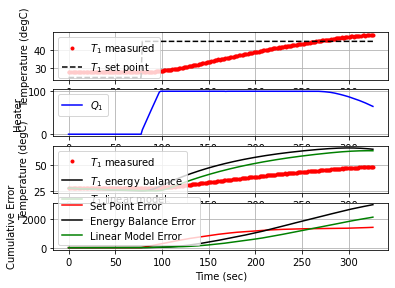

 328.3  45.00  49.02  61.99  -0.81  62.80  -0.00


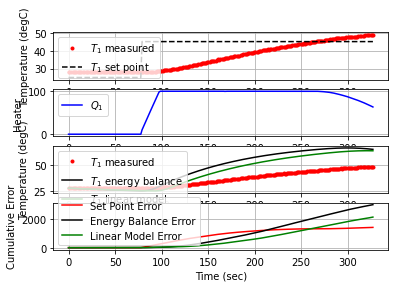

 329.6  45.00  49.26  60.42  -0.86  61.29  -0.01


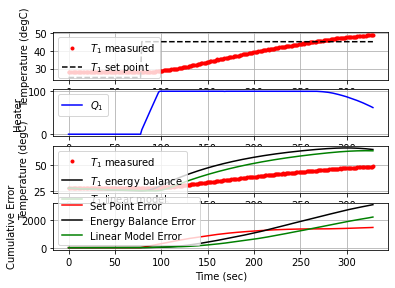

 330.8  45.00  49.26  59.01  -0.86  59.87  -0.00


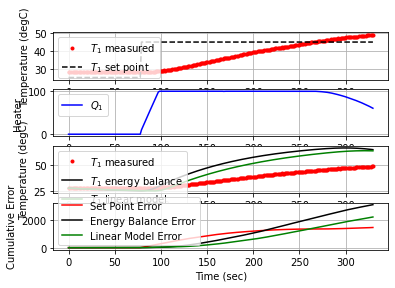

 332.0  45.00  49.21  57.62  -0.85  58.47   0.00


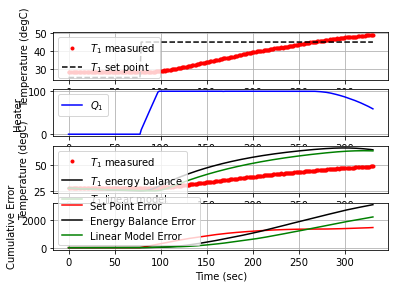

 333.2  45.00  49.16  56.29  -0.84  57.13   0.00


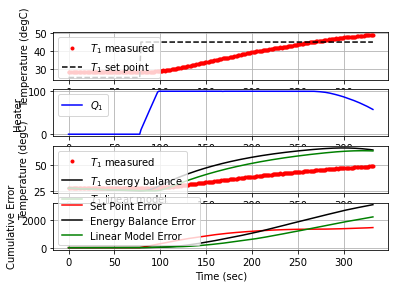

 334.5  45.00  49.28  54.83  -0.86  55.71  -0.01


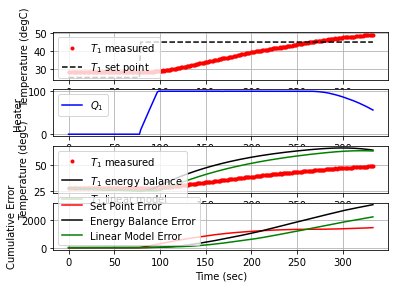

 335.8  45.00  49.30  53.31  -0.87  54.18  -0.00


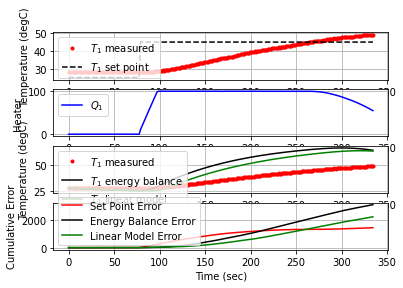

 337.0  45.00  49.26  51.94  -0.86  52.80   0.00


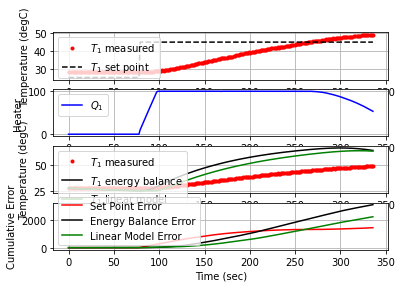

 338.2  45.00  49.62  50.27  -0.93  51.22  -0.02


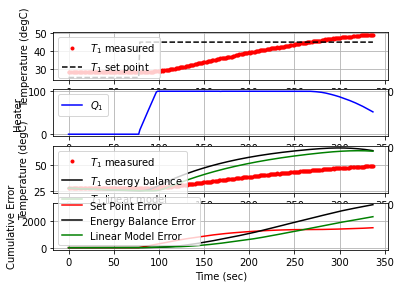

 339.5  45.00  49.65  48.71  -0.94  49.65  -0.00


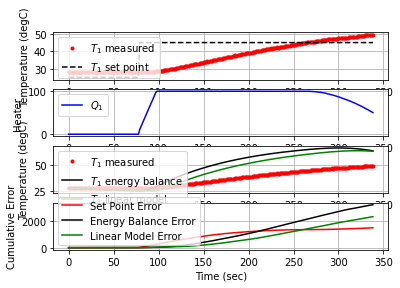

 340.7  45.00  49.73  47.16  -0.95  48.11  -0.00


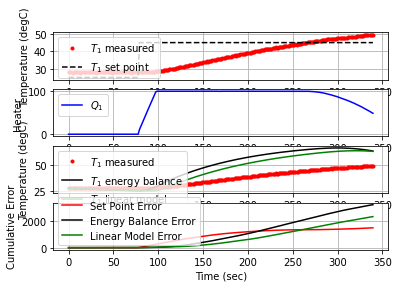

 342.0  45.00  49.64  45.50  -0.94  46.43   0.00


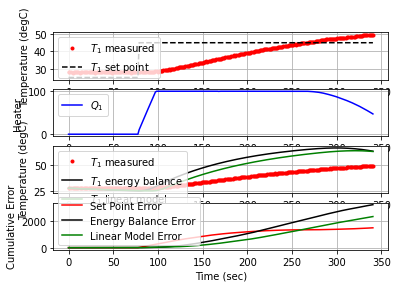

 343.2  45.00  49.79  43.88  -0.97  44.85  -0.01


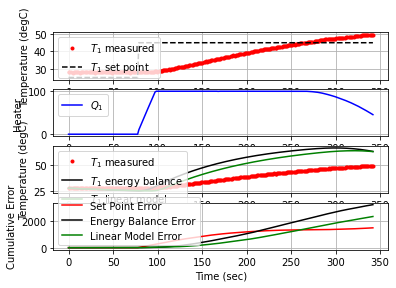

 344.5  45.00  50.04  42.10  -1.02  43.13  -0.01


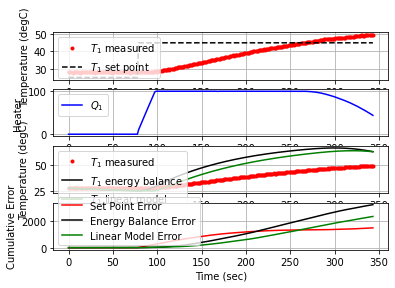

 345.7  45.00  49.98  40.51  -1.01  41.52   0.00


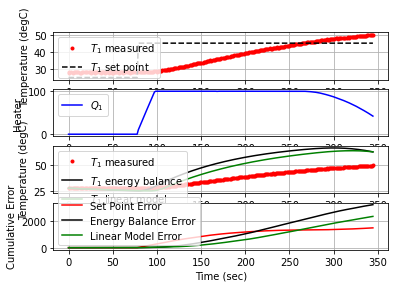

 347.0  45.00  49.93  38.86  -1.00  39.85   0.00


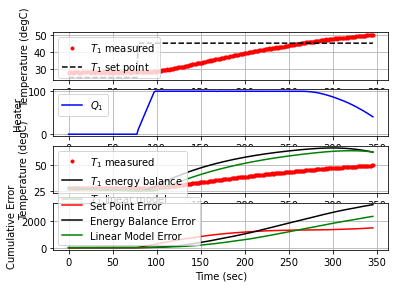

 348.4  45.00  50.23  36.80  -1.06  37.87  -0.01


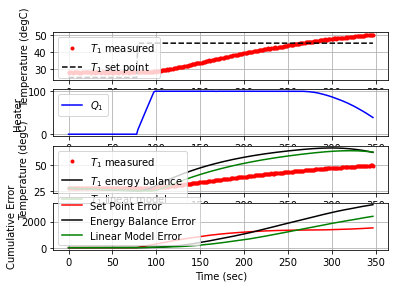

 349.6  45.00  49.95  35.17  -1.00  36.16   0.02


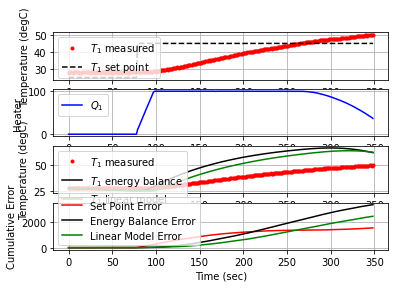

 350.9  45.00  50.25  33.29  -1.06  34.37  -0.02


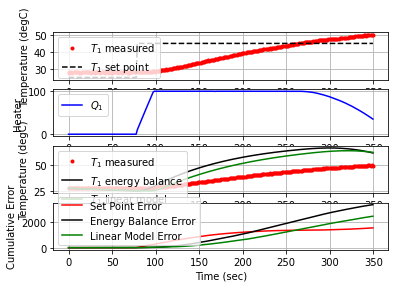

 352.2  45.00  50.14  31.58  -1.04  32.61   0.01


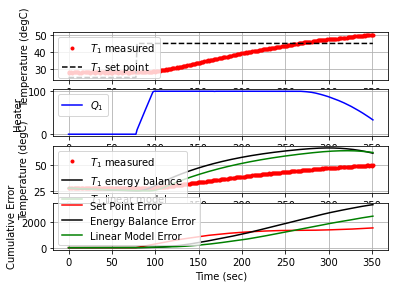

 353.5  45.00  50.11  29.75  -1.03  30.78   0.00


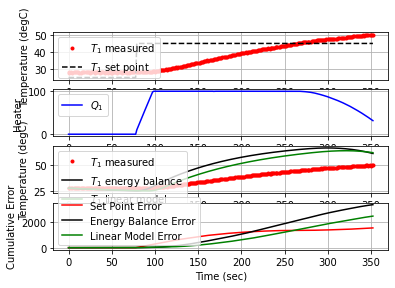

 354.9  45.00  50.18  27.76  -1.05  28.81  -0.00


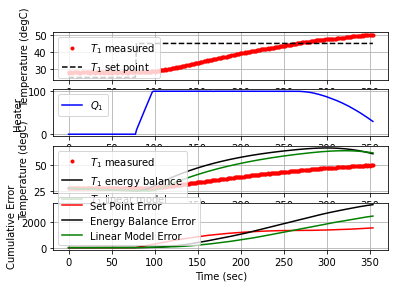

 356.1  45.00  50.38  25.97  -1.09  27.07  -0.01


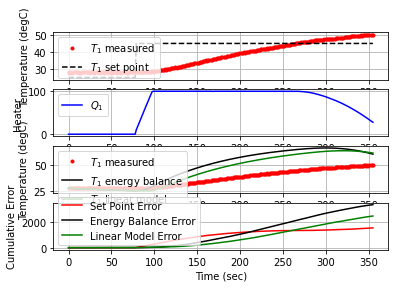

 357.3  45.00  50.53  24.05  -1.12  25.18  -0.01


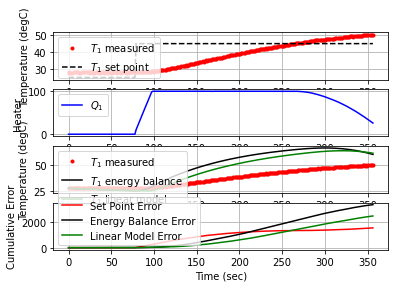

 358.5  45.00  50.64  22.22  -1.14  23.37  -0.01


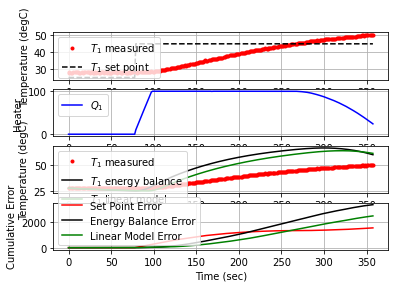

 359.8  45.00  50.63  20.31  -1.14  21.44   0.00


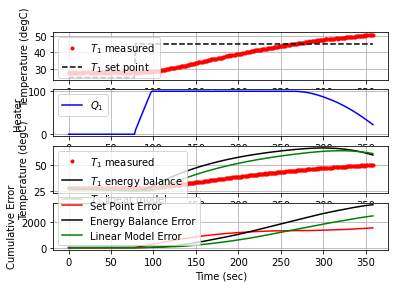

 361.2  45.00  50.50  18.19  -1.11  19.29   0.01


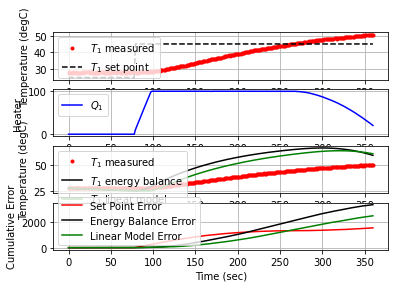

 362.5  45.00  50.75  16.10  -1.16  17.28  -0.01


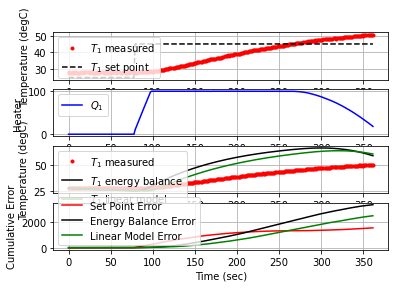

 363.8  45.00  50.54  14.28  -1.12  15.39   0.01


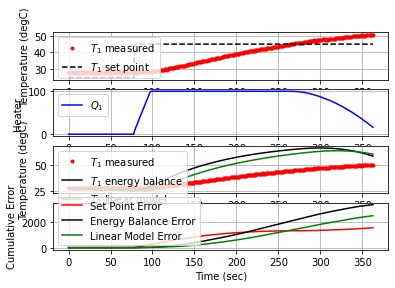

 365.0  45.00  50.73  12.38  -1.16  13.55  -0.01


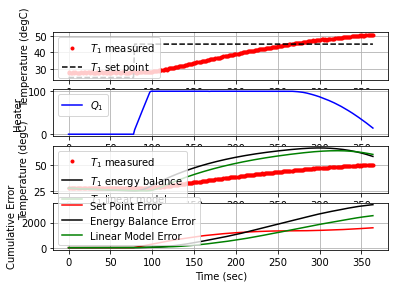

 366.3  45.00  50.72  10.29  -1.15  11.44   0.00


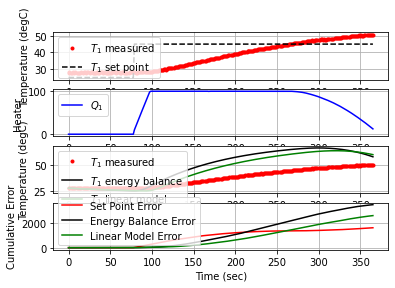

 368.0  45.00  50.76   7.73  -1.16   8.89  -0.00


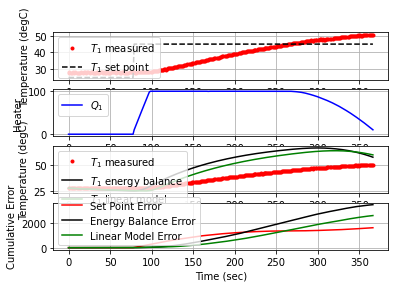

 369.4  45.00  50.71   5.60  -1.15   6.75   0.00


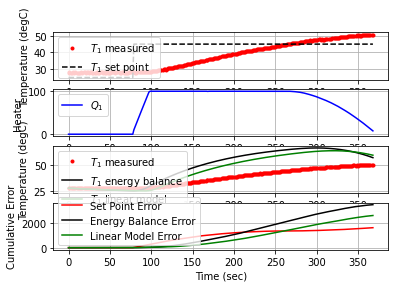

 370.6  45.00  50.70   3.75  -1.15   4.90   0.00


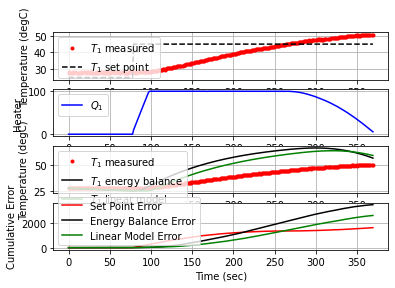

 371.8  45.00  50.83   1.72  -1.18   2.90  -0.01


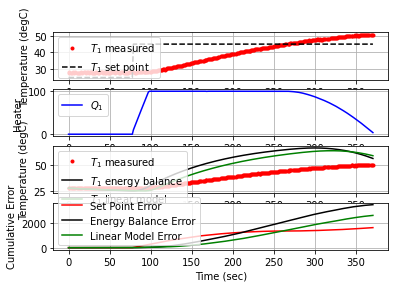

 373.2  45.00  50.85   0.00  -1.18   2.90  -0.00


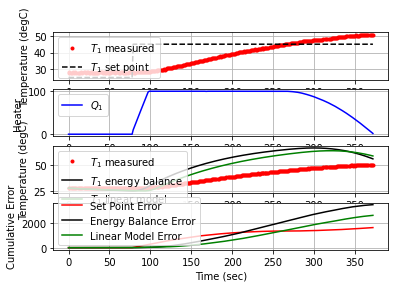

 374.6  45.00  50.81   0.00  -1.17   2.90   0.00


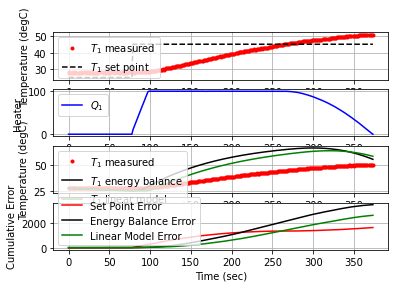

 375.8  45.00  50.75   0.00  -1.16   2.90   0.00


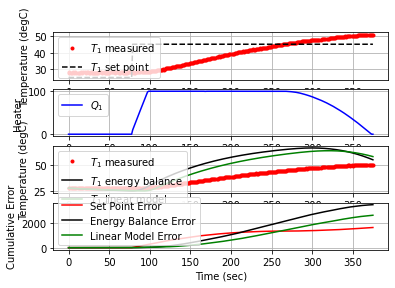

 377.1  45.00  50.84   0.00  -1.18   2.90  -0.01


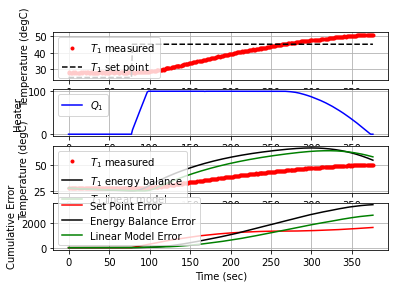

 378.3  45.00  50.90   0.00  -1.19   2.90  -0.00


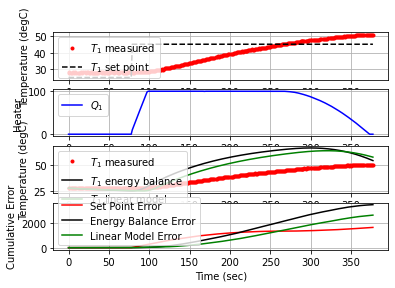

 379.7  45.00  50.78   0.00  -1.17   2.90   0.01


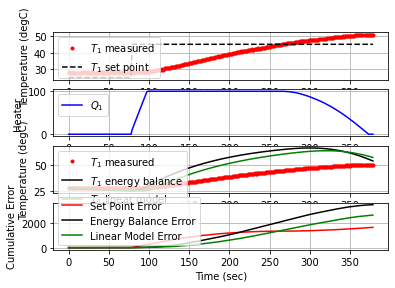

 381.1  45.00  50.82   0.00  -1.17   2.90  -0.00


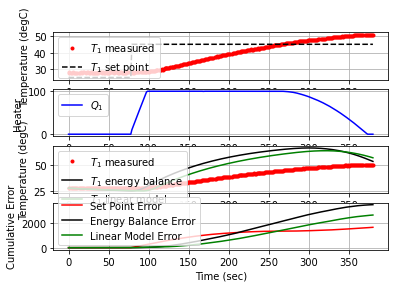

 382.4  45.00  50.85   0.00  -1.18   2.90  -0.00


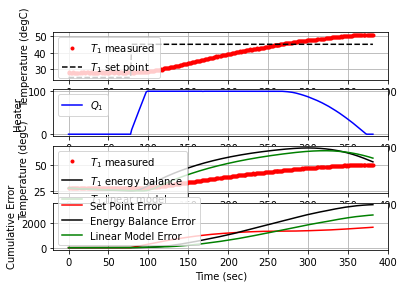

 383.8  45.00  50.65   0.00  -1.14   2.90   0.01


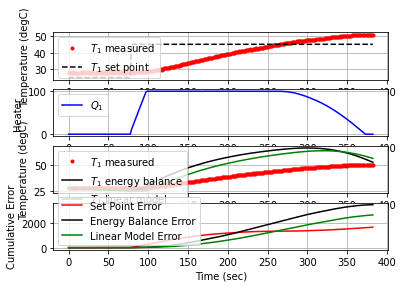

 385.1  45.00  50.80   0.00  -1.17   2.90  -0.01


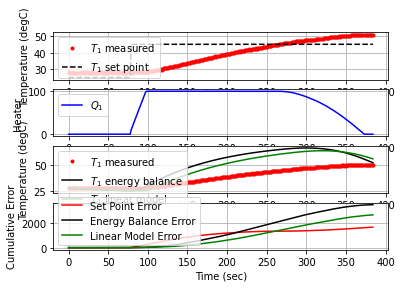

 386.5  45.00  50.65   0.00  -1.14   2.90   0.01


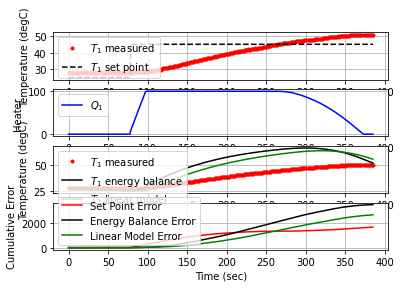

 387.7  45.00  50.71   0.00  -1.15   2.90  -0.00


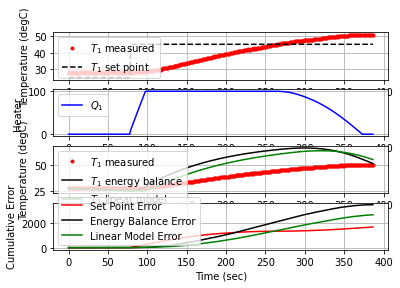

 389.0  45.00  50.68   0.00  -1.15   2.90   0.00


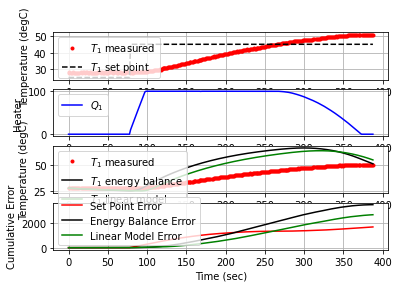

 390.3  45.00  50.40   0.00  -1.09   2.90   0.01


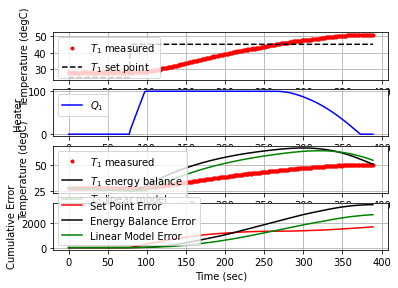

 391.6  45.00  50.37   0.03  -1.08   1.11   0.00


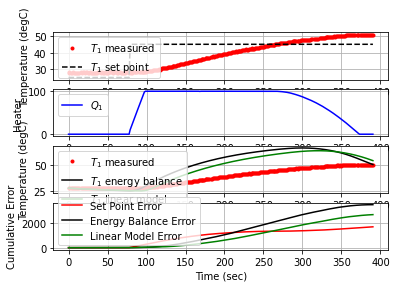

 393.1  45.00  50.29   0.00  -1.07   1.11   0.00


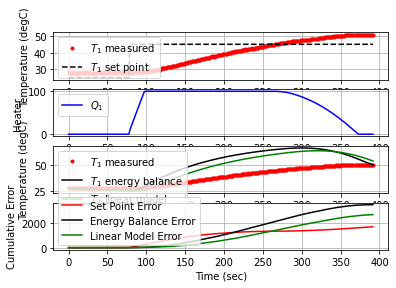

 394.3  45.00  50.18   0.00  -1.05   1.11   0.01


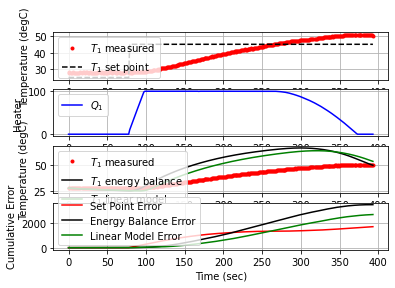

 395.9  45.00  50.11   0.00  -1.03   1.11   0.00


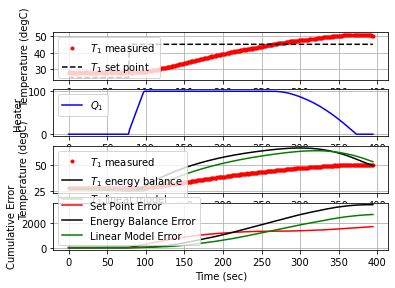

 397.3  45.00  49.94   0.00  -1.00   1.11   0.01


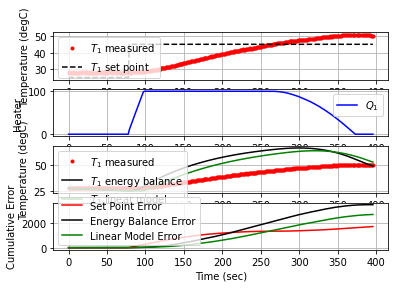

 398.6  45.00  49.99   0.00  -1.01   1.11  -0.00


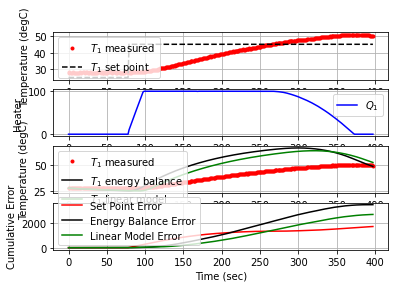

 400.2  45.00  49.81   0.00  -0.97   1.11   0.01


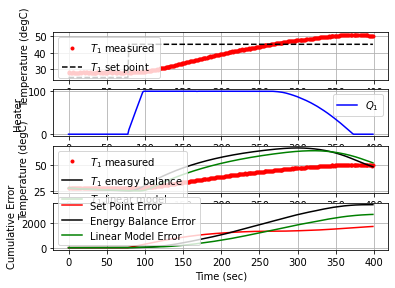

 401.7  45.00  49.53   0.00  -0.91   1.11   0.01


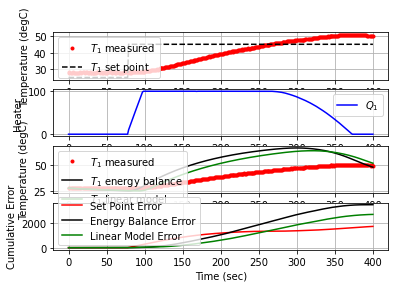

 403.1  45.00  49.22   0.00  -0.85   1.11   0.01


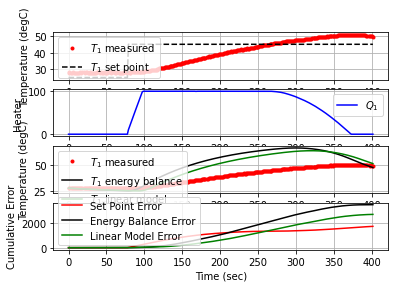

 404.3  45.00  49.30   0.00  -0.87   1.11  -0.00


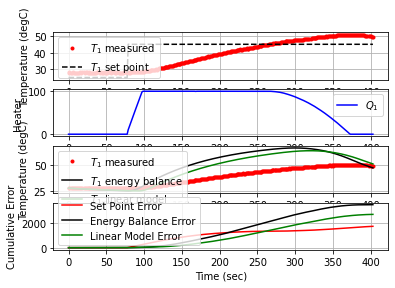

 405.8  45.00  49.24   0.00  -0.86   1.11   0.00


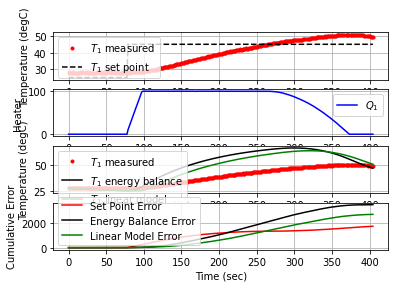

 407.1  45.00  49.23   0.00  -0.85   1.11   0.00


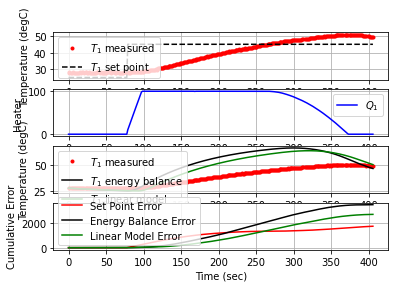

 408.4  45.00  49.20   0.00  -0.85   1.11   0.00


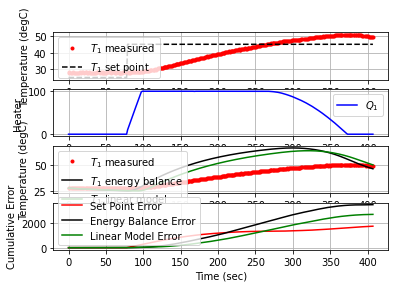

 409.7  45.00  48.97   0.00  -0.80   1.11   0.01


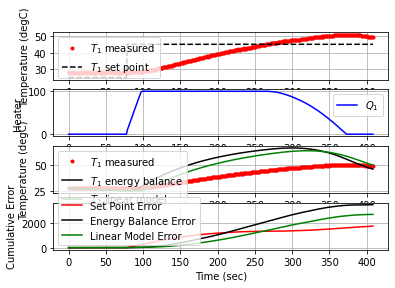

 410.9  45.00  48.94   0.00  -0.80   1.11   0.00


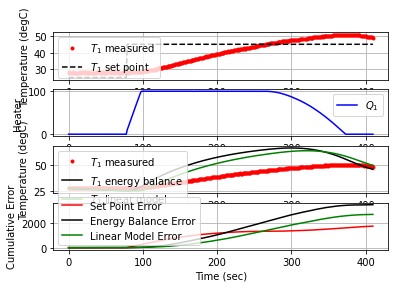

 412.3  45.00  48.82   0.00  -0.77   1.11   0.01


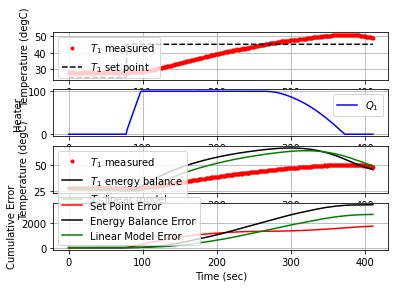

 413.5  45.00  48.76   0.00  -0.76   1.11   0.00


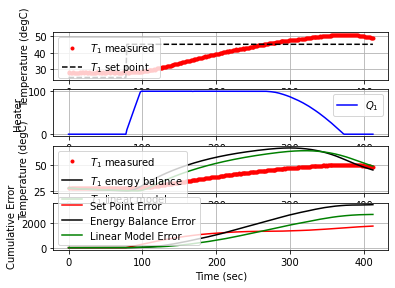

 414.6  45.00  48.62   0.00  -0.73   1.11   0.01


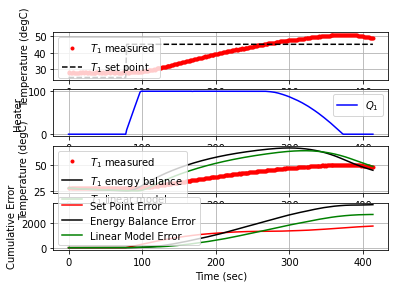

 415.7  45.00  48.52   0.00  -0.71   1.11   0.01


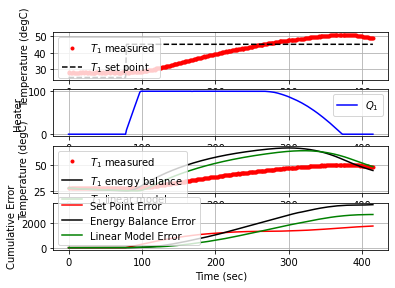

 416.9  45.00  48.36   0.00  -0.68   1.11   0.01


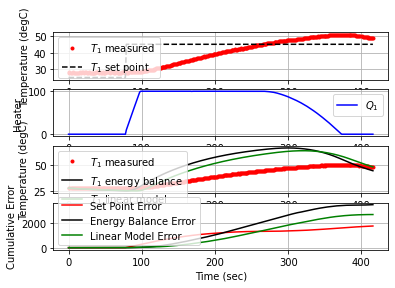

 418.2  45.00  48.06   0.00  -0.62   1.11   0.02


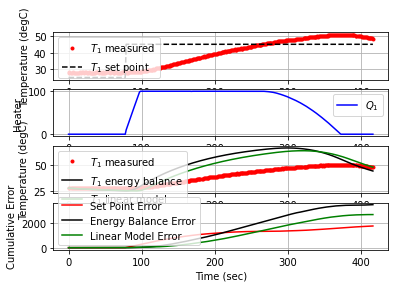

 419.3  45.00  48.20   0.00  -0.65   1.11  -0.01


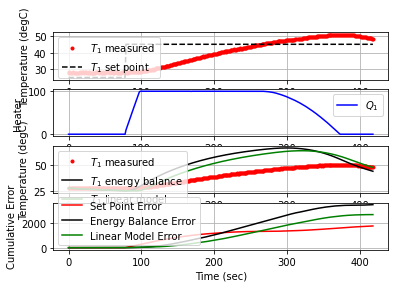

 420.5  45.00  48.09   0.00  -0.62   1.11   0.01


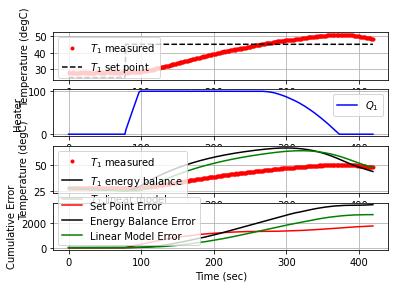

 422.5  45.00  47.96   0.00  -0.60   1.11   0.00


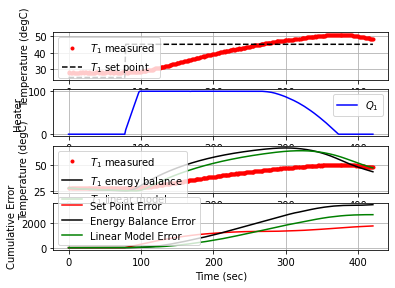

 424.4  45.00  47.80   0.00  -0.57   1.11   0.01


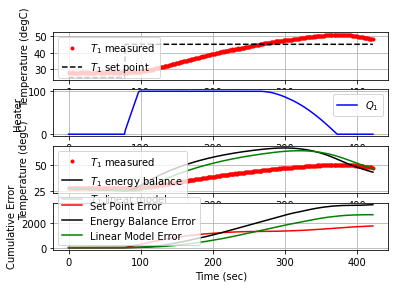

 426.1  45.00  47.65   0.00  -0.54   1.11   0.01


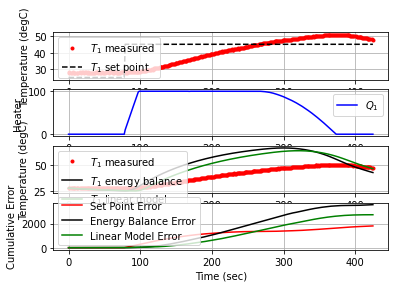

 427.7  45.00  47.46   0.00  -0.50   1.11   0.01


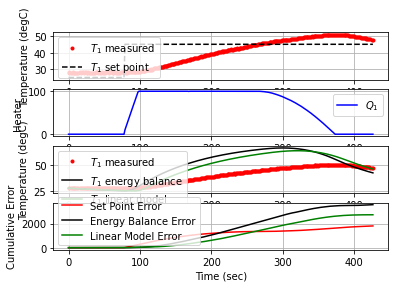

 429.1  45.00  47.29   0.00  -0.46   1.11   0.01


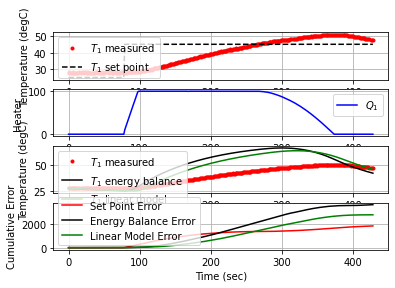

 430.4  45.00  47.24   0.00  -0.45   1.11   0.00


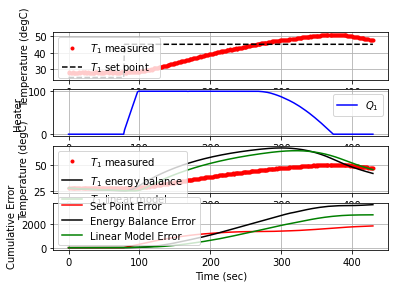

Connected to MQTT Broker!
 431.7  45.00  47.04   0.00  -0.41   1.11   0.01


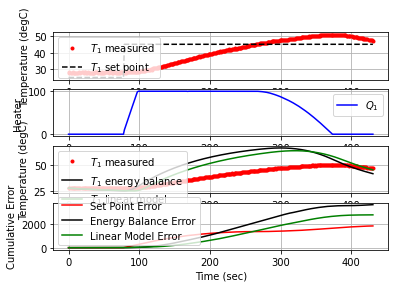

 433.2  45.00  47.02   0.00  -0.41   1.11   0.00


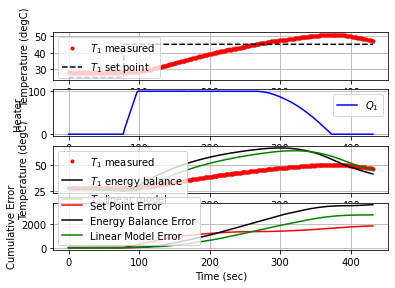

 434.7  45.00  46.93   0.00  -0.39   1.11   0.00


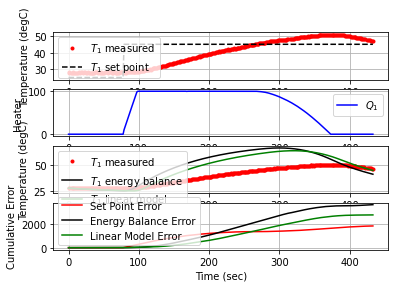

 436.2  45.00  46.64   0.11  -0.33   0.43   0.01


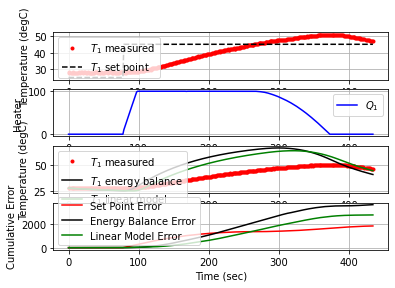

 437.6  45.00  46.63   0.00  -0.33   0.43   0.00


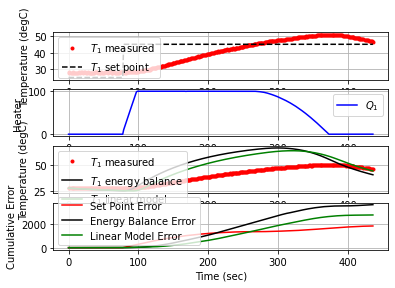

 439.0  45.00  46.62   0.00  -0.33   0.43   0.00


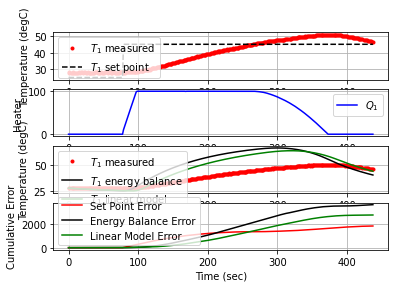

 440.4  45.00  46.43   0.00  -0.29   0.43   0.01


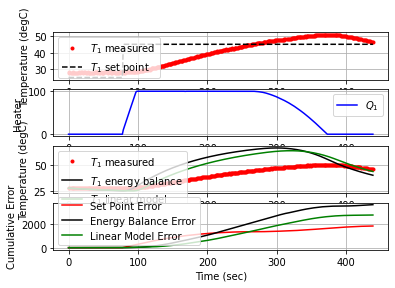

 441.9  45.00  46.21   0.00  -0.25   0.43   0.01


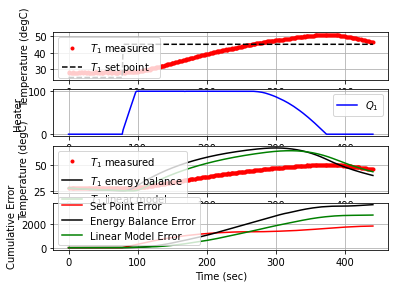

 443.6  45.00  46.08   0.00  -0.22   0.43   0.01


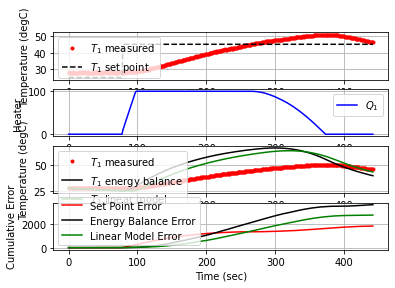

 444.9  45.00  45.72   0.03  -0.15   0.16   0.02


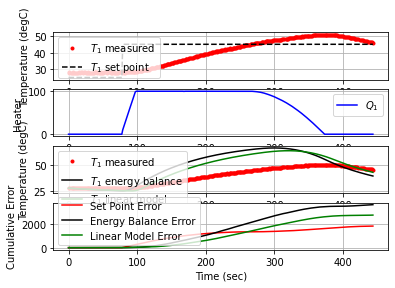

 446.3  45.00  45.60   0.00  -0.12   0.16   0.01


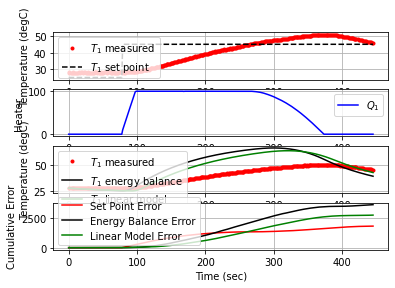

 447.7  45.00  45.59   0.00  -0.12   0.16   0.00


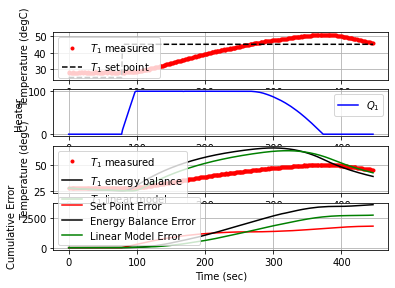

 449.1  45.00  45.32   0.00  -0.07   0.16   0.01


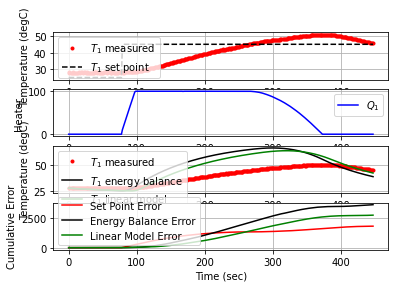

 450.7  45.00  45.15   0.08  -0.03   0.10   0.01


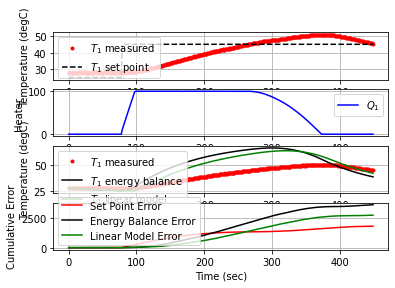

 452.1  45.00  45.07   0.06  -0.01   0.07   0.00


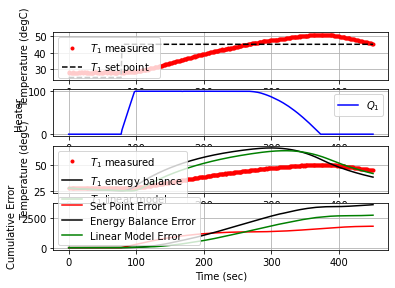

 453.6  45.00  44.94   0.12   0.01   0.10   0.01


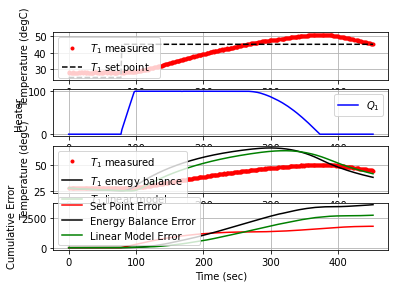

 455.1  45.00  44.74   0.28   0.06   0.21   0.01


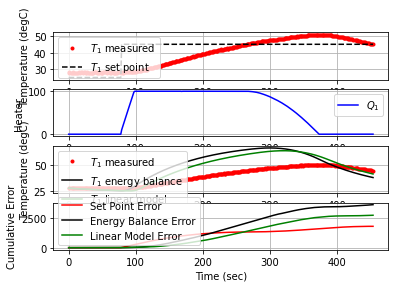

 456.6  45.00  44.72   0.38   0.06   0.32   0.00


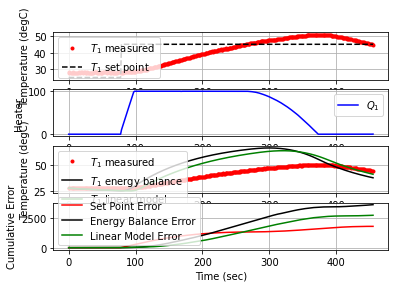

 458.1  45.00  44.63   0.56   0.08   0.48   0.00


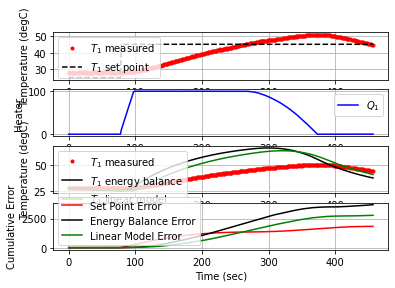

 459.7  45.00  44.51   0.81   0.10   0.70   0.01


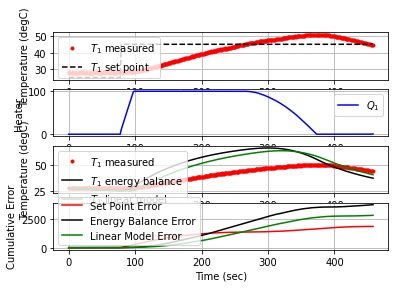

 461.1  45.00  44.43   1.05   0.12   0.93   0.00


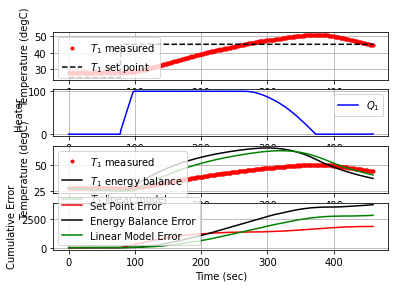

 462.4  45.00  44.24   1.37   0.16   1.19   0.01


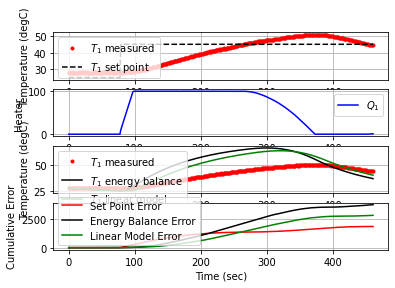

 463.6  45.00  44.25   1.61   0.16   1.45  -0.00


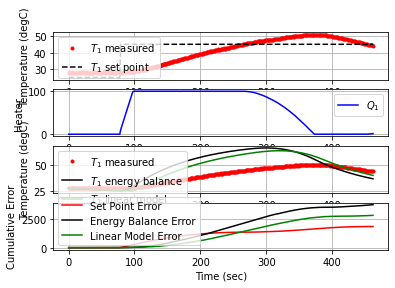

 464.8  45.00  44.02   2.01   0.21   1.78   0.02


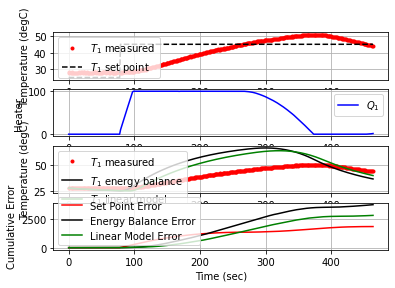

 466.0  30.00  43.97   0.00  -2.82   1.78   0.00


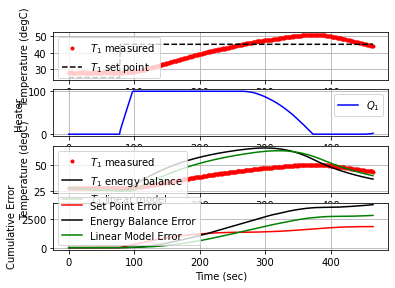

 467.1  30.00  43.68   0.00  -2.76   1.78   0.02


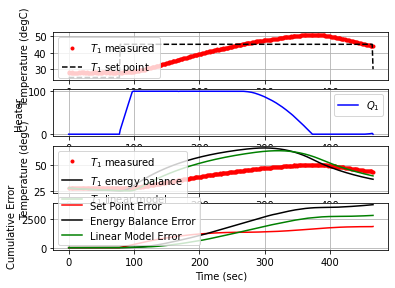

 468.2  30.00  43.64   0.00  -2.75   1.78   0.00


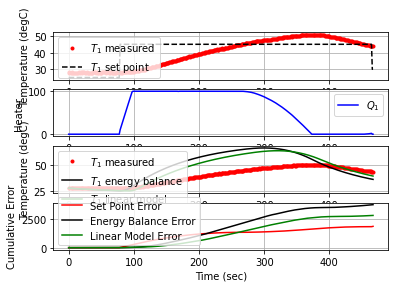

 469.4  30.00  43.35   0.00  -2.69   1.78   0.02


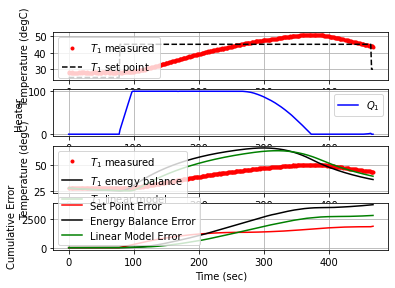

 470.6  30.00  43.51   0.00  -2.73   1.78  -0.01


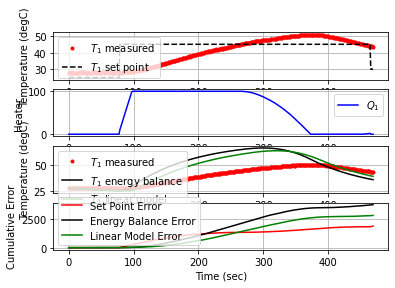

 471.8  30.00  43.51   0.00  -2.73   1.78  -0.00


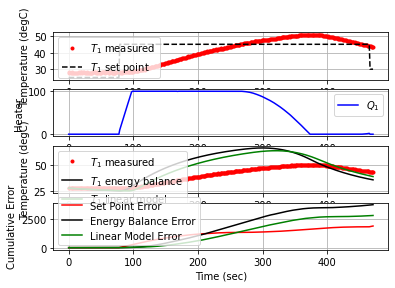

 473.2  30.00  43.35   0.00  -2.69   1.78   0.01


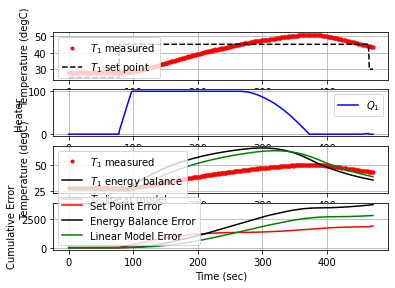

 474.4  30.00  43.20   0.00  -2.66   1.78   0.01


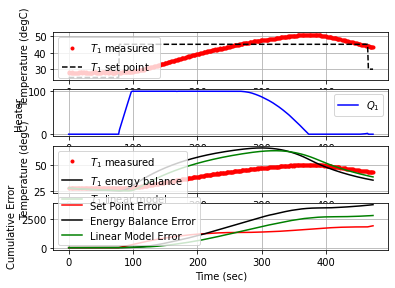

 475.6  30.00  43.07   0.00  -2.64   1.78   0.01


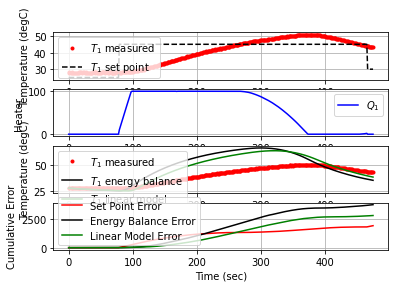

 476.7  30.00  42.92   0.00  -2.61   1.78   0.01


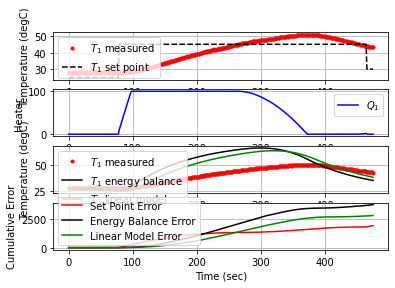

 477.8  30.00  42.96   0.00  -2.62   1.78  -0.00


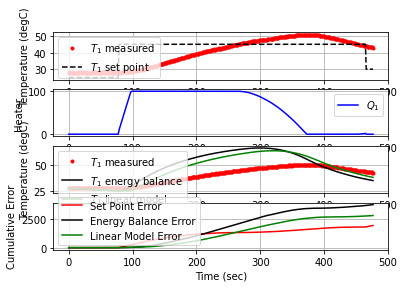

 479.1  30.00  42.93   0.00  -2.61   1.78   0.00


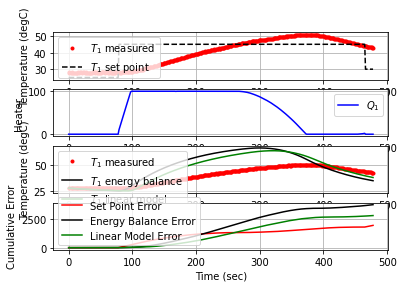

 480.3  30.00  42.73   0.00  -2.57   1.78   0.01


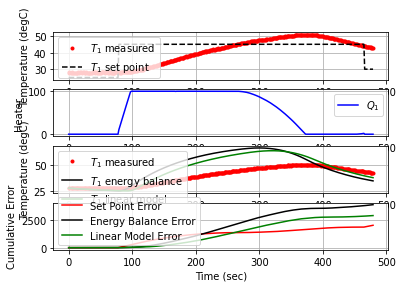

 481.4  30.00  42.52   0.00  -2.53   1.78   0.01


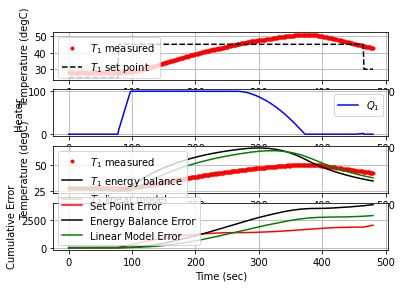

 482.7  30.00  42.45   0.00  -2.51   1.78   0.00


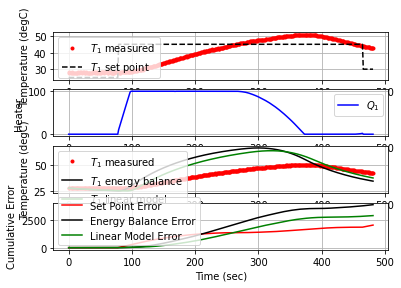

 483.9  30.00  42.34   0.00  -2.49   1.78   0.01


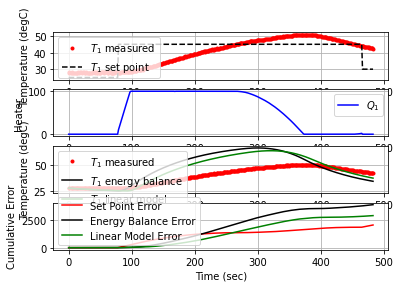

 485.1  30.00  42.20   0.00  -2.46   1.78   0.01


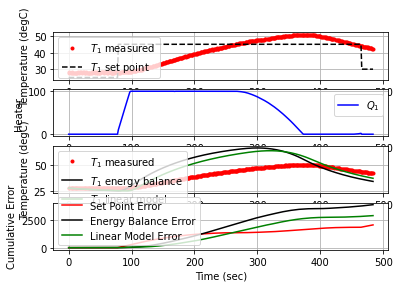

 486.5  30.00  42.44   0.00  -2.51   1.78  -0.01
Connected to MQTT Broker!


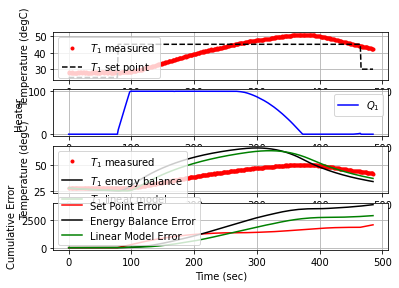

 487.8  30.00  42.21   0.00  -2.46   1.78   0.01


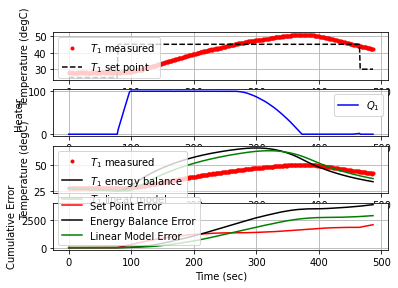

 489.0  30.00  42.19   0.00  -2.46   1.78   0.00


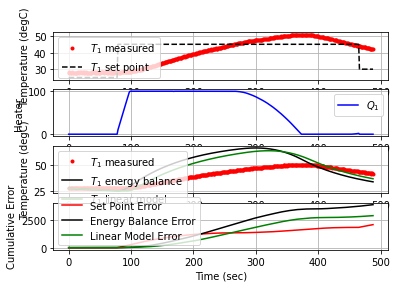

 490.6  30.00  42.18   0.00  -2.46   1.78   0.00


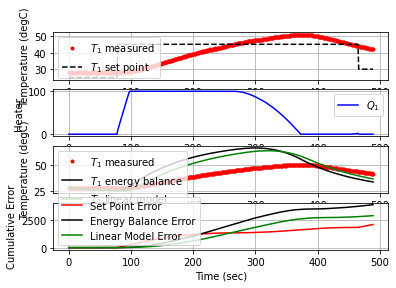

 491.9  30.00  41.91   0.00  -2.40   1.78   0.01


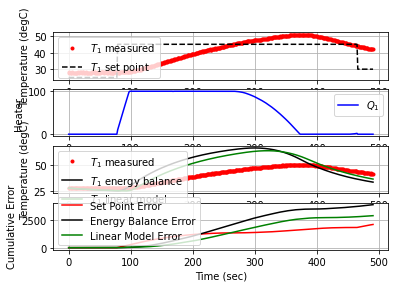

 493.3  30.00  42.03   0.00  -2.43   1.78  -0.01


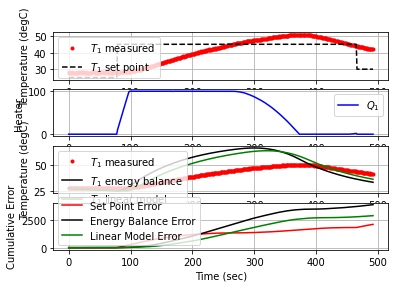

 494.6  30.00  41.83   0.00  -2.39   1.78   0.01


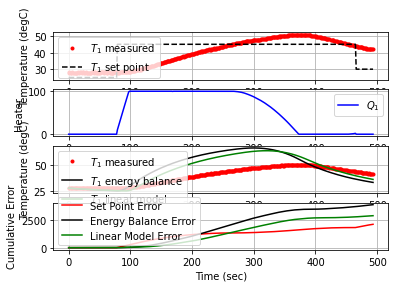

 495.8  30.00  41.54   0.00  -2.33   1.78   0.02


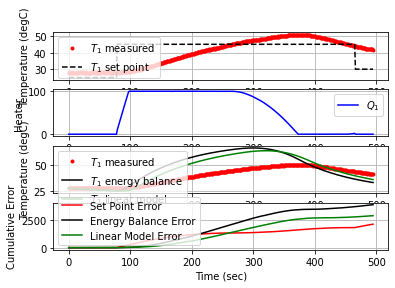

 497.0  30.00  41.53   0.00  -2.33   1.78   0.00


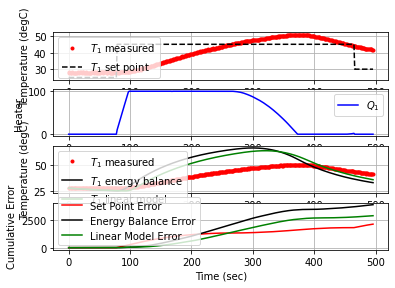

 498.3  30.00  41.50   0.00  -2.32   1.78   0.00


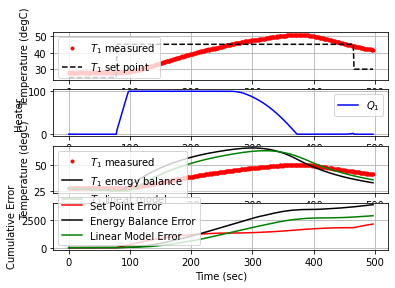

 499.4  30.00  41.49   0.00  -2.32   1.78   0.00


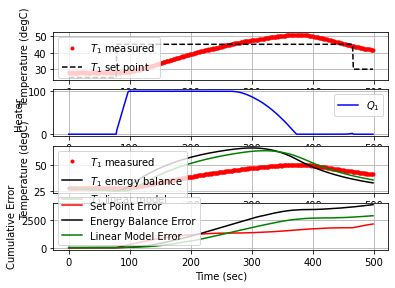

 501.2  30.00  41.29   0.00  -2.28   1.78   0.01


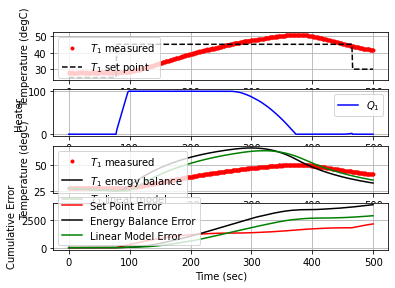

 502.4  30.00  41.37   0.00  -2.29   1.78  -0.00


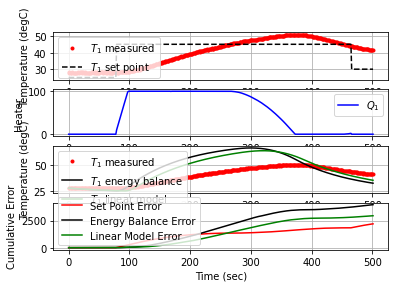

 503.7  30.00  41.23   0.00  -2.27   1.78   0.01


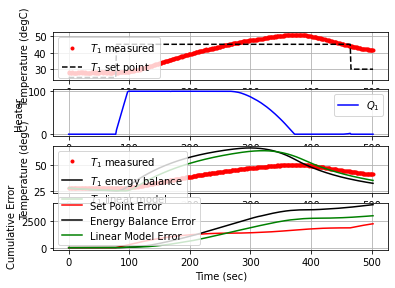

 504.9  30.00  41.18   0.00  -2.26   1.78   0.00


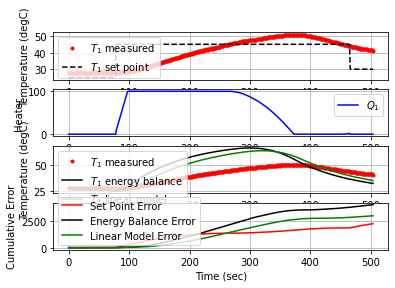

 506.1  30.00  40.94   0.00  -2.21   1.78   0.01


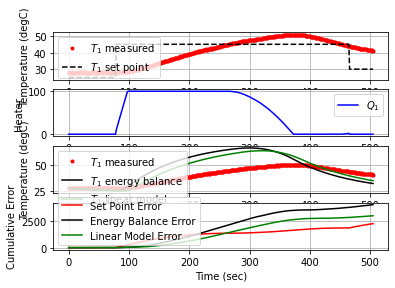

 507.4  30.00  40.80   0.00  -2.18   1.78   0.01


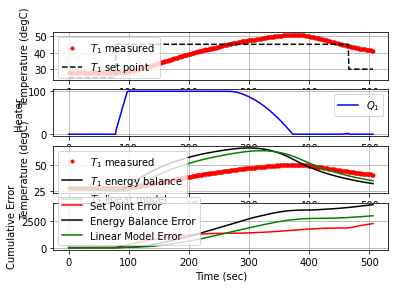

 508.6  30.00  40.87   0.00  -2.19   1.78  -0.00


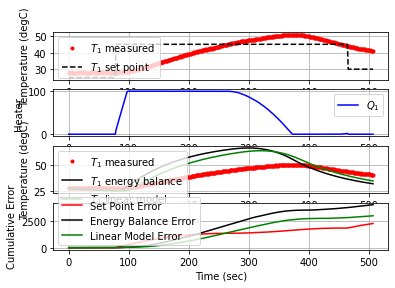

 509.8  30.00  40.72   0.00  -2.16   1.78   0.01


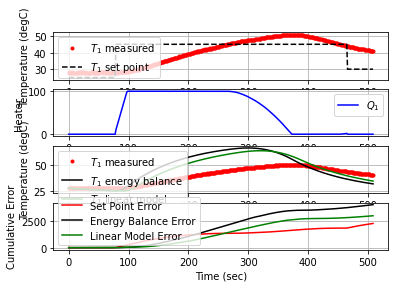

 510.9  30.00  40.82   0.00  -2.18   1.78  -0.01


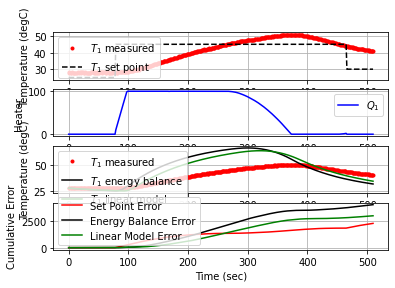

 512.1  30.00  40.61   0.00  -2.14   1.78   0.01


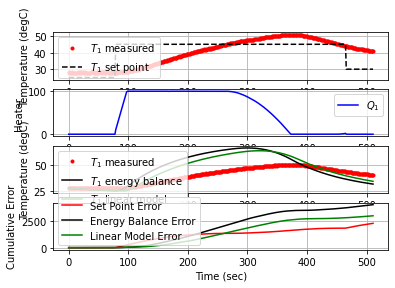

 513.4  30.00  40.58   0.00  -2.14   1.78   0.00


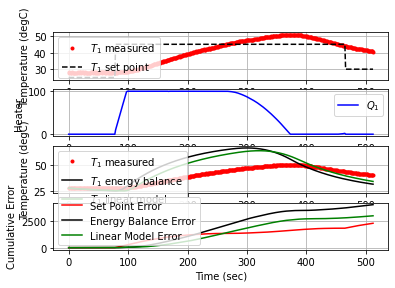

 514.7  30.00  40.68   0.00  -2.16   1.78  -0.01


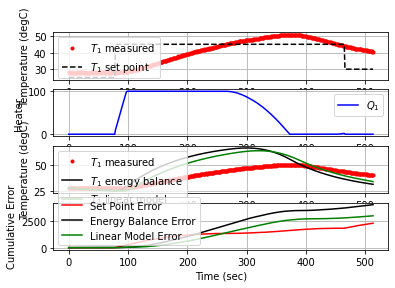

 515.8  30.00  40.63   0.00  -2.15   1.78   0.00


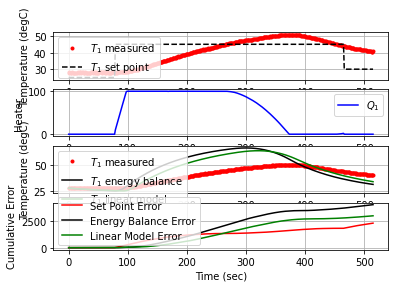

 517.0  30.00  40.45   0.00  -2.11   1.78   0.01


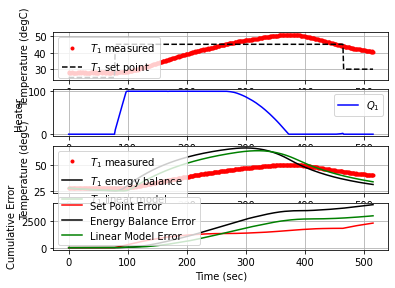

 518.2  30.00  40.46   0.00  -2.11   1.78  -0.00


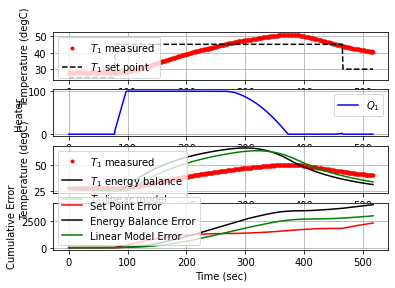

 519.5  30.00  40.19   0.00  -2.06   1.78   0.01


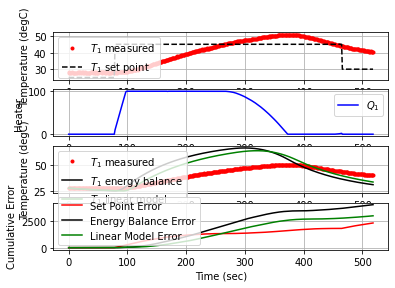

 520.9  30.00  40.13   0.00  -2.04   1.78   0.00


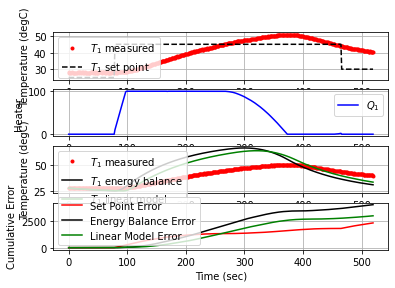

 522.1  30.00  40.03   0.00  -2.02   1.78   0.01


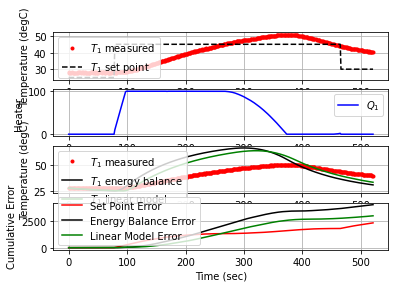

 523.4  30.00  40.12   0.00  -2.04   1.78  -0.00


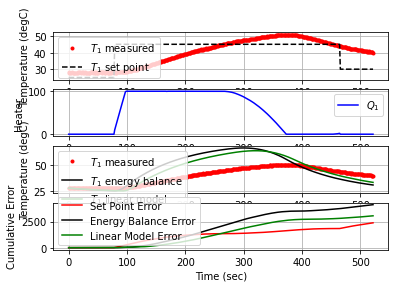

 524.7  30.00  39.97   0.00  -2.01   1.78   0.01


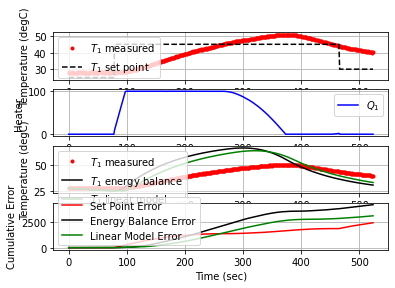

 525.9  30.00  39.71   0.00  -1.96   1.78   0.01


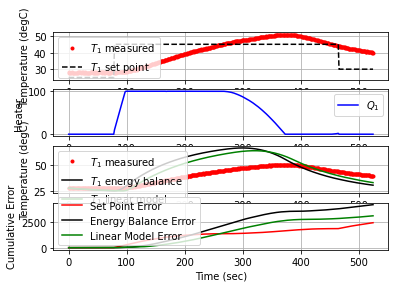

 527.1  30.00  39.75   0.00  -1.97   1.78  -0.00


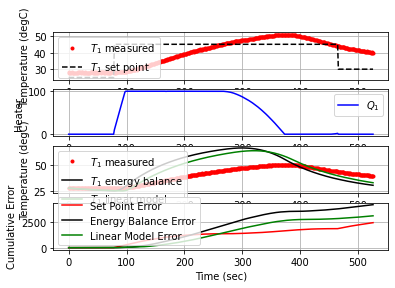

 528.5  30.00  39.53   0.00  -1.92   1.78   0.01


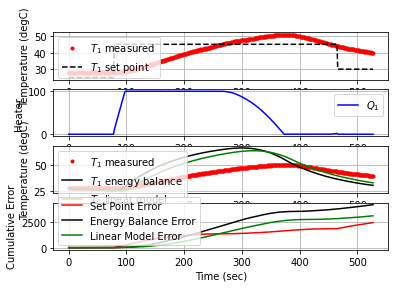

 529.7  30.00  39.65   0.00  -1.95   1.78  -0.01


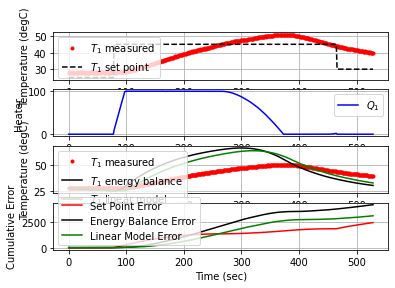

 530.9  30.00  39.59   0.00  -1.94   1.78   0.00


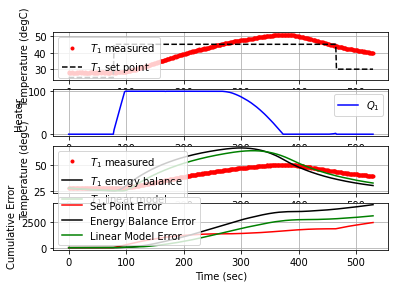

 532.1  30.00  39.41   0.00  -1.90   1.78   0.01


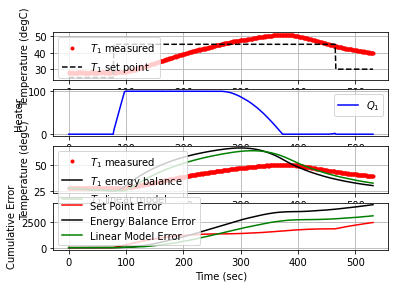

 533.3  30.00  39.50   0.00  -1.92   1.78  -0.00


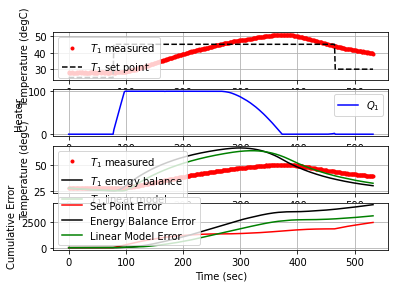

 534.6  30.00  39.23   0.00  -1.86   1.78   0.01


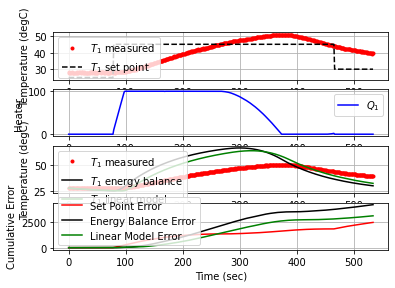

 535.7  30.00  39.38   0.00  -1.89   1.78  -0.01


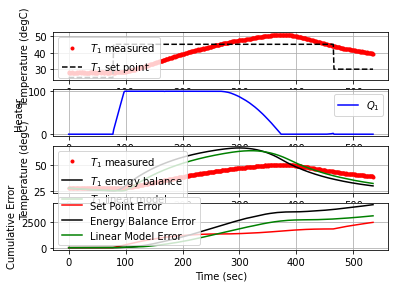

 537.0  30.00  39.05   0.00  -1.83   1.78   0.02


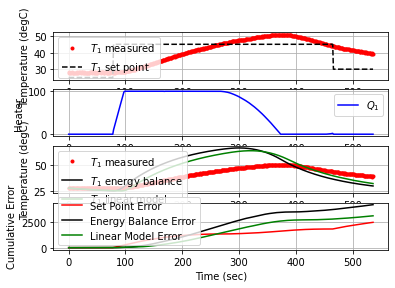

 538.2  30.00  38.98   0.00  -1.81   1.78   0.00


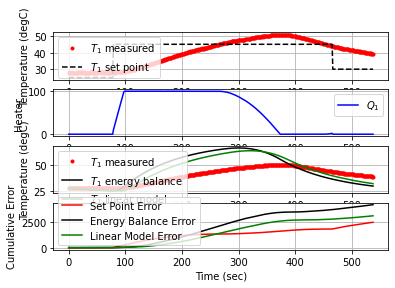

 539.4  30.00  39.07   0.00  -1.83   1.78  -0.01


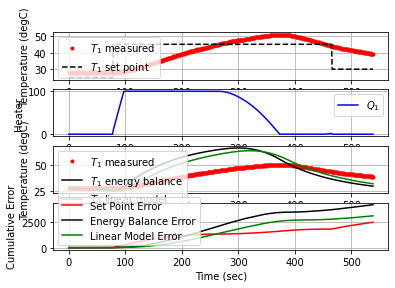

 540.6  30.00  38.92   0.00  -1.80   1.78   0.01


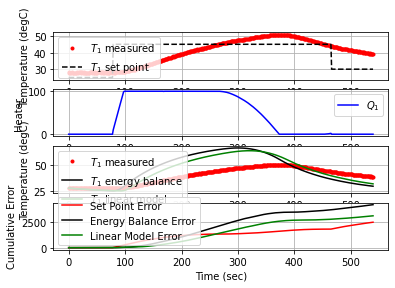

 541.9  30.00  38.99   0.00  -1.81   1.78  -0.00


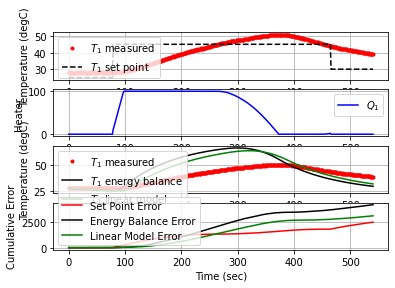

 543.2  30.00  38.93   0.00  -1.80   1.78   0.00


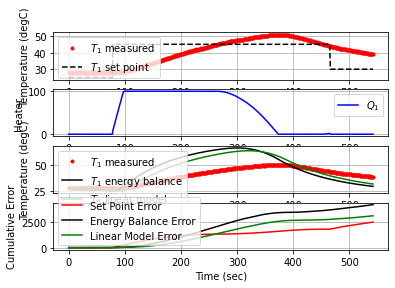

 544.3  30.00  38.73   0.00  -1.76   1.78   0.01


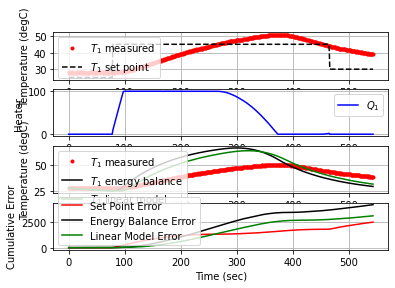

 545.5  30.00  38.76   0.00  -1.77   1.78  -0.00


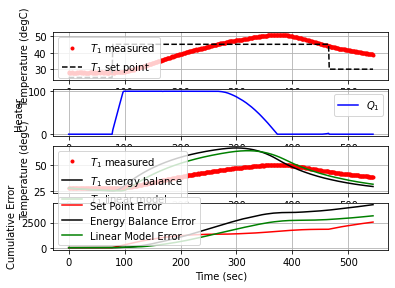

 546.7  30.00  38.66   0.00  -1.75   1.78   0.01


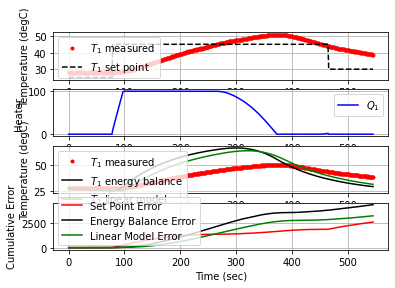

 548.0  30.00  38.64   0.00  -1.74   1.78   0.00


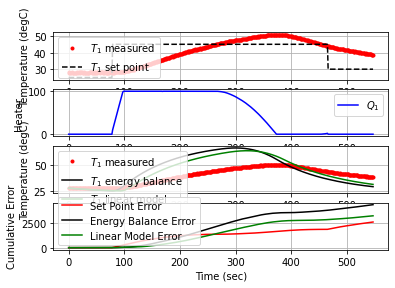

 549.3  30.00  38.58   0.00  -1.73   1.78   0.00


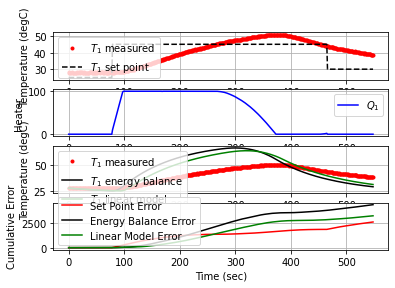

 550.4  30.00  38.49   0.00  -1.71   1.78   0.01


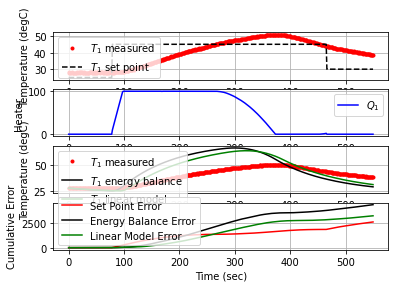

 551.7  30.00  38.46   0.00  -1.71   1.78   0.00


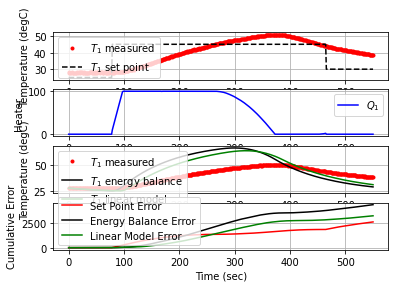

 553.0  30.00  38.24   0.00  -1.66   1.78   0.01


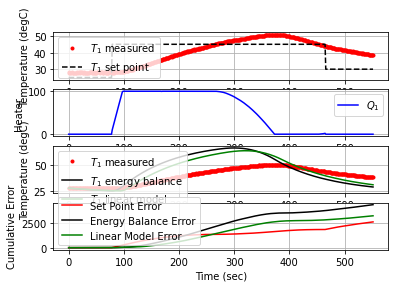

 554.2  30.00  38.36   0.00  -1.69   1.78  -0.01


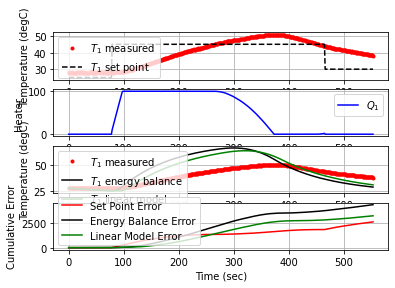

 555.6  30.00  38.27   0.00  -1.67   1.78   0.00


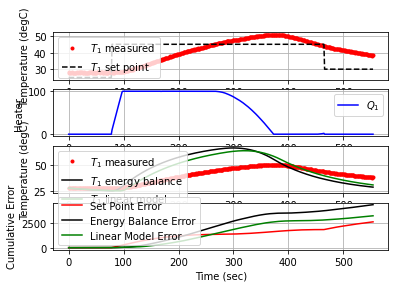

 556.7  30.00  38.12   0.00  -1.64   1.78   0.01


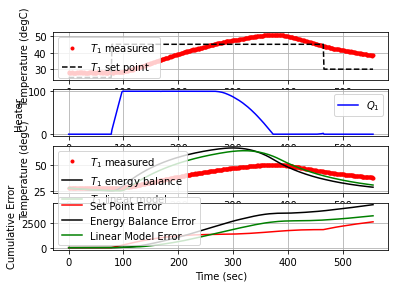

 557.9  30.00  38.07   0.00  -1.63   1.78   0.00


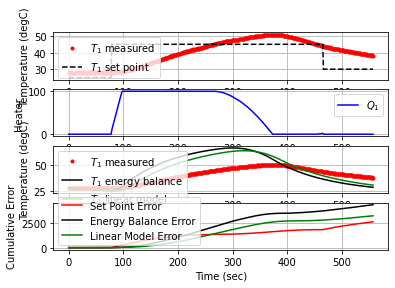

 559.1  30.00  37.76   0.00  -1.57   1.78   0.02


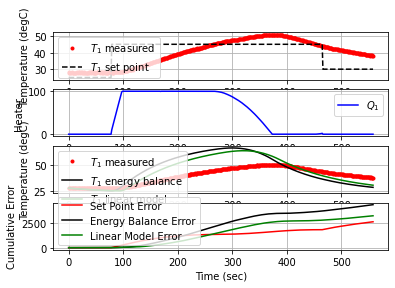

 560.3  30.00  37.78   0.00  -1.57   1.78  -0.00


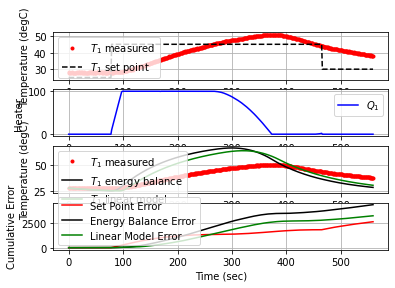

 561.7  30.00  37.69   0.00  -1.55   1.78   0.00


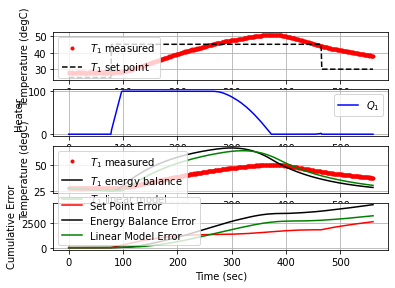

 563.0  30.00  37.58   0.00  -1.53   1.78   0.01


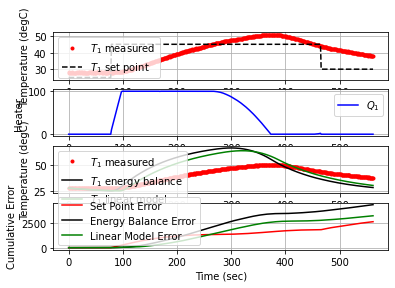

 564.3  30.00  37.63   0.00  -1.54   1.78  -0.00


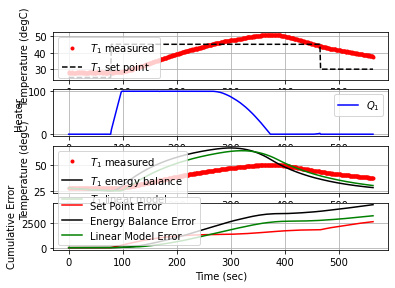

 565.5  30.00  37.62   0.00  -1.54   1.78   0.00


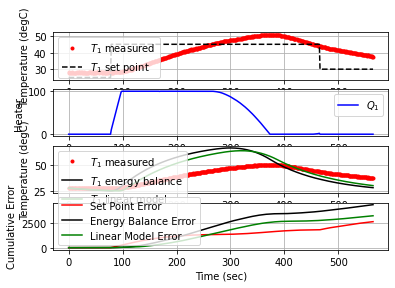

 566.7  30.00  37.47   0.00  -1.51   1.78   0.01


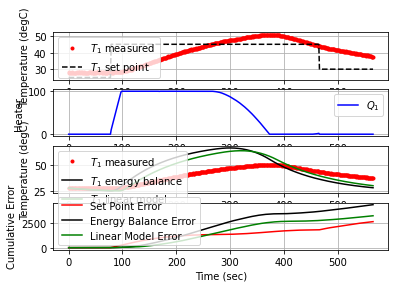

 568.0  30.00  37.46   0.00  -1.51   1.78   0.00


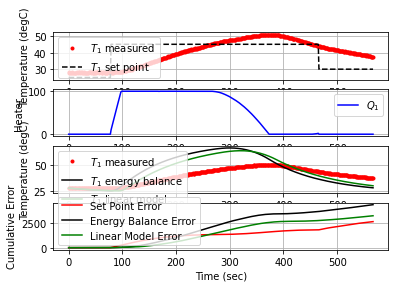

 569.3  30.00  37.49   0.00  -1.51   1.78  -0.00


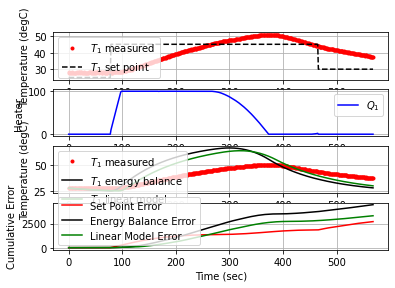

 570.4  30.00  37.28   0.00  -1.47   1.78   0.01


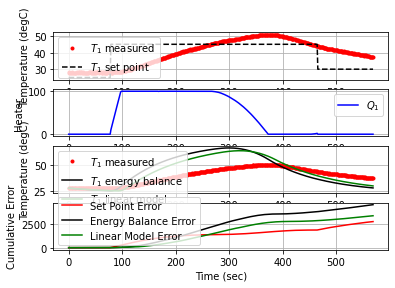

 571.6  30.00  37.32   0.00  -1.48   1.78  -0.00


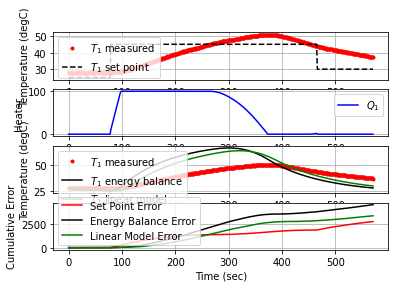

 572.9  30.00  37.12   0.00  -1.44   1.78   0.01


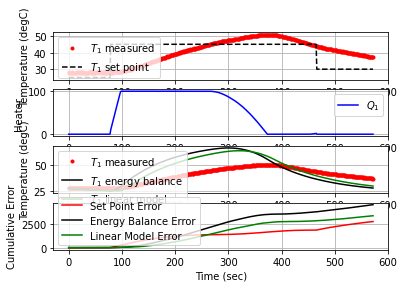

 574.1  30.00  37.08   0.00  -1.43   1.78   0.00


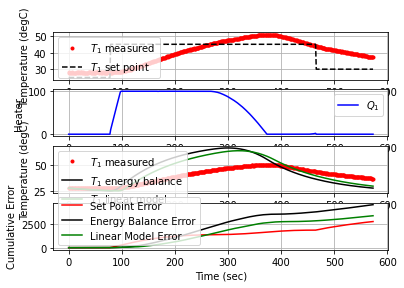

 575.4  30.00  37.13   0.00  -1.44   1.78  -0.00


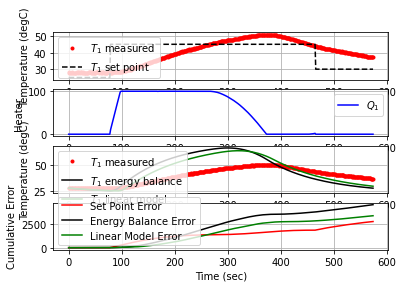

 576.7  30.00  37.04   0.00  -1.42   1.78   0.00


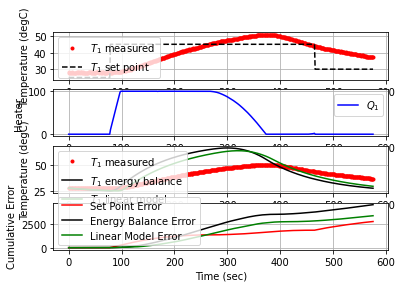

 577.9  30.00  36.89   0.00  -1.39   1.78   0.01


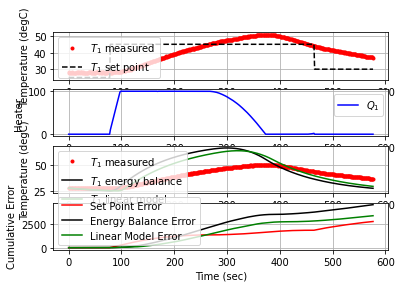

 579.2  30.00  37.05   0.00  -1.42   1.78  -0.01


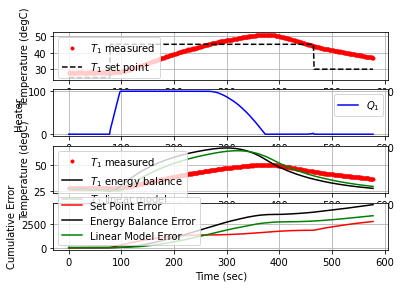

 580.3  30.00  36.93   0.00  -1.40   1.78   0.01


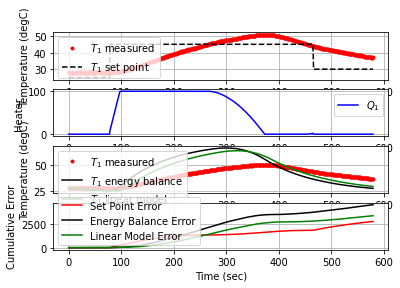

 581.6  30.00  36.93   0.00  -1.40   1.78  -0.00


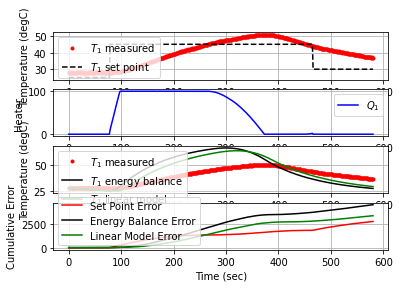

 583.0  30.00  36.78   0.00  -1.37   1.78   0.01


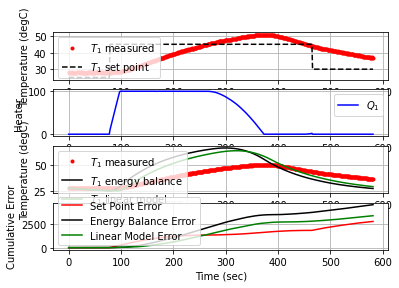

 584.2  30.00  36.80   0.00  -1.37   1.78  -0.00


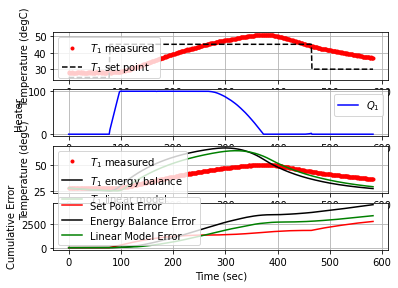

 585.5  30.00  36.83   0.00  -1.38   1.78  -0.00


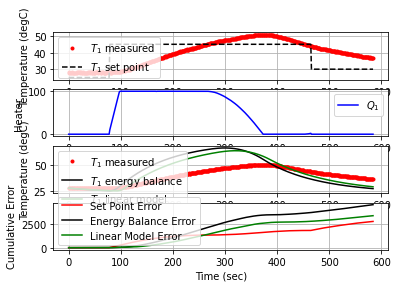

 586.7  30.00  36.68   0.00  -1.35   1.78   0.01


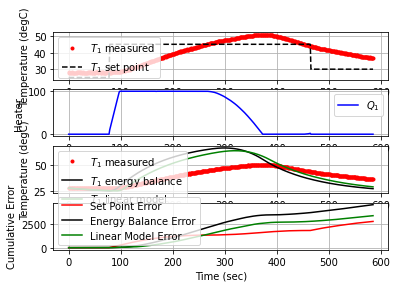

 588.0  30.00  36.62   0.00  -1.34   1.78   0.00


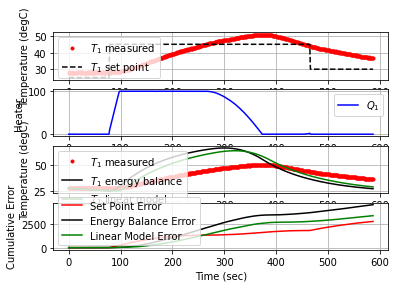

 589.3  30.00  36.44   0.00  -1.30   1.78   0.01


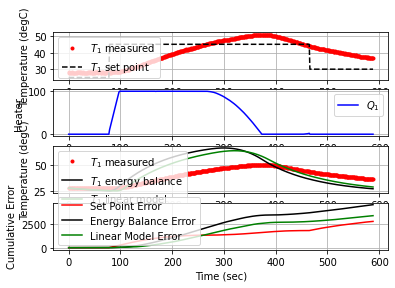

 590.5  30.00  36.52   0.00  -1.32   1.78  -0.00


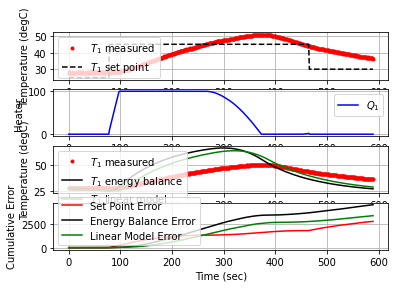

 591.8  30.00  36.48   0.00  -1.31   1.78   0.00


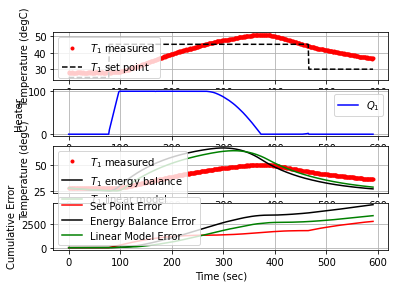

 593.1  30.00  36.38   0.00  -1.29   1.78   0.01


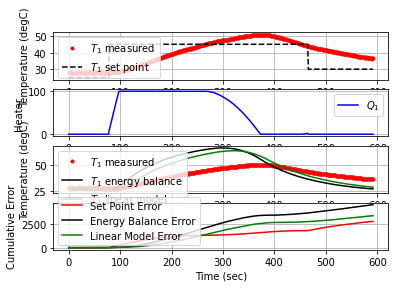

 594.5  30.00  36.38   0.00  -1.29   1.78  -0.00


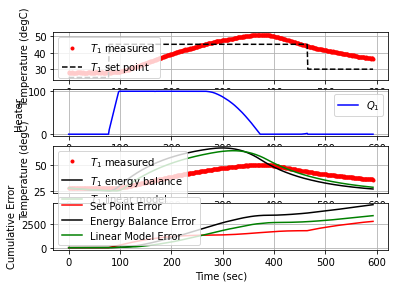

 595.8  30.00  36.27   0.00  -1.27   1.78   0.01


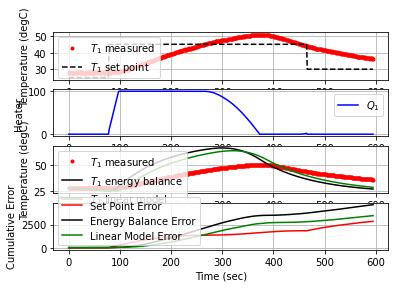

 597.1  30.00  36.24   0.00  -1.26   1.78   0.00


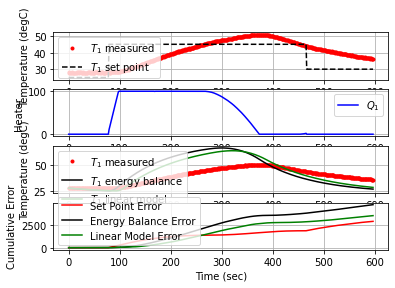

 598.3  30.00  36.17   0.00  -1.25   1.78   0.00


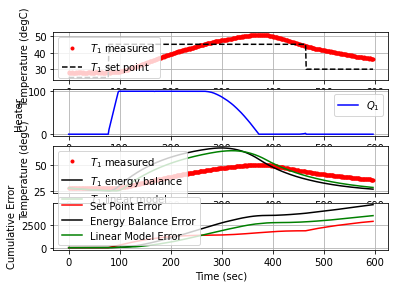

 599.5  30.00  36.29   0.00  -1.27   1.78  -0.01


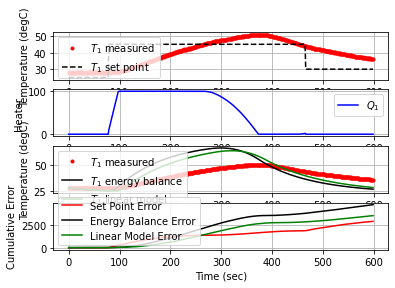

 600.7  30.00  36.20   0.00  -1.25   1.78   0.01


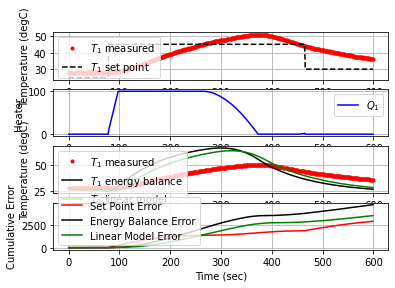

 602.1  30.00  36.05   0.00  -1.22   1.78   0.01


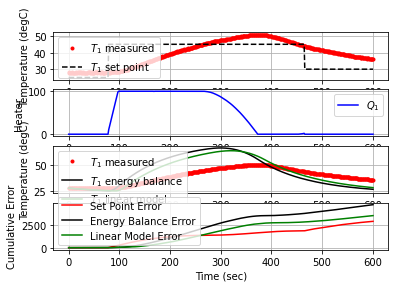

 603.3  30.00  36.06   0.00  -1.22   1.78  -0.00


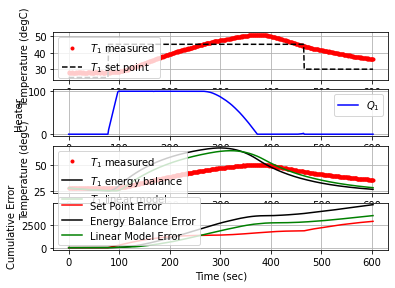

 604.6  30.00  35.92   0.00  -1.19   1.78   0.01


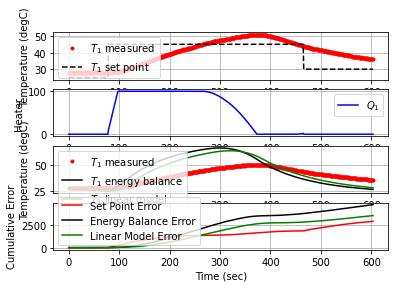

 605.7  30.00  36.02   0.00  -1.22   1.78  -0.01


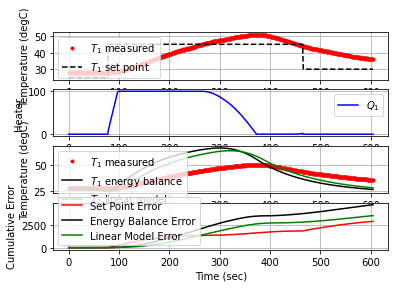

 607.1  30.00  35.86   0.00  -1.18   1.78   0.01


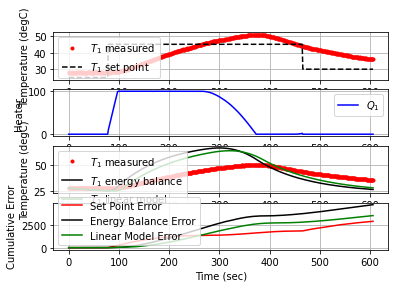

 608.6  30.00  35.87   0.00  -1.18   1.78  -0.00


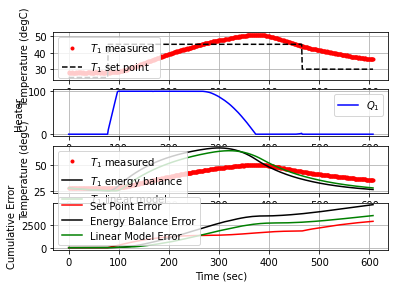

 610.0  30.00  35.92   0.00  -1.19   1.78  -0.00


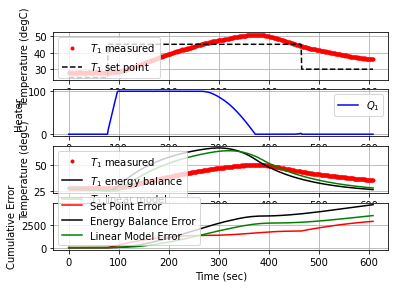

 611.3  30.00  35.91   0.00  -1.19   1.78   0.00


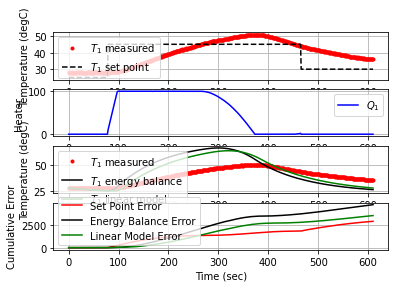

 612.7  30.00  35.83   0.00  -1.18   1.78   0.00


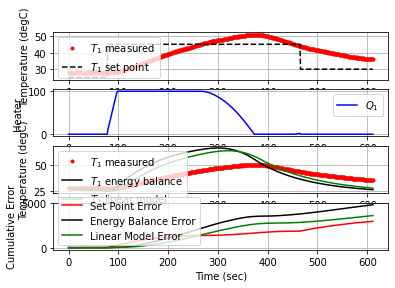

 614.0  30.00  35.74   0.00  -1.16   1.78   0.00


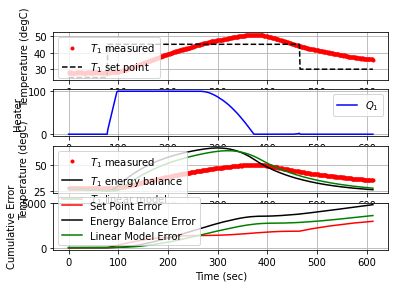

 615.4  30.00  35.56   0.00  -1.12   1.78   0.01


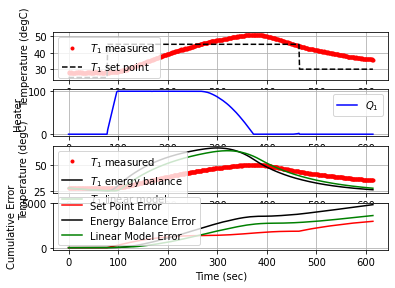

 616.6  30.00  35.67   0.00  -1.14   1.78  -0.01


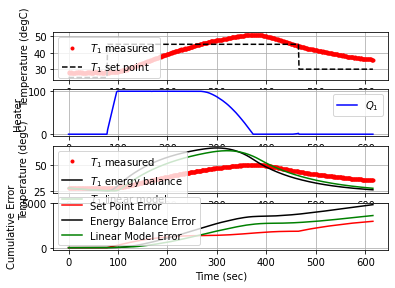

 617.9  30.00  35.62   0.00  -1.13   1.78   0.00


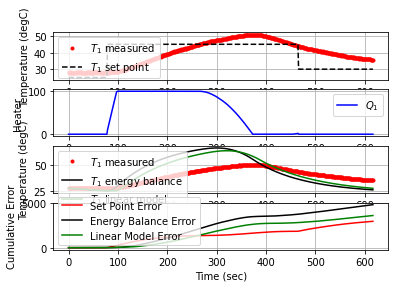

 619.2  30.00  35.49   0.00  -1.11   1.78   0.01


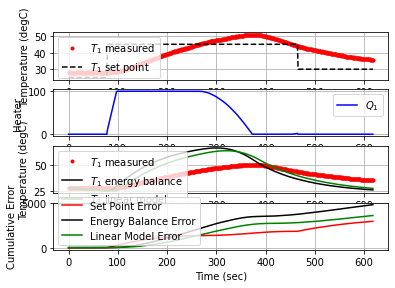

 620.5  30.00  35.46   0.00  -1.10   1.78   0.00


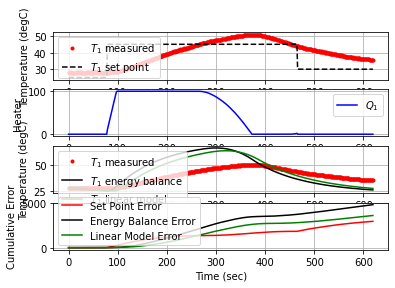

 621.9  30.00  35.21   0.00  -1.05   1.78   0.01


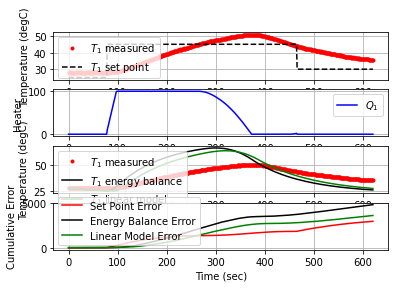

 623.1  30.00  35.48   0.00  -1.11   1.78  -0.01


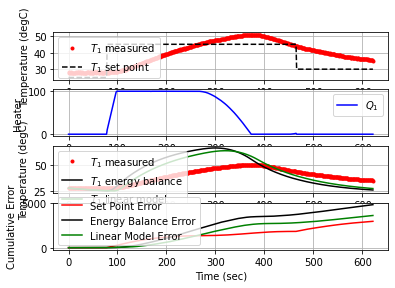

 624.3  30.00  35.32   0.00  -1.07   1.78   0.01


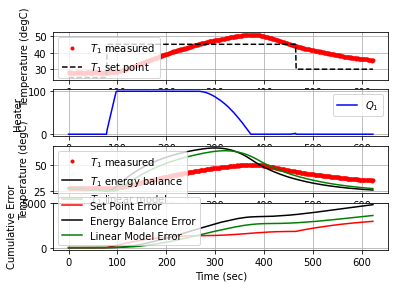

 625.6  30.00  35.33   0.00  -1.08   1.78  -0.00


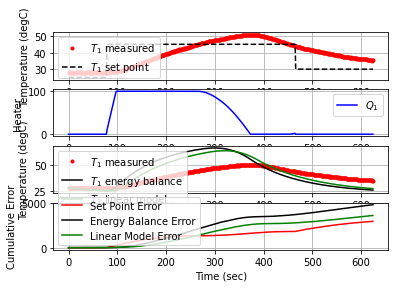

 626.9  30.00  35.27   0.00  -1.06   1.78   0.00


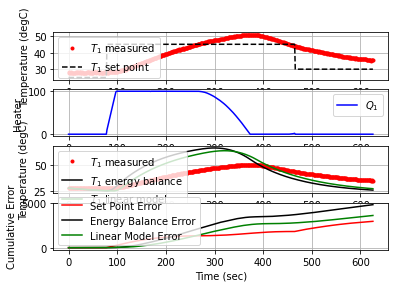

 628.3  30.00  35.22   0.00  -1.05   1.78   0.00


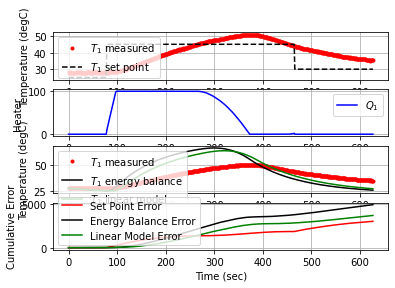

 629.5  30.00  35.10   0.00  -1.03   1.78   0.01


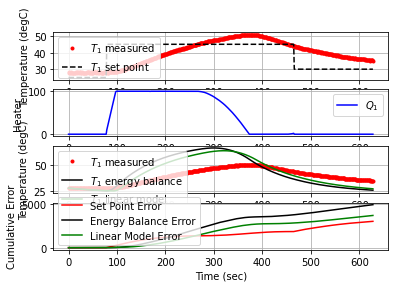

 630.7  30.00  35.09   0.00  -1.03   1.78   0.00


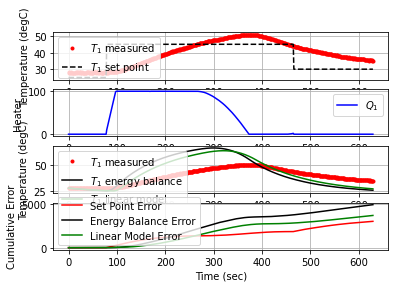

 632.0  30.00  34.90   0.00  -0.99   1.78   0.01


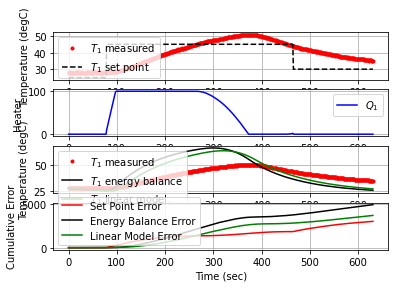

 633.2  30.00  34.92   0.00  -0.99   1.78  -0.00


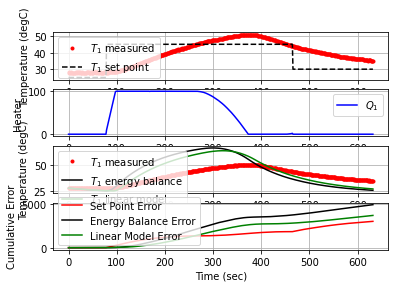

 634.6  30.00  34.99   0.00  -1.01   1.78  -0.00


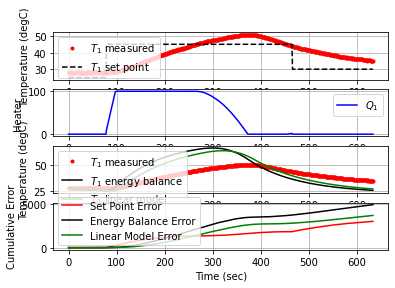

 635.8  30.00  34.83   0.00  -0.97   1.78   0.01


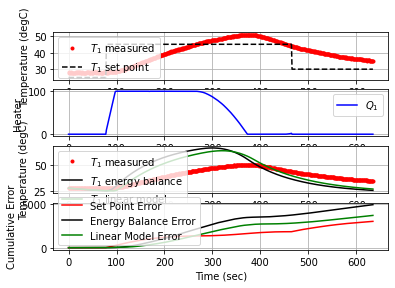

 637.2  30.00  34.71   0.00  -0.95   1.78   0.01


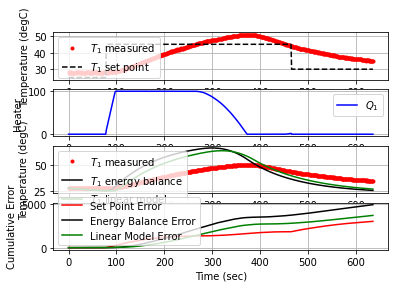

 638.4  30.00  34.60   0.00  -0.93   1.78   0.01


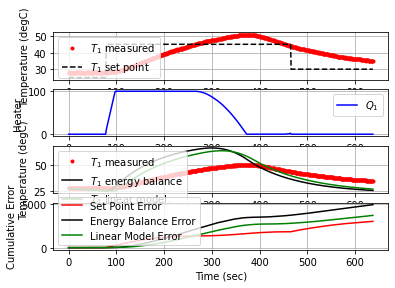

 639.6  30.00  34.66   0.00  -0.94   1.78  -0.00


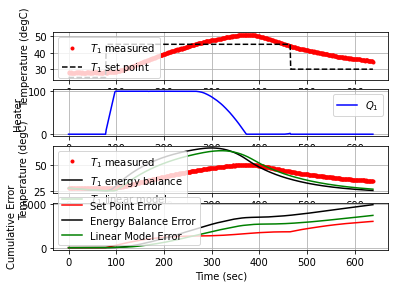

 641.0  30.00  34.59   0.00  -0.93   1.78   0.00


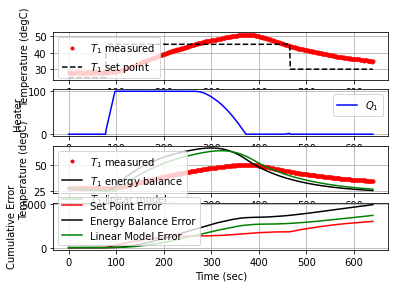

 642.3  30.00  34.44   0.00  -0.90   1.78   0.01


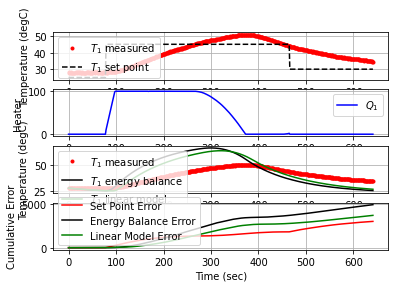

 643.5  30.00  34.44   0.00  -0.90   1.78  -0.00


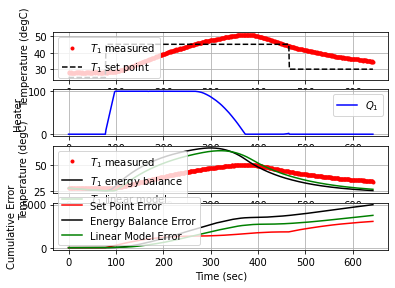

 644.7  30.00  34.54   0.00  -0.92   1.78  -0.01


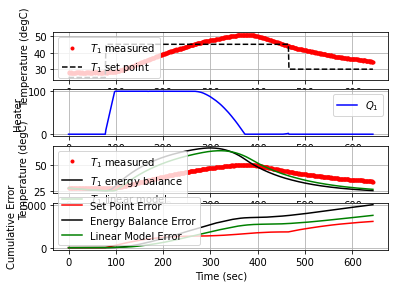

 645.9  30.00  34.49   0.00  -0.91   1.78   0.00


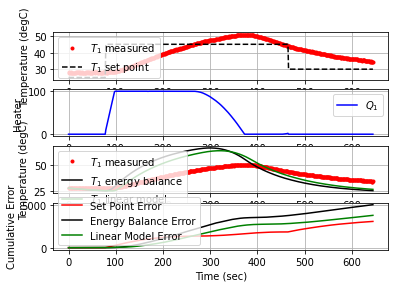

 647.4  30.00  34.33   0.00  -0.87   1.78   0.01


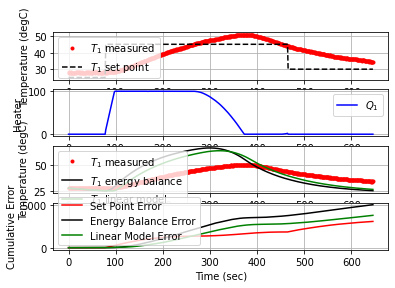

 648.6  30.00  34.28   0.00  -0.86   1.78   0.00


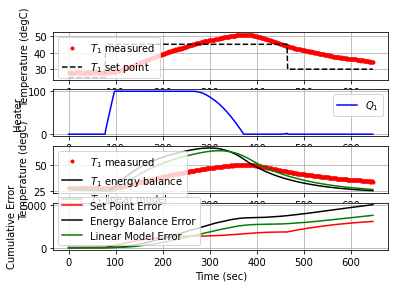

 649.9  30.00  34.47   0.00  -0.90   1.78  -0.01


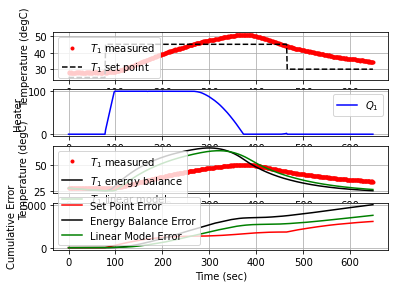

 651.1  30.00  34.46   0.00  -0.90   1.78   0.00


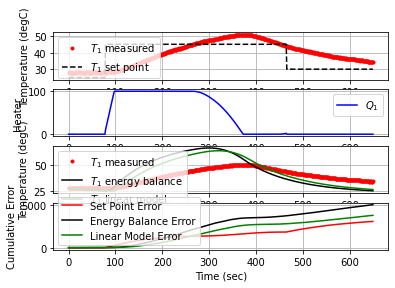

 652.3  30.00  34.44   0.00  -0.90   1.78   0.00


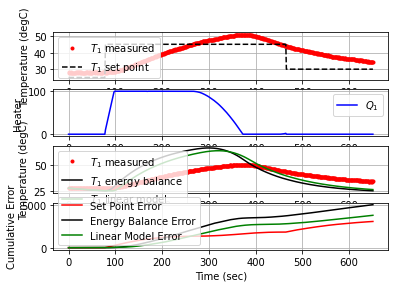

 653.6  30.00  34.38   0.00  -0.88   1.78   0.00


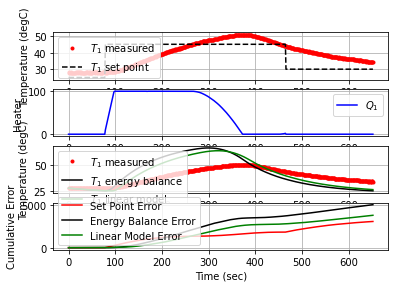

 654.9  30.00  34.19   0.00  -0.85   1.78   0.01


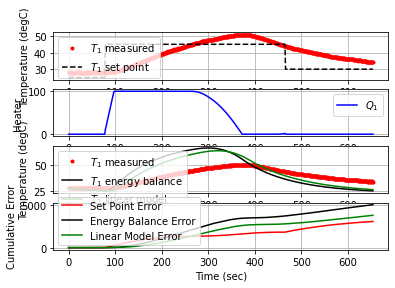

 656.1  30.00  34.16   0.00  -0.84   1.78   0.00


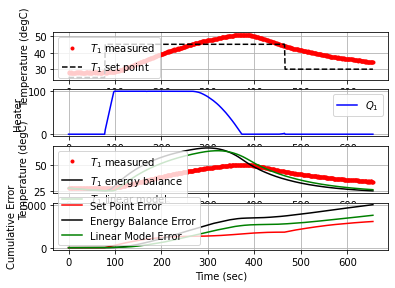

 657.4  30.00  34.34   0.00  -0.88   1.78  -0.01


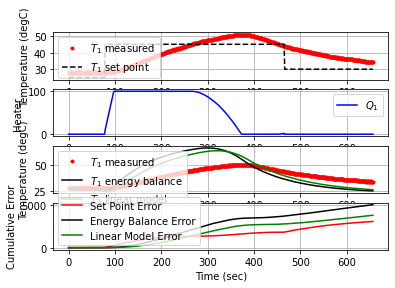

 658.7  30.00  34.12   0.00  -0.83   1.78   0.01


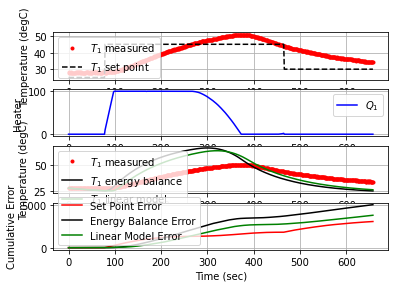

 660.1  30.00  34.15   0.00  -0.84   1.78  -0.00


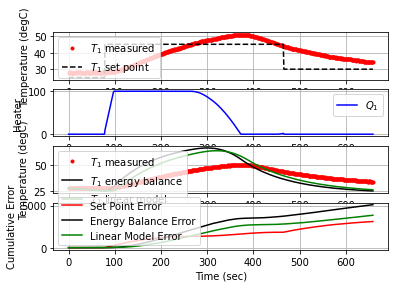

 661.2  30.00  34.16   0.00  -0.84   1.78  -0.00


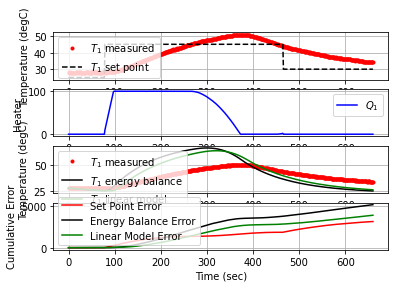

 662.5  30.00  34.06   0.00  -0.82   1.78   0.01


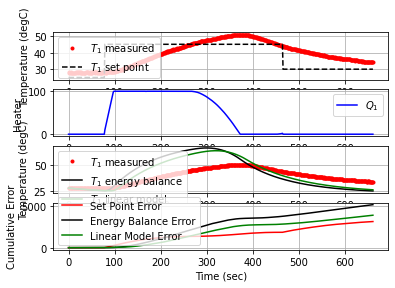

 663.8  30.00  34.19   0.00  -0.85   1.78  -0.01


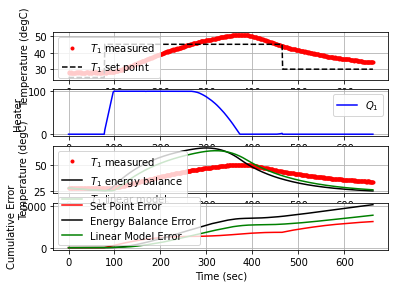

 665.0  30.00  34.10   0.00  -0.83   1.78   0.01


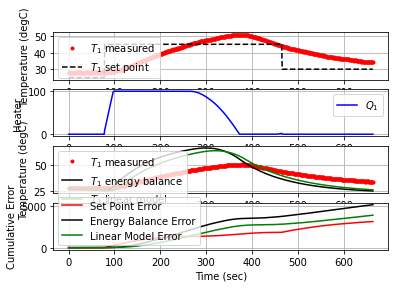

 666.4  30.00  33.97   0.00  -0.80   1.78   0.01


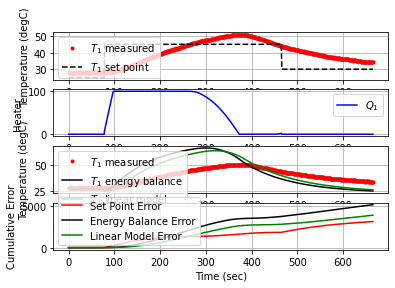

 667.7  30.00  33.84   0.00  -0.78   1.78   0.01


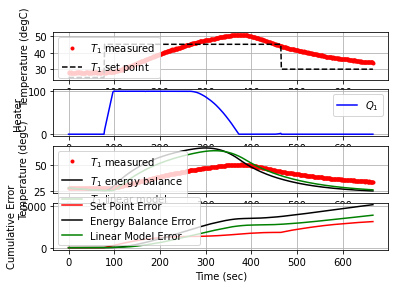

 669.0  30.00  33.92   0.00  -0.79   1.78  -0.00


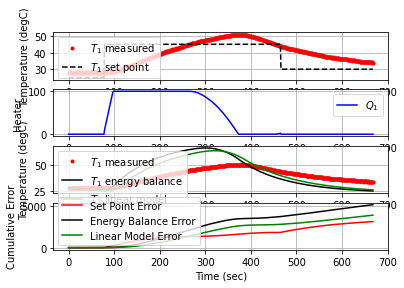

 670.2  30.00  34.05   0.00  -0.82   1.78  -0.01


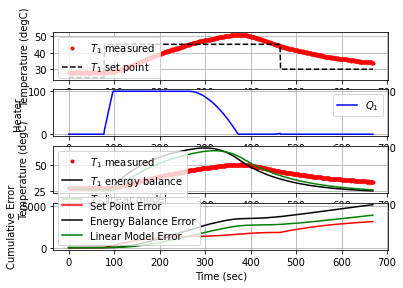

 671.5  30.00  33.78   0.00  -0.76   1.78   0.01


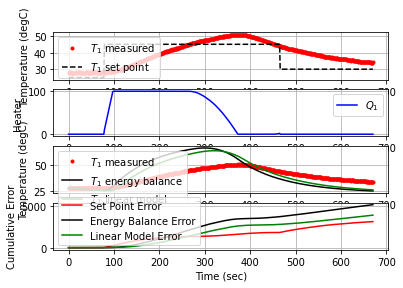

 673.0  30.00  33.94   0.00  -0.80   1.78  -0.01


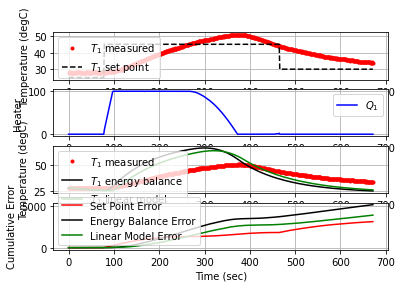

 674.2  30.00  33.57   0.00  -0.72   1.78   0.02


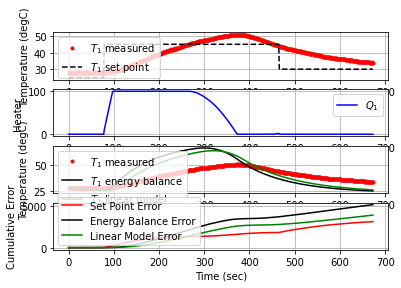

 675.4  30.00  33.69   0.00  -0.75   1.78  -0.01


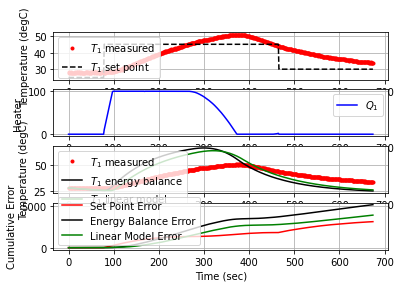

 676.6  30.00  33.75   0.00  -0.76   1.78  -0.00


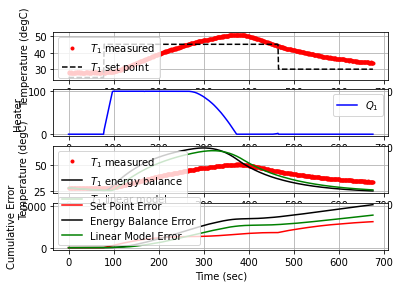

 677.9  30.00  33.69   0.00  -0.75   1.78   0.00


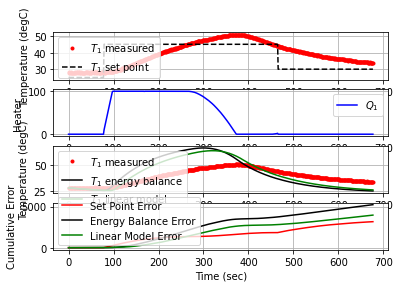

 679.3  30.00  33.56   0.00  -0.72   1.78   0.01


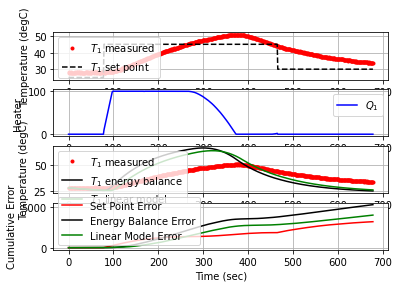

 680.5  30.00  33.61   0.00  -0.73   1.78  -0.00


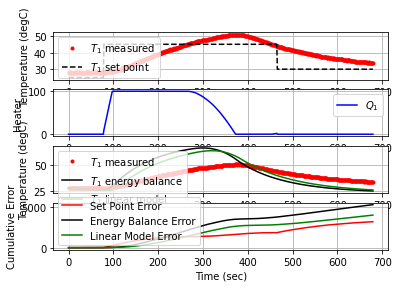

 681.7  30.00  33.50   0.00  -0.71   1.78   0.01


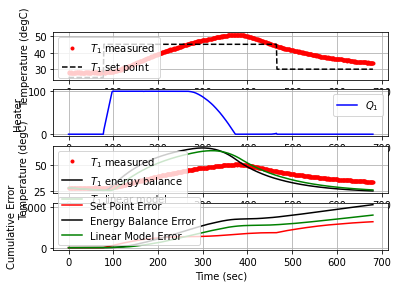

 683.0  30.00  33.37   0.00  -0.68   1.78   0.01


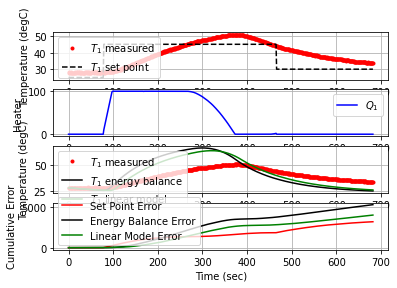

 684.5  30.00  33.49   0.00  -0.70   1.78  -0.01


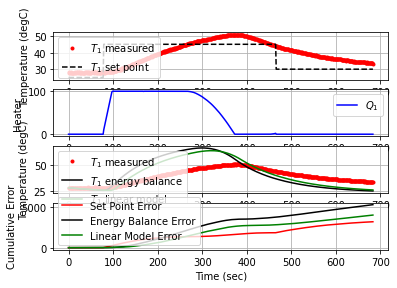

 686.1  30.00  33.56   0.00  -0.72   1.78  -0.00


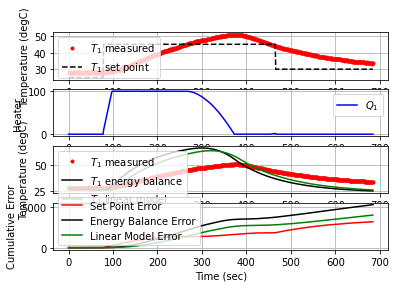

 687.4  30.00  33.34   0.00  -0.67   1.78   0.01


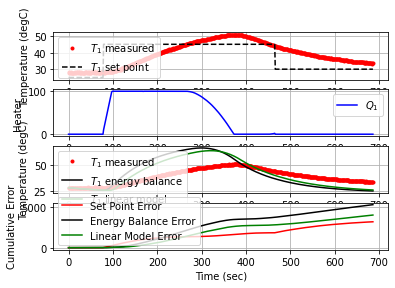

 688.7  30.00  33.54   0.00  -0.71   1.78  -0.01


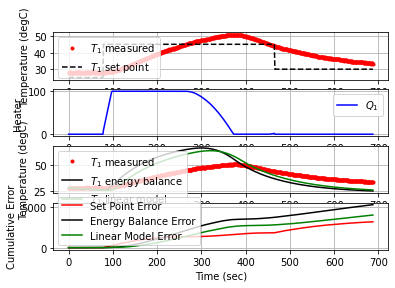

 690.1  30.00  33.29   0.00  -0.66   1.78   0.01


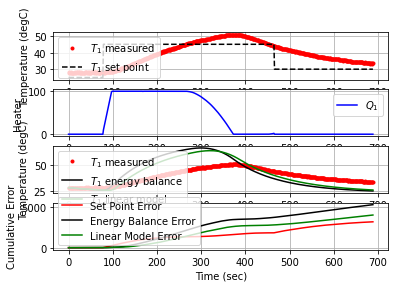

 691.3  30.00  33.24   0.00  -0.65   0.65   0.00


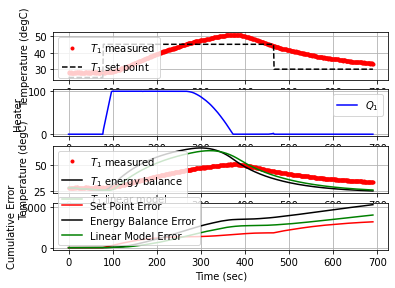

 692.9  30.00  33.28   0.00  -0.66   0.65  -0.00


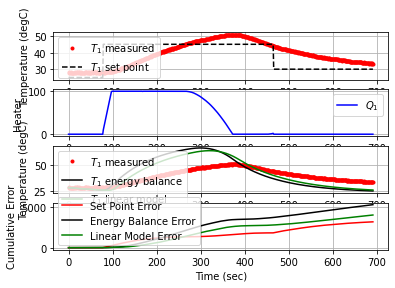

 694.3  30.00  33.31   0.00  -0.67   0.65  -0.00


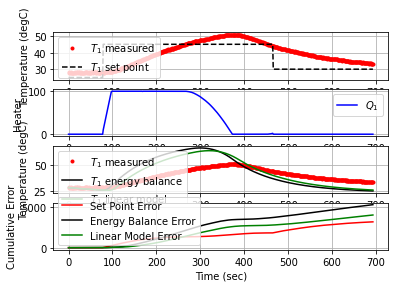

 695.5  30.00  33.35   0.00  -0.68   0.65  -0.00


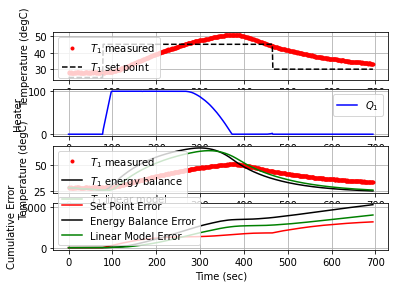

 696.9  30.00  33.28   0.00  -0.66   0.65   0.00


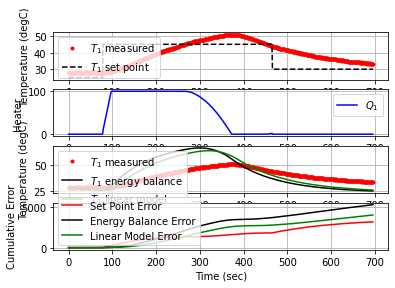

 698.1  30.00  33.30   0.00  -0.67   0.65  -0.00


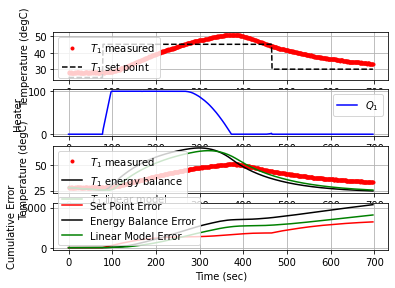

 699.5  30.00  33.23   0.00  -0.65   0.65   0.00


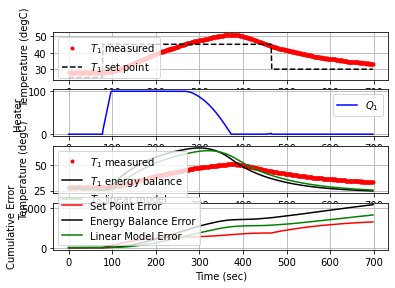

 700.9  30.00  33.07   0.00  -0.62   0.65   0.01


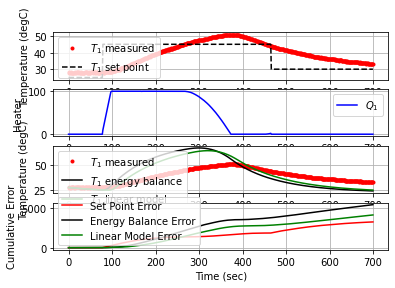

 702.1  30.00  33.21   0.00  -0.65   0.65  -0.01


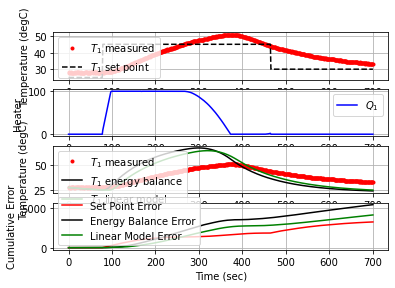

 703.4  30.00  32.78   0.00  -0.56   0.65   0.02


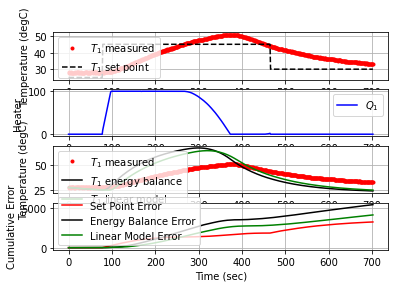

 704.7  30.00  32.84   0.00  -0.57   0.65  -0.00


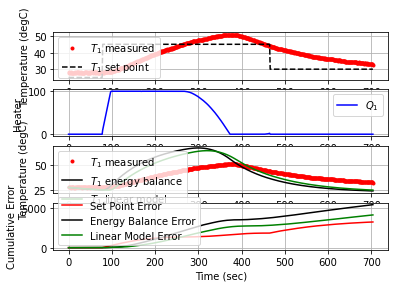

 706.1  30.00  32.88   0.00  -0.58   0.65  -0.00


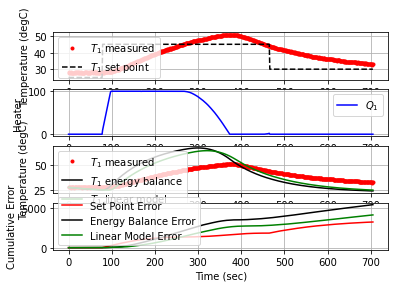

 707.4  30.00  32.94   0.00  -0.59   0.65  -0.00


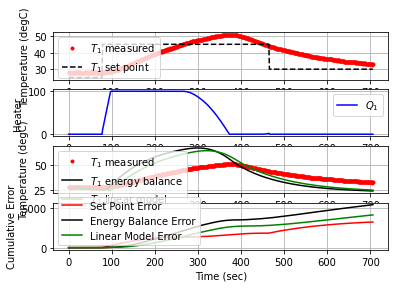

 708.6  30.00  32.87   0.00  -0.58   0.65   0.00


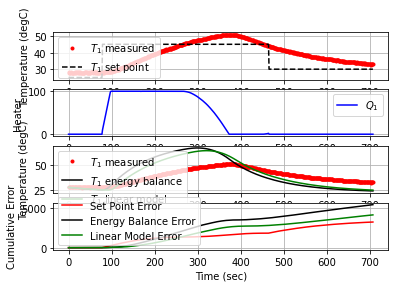

 709.8  30.00  32.94   0.00  -0.59   0.65  -0.00


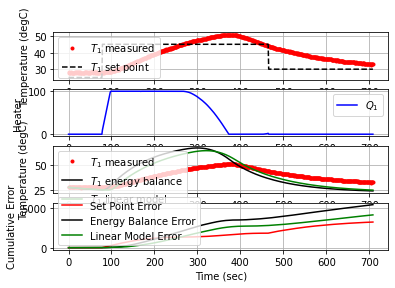

 711.1  30.00  32.87   0.00  -0.58   0.65   0.00


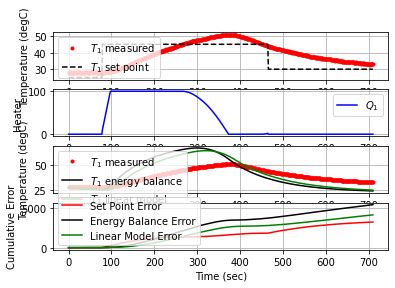

 712.4  30.00  32.69   0.00  -0.54   0.65   0.01


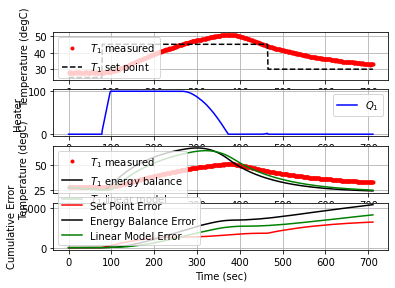

 713.7  30.00  32.62   0.00  -0.53   0.65   0.00


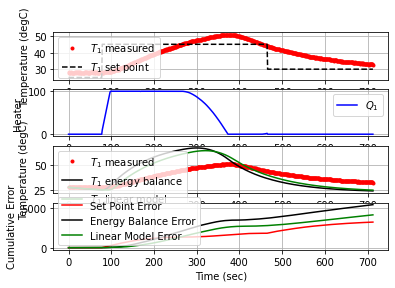

 715.0  30.00  32.70   0.00  -0.55   0.65  -0.00


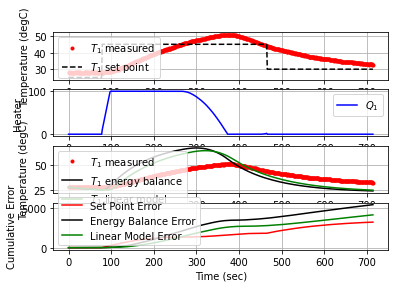

 716.2  30.00  32.57   0.00  -0.52   0.65   0.01


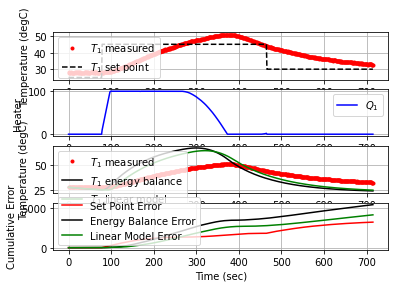

 717.5  30.00  32.66   0.00  -0.54   0.65  -0.00


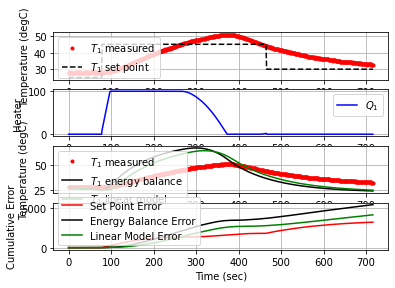

 718.9  30.00  32.57   0.00  -0.52   0.65   0.00


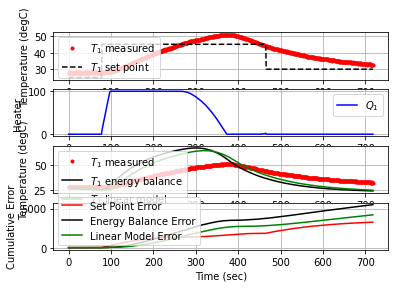

 720.2  30.00  32.56   0.00  -0.52   0.65   0.00


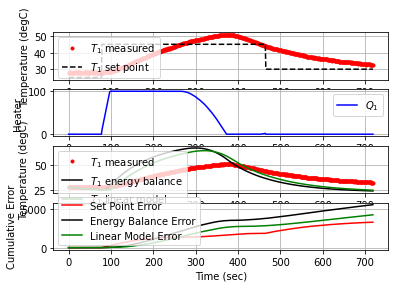

 721.4  30.00  32.38   0.00  -0.48   0.65   0.01


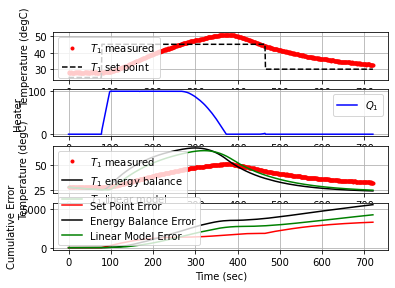

 722.7  30.00  32.44   0.00  -0.49   0.65  -0.00


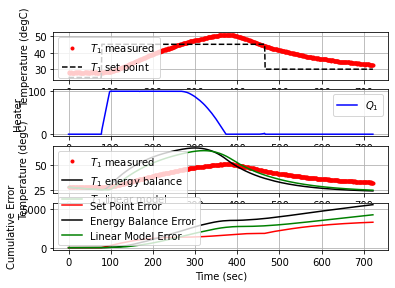

 724.0  30.00  32.45   0.00  -0.50   0.65  -0.00


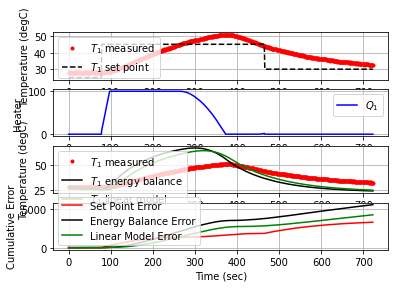

 725.4  30.00  32.43   0.00  -0.49   0.65   0.00


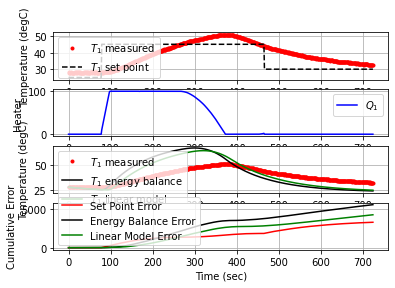

 726.9  30.00  32.53   0.00  -0.51   0.65  -0.00


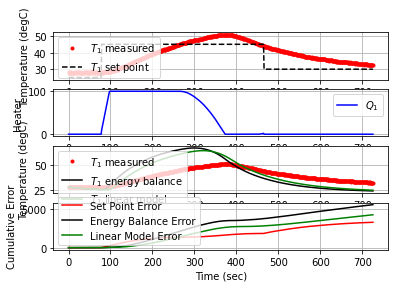

 728.3  30.00  32.51   0.00  -0.51   0.65   0.00


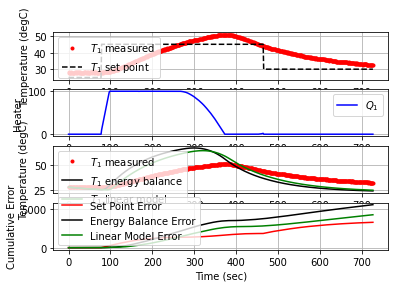

 729.7  30.00  32.48   0.00  -0.50   0.65   0.00


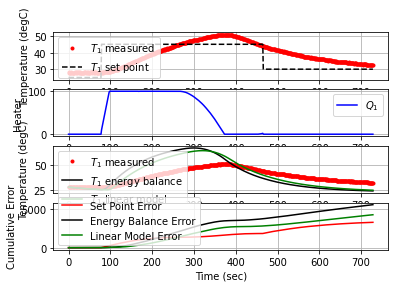

 731.1  30.00  32.38   0.00  -0.48   0.65   0.00


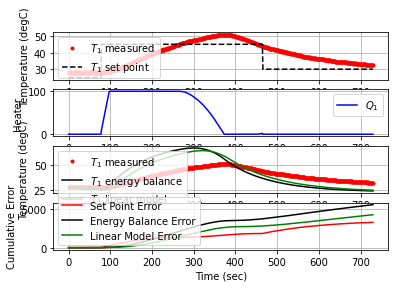

 732.5  30.00  32.47   0.00  -0.50   0.65  -0.00


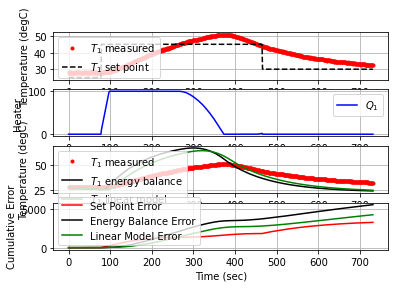

 733.9  30.00  32.40   0.00  -0.49   0.65   0.00


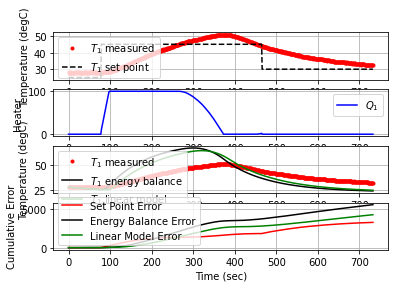

 735.2  30.00  32.37   0.00  -0.48   0.65   0.00


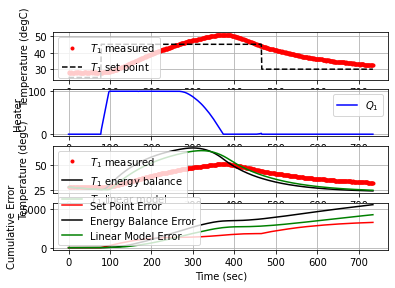

 736.4  30.00  32.37   0.00  -0.48   0.65  -0.00


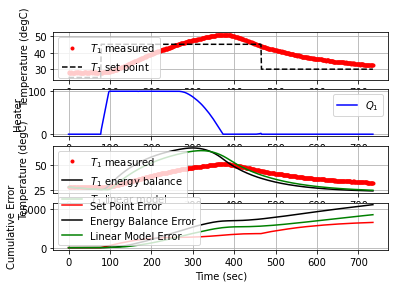

 737.7  30.00  32.43   0.00  -0.49   0.65  -0.00


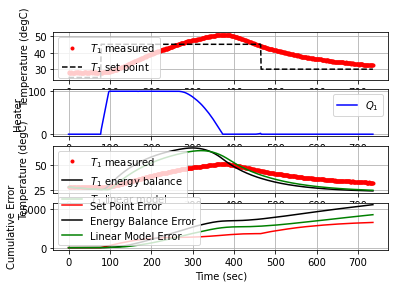

 739.1  30.00  32.18   0.00  -0.44   0.65   0.01


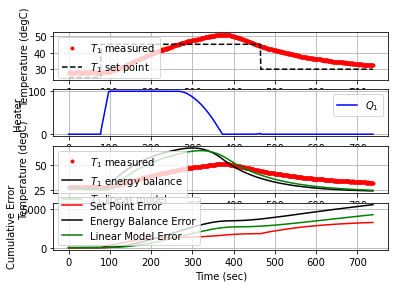

 740.5  30.00  32.26   0.00  -0.46   0.65  -0.00


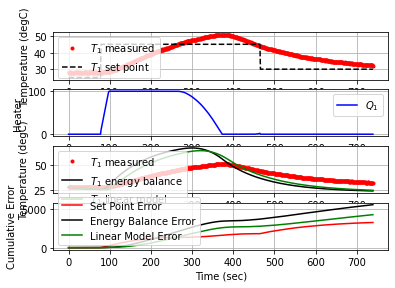

 741.9  30.00  32.28   0.00  -0.46   0.65  -0.00


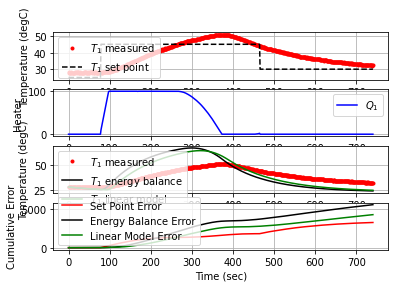

 743.4  30.00  32.19   0.00  -0.44   0.65   0.00


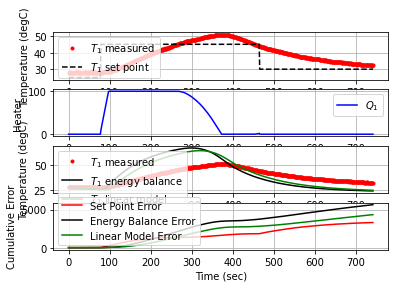

 744.7  30.00  32.07   0.00  -0.42   0.65   0.01


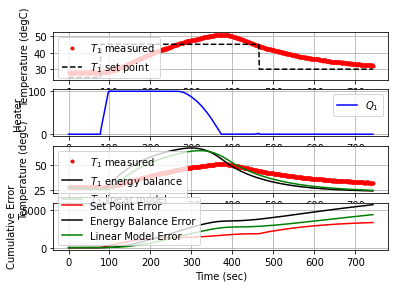

 746.2  30.00  32.16   0.00  -0.44   0.65  -0.00


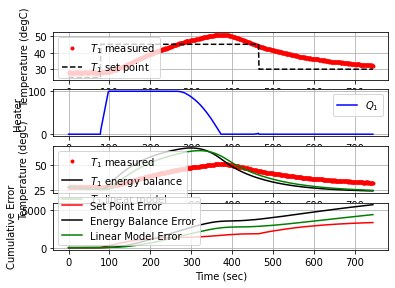

 747.4  30.00  32.18   0.00  -0.44   0.65  -0.00


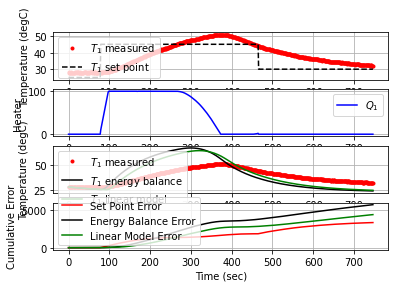

 748.6  30.00  32.02   0.00  -0.41   0.65   0.01


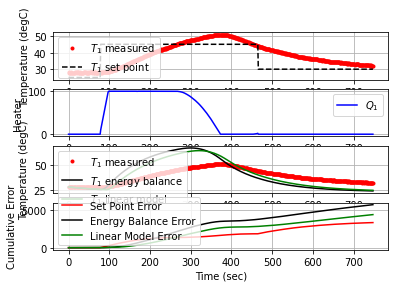

 749.9  30.00  32.12   0.00  -0.43   0.65  -0.01


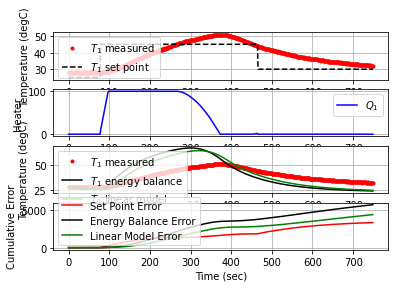

 751.1  30.00  32.01   0.00  -0.41   0.65   0.01


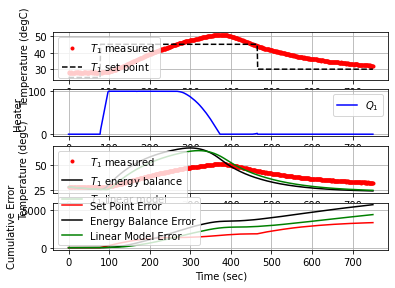

 752.6  30.00  32.10   0.00  -0.43   0.65  -0.00


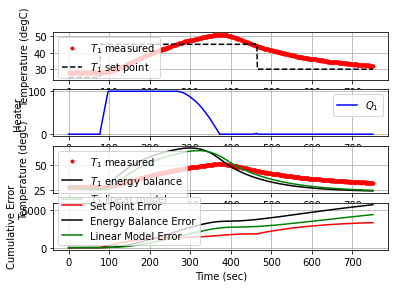

 753.9  30.00  31.92   0.00  -0.39   0.65   0.01


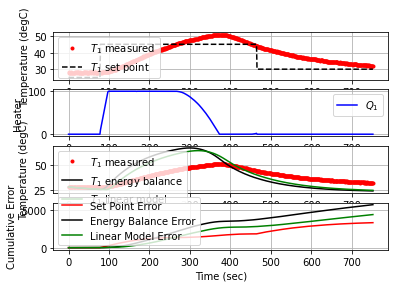

 755.2  30.00  31.97   0.00  -0.40   0.65  -0.00


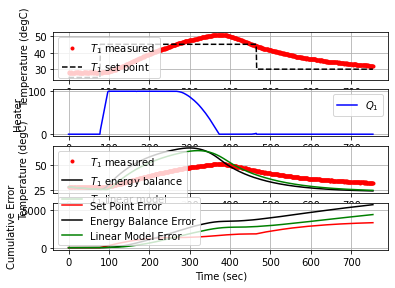

 756.4  30.00  31.99   0.00  -0.40   0.65  -0.00


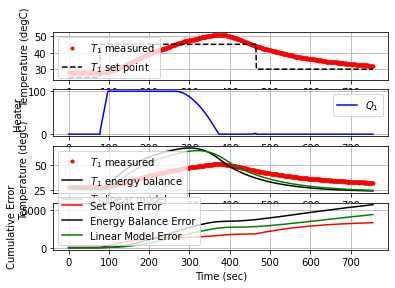

 757.9  30.00  32.05   0.00  -0.42   0.65  -0.00


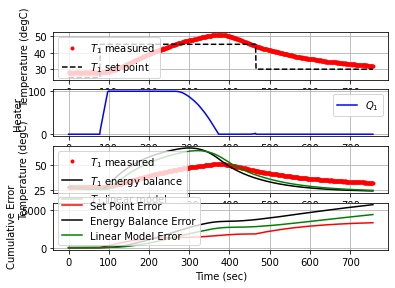

 759.2  30.00  32.01   0.00  -0.41   0.65   0.00


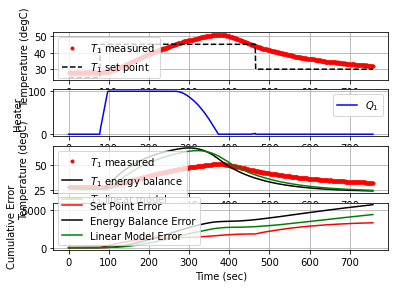

 760.5  30.00  32.03   0.00  -0.41   0.65  -0.00


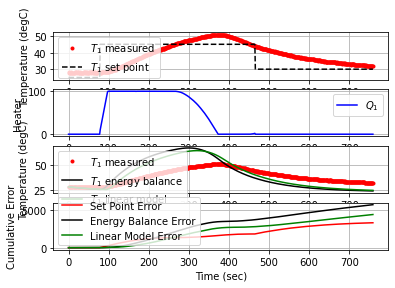

 761.9  30.00  32.15   0.00  -0.44   0.65  -0.01


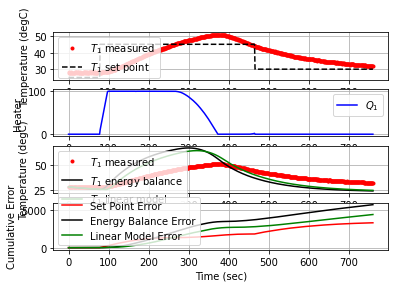

 763.3  30.00  31.89   0.00  -0.38   0.65   0.01


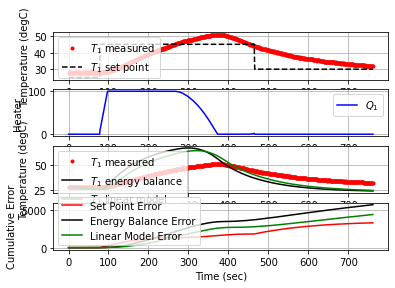

 764.6  30.00  31.98   0.00  -0.40   0.65  -0.00


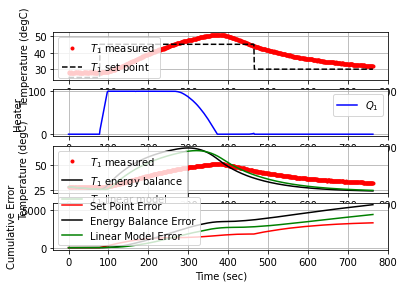

 766.0  30.00  31.90   0.00  -0.39   0.65   0.00


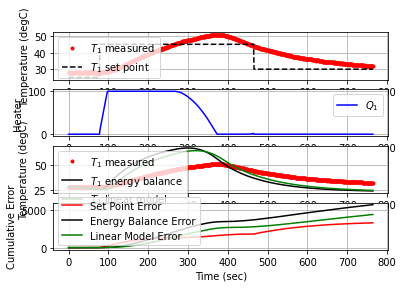

 767.3  30.00  31.64   0.00  -0.33   0.65   0.01


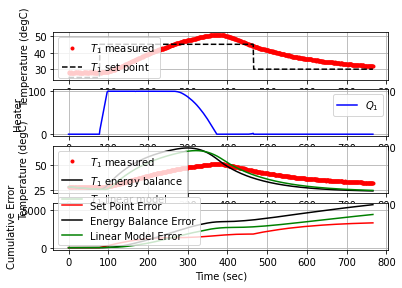

 768.6  30.00  31.66   0.00  -0.34   0.65  -0.00


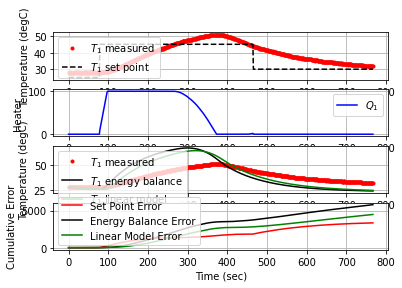

 769.8  30.00  31.80   0.00  -0.36   0.65  -0.01


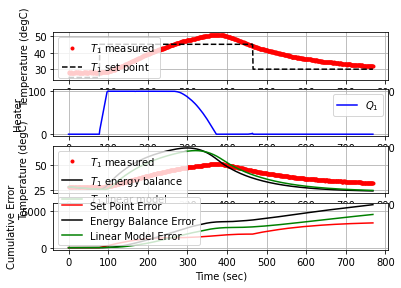

 771.3  30.00  31.62   0.00  -0.33   0.65   0.01


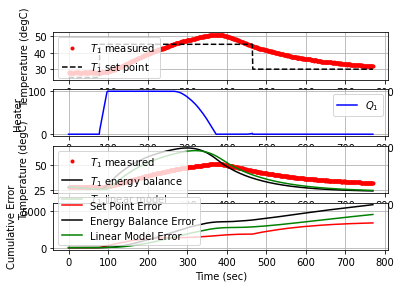

 772.6  30.00  31.59   0.00  -0.32   0.65   0.00


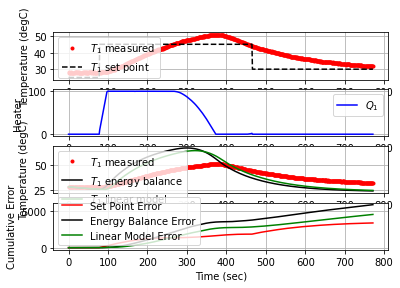

 773.9  30.00  31.69   0.00  -0.34   0.65  -0.01


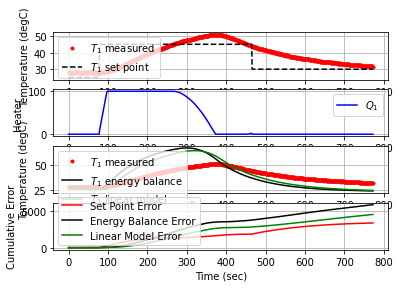

 775.2  30.00  31.59   0.00  -0.32   0.65   0.01


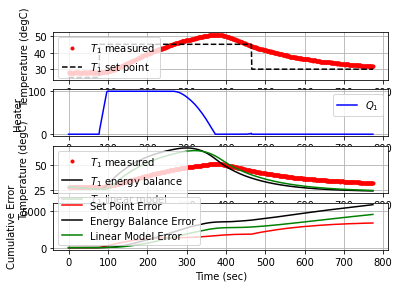

 776.4  30.00  31.55   0.00  -0.32   0.65   0.00


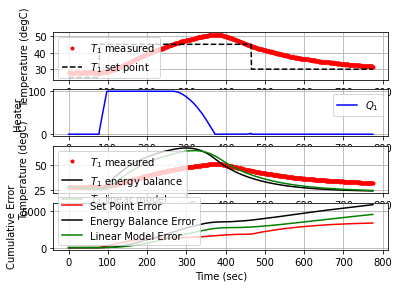

 777.9  30.00  31.43   0.00  -0.29   0.65   0.01


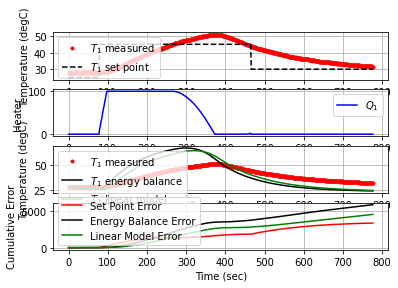

 779.1  30.00  31.62   0.00  -0.33   0.65  -0.01


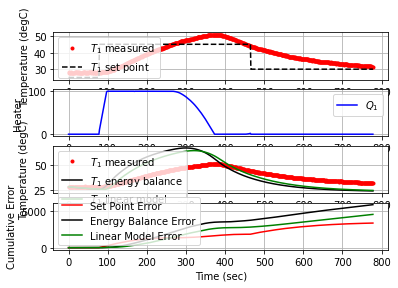

 780.3  30.00  31.52   0.00  -0.31   0.65   0.01


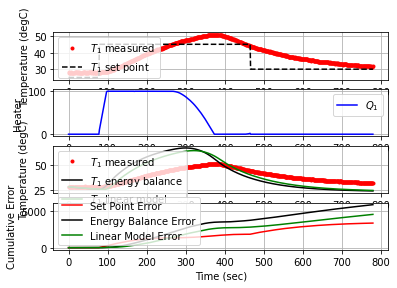

 781.6  30.00  31.48   0.00  -0.30   0.65   0.00


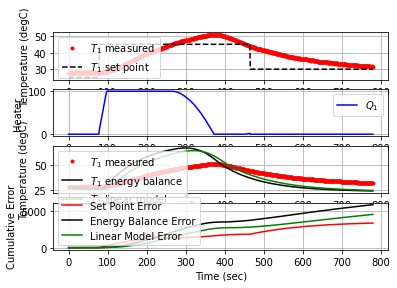

 782.9  30.00  31.37   0.00  -0.28   0.65   0.01


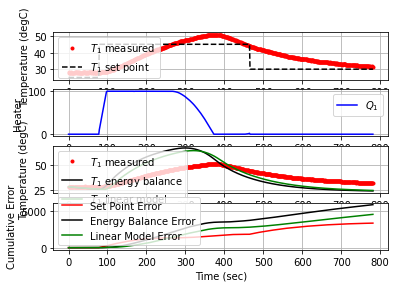

 784.4  30.00  31.35   0.00  -0.28   0.65   0.00


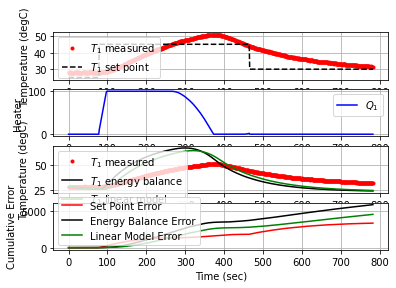

 785.7  30.00  31.36   0.00  -0.28   0.65  -0.00


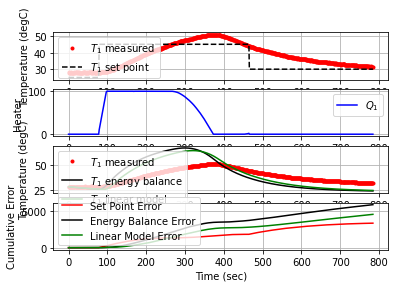

 787.0  30.00  31.40   0.00  -0.28   0.65  -0.00


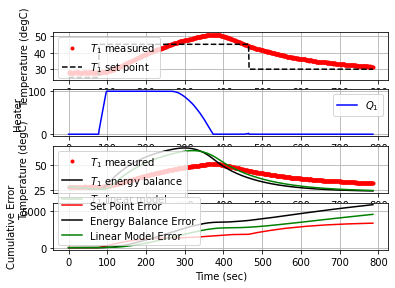

 788.2  30.00  31.43   0.00  -0.29   0.65  -0.00


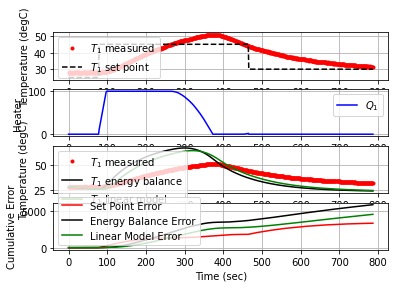

 789.6  30.00  31.42   0.00  -0.29   0.65   0.00


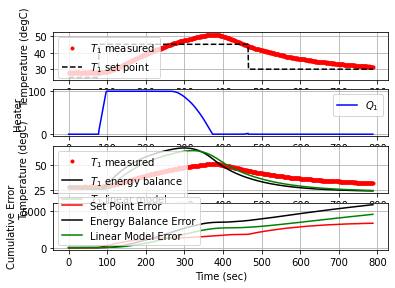

 790.9  30.00  31.45   0.00  -0.30   0.65  -0.00


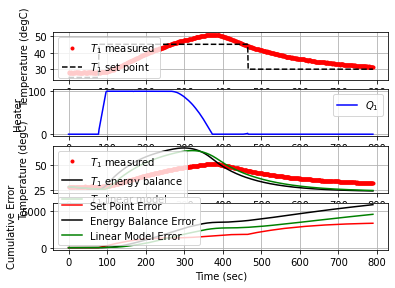

 792.2  30.00  31.57   0.00  -0.32   0.65  -0.01


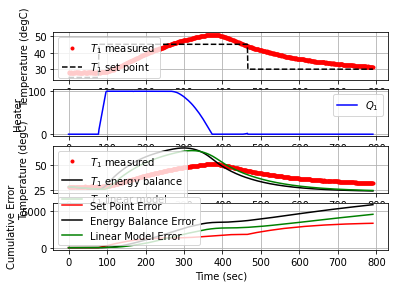

 793.5  30.00  31.21   0.00  -0.25   0.65   0.02


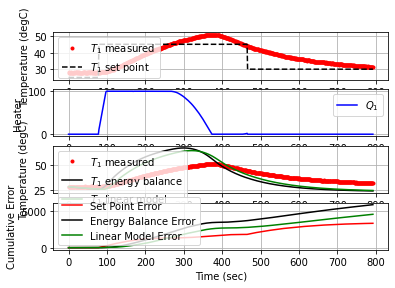

 794.8  30.00  31.29   0.00  -0.26   0.65  -0.00


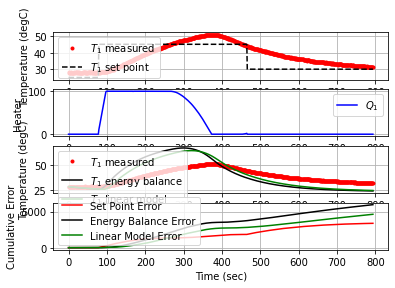

 796.2  30.00  31.34   0.00  -0.27   0.65  -0.00


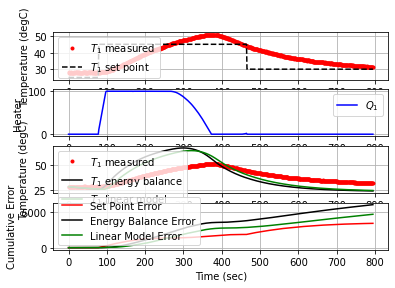

 797.5  30.00  31.44   0.00  -0.29   0.65  -0.01


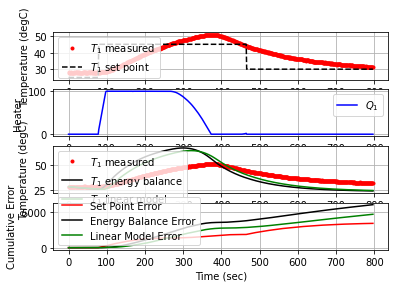

 798.8  30.00  31.33   0.00  -0.27   0.65   0.01


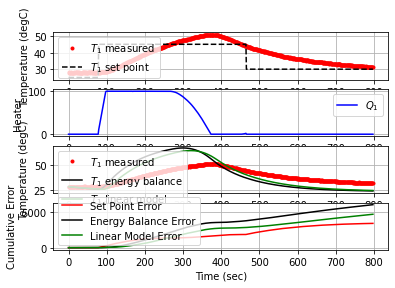

 800.0  30.00  31.18   0.03  -0.24   0.26   0.01


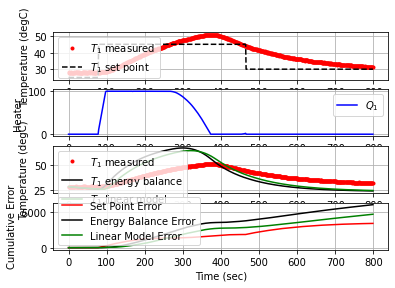

 801.3  30.00  31.31   0.00  -0.27   0.26  -0.01


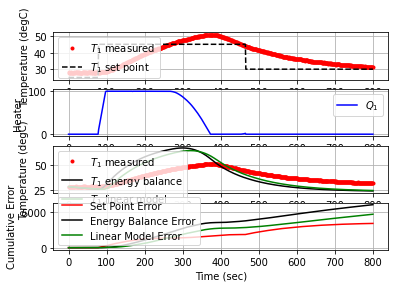

 802.7  30.00  31.43   0.00  -0.29   0.26  -0.01


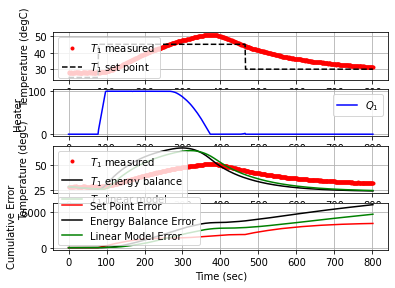

 804.1  30.00  31.27   0.00  -0.26   0.26   0.01


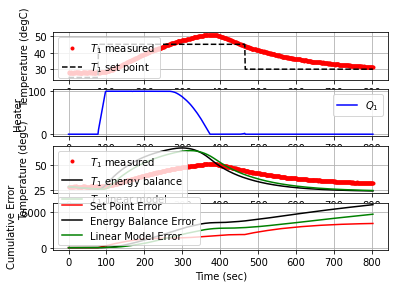

 805.4  30.00  31.30   0.00  -0.26   0.26  -0.00


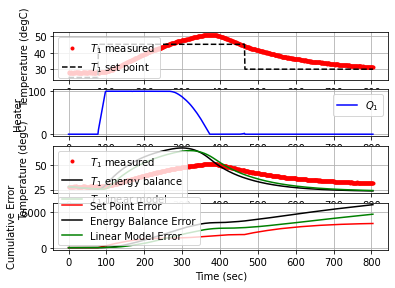

 806.7  30.00  31.25   0.00  -0.26   0.26   0.00


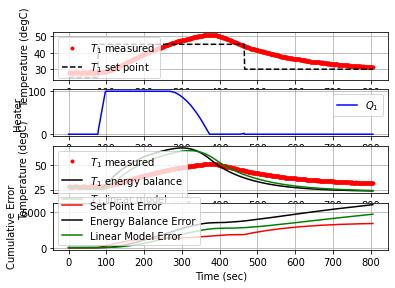

 808.1  30.00  31.18   0.00  -0.24   0.26   0.00


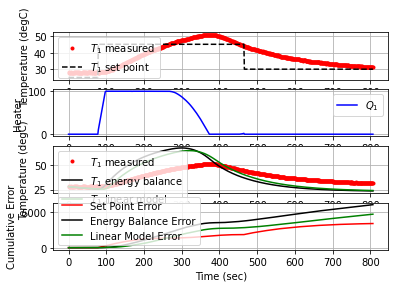

 809.3  30.00  31.02   0.00  -0.21   0.26   0.01


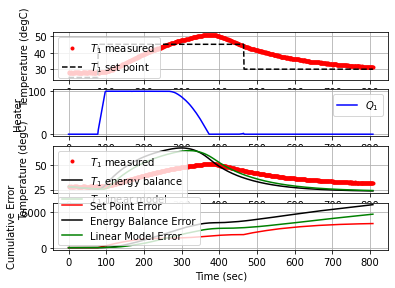

 810.6  30.00  31.29   0.00  -0.26   0.26  -0.02


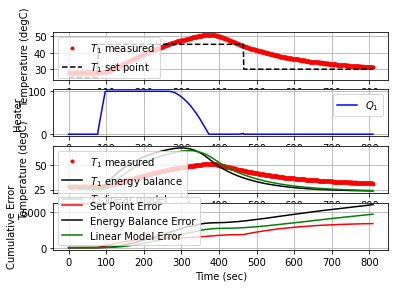

 811.8  30.00  31.12   0.00  -0.23   0.26   0.01


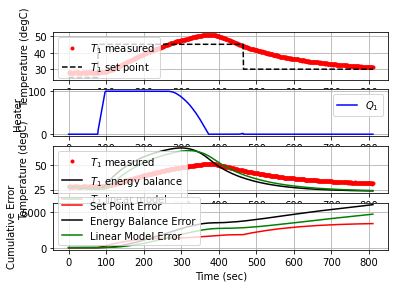

 813.1  30.00  31.14   0.00  -0.23   0.26  -0.00


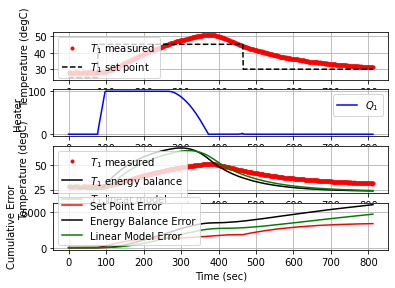

 814.5  30.00  31.06   0.00  -0.22   0.26   0.00


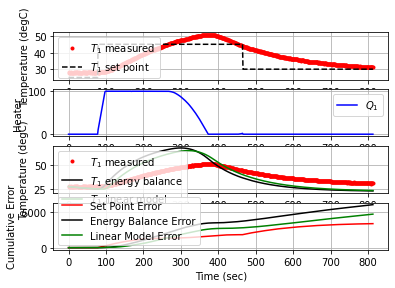

 815.8  30.00  31.05   0.00  -0.21   0.26   0.00


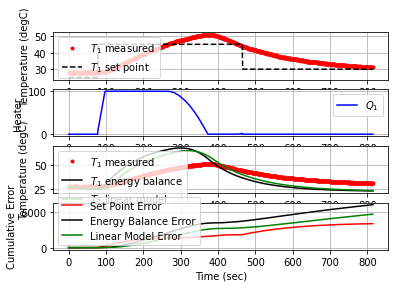

 817.2  30.00  31.01   0.00  -0.21   0.26   0.00


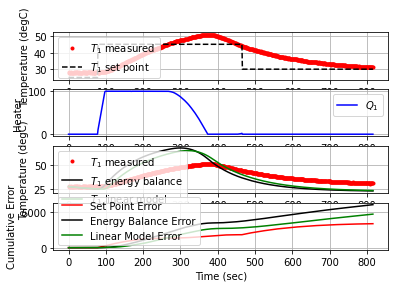

 818.6  30.00  31.07   0.00  -0.22   0.26  -0.00


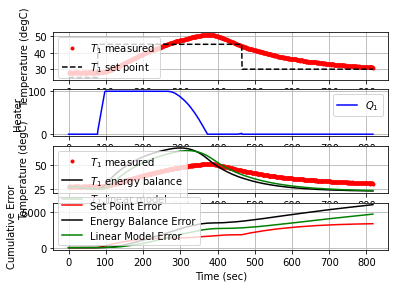

 819.8  30.00  31.03   0.00  -0.21   0.26   0.00


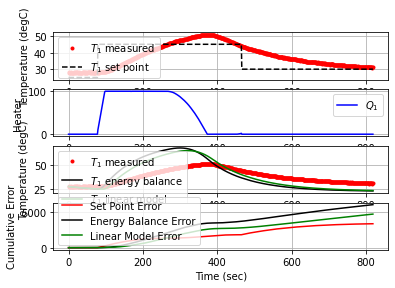

 821.2  30.00  30.98   0.00  -0.20   0.26   0.00


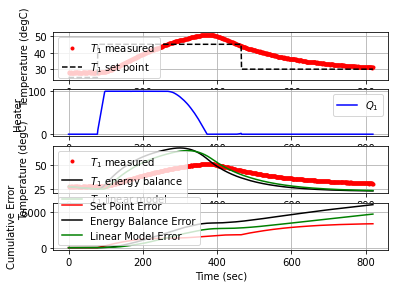

 822.3  30.00  31.03   0.00  -0.21   0.26  -0.00


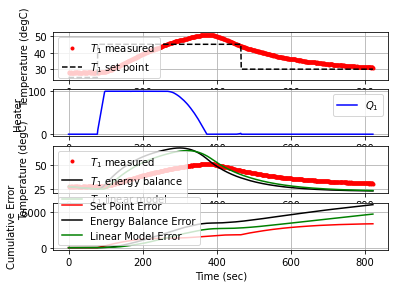

 823.6  30.00  31.07   0.00  -0.22   0.26  -0.00


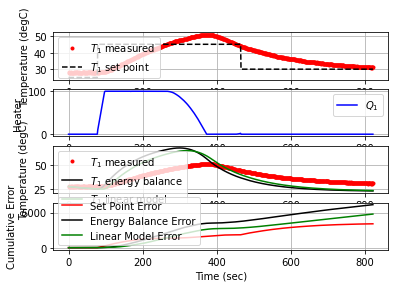

 824.7  30.00  31.04   0.00  -0.21   0.26   0.00


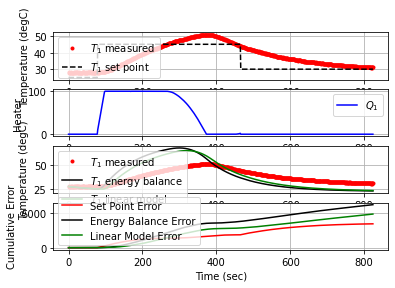

 825.9  30.00  30.96   0.00  -0.20   0.26   0.00


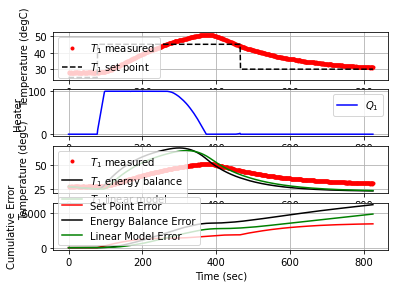

 827.4  30.00  30.87   0.00  -0.18   0.26   0.00


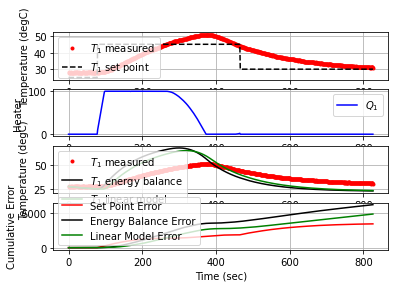

 828.7  30.00  31.02   0.00  -0.21   0.26  -0.01


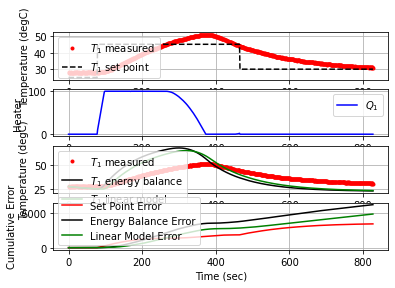

 830.0  30.00  30.99   0.00  -0.20   0.26   0.00


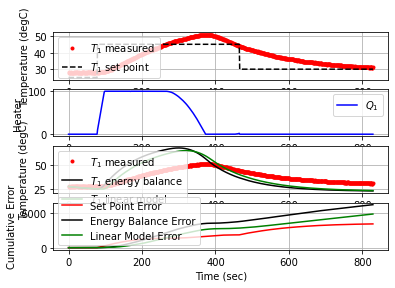

 831.2  30.00  30.89   0.00  -0.18   0.26   0.01


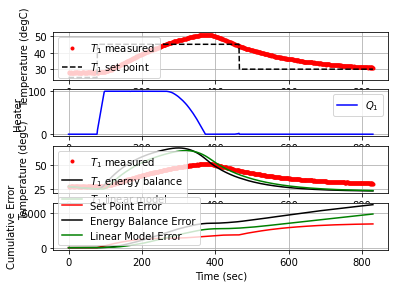

 832.5  30.00  30.90   0.00  -0.18   0.26  -0.00


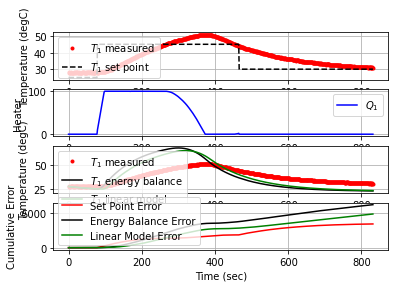

 833.8  30.00  30.81   0.00  -0.17   0.26   0.00


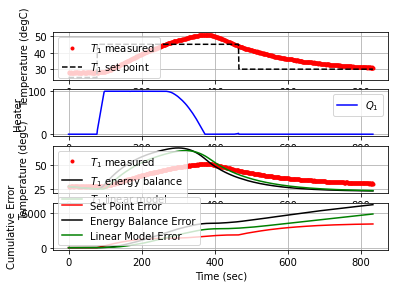

 835.0  30.00  30.90   0.00  -0.18   0.26  -0.01


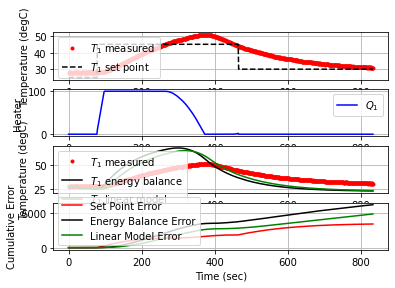

 836.2  30.00  30.79   0.00  -0.16   0.26   0.01


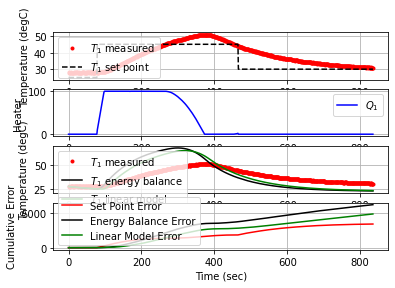

 837.4  30.00  30.90   0.00  -0.18   0.26  -0.01


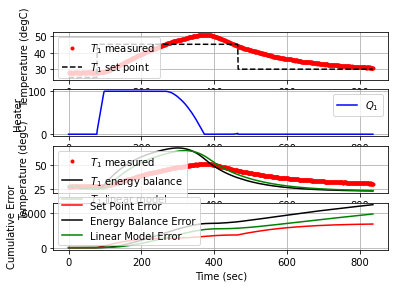

 838.5  30.00  30.81   0.00  -0.17   0.26   0.01


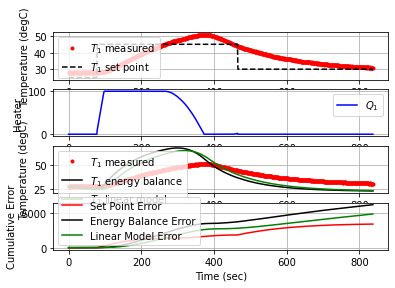

 839.7  30.00  30.75   0.00  -0.15   0.26   0.00


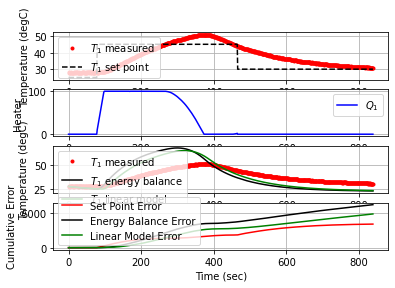

 841.1  30.00  30.71   0.00  -0.15   0.26   0.00


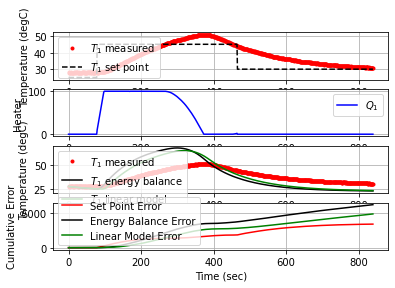

 842.2  30.00  30.82   0.00  -0.17   0.26  -0.01


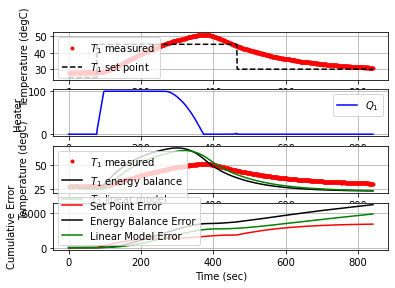

 843.5  30.00  30.86   0.00  -0.18   0.26  -0.00


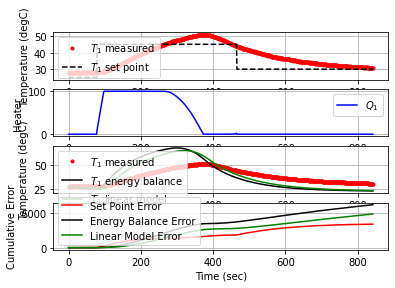

 844.7  30.00  30.62   0.00  -0.13   0.26   0.02


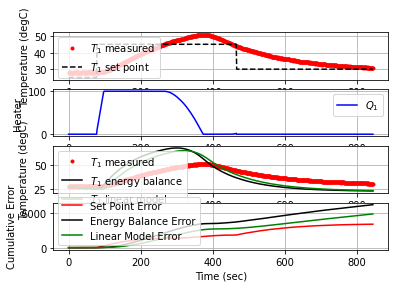

 845.9  30.00  30.54   0.00  -0.11   0.26   0.00


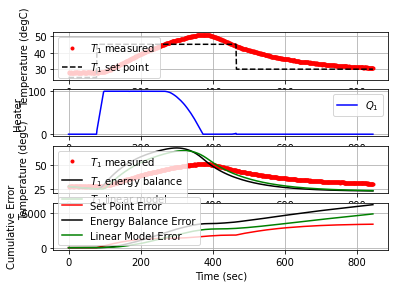

 847.3  30.00  30.78   0.00  -0.16   0.26  -0.01


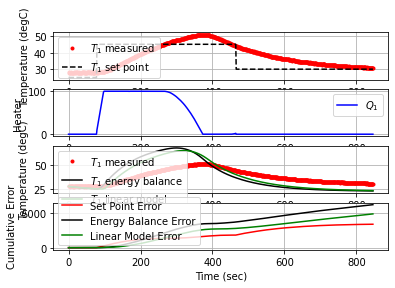

 848.8  30.00  30.69   0.00  -0.14   0.26   0.00


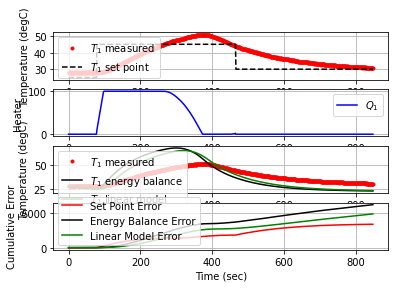

 850.1  30.00  30.67   0.00  -0.14   0.26   0.00


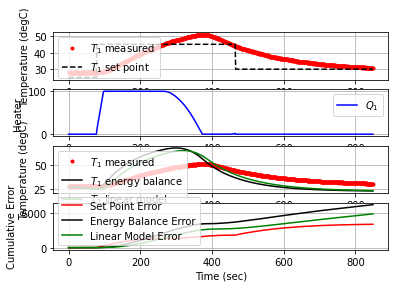

 851.4  35.00  30.76   2.77   0.94   1.84  -0.01


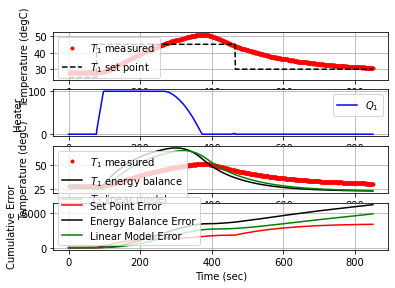

 852.6  35.00  30.68   4.39   0.96   3.43   0.01


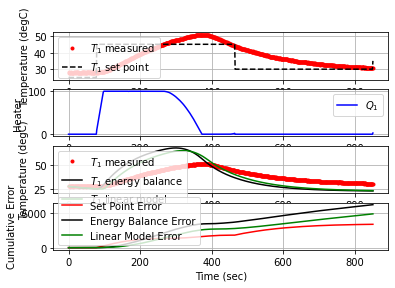

 853.9  35.00  30.65   5.95   0.96   4.99   0.00


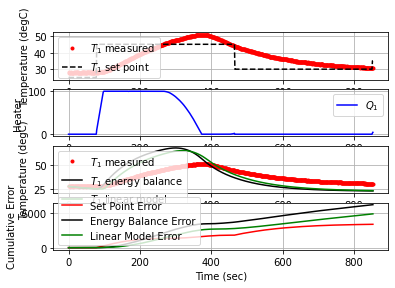

 855.1  35.00  30.73   7.46   0.95   6.52  -0.01


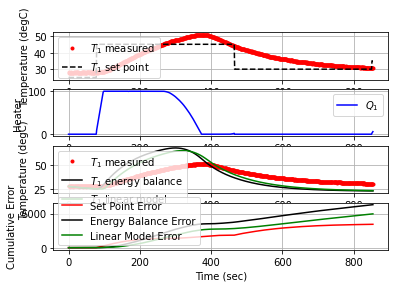

 856.3  35.00  30.68   8.94   0.96   7.98   0.00


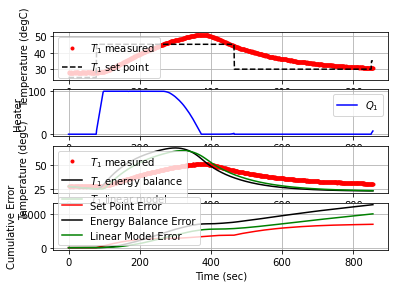

 857.5  35.00  30.61  10.45   0.97   9.48   0.01


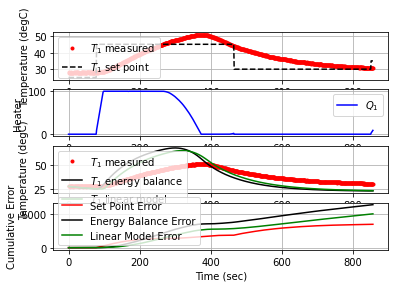

 858.7  35.00  30.52  11.98   0.99  10.98   0.01


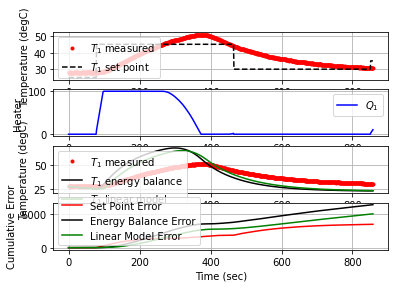

 859.8  35.00  30.37  13.57   1.03  12.54   0.01


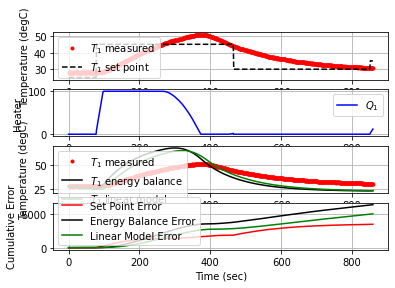

 861.1  35.00  30.65  15.04   0.96  14.10  -0.02


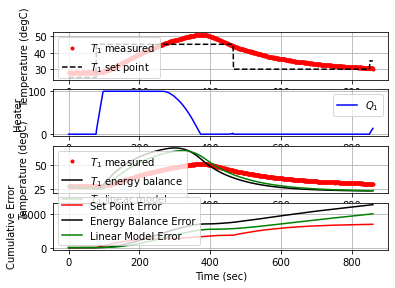

 862.3  35.00  30.52  16.62   0.99  15.62   0.01


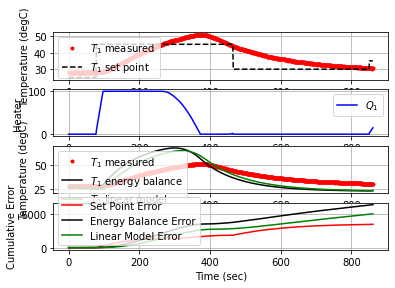

 863.5  35.00  30.65  18.15   0.96  17.20  -0.01


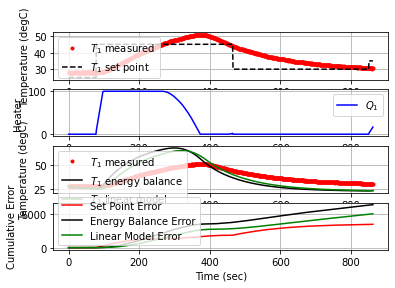

 864.8  35.00  30.52  19.81   0.99  18.81   0.01


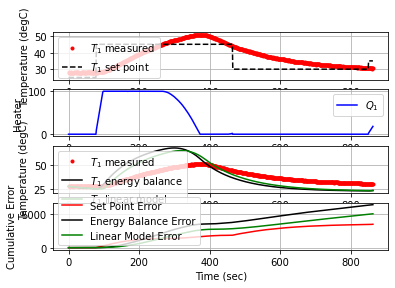

 866.0  35.00  30.78  21.23   0.93  20.32  -0.02


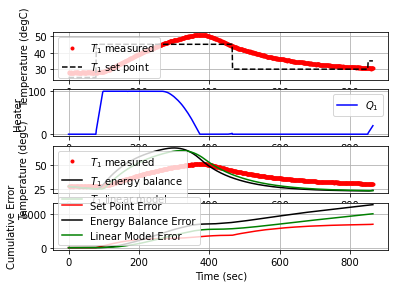

 867.3  35.00  30.62  22.86   0.97  21.88   0.01


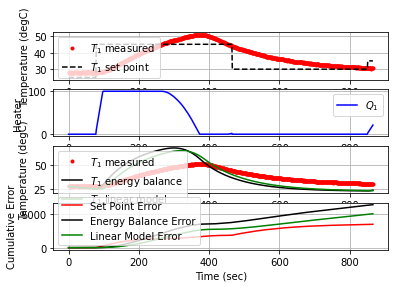

 868.6  35.00  30.65  24.50   0.96  23.54  -0.00


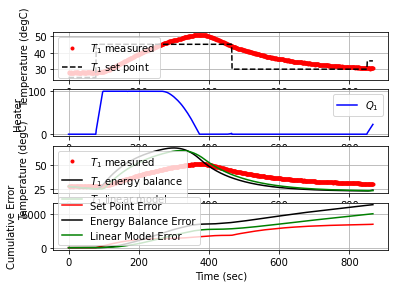

 869.9  35.00  30.68  26.08   0.96  25.12  -0.00


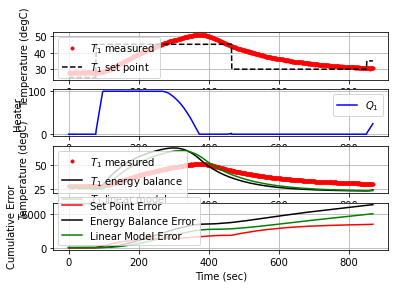

 871.1  35.00  30.70  27.60   0.95  26.64  -0.00


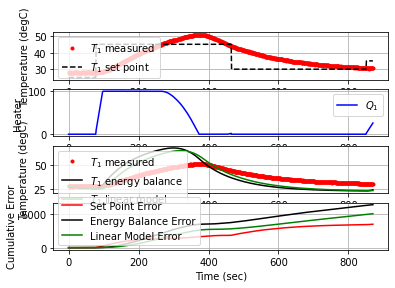

 872.4  35.00  30.78  29.18   0.93  28.25  -0.01


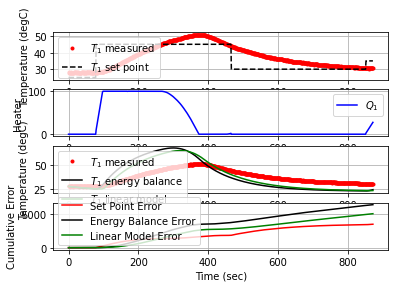

 873.7  35.00  30.72  30.74   0.95  29.78   0.00


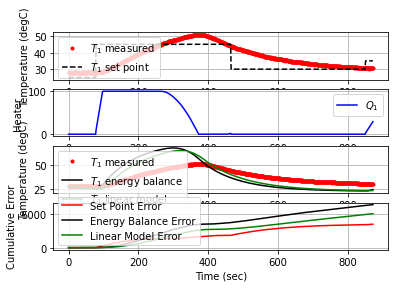

 875.1  35.00  30.76  32.41   0.94  31.47  -0.00


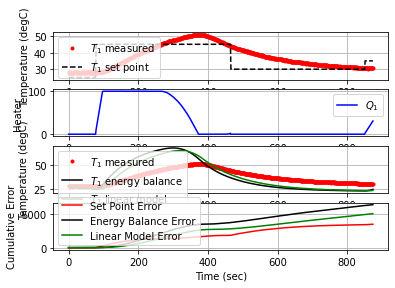

 876.4  35.00  30.93  33.86   0.90  32.97  -0.01


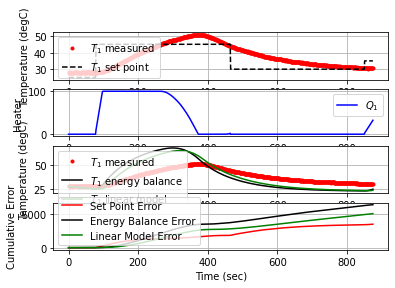

 877.6  35.00  30.97  35.32   0.89  34.43  -0.00


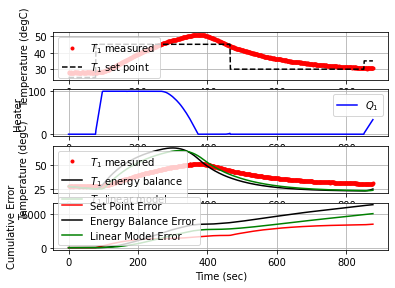

 878.8  35.00  31.09  36.66   0.87  35.80  -0.01


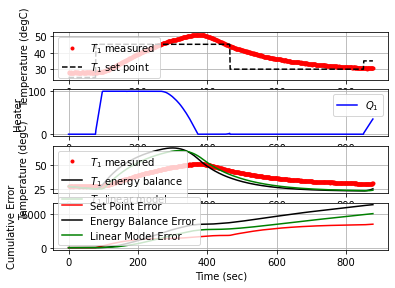

 880.0  35.00  30.97  38.07   0.89  37.17   0.01


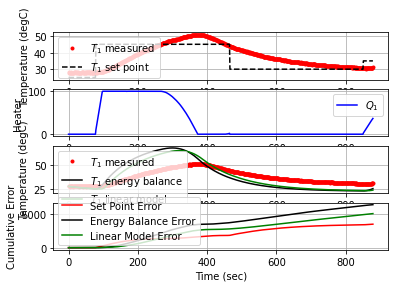

 881.2  35.00  31.11  39.36   0.86  38.51  -0.01


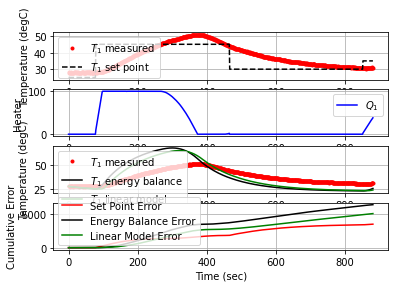

 882.6  35.00  31.31  40.77   0.82  39.97  -0.01


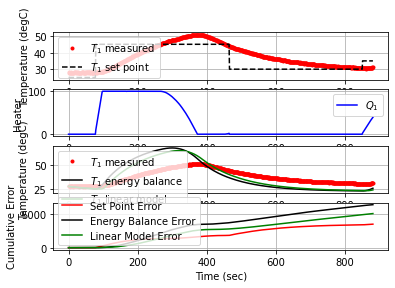

 883.9  35.00  31.26  42.22   0.83  41.39   0.00


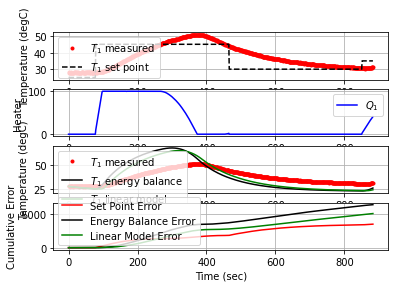

 885.1  35.00  31.37  43.37   0.80  42.58  -0.01


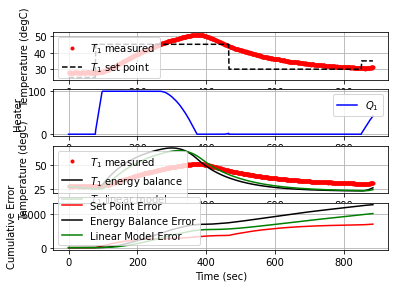

 886.3  35.00  31.40  44.61   0.80  43.81  -0.00


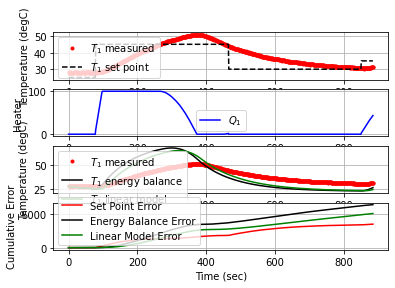

 887.5  35.00  31.46  45.83   0.78  45.05  -0.00


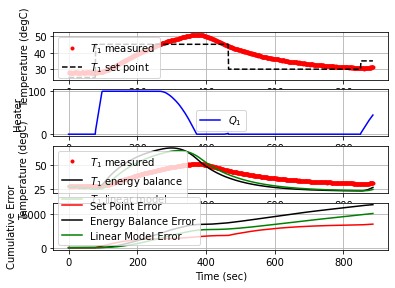

 888.8  35.00  31.60  47.13   0.75  46.39  -0.01


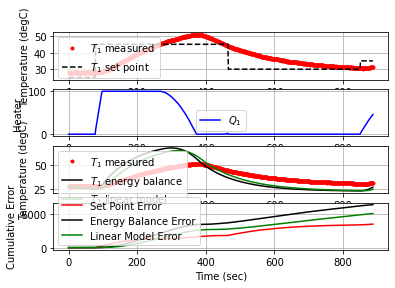

 890.0  35.00  31.70  48.25   0.73  47.53  -0.01


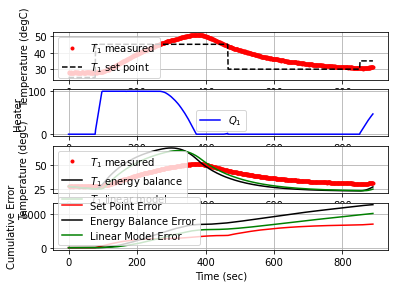

 891.2  35.00  31.68  49.41   0.73  48.67   0.00


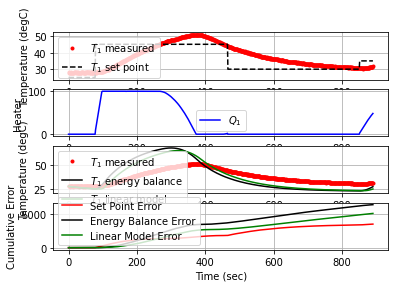

 892.4  35.00  31.72  50.52   0.73  49.80  -0.00


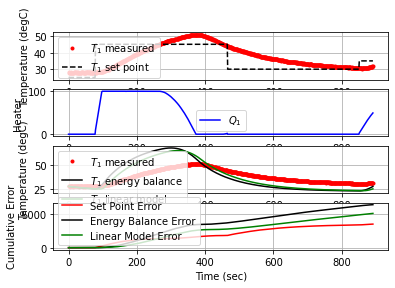

 893.7  35.00  32.11  51.46   0.64  50.85  -0.03


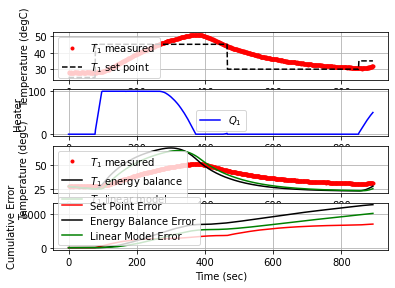

 894.9  35.00  31.87  52.63   0.69  51.92   0.02


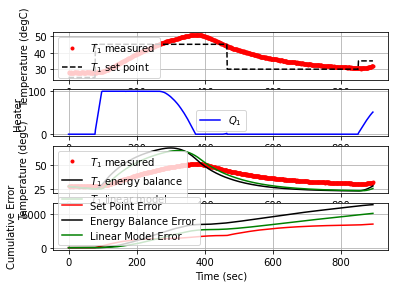

 896.3  35.00  32.12  53.65   0.64  53.03  -0.02


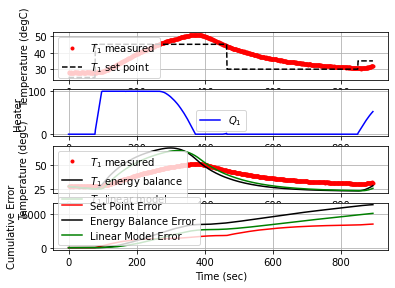

 897.5  35.00  32.32  54.57   0.59  54.00  -0.01


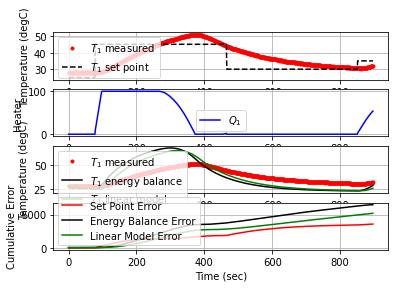

 898.7  35.00  32.39  55.43   0.58  54.86  -0.01


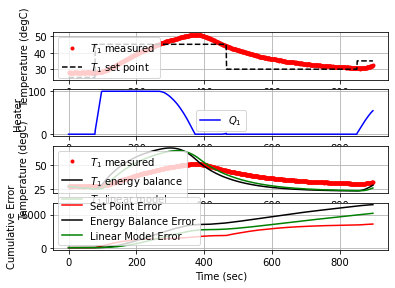

 899.8  35.00  32.42  56.25   0.57  55.69  -0.00


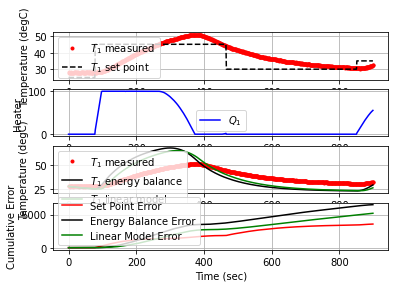

 900.9  35.00  32.72  56.91   0.50  56.43  -0.02


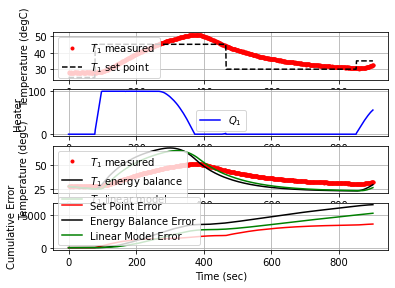

 902.1  35.00  32.67  57.75   0.51  57.24   0.00


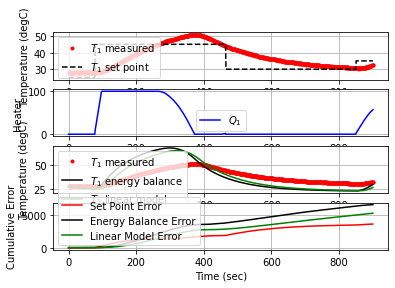

 903.6  35.00  32.86  58.60   0.47  58.14  -0.01


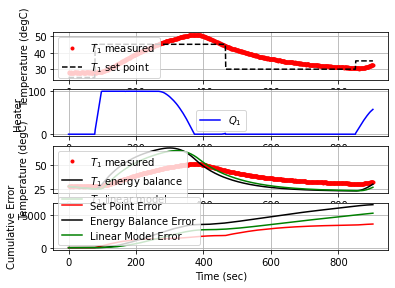

 904.7  35.00  32.85  59.30   0.47  58.83   0.00


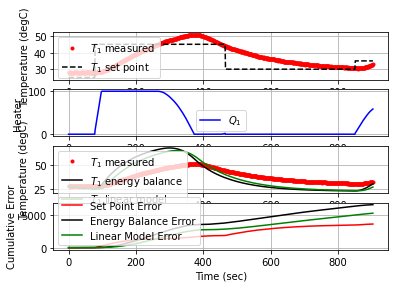

 905.9  35.00  33.05  59.87   0.43  59.46  -0.01


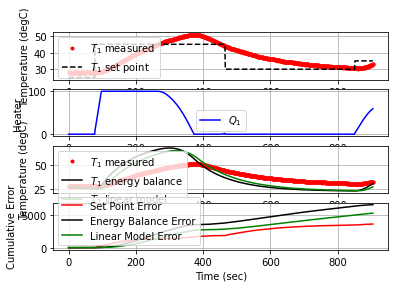

 907.0  35.00  33.26  60.39   0.38  60.02  -0.02


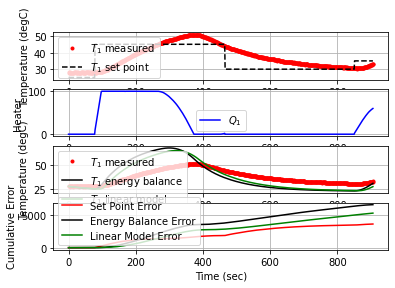

 908.2  35.00  33.37  60.91   0.36  60.56  -0.01


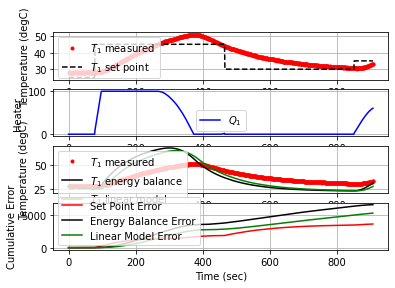

 909.5  35.00  33.61  61.37   0.30  61.08  -0.01


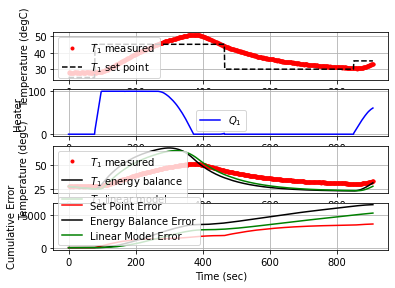

 910.7  35.00  33.83  61.72   0.25  61.48  -0.02


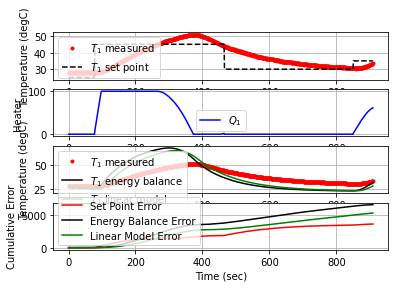

 911.9  35.00  33.73  62.20   0.28  61.91   0.01


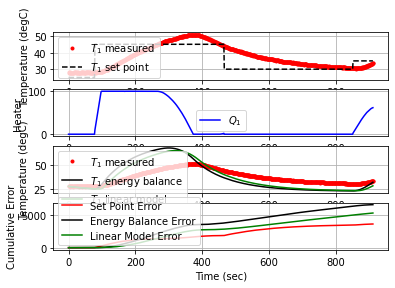

 913.3  35.00  34.08  62.45   0.20  62.27  -0.02


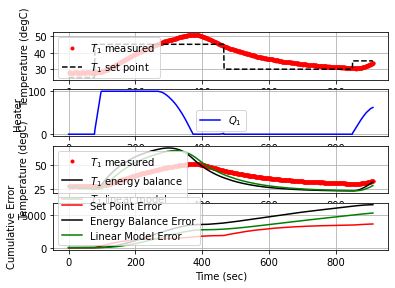

 914.5  35.00  34.14  62.74   0.19  62.56  -0.00


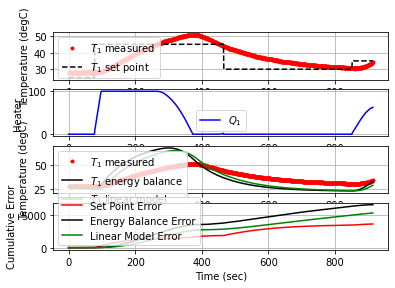

 915.9  35.00  34.27  62.98   0.16  62.84  -0.01


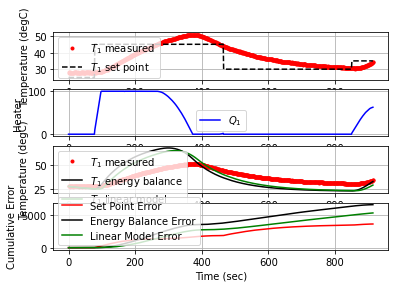

 917.1  35.00  34.32  63.21   0.15  63.06  -0.00


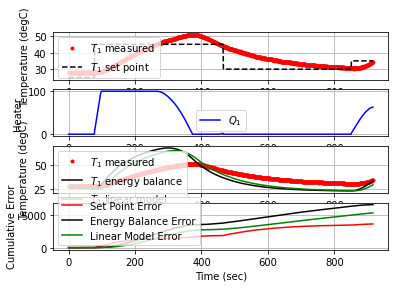

 918.4  35.00  34.38  63.42   0.13  63.29  -0.00


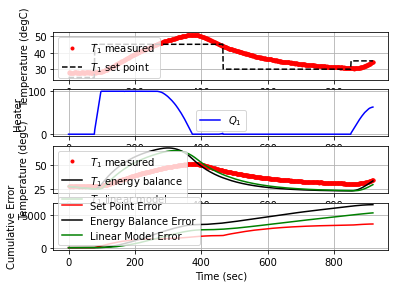

 919.5  35.00  34.64  63.46   0.08  63.40  -0.02


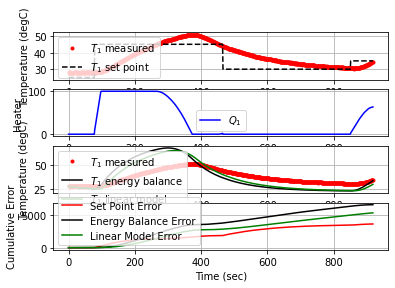

 920.7  35.00  34.75  63.53   0.05  63.48  -0.01


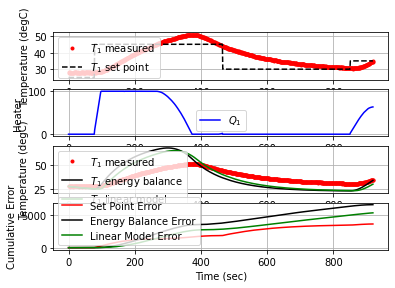

 921.9  35.00  34.86  63.55   0.03  63.53  -0.01


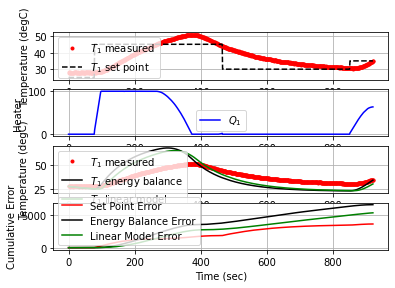

 923.3  35.00  35.05  63.49  -0.01  63.51  -0.01


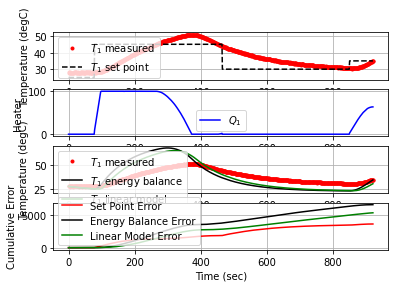

 924.5  35.00  35.09  63.46  -0.02  63.48  -0.00


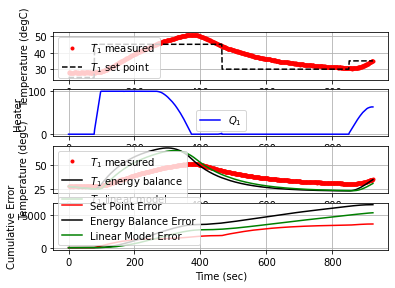

 925.7  35.00  35.20  63.37  -0.04  63.41  -0.01


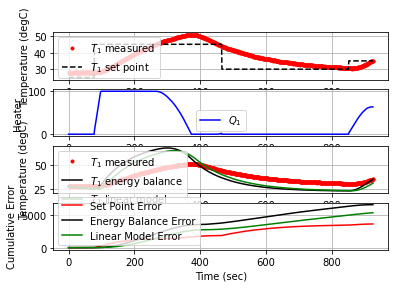

 926.9  35.00  35.33  63.24  -0.07  63.31  -0.01


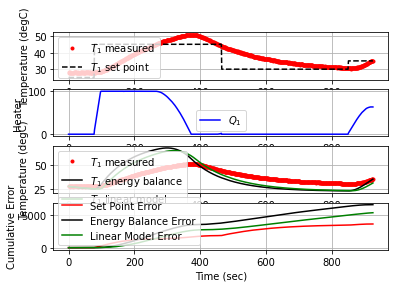

 928.0  35.00  35.47  63.06  -0.10  63.17  -0.01


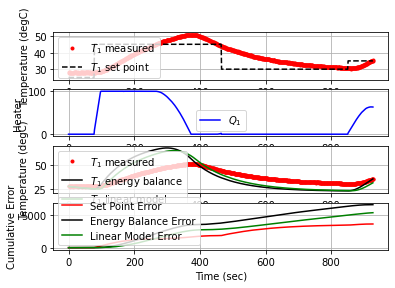

 929.2  35.00  35.77  62.74  -0.16  62.92  -0.02


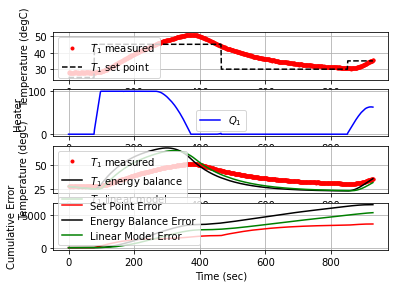

 930.6  35.00  35.73  62.49  -0.15  62.64   0.00


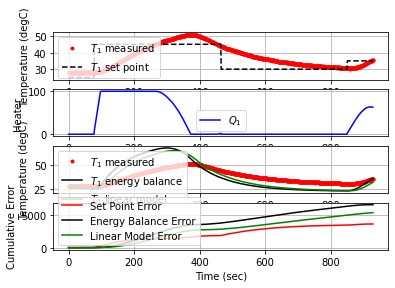

 931.9  35.00  35.86  62.16  -0.18  62.35  -0.01


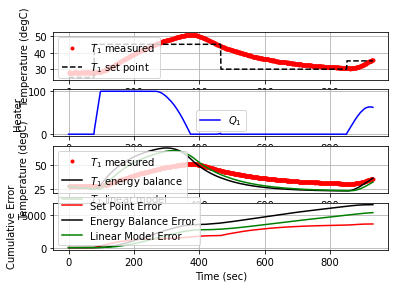

 933.1  35.00  36.06  61.76  -0.22  61.99  -0.01


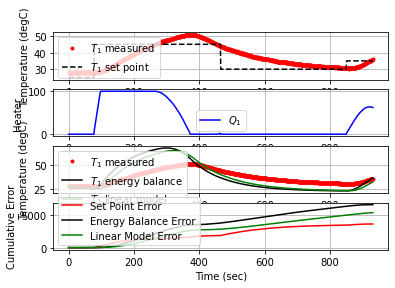

 934.2  35.00  36.13  61.40  -0.23  61.64  -0.00


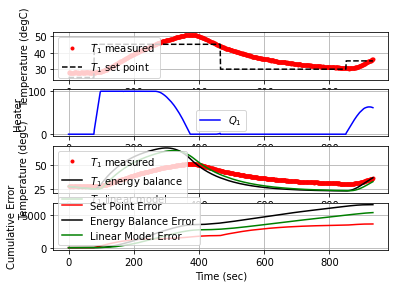

 935.4  35.00  36.37  60.90  -0.28  61.19  -0.01


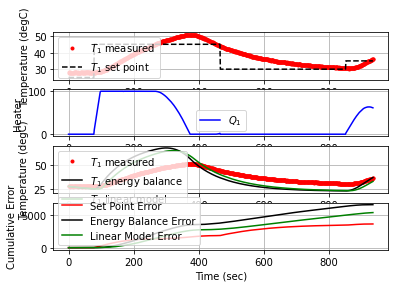

 936.8  35.00  36.51  60.31  -0.31  60.62  -0.01


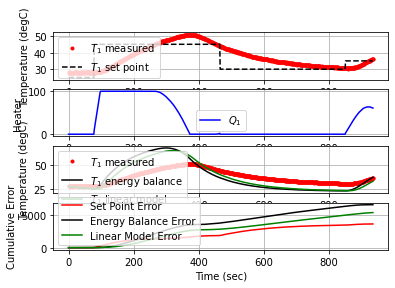

 938.0  35.00  36.69  59.72  -0.34  60.08  -0.01


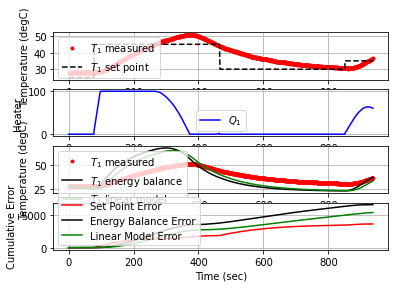

 939.2  35.00  36.79  59.12  -0.36  59.49  -0.01


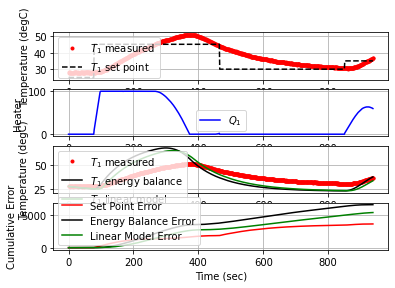

 940.5  35.00  37.05  58.36  -0.41  58.79  -0.01


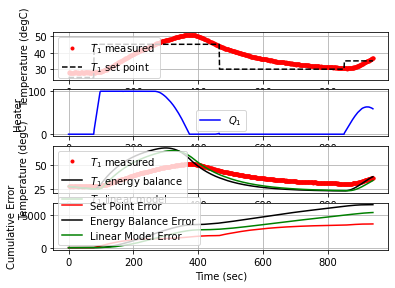

 941.7  35.00  37.00  57.73  -0.41  58.13   0.00


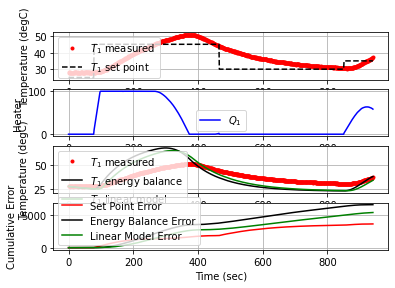

 943.1  35.00  37.30  56.78  -0.47  57.26  -0.01


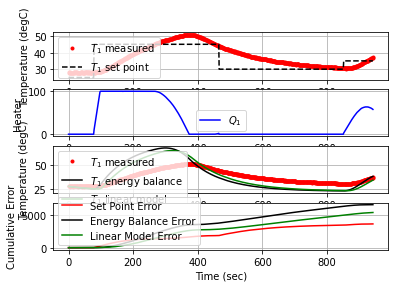

 944.2  35.00  37.14  56.19  -0.43  56.61   0.01


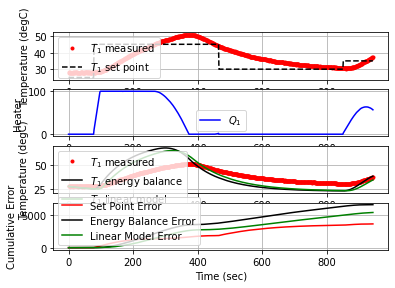

 945.4  35.00  37.45  55.34  -0.50  55.86  -0.02


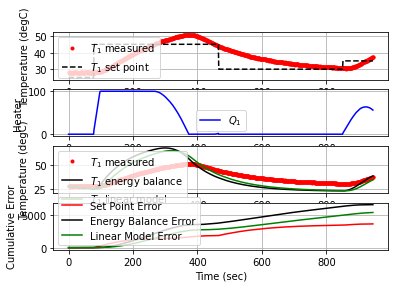

 946.5  35.00  37.63  54.49  -0.53  55.03  -0.01


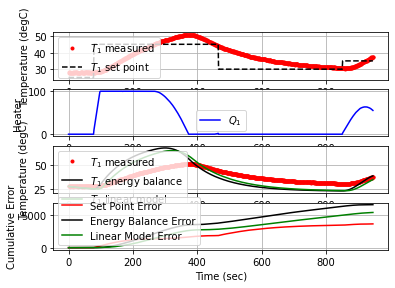

 947.7  35.00  37.65  53.69  -0.54  54.23  -0.00


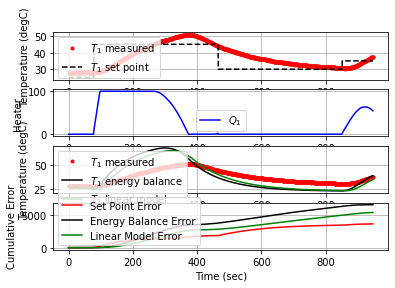

 948.9  35.00  37.87  52.70  -0.58  53.30  -0.01


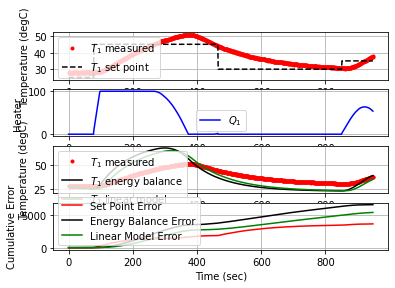

 950.2  35.00  37.83  51.73  -0.57  52.30   0.00


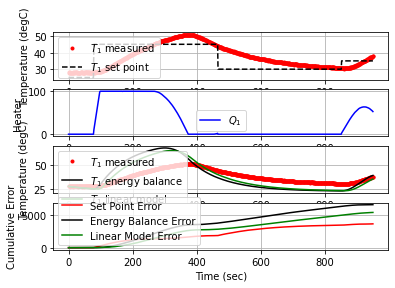

 951.3  35.00  38.16  50.65  -0.64  51.30  -0.02


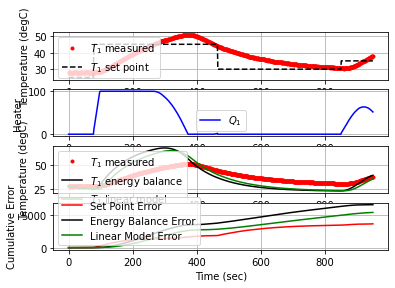

 952.6  35.00  38.09  49.65  -0.62  50.28   0.00


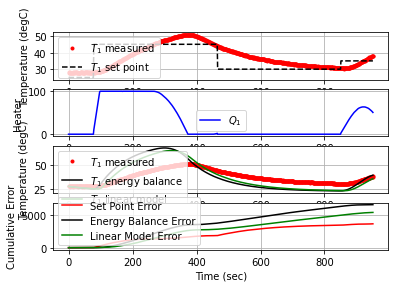

 953.8  35.00  38.32  48.51  -0.67  49.19  -0.01


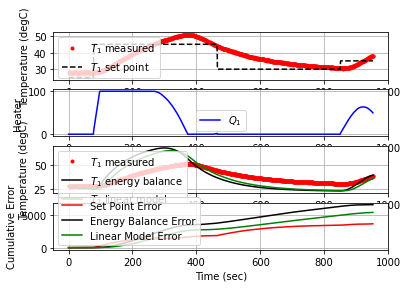

 955.0  35.00  38.41  47.32  -0.69  48.01  -0.00


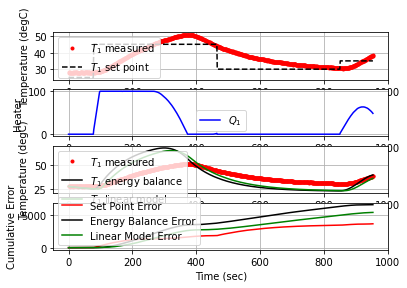

 956.4  35.00  38.60  45.94  -0.73  46.68  -0.01


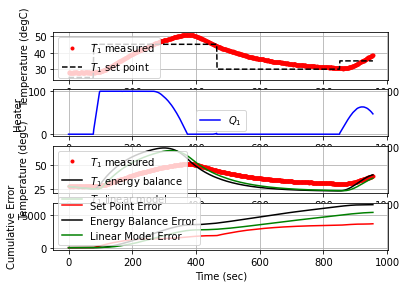

 957.7  35.00  38.58  44.75  -0.72  45.47   0.00


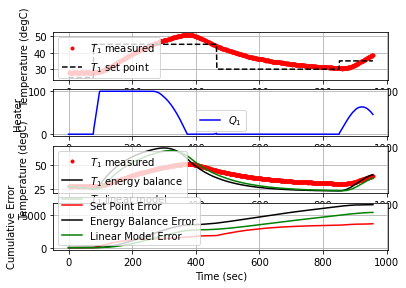

 958.9  35.00  38.73  43.42  -0.75  44.18  -0.01


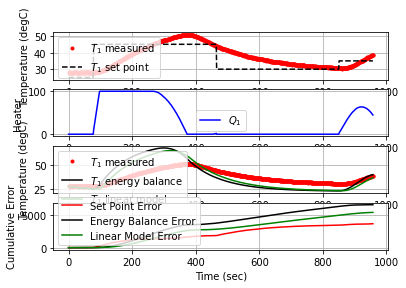

 960.2  35.00  38.90  42.07  -0.79  42.86  -0.01


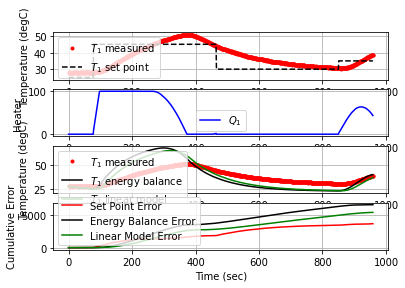

 961.4  35.00  39.03  40.72  -0.81  41.54  -0.01


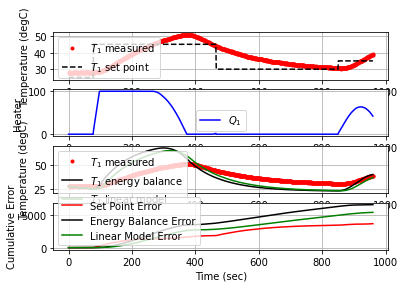

 962.6  35.00  39.24  39.26  -0.86  40.12  -0.01


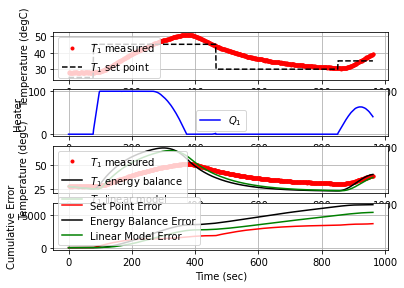

 964.0  35.00  39.38  37.66  -0.88  38.55  -0.01


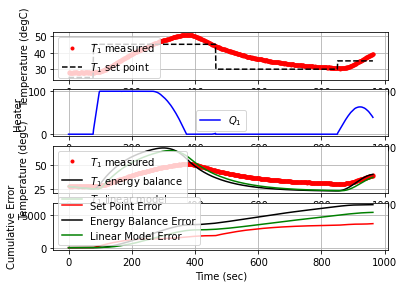

 965.1  35.00  39.34  36.32  -0.88  37.20   0.00


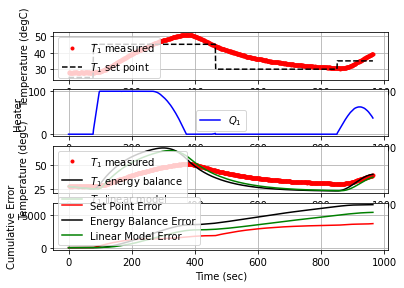

 966.4  35.00  39.52  34.71  -0.91  35.63  -0.01


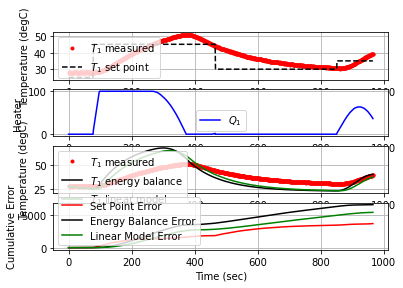

 967.9  35.00  39.58  32.89  -0.92  33.82  -0.00


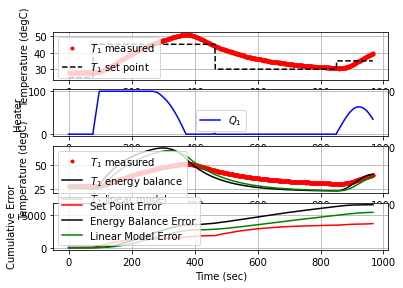

 969.3  35.00  39.67  31.09  -0.94  32.04  -0.00


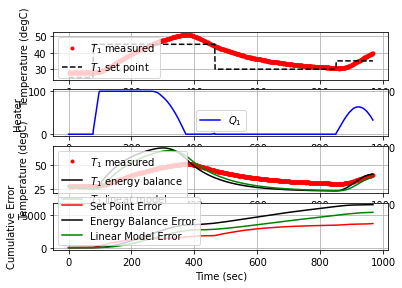

 970.7  35.00  39.99  29.06  -1.01  30.08  -0.02


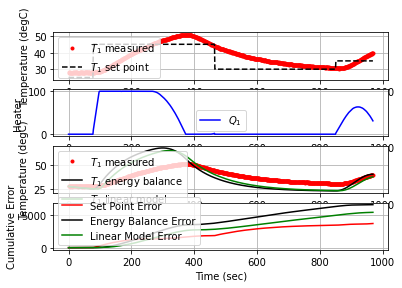

 971.9  35.00  40.08  27.42  -1.03  28.45  -0.01


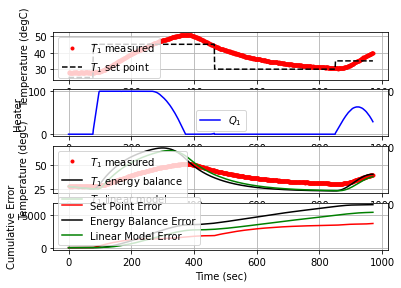

 973.4  35.00  40.21  25.28  -1.05  26.34  -0.01


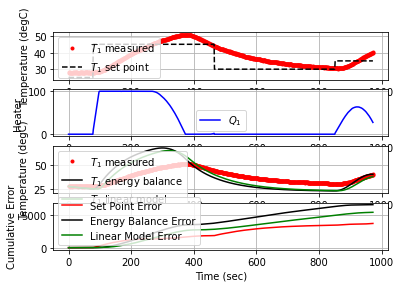

 974.6  35.00  40.30  23.52  -1.07  24.60  -0.01


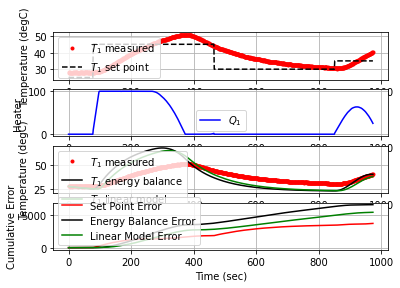

 975.9  35.00  40.48  21.63  -1.11  22.75  -0.01


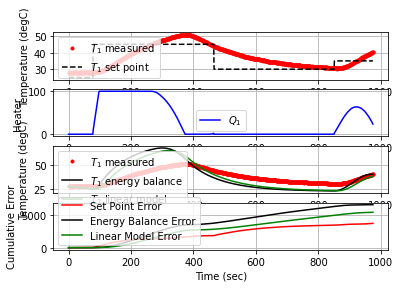

 977.1  35.00  40.51  19.77  -1.11  20.89  -0.00


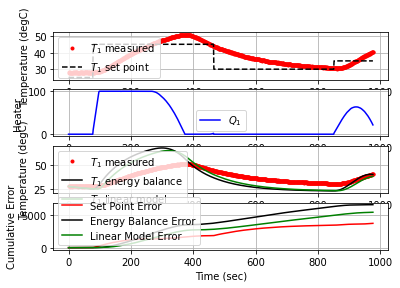

 978.4  35.00  40.72  17.69  -1.15  18.86  -0.01


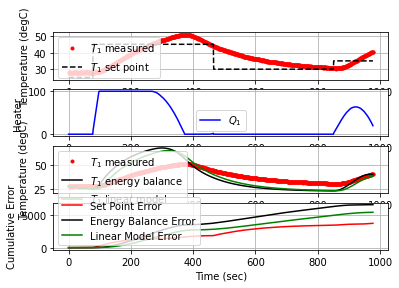

 979.6  35.00  40.69  15.91  -1.15  17.06   0.00


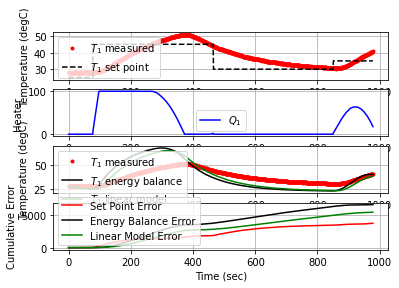

 980.9  35.00  40.92  13.78  -1.19  14.99  -0.01


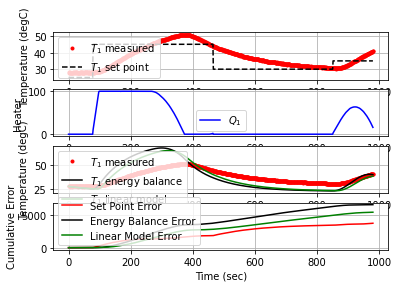

 982.1  35.00  41.05  11.72  -1.22  12.95  -0.01


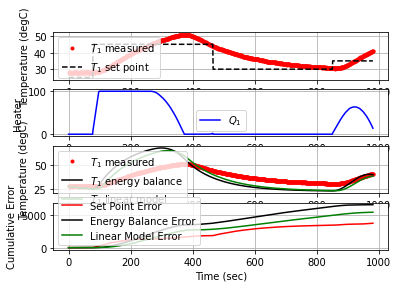

 983.5  35.00  41.23   9.36  -1.26  10.63  -0.01


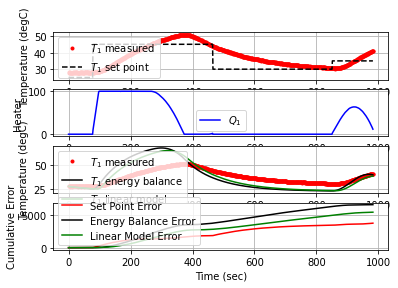

 984.8  35.00  41.32   7.14  -1.28   8.42  -0.00


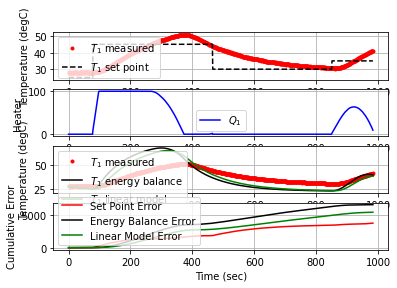

 986.0  35.00  41.35   5.01  -1.28   6.29  -0.00


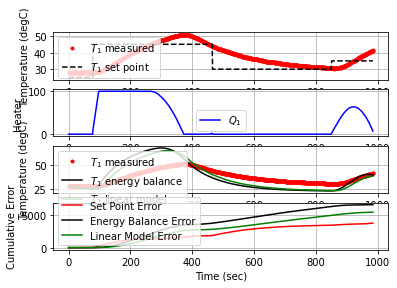

 987.3  35.00  41.61   2.74  -1.33   4.09  -0.01


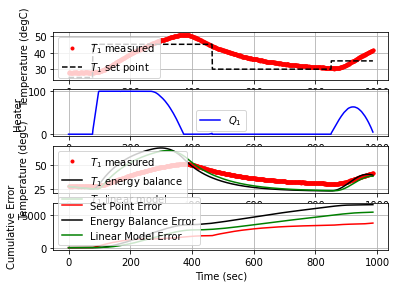

 988.5  35.00  41.68   0.49  -1.35   1.84  -0.00


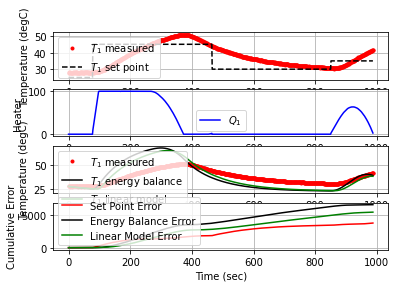

 989.7  35.00  41.70   0.00  -1.35   1.84  -0.00


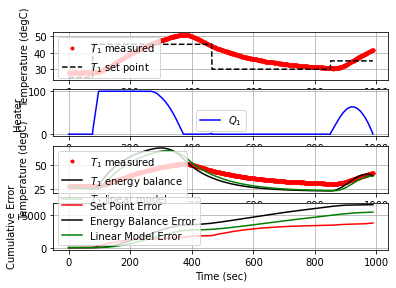

 990.9  35.00  41.83   0.00  -1.38   1.84  -0.01


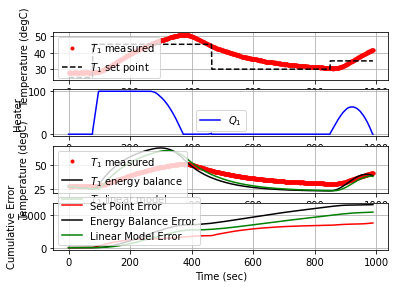

 992.3  35.00  41.83   0.00  -1.38   1.84  -0.00


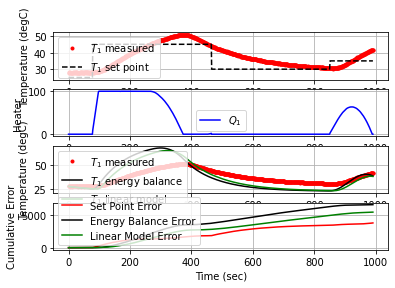

 993.7  35.00  41.87   0.00  -1.39   1.84  -0.00


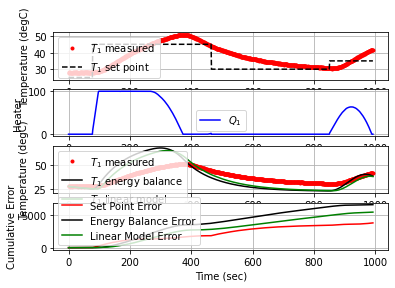

 994.9  35.00  41.96   0.00  -1.40   1.84  -0.01


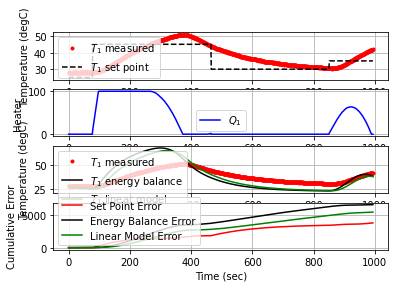

 996.2  35.00  41.98   0.00  -1.41   1.84  -0.00


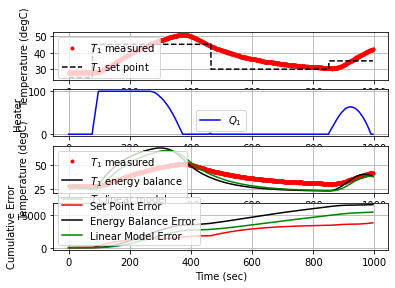

 997.4  35.00  41.94   0.00  -1.40   1.84   0.00


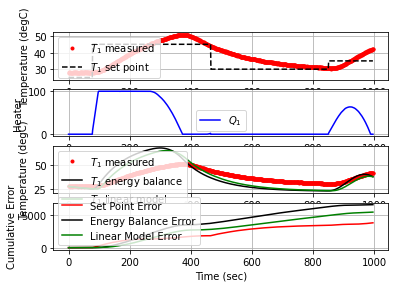

 998.9  35.00  42.05   0.00  -1.42   1.84  -0.01


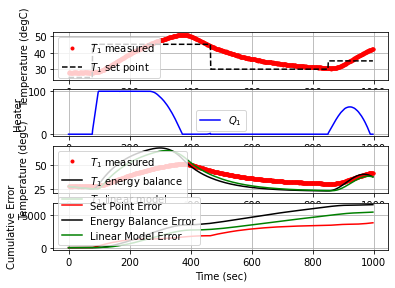

1000.2  35.00  42.12   0.00  -1.44   1.84  -0.00


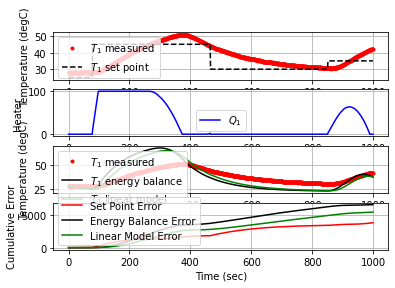

1001.4  35.00  42.08   0.00  -1.43   1.84   0.00


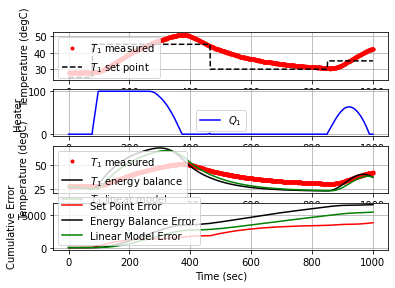

1002.6  35.00  42.22   0.00  -1.46   1.84  -0.01


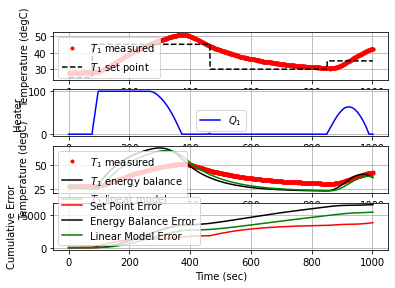

1003.8  35.00  42.33   0.00  -1.48   1.84  -0.01


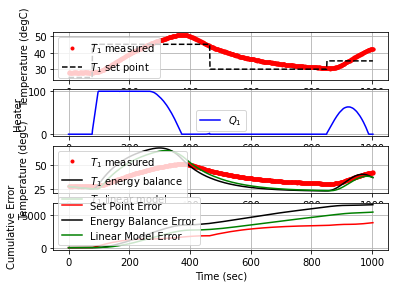

1005.0  35.00  42.23   0.00  -1.46   1.84   0.01


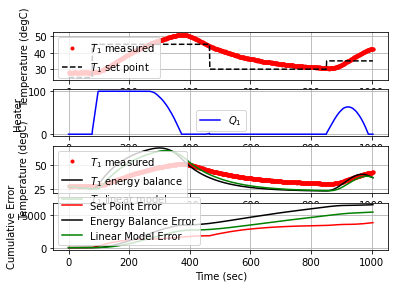

1006.3  35.00  42.26   0.00  -1.47   1.84  -0.00


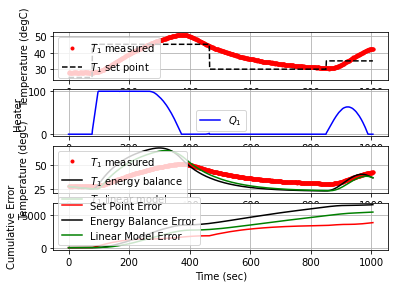

1007.6  35.00  42.41   0.00  -1.50   1.84  -0.01


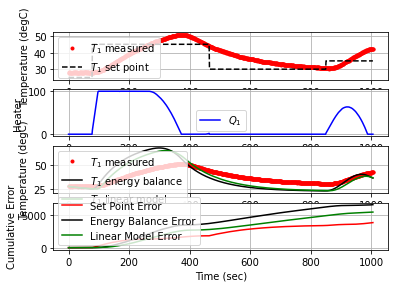

1008.8  35.00  42.26   0.00  -1.47   1.84   0.01


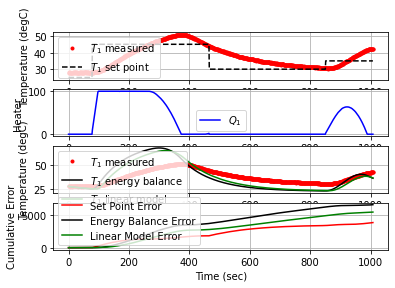

1010.1  35.00  42.16   0.00  -1.45   1.84   0.01


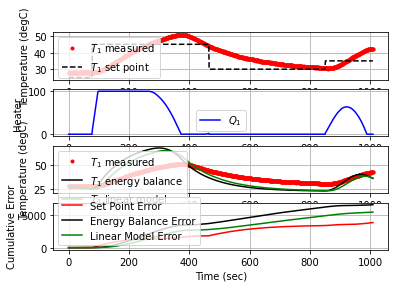

1011.3  35.00  42.13   0.00  -1.44   1.84   0.00


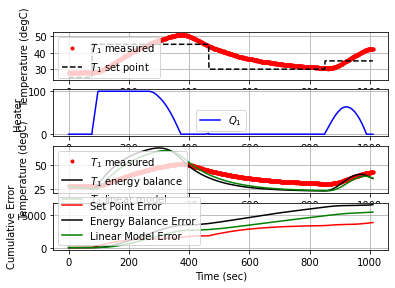

1012.6  35.00  42.12   0.00  -1.44   1.84   0.00


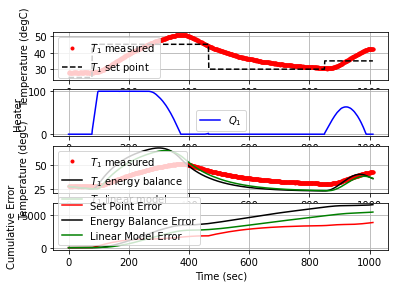

1013.8  35.00  42.15   0.00  -1.44   1.84  -0.00


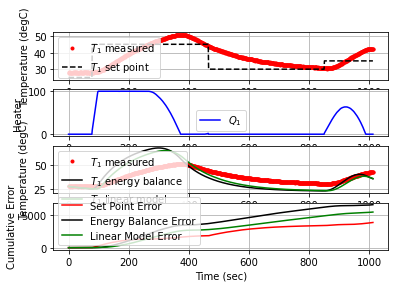

1015.1  35.00  42.02   0.00  -1.42   1.84   0.01


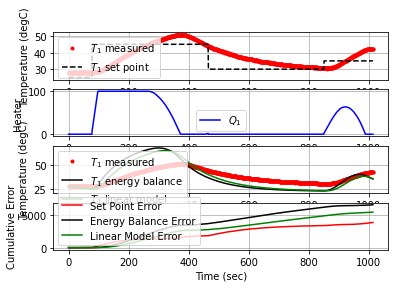

1016.3  35.00  41.98   0.00  -1.41   1.84   0.00


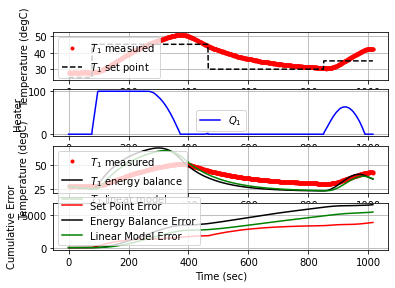

1017.6  35.00  41.88   0.00  -1.39   1.84   0.01


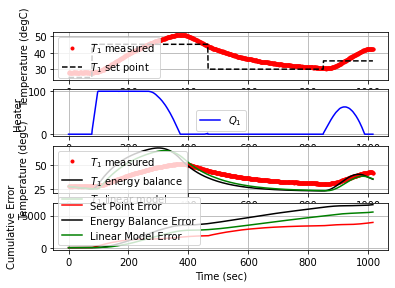

1018.8  35.00  41.94   0.00  -1.40   1.84  -0.00


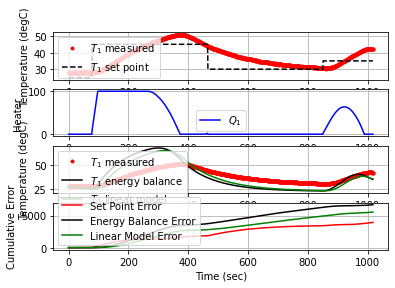

1020.1  35.00  41.96   0.00  -1.40   1.84  -0.00


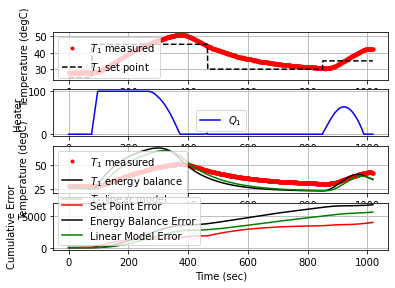

1021.3  35.00  41.85   0.00  -1.38   1.84   0.01


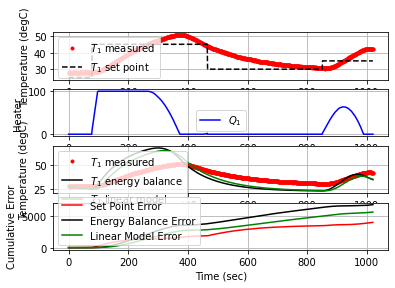

1022.5  35.00  41.85   0.00  -1.38   1.84  -0.00


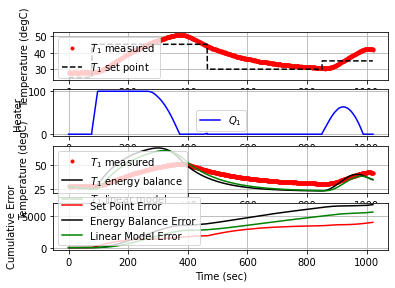

1023.8  35.00  41.68   0.00  -1.35   1.84   0.01


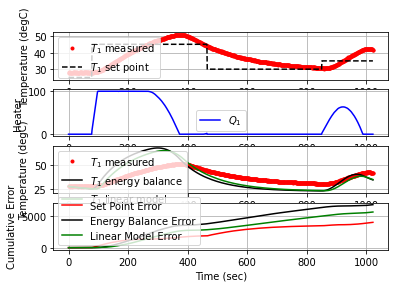

1025.0  35.00  41.79   0.00  -1.37   1.84  -0.01


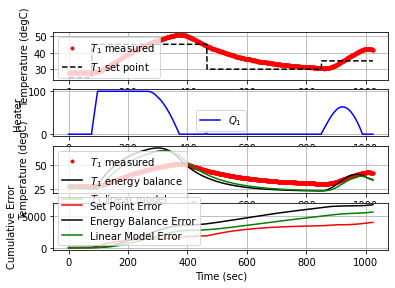

1026.4  35.00  41.64   0.00  -1.34   1.84   0.01


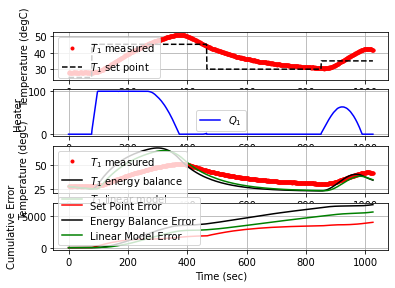

1027.6  35.00  41.53   0.00  -1.32   1.84   0.01


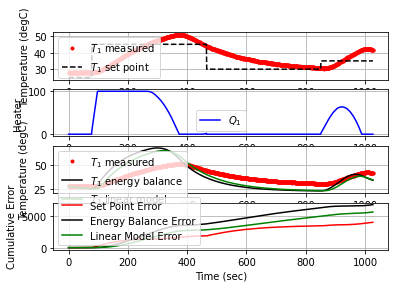

1028.8  35.00  41.51   0.00  -1.31   1.84   0.00


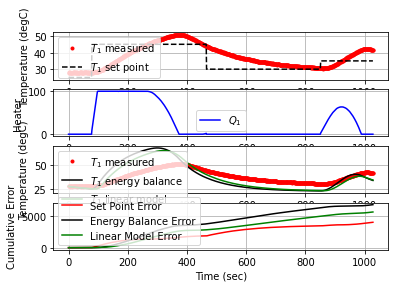

1030.0  35.00  41.29   0.00  -1.27   1.84   0.01


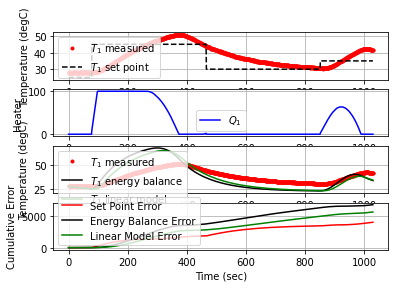

1031.2  35.00  41.31   0.00  -1.27   1.84  -0.00


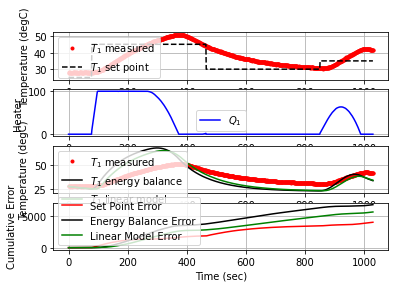

1032.4  35.00  41.30   0.00  -1.27   1.84   0.00


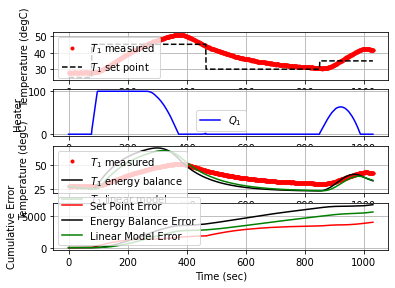

1033.8  35.00  41.24   0.00  -1.26   1.84   0.00


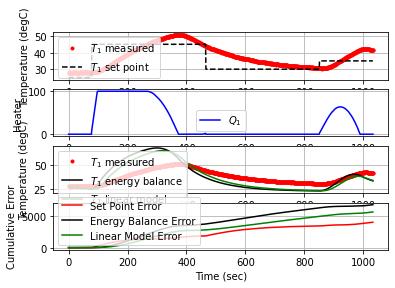

1035.1  35.00  41.07   0.00  -1.23   1.84   0.01


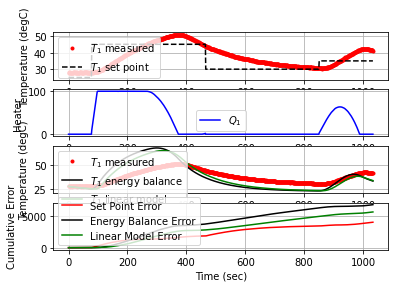

1036.4  35.00  40.95   0.00  -1.20   1.84   0.01


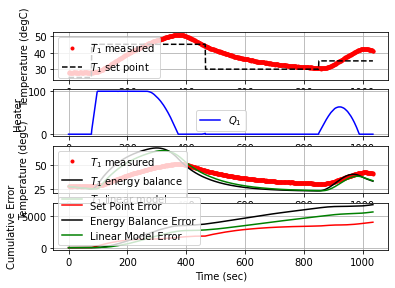

1037.5  35.00  41.20   0.00  -1.25   1.84  -0.01


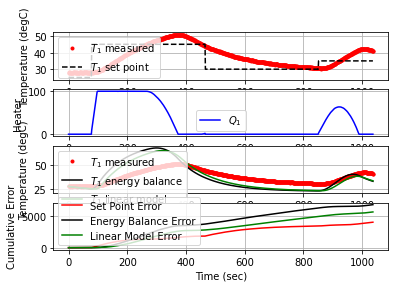

1038.8  35.00  41.12   0.00  -1.24   1.84   0.00


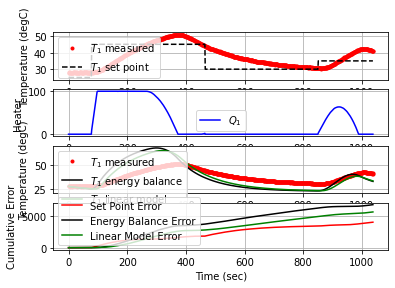

1040.1  35.00  40.96   0.00  -1.20   1.84   0.01


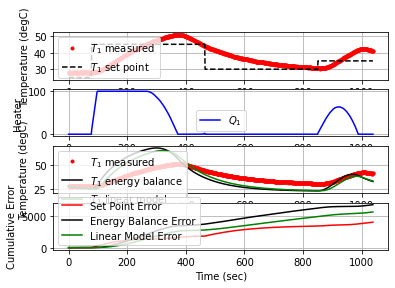

1041.4  35.00  41.01   0.00  -1.21   1.84  -0.00


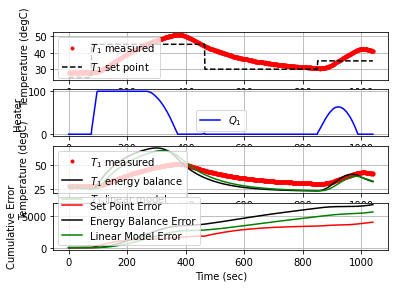

1042.6  35.00  40.95   0.00  -1.20   1.84   0.00


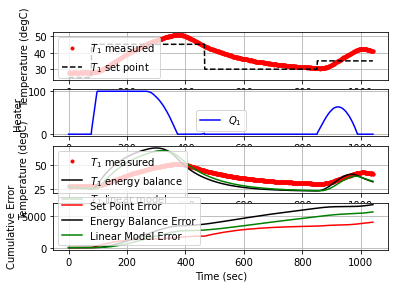

1043.9  35.00  40.93   0.00  -1.20   1.84   0.00


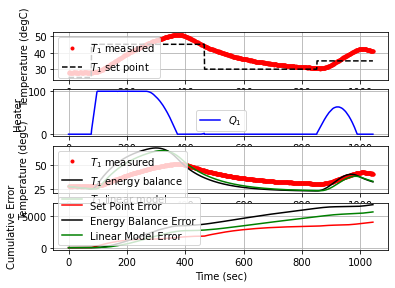

1045.1  35.00  40.88   0.00  -1.19   1.84   0.00


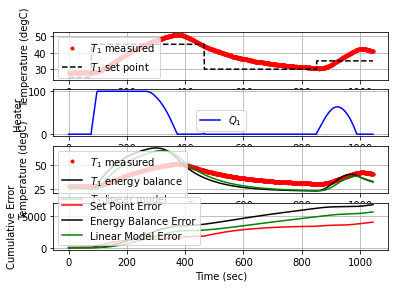

1046.3  35.00  40.78   0.00  -1.17   1.84   0.01


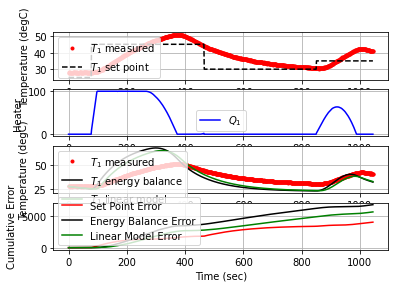

1047.7  35.00  40.68   0.00  -1.15   1.84   0.00


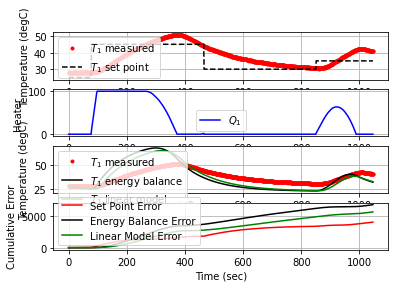

1048.9  35.00  40.75   0.00  -1.16   1.84  -0.00


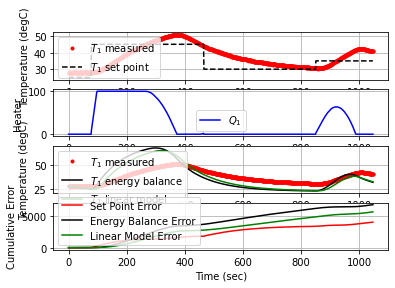

1050.2  35.00  40.71   0.00  -1.15   1.84   0.00


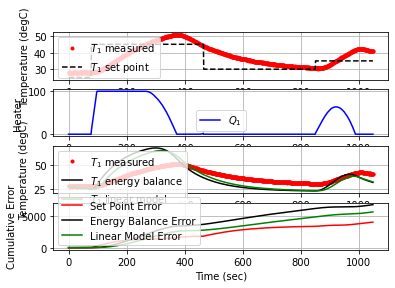

1051.4  35.00  40.71   0.00  -1.15   1.84  -0.00


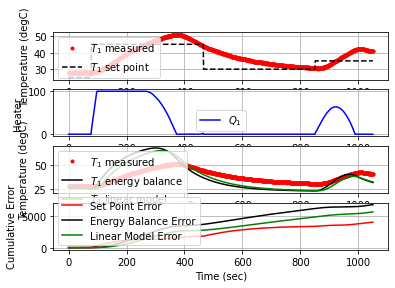

1052.7  35.00  40.64   0.00  -1.14   1.84   0.00


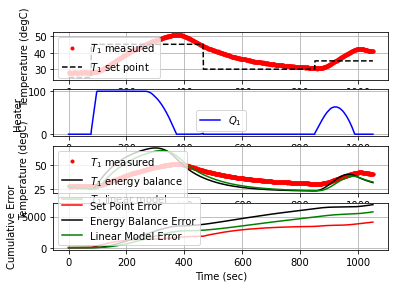

1054.1  35.00  40.54   0.00  -1.12   1.84   0.00


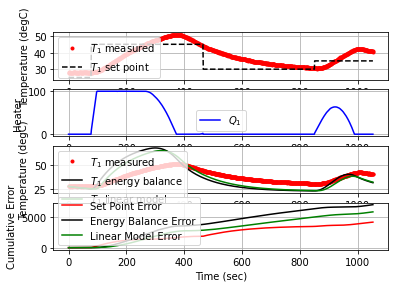

1055.4  35.00  40.46   0.00  -1.10   1.84   0.00


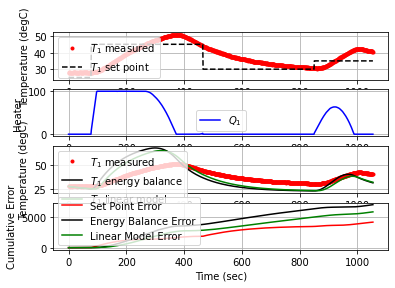

1056.6  35.00  40.50   0.00  -1.11   1.84  -0.00


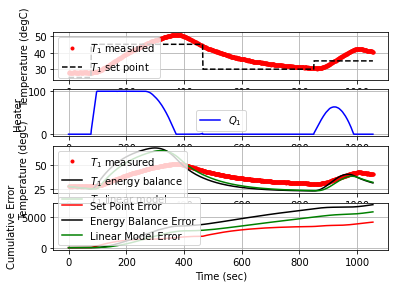

1057.8  35.00  40.47   0.00  -1.10   1.84   0.00


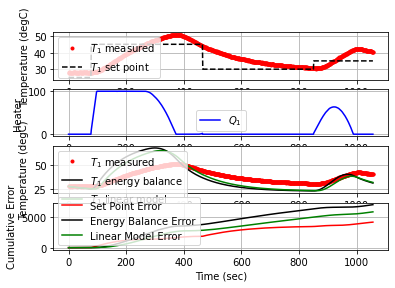

1059.1  35.00  40.35   0.00  -1.08   1.84   0.01


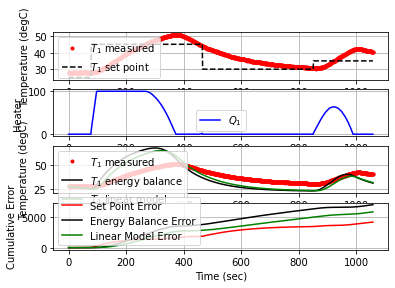

1060.3  35.00  40.28   0.00  -1.07   1.84   0.00


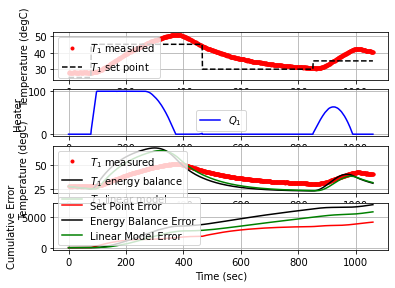

1061.7  35.00  40.24   0.00  -1.06   1.84   0.00


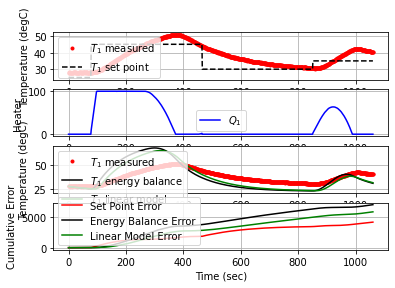

1063.0  35.00  40.03   0.00  -1.02   1.84   0.01


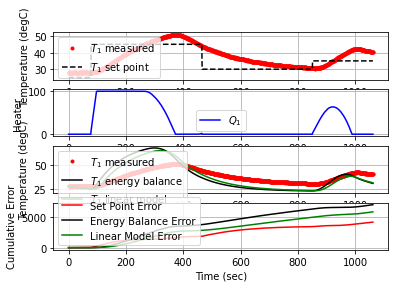

1064.3  35.00  40.06   0.00  -1.02   1.84  -0.00


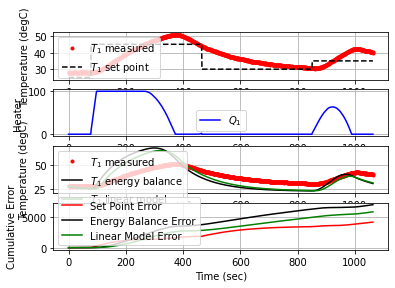

1065.5  35.00  40.08   0.00  -1.03   1.84  -0.00


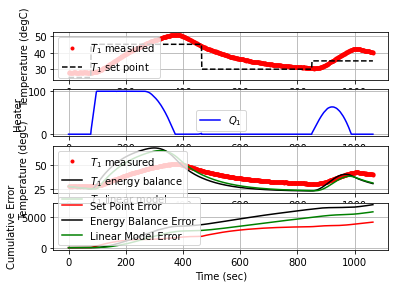

1066.8  35.00  39.90   0.00  -0.99   1.84   0.01


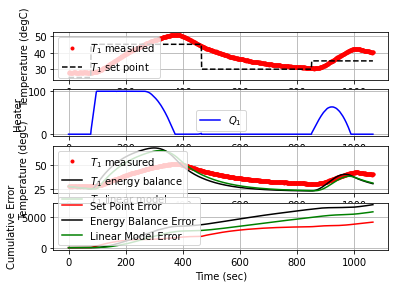

1068.1  35.00  39.63   0.00  -0.93   1.84   0.01


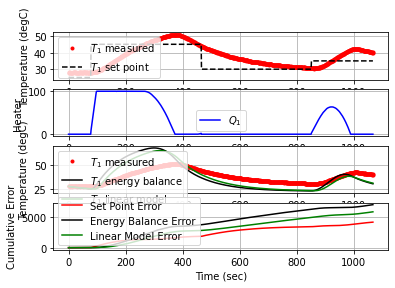

1069.3  35.00  39.73   0.00  -0.95   1.84  -0.01


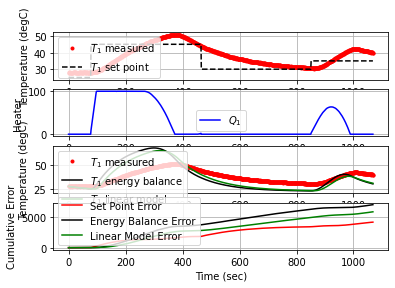

1070.6  35.00  39.78   0.00  -0.96   1.84  -0.00


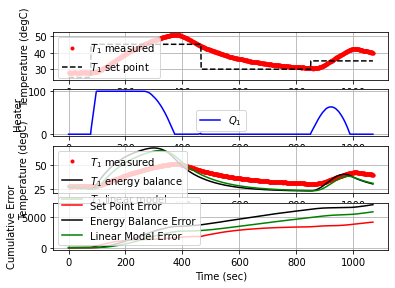

1071.9  35.00  39.75   0.00  -0.96   1.84   0.00


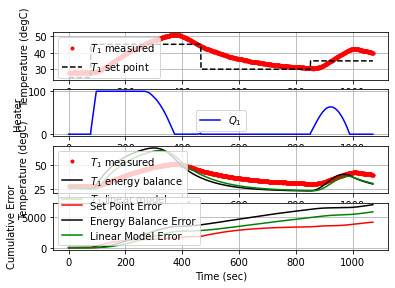

1073.1  35.00  39.72   0.00  -0.95   1.84   0.00


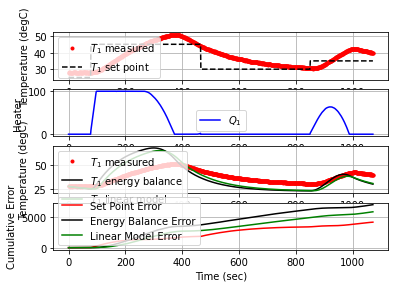

1074.4  35.00  39.65   0.00  -0.94   1.84   0.00


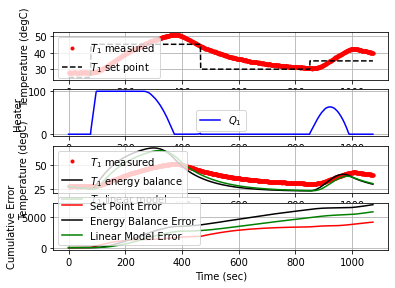

1075.8  35.00  39.39   0.00  -0.89   1.84   0.01


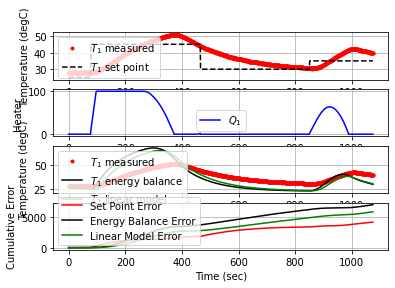

1077.0  35.00  39.49   0.00  -0.91   1.84  -0.01


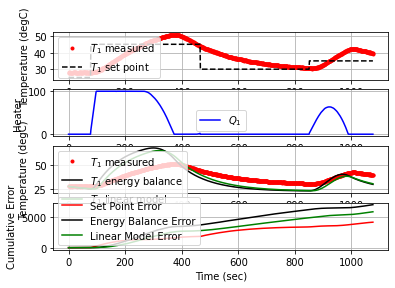

1078.3  35.00  39.45   0.00  -0.90   1.84   0.00


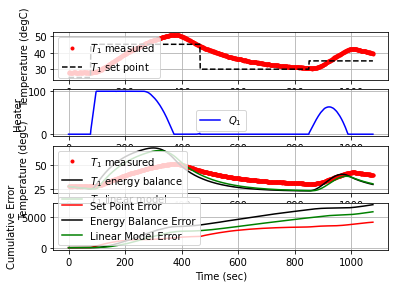

1079.7  35.00  39.30   0.00  -0.87   1.84   0.01


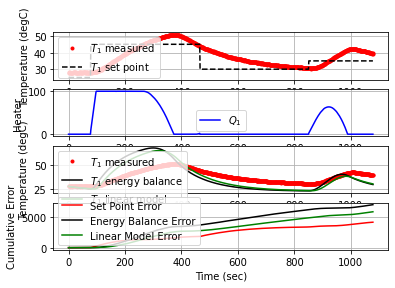

1081.2  35.00  39.35   0.00  -0.88   1.84  -0.00


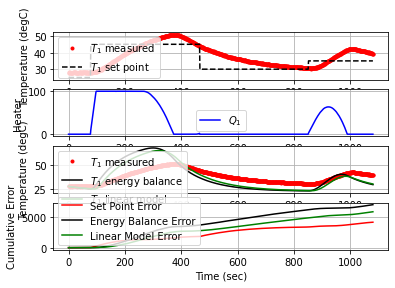

1082.7  35.00  39.13   0.00  -0.83   1.84   0.01


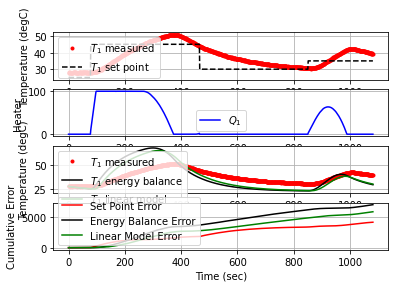

1084.4  35.00  39.04   0.00  -0.82   1.84   0.00


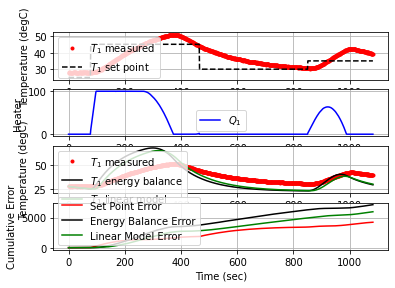

1085.6  35.00  38.91   0.00  -0.79   1.84   0.01


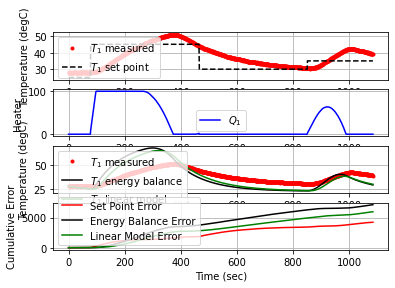

1087.6  35.00  38.92   0.00  -0.79   1.84  -0.00


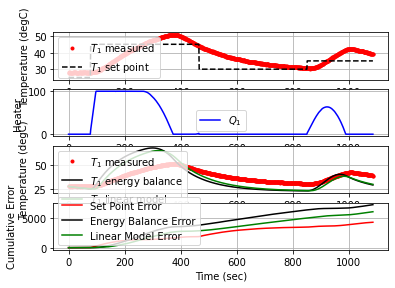

1090.2  35.00  38.68   0.00  -0.74   1.84   0.01


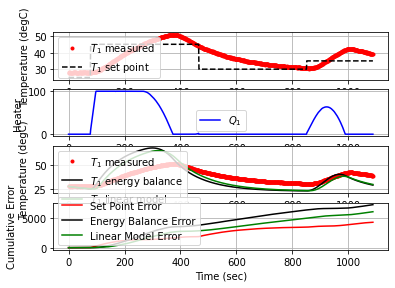

1092.1  35.00  38.64   0.00  -0.74   1.84   0.00


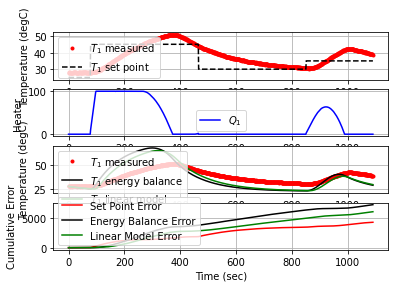

1095.4  35.00  38.31   0.00  -0.67   1.84   0.01


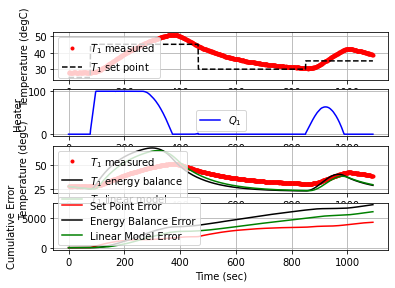

1097.0  35.00  38.32   0.00  -0.67   1.84  -0.00


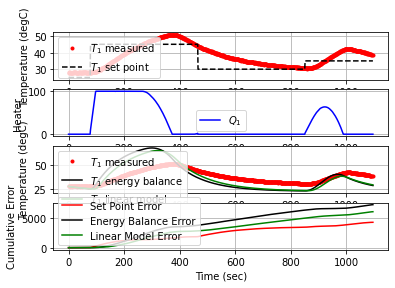

1098.5  35.00  38.23   0.00  -0.65   1.84   0.00


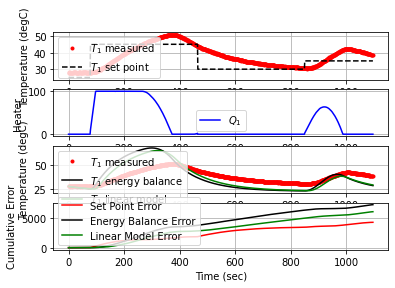

1099.8  35.00  38.09   0.18  -0.62   0.80   0.01


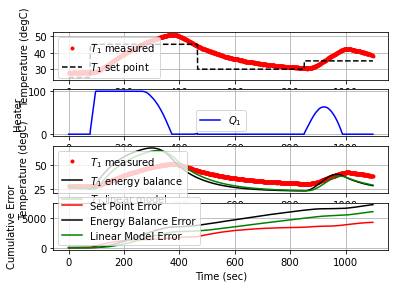

1101.2  35.00  38.09   0.00  -0.62   0.80  -0.00


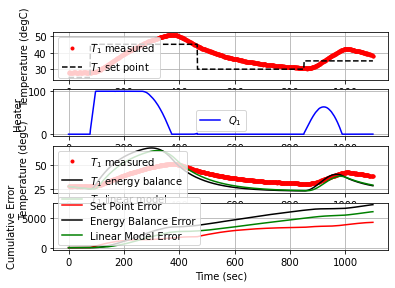

1103.0  35.00  37.93   0.00  -0.59   0.80   0.01


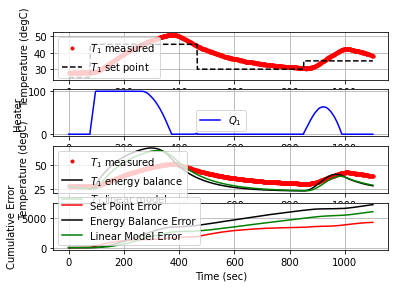

1104.5  35.00  37.92   0.00  -0.59   0.80   0.00


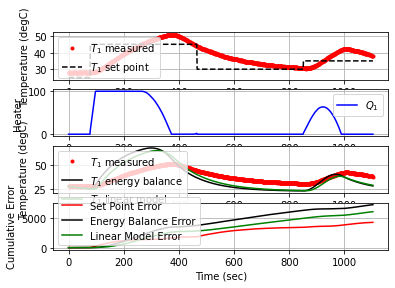

1106.5  35.00  37.84   0.00  -0.57   0.80   0.00


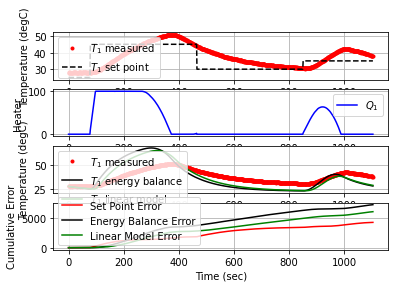

1108.0  35.00  37.83   0.00  -0.57   0.80   0.00


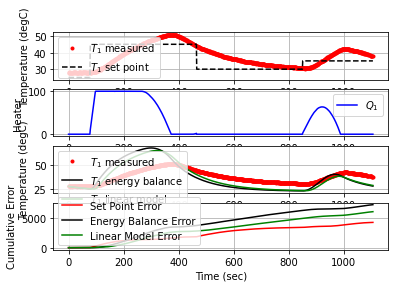

1110.3  35.00  37.62   0.00  -0.53   0.80   0.01


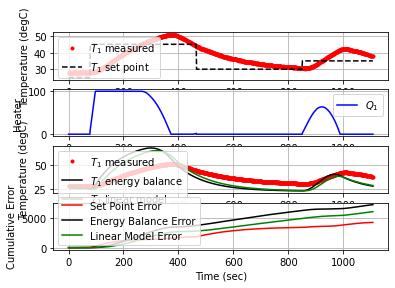

1111.8  35.00  37.53   0.00  -0.51   0.80   0.00


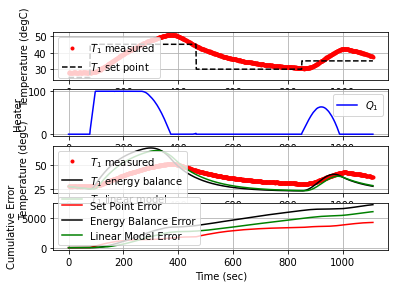

1113.3  35.00  37.59   0.00  -0.52   0.80  -0.00


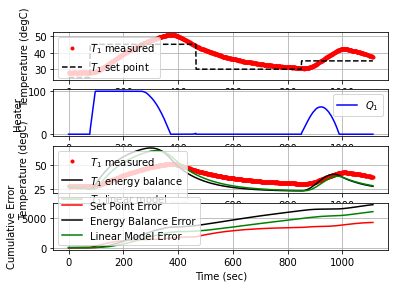

1115.2  35.00  37.59   0.00  -0.52   0.80  -0.00


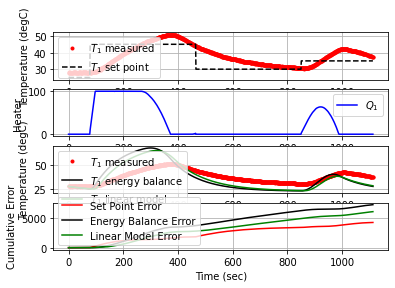

1116.6  35.00  37.43   0.00  -0.49   0.80   0.01


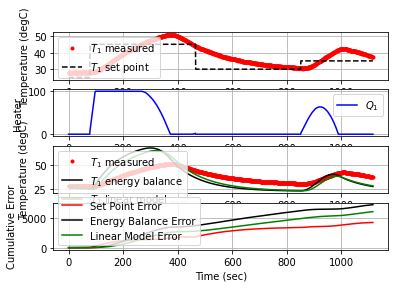

1118.4  35.00  37.38   0.00  -0.48   0.80   0.00


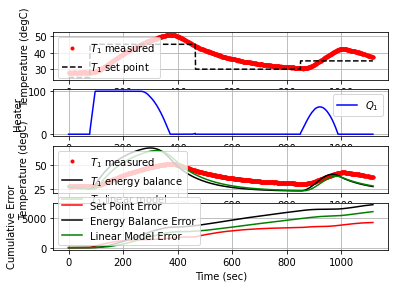

1119.8  35.00  37.39   0.00  -0.48   0.80  -0.00


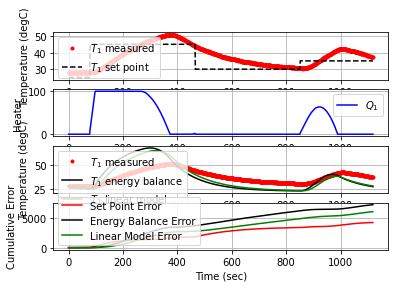

1121.3  35.00  37.22   0.00  -0.45   0.80   0.01


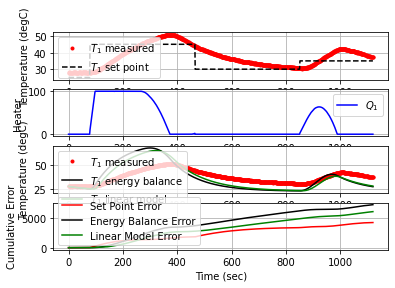

1122.5  35.00  37.35   0.00  -0.48   0.80  -0.01


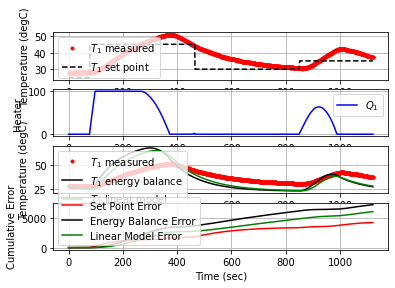

1123.9  35.00  37.24   0.00  -0.45   0.80   0.01


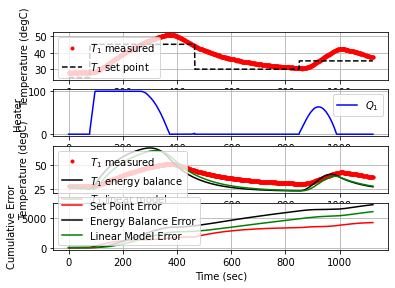

1125.3  35.00  36.97   0.00  -0.40   0.80   0.01


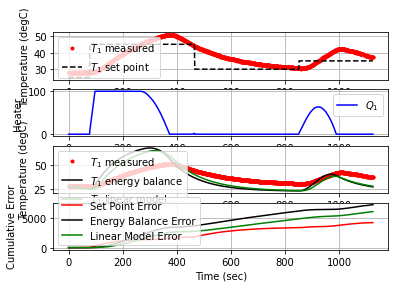

1126.8  35.00  37.06   0.00  -0.42   0.80  -0.00


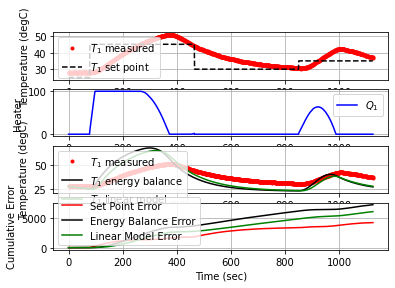

1128.8  35.00  36.93   0.00  -0.39   0.80   0.00


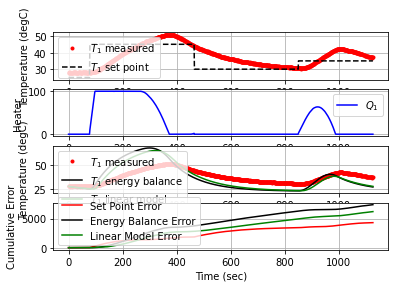

1131.1  35.00  36.85   0.00  -0.38   0.80   0.00


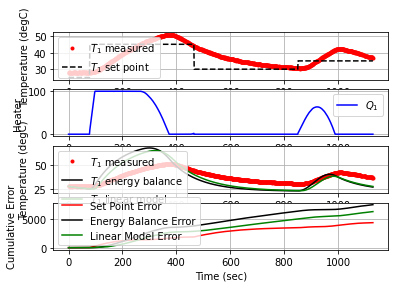

1133.2  35.00  36.73   0.00  -0.35   0.80   0.00


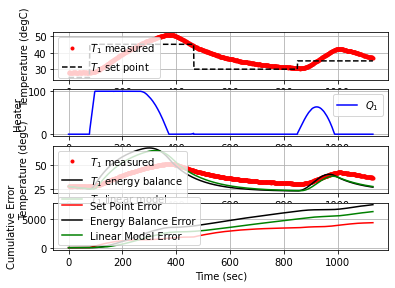

1135.0  35.00  36.56   0.00  -0.32   0.80   0.01


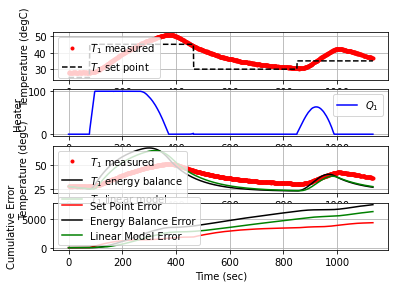

1136.6  35.00  36.57   0.00  -0.32   0.80  -0.00


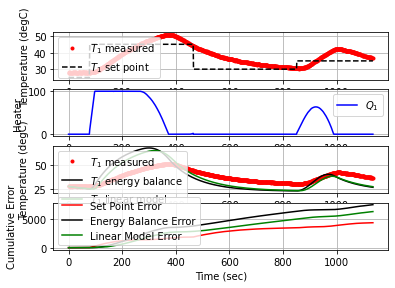

1138.0  35.00  36.44   0.00  -0.29   0.80   0.01


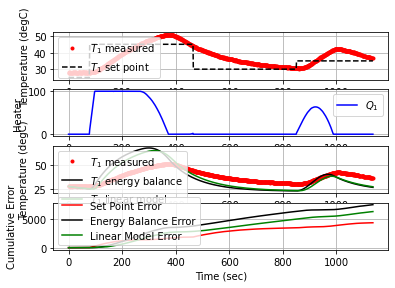

1139.4  35.00  36.39   0.00  -0.28   0.80   0.00


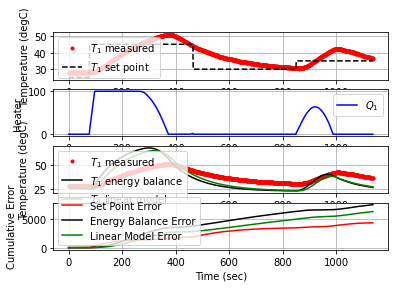

1140.9  35.00  36.40   0.00  -0.29   0.80  -0.00


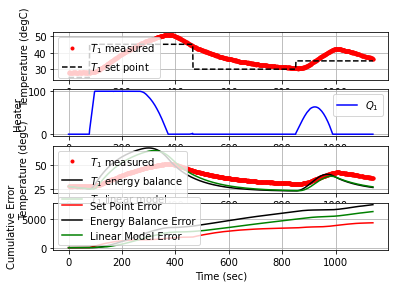

1142.3  35.00  36.40   0.00  -0.29   0.80  -0.00


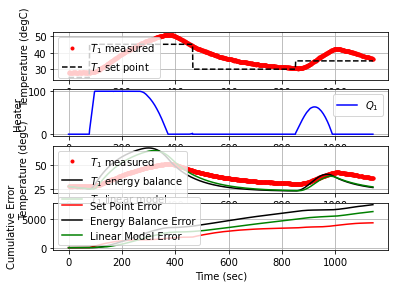

1143.7  35.00  36.29   0.05  -0.26   0.31   0.01


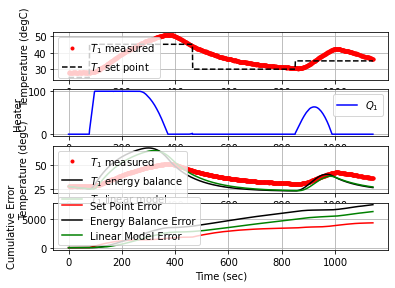

1145.1  35.00  36.25   0.00  -0.26   0.31   0.00


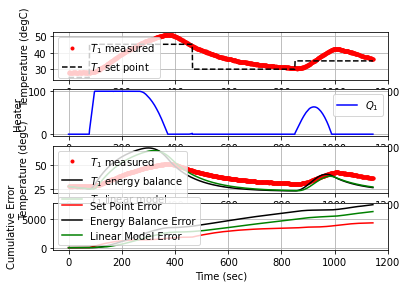

1146.6  35.00  36.29   0.00  -0.26   0.31  -0.00


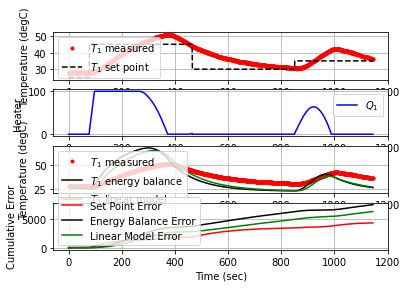

1148.4  35.00  36.14   0.00  -0.23   0.31   0.01


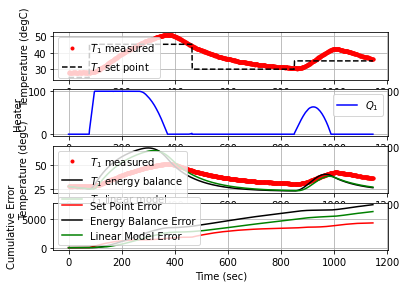

1150.0  35.00  35.97   0.00  -0.20   0.31   0.01


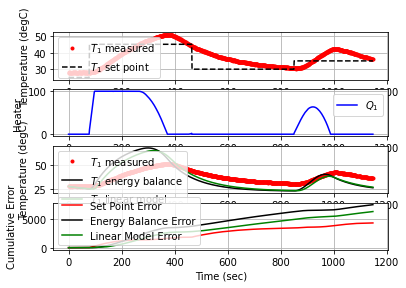

1151.3  35.00  36.12   0.00  -0.23   0.31  -0.01


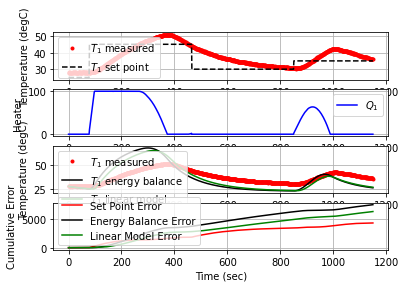

1152.5  35.00  35.86   0.00  -0.18   0.31   0.02


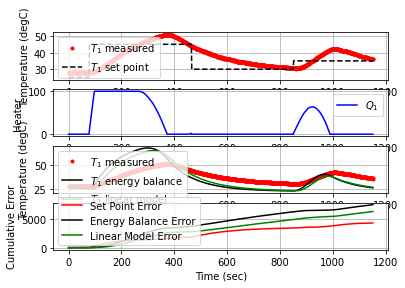

1153.9  35.00  35.94   0.00  -0.19   0.31  -0.00


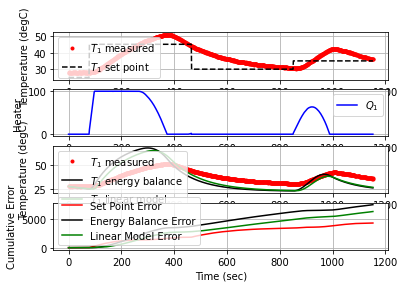

1155.2  35.00  35.86   0.00  -0.18   0.31   0.00


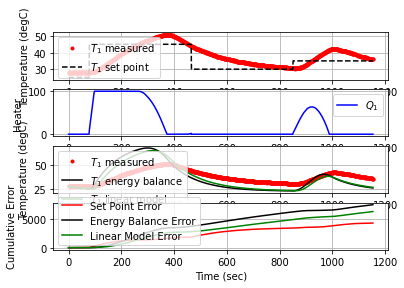

1156.5  35.00  35.84   0.00  -0.17   0.31   0.00


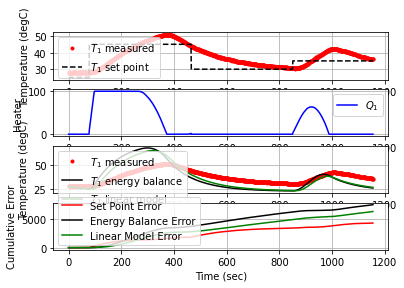

1157.8  35.00  35.75   0.00  -0.15   0.31   0.01


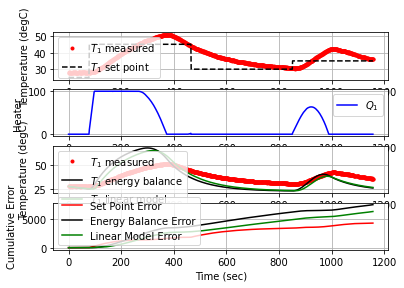

1159.0  35.00  35.79   0.00  -0.16   0.31  -0.00


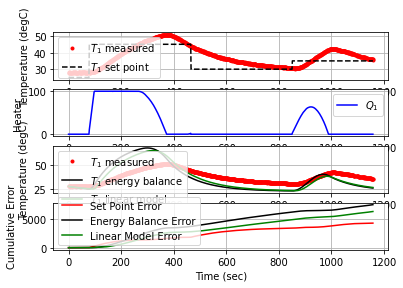

1160.2  35.00  35.57   0.01  -0.12   0.12   0.01


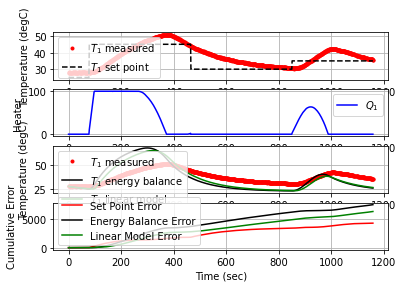

1161.6  35.00  35.66   0.00  -0.14   0.12  -0.00


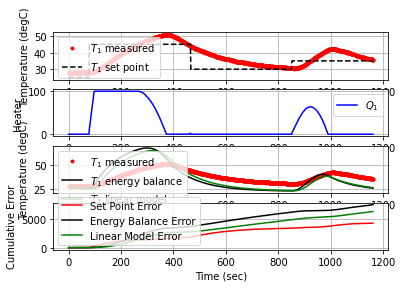

1162.9  35.00  35.60   0.00  -0.12   0.12   0.00


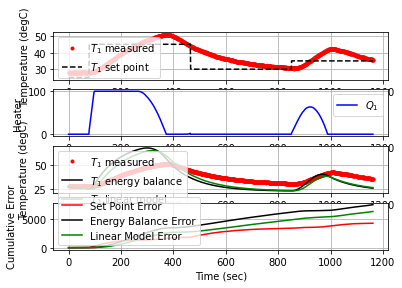

1164.1  35.00  35.58   0.00  -0.12   0.12   0.00


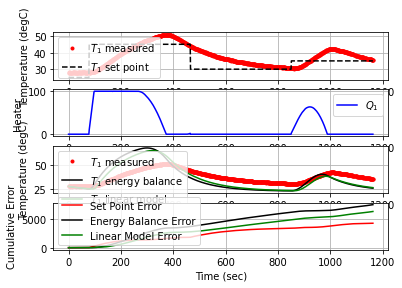

1165.3  35.00  35.54   0.00  -0.11   0.12   0.00


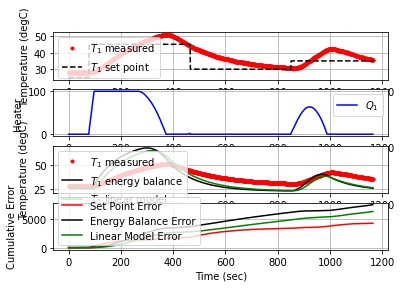

1166.6  35.00  35.51   0.00  -0.11   0.12   0.00


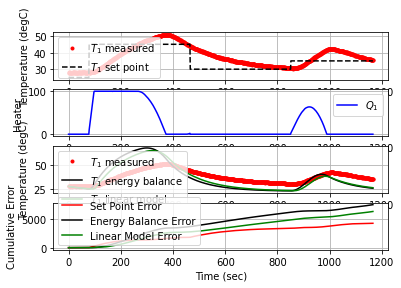

1167.9  35.00  35.50   0.00  -0.10   0.12   0.00


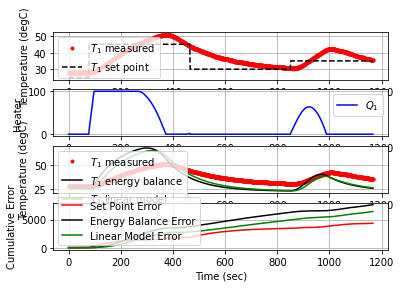

1169.2  35.00  35.42   0.00  -0.09   0.12   0.00


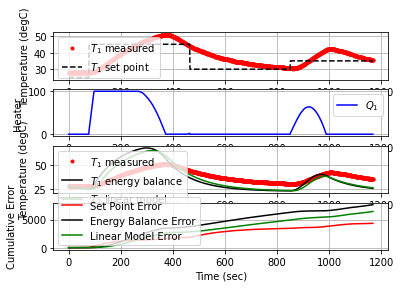

Arduino disconnected successfully


True

<Figure size 432x288 with 0 Axes>

In [11]:
######################################################
# Do not adjust anything below this point            #
######################################################

# Connect to Arduino
a = itclab.iTCLab()
#a.encode('utf-8').strip()#modification error
# Turn LED on
print('LED On')
a.LED(100)

# Run time in minutes
run_time = 15.0

# Number of cycles
loops = int(60.0*run_time)
tm = np.zeros(loops)

# Temperature
# set point (degC)
Tsp1 = np.ones(loops) * 25.0 
Tsp1[60:] = 45.0
Tsp1[360:] = 30.0
Tsp1[660:] = 35.0
T1 = np.ones(loops) * a.T1 # measured T (degC)
error_sp = np.zeros(loops)

Tsp2 = np.ones(loops) * 23.0 # set point (degC)
T2 = np.ones(loops) * a.T2 # measured T (degC)

# Predictions
Tp = np.ones(loops) * a.T1
error_eb = np.zeros(loops)
Tpl = np.ones(loops) * a.T1
error_fopdt = np.zeros(loops)

# impulse tests (0 - 100%)
Q1 = np.ones(loops) * 0.0
Q2 = np.ones(loops) * 0.0

print('Running Main Loop. Ctrl-C to end.')
print('  Time     SP     PV     Q1   =  P   +  I  +   D')
print(('{:6.1f} {:6.2f} {:6.2f} ' + \
       '{:6.2f} {:6.2f} {:6.2f} {:6.2f}').format( \
           tm[0],Tsp1[0],T1[0], \
           Q1[0],0.0,0.0,0.0))

# Create plot
plt.figure(figsize=(10,7))
plt.ion()
plt.show()

# Main Loop
start_time = time.time()
prev_time = start_time
# Integral error
ierr = 0.0
try:
    for i in range(1,loops):
        # Sleep time
        sleep_max = 1.0
        sleep = sleep_max - (time.time() - prev_time)
        if sleep>=0.01:
            time.sleep(sleep-0.01)
        else:
            time.sleep(0.01)

        # Record time and change in time
        t = time.time()
        dt = t - prev_time
        prev_time = t
        tm[i] = t - start_time

        # Read temperatures in Kelvin 
        T1[i] = a.T1
        T2[i] = a.T2

        # Simulate one time step with Energy Balance
        Tnext = odeint(heat,Tp[i-1]+273.15,[0,dt],args=(Q1[i-1],))
        Tp[i] = Tnext[1]-273.15

        # Simulate one time step with linear FOPDT model
        z = np.exp(-dt/tauP)
        Tpl[i] = (Tpl[i-1]-Tss) * z \
                 + (Q1[max(0,i-int(thetaP)-1)]-Qss)*(1-z)*Kp \
                 + Tss

        # Calculate PID Output (Choose one of them)
        # 1. Manually Choosen
#         [Q1[i],P,ierr,D] = pid(Tsp1[i],T1[i],T1[i-1],ierr,dt)

        # 2. Based on Deep Learning Result
        [Q1[i],P,ierr,D] = pid_dl(Tsp1[i],T1[i],T1[i-1],ierr,dt)

        # Start setpoint error accumulation after 1 minute (60 seconds)
        if i>=60:
            error_eb[i] = error_eb[i-1] + abs(Tp[i]-T1[i])
            error_fopdt[i] = error_fopdt[i-1] + abs(Tpl[i]-T1[i])
            error_sp[i] = error_sp[i-1] + abs(Tsp1[i]-T1[i])

        # Write output (0-100)
        a.Q1(Q1[i])
        a.Q2(0.0)

        # Print line of data
        print(('{:6.1f} {:6.2f} {:6.2f} ' + \
              '{:6.2f} {:6.2f} {:6.2f} {:6.2f}').format( \
                  tm[i],Tsp1[i],T1[i], \
                  Q1[i],P,ierr,D))
        
        # Publish data to MQTT Broker
        pub_sp = client.publish('SetPoint', Tsp1[i])
        pub_pv1 = client.publish('suhu1', T1[i])
        pub_op = client.publish('Nilai_op', Q1[i])

        # Plot
        plt.clf()
        ax=plt.subplot(4,1,1)
        ax.grid()
        plt.plot(tm[0:i],T1[0:i],'r.',label=r'$T_1$ measured')
        plt.plot(tm[0:i],Tsp1[0:i],'k--',label=r'$T_1$ set point')
        plt.ylabel('Temperature (degC)')
        plt.legend(loc=2)
        ax=plt.subplot(4,1,2)
        ax.grid()
        plt.plot(tm[0:i],Q1[0:i],'b-',label=r'$Q_1$')
        plt.ylabel('Heater')
        plt.legend(loc='best')
        ax=plt.subplot(4,1,3)
        ax.grid()
        plt.plot(tm[0:i],T1[0:i],'r.',label=r'$T_1$ measured')
        plt.plot(tm[0:i],Tp[0:i],'k-',label=r'$T_1$ energy balance')
        plt.plot(tm[0:i],Tpl[0:i],'g-',label=r'$T_1$ linear model')
        plt.ylabel('Temperature (degC)')
        plt.legend(loc=2)
        ax=plt.subplot(4,1,4)
        ax.grid()
        plt.plot(tm[0:i],error_sp[0:i],'r-',label='Set Point Error')
        plt.plot(tm[0:i],error_eb[0:i],'k-',label='Energy Balance Error')
        plt.plot(tm[0:i],error_fopdt[0:i],'g-',label='Linear Model Error')
        plt.ylabel('Cumulative Error')
        plt.legend(loc='best')
        plt.xlabel('Time (sec)')
        plt.draw()
        plt.pause(0.05)

    # Turn off heaters
    a.Q1(0)
    a.Q2(0)
    # Save figure
    plt.savefig('test_PID_dl.png')

# Allow user to end loop with Ctrl-C           
except KeyboardInterrupt:
    # Disconnect from Arduino
    a.Q1(0)
    a.Q2(0)
    print('Shutting down')
    a.close()
    plt.savefig('test_PID_dl.png')

# Make sure serial connection still closes when there's an error
except:           
    # Disconnect from Arduino
    a.Q1(0)
    a.Q2(0)
    print('Error: Shutting down')
    a.close()
    plt.savefig('test_PID_dl.png')
    raise

a.close()

In [12]:
a.close()

Arduino disconnected successfully


True